<a href="https://colab.research.google.com/github/mfmceneaney/DIRC_COLAB/blob/master/DIRC_CIFAR_10_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
# Using GPU speeds up CNN training
# Go to Edit > Notebook Settings > Hardware Accelerator and select GPU

In [7]:
print(" > Installing uproot...")
!pip install uproot

 > Installing uproot...


In [0]:
import uproot

from os import chdir, mkdir, listdir, rmdir
from shutil import rmtree

# Standard scientific Python imports
import matplotlib.pyplot as plt
import numpy as np
import math

from __future__ import absolute_import, division, print_function, unicode_literals

try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
from tensorflow.keras import datasets, layers, models, metrics
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, Conv2D, Dense, Dropout, Flatten, MaxPooling2D, GlobalAveragePooling2D
from tensorflow.keras.applications import DenseNet121, ResNet50V2, VGG16, VGG19, MobileNet, MobileNetV2, NASNetLarge, NASNetMobile
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.losses import SparseCategoricalCrossentropy

TensorFlow 2.x selected.


In [8]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [9]:
# initialize images
image_kplus = np.zeros(shape=(48,144))
image_piplus = np.zeros(shape=(48,144))
images_kplus = []
images_piplus = []
images_flat_kplus = []
images_flat_piplus = []

#h2_kplus = ROOT.TH2F("kplus","Hit Pattern K+; PixelRow; PixelCol",144,-0.5,143.5,48,-0.5,47.5)
#h2_piplus = ROOT.TH2F("piplus","Hit Pattern pi+; PixelRow; PixelCol",144,-0.5,143.5,48,-0.5,47.5)

# get data from files
print("Opening files")
piplus = uproot.open("/content/gdrive/My Drive/piplus_p3_theta4_flat.root")["dircml_flat"]
kplus = uproot.open("/content/gdrive/My Drive/kplus_p3_theta4_flat.root")["dircml_flat"]

# fill histogram with # photon hits
#plt.axis([0, 250, 0, 5000])
#plt.hist(NPixelsArr, 4000) #, 0, 100) #bins='auto')
#plt.title("Histogram with 'auto' bins")
#plt.show()

eventMax = 10000
eventCounter = 0

print("Filling image arrays")
# loop over kplus events
for (PixelTimes,PixelRows,PixelCols) in zip(kplus.array("PixelTime"),kplus.array("PixelRow"),kplus.array("PixelCol")):
    #print("event")
    image_single = np.zeros(shape=(48,144))
    
    # loop over pixels within event
    for (PixelTime,PixelRow,PixelCol) in zip(PixelTimes,PixelRows,PixelCols):
        #print("PixelTime,Row,Col = %f,%d,%d" % (PixelTime,PixelRow,PixelCol))
        image_kplus[PixelCol,PixelRow] += 1
        image_single[PixelCol,PixelRow] = PixelTime
        #h2_kplus.Fill(PixelRow,PixelCol)
    
    # after each event
    images_kplus.append(image_single)
    images_flat_kplus.append(np.reshape(image_single, 6912))
    
    eventCounter = eventCounter+1
    if eventCounter > eventMax:
        break

eventCounter = 0
        
# loop over piplus events
for (PixelTimes,PixelRows,PixelCols) in zip(piplus.array("PixelTime"),piplus.array("PixelRow"),piplus.array("PixelCol")):
    #print("event")
    image_single = np.zeros(shape=(48,144))
    
    # loop over pixels within event
    for (PixelTime,PixelRow,PixelCol) in zip(PixelTimes,PixelRows,PixelCols):
        #print("PixelTime,Row,Col = %f,%d,%d" % (PixelTime,PixelRow,PixelCol))
        image_piplus[PixelCol,PixelRow] += 1
        image_single[PixelCol,PixelRow] = PixelTime
        #h2_piplus.Fill(PixelRow,PixelCol)
    
    # after each event
    images_piplus.append(image_single)
    images_flat_piplus.append(np.reshape(image_single, 6912))
    
    eventCounter = eventCounter+1
    if eventCounter > eventMax:
        break

Opening files
Filling image arrays


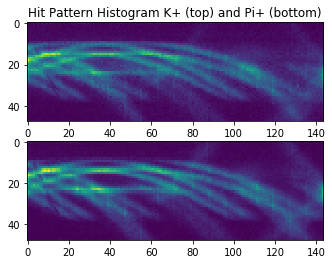

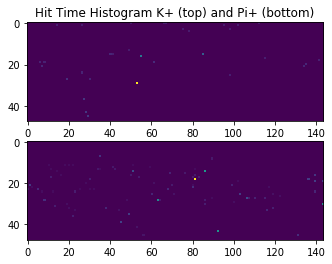

In [10]:
# draw cumulative image
plt.axis([-0.5, 143.5, -0.5, 47.5])
plt.subplot(2, 1, 1)
plt.title("Hit Pattern Histogram K+ (top) and Pi+ (bottom)")
plt.imshow(image_kplus, cmap='viridis')
plt.subplot(2, 1, 2)
plt.title("")
plt.imshow(image_piplus, cmap='viridis')
plt.show()

# draw single event image
plt.subplot(2, 1, 1)
plt.title("Hit Time Histogram K+ (top) and Pi+ (bottom)")
plt.imshow(images_kplus[0], cmap='viridis')
plt.subplot(2, 1, 2)
plt.title("")
plt.imshow(images_piplus[0], cmap='viridis')
#plt.show()

# draw ROOT image
#can = ROOT.TCanvas("cc","cc",600,500)
#can.Divide(1,2)
#can.cd(1)
#h2_kplus.Draw("colz")
#can.cd(2)
#h2_piplus.Draw("colz")
#can.Print("HitPattern.png")

In [11]:
# Split samples into training and testing
print("Splitting sample into training and testing subsets")
split = np.array((80,10,10)) # Percentages into which to split data (% train, % val, % test)
n_kplus = len(images_kplus)
n_piplus = len(images_piplus)
n_total = n_kplus + n_piplus
print(n_kplus / split)

print(n_kplus // split)
print(n_piplus // split)
images_train_kplus = images_kplus[:int(n_kplus * split[0] / 100)]
images_train_piplus = images_piplus[:int(n_piplus * split[0] / 100)]
n_train_kplus = len(images_train_kplus)
n_train_piplus = len(images_train_piplus)
n_train_total = n_train_kplus + n_train_piplus

images_val_kplus = images_kplus[int(n_kplus * split[0] / 100):int(n_piplus * (split[0] + split[1]) / 100)]
images_val_piplus = images_piplus[int(n_piplus * split[0] / 100):int(n_piplus * (split[0] + split[1]) / 100)]
n_val_kplus = len(images_val_kplus)
n_val_piplus = len(images_val_piplus)
n_val_total = n_val_kplus + n_val_piplus

images_test_kplus = images_kplus[int(n_piplus * (split[0] + split[1]) / 100):]
images_test_piplus = images_piplus[int(n_piplus * (split[0] + split[1]) / 100):]
n_test_kplus = len(images_test_kplus)
n_test_piplus = len(images_test_piplus)
n_test_total = n_test_kplus + n_test_piplus

data_train = np.concatenate((images_train_kplus, images_train_piplus))
data_val = np.concatenate((images_val_kplus, images_val_piplus))
data_test = np.concatenate((images_test_kplus, images_test_piplus))
data = np.concatenate((images_kplus, images_piplus))

target_train = np.concatenate((np.ones(n_train_kplus), np.zeros(n_train_piplus)))
target_val = np.concatenate((np.ones(n_val_kplus), np.zeros(n_val_piplus)))
target_test = np.concatenate((np.ones(n_test_kplus), np.zeros(n_test_piplus)))
target = np.concatenate((np.ones(n_kplus), np.zeros(n_piplus)))


print(data_train.shape)
print(data.shape)
print(target.shape)
print(np.unique(target))

print("Training size = %d" % len(data_train))
print("Testing size = %d" % len(data_test))
"""
print(images_kplus[1].shape)
print(images_piplus[0].shape)

print(data.max())
print(data_train.max())
print(data_test.max())
print(data.min())
print(data_train.min())
print(data_test.min())
"""

Splitting sample into training and testing subsets
[ 125.0125 1000.1    1000.1   ]
[ 125 1000 1000]
[ 125 1000 1000]
(16000, 48, 144)
(20002, 48, 144)
(20002,)
[0. 1.]
Training size = 16000
Testing size = 2002


'\nprint(images_kplus[1].shape)\nprint(images_piplus[0].shape)\n\nprint(data.max())\nprint(data_train.max())\nprint(data_test.max())\nprint(data.min())\nprint(data_train.min())\nprint(data_test.min())\n'

In [12]:
# Reshape Data to have a single channel
data_train_images = data_train.reshape(len(data_train), 48, 144, 1)
target_train_images = target_train.reshape(len(target_train))

data_val_images = data_val.reshape(len(data_val), 48, 144, 1)
target_val_images = target_val.reshape(len(target_val))

data_test_images = data_test.reshape(len(data_test), 48, 144, 1)
target_test_images = target_test.reshape(len(target_test))

# Normalize pixel absolute values to be between 0 and 1
data_train_images = data_train_images / data.max()
data_val_images = data_val_images / data.max()
data_test_images = data_test_images / data.max()

#print(data_train_images.max())
#print(data_test_images.max())

print("Data shape: "+str(data_train_images.shape))
print("Target shape: "+str(target_train_images.shape))

Data shape: (16000, 48, 144, 1)
Target shape: (16000,)


In [0]:
def plot_history(histories, key='binary_crossentropy'):
  plt.figure(figsize=(16,10))

  for name, history in histories:
    val = plt.plot(history.epoch, history.history['val_'+key],
                   '--', label=name.title()+' Val')
    plt.plot(history.epoch, history.history[key], color=val[0].get_color(),
             label=name.title()+' Train')
  
  f = plt.figure()
  plt.xlabel('Epochs')
  plt.ylabel(key.replace('_',' ').title())
  plt.legend()

  plt.xlim([0,max(history.epoch)])
  plt.show()
  f.savefig("histories.png")
  
  # Convert accuracy and loss plots into ROOT histograms
  print("Converting plots to ROOT...")

  file = uproot.recreate("histories.root", compression=uproot.ZLIB(4))
  file["acc"] = np.histogram2d(metrics[0],metrics[1])
  
  # Download png and root files
  print("Downloading files...")

  from google.colab import files
  files.download("histories.png")
  files.download("histories.root")

Creating model 1...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 473us/sample - loss: 0.6934 - accuracy: 0.4991 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 2/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6932 - accuracy: 0.5029 - val_loss: 0.6931 - val_accuracy: 0.4990
Epoch 3/100
16000/16000 [==============================] - 7s 431us/sample - loss: 0.6934 - accuracy: 0.5121 - val_loss: 0.6945 - val_accuracy: 0.5060
Epoch 4/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6966 - accuracy: 0.5295 - val_loss: 0.6675 - val_accuracy: 0.6505
Epoch 5/100
16000/16000 [==============================] - 7s 430us/sample - loss: 0.6741 - accuracy: 0.5882 - val_loss: 0.5983 - val_accuracy: 0.7025
Epoch 6/100
16000/16000 [==============================] - 7s 430us/sample - loss: 0.5609 - accuracy: 0.7128 - val_loss: 0.5544 - val_accuracy: 0.7705
Epoch 7/100
16000/16000 [

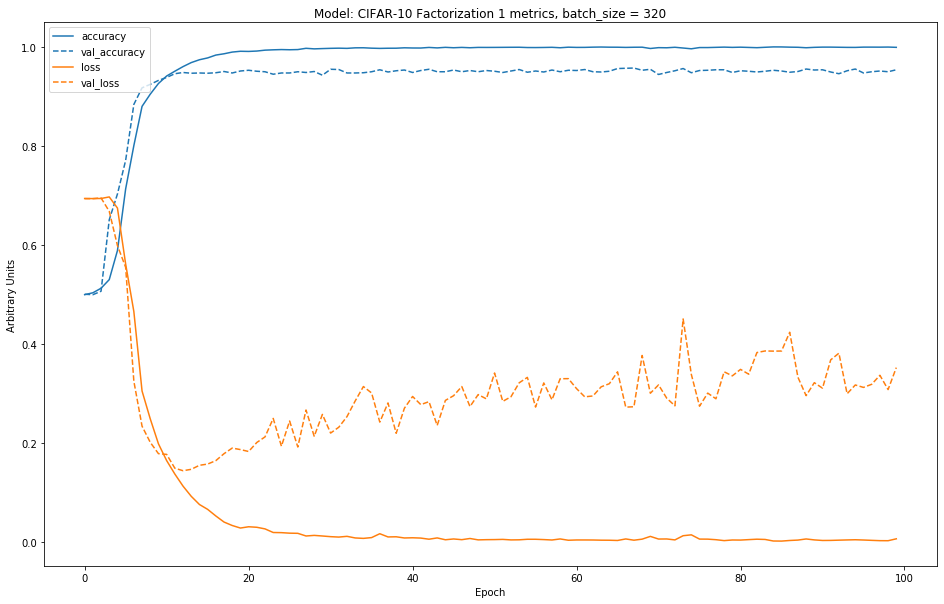

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 2...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 475us/sample - loss: 0.6991 - accuracy: 0.5056 - val_loss: 0.6929 - val_accuracy: 0.5080
Epoch 2/100
16000/16000 [==============================] - 7s 430us/sample - loss: 0.6934 - accuracy: 0.5002 - val_loss: 0.6929 - val_accuracy: 0.4995
Epoch 3/100
16000/16000 [==============================] - 7s 430us/sample - loss: 0.6933 - accuracy: 0.5184 - val_loss: 0.6873 - val_accuracy: 0.5325
Epoch 4/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6885 - accuracy: 0.5241 - val_loss: 0.6853 - val_accuracy: 0.5020
Epoch 5/100
16000/16000 [==============================] - 7s 430us/sample - loss: 0.6598 - accuracy: 0.6057 - val_loss: 0.6361 - val_accuracy: 0.6530
Epoch 6/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6583 - accuracy: 0.6102 - val_loss: 0.6125 - val_accuracy: 0.6935
Epoch 7/100
16000/16000 [

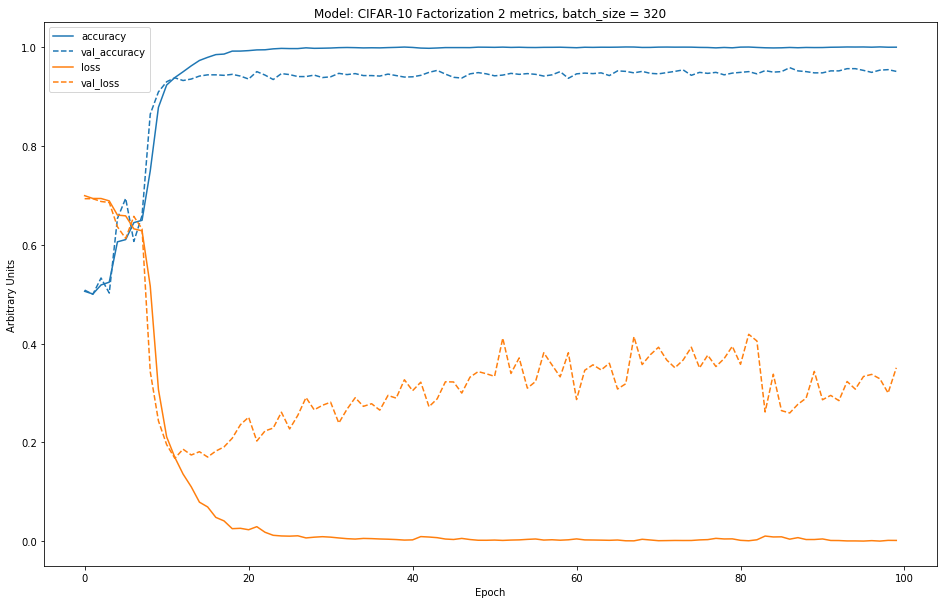

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 3...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 473us/sample - loss: 0.6937 - accuracy: 0.4967 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 2/100
16000/16000 [==============================] - 7s 427us/sample - loss: 0.6932 - accuracy: 0.4967 - val_loss: 0.6931 - val_accuracy: 0.5005
Epoch 3/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6931 - accuracy: 0.4906 - val_loss: 0.6930 - val_accuracy: 0.4995
Epoch 4/100
16000/16000 [==============================] - 7s 427us/sample - loss: 0.6932 - accuracy: 0.4994 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 5/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6932 - accuracy: 0.4981 - val_loss: 0.6930 - val_accuracy: 0.5005
Epoch 6/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6931 - accuracy: 0.4983 - val_loss: 0.6927 - val_accuracy: 0.5035
Epoch 7/100
16000/16000 [

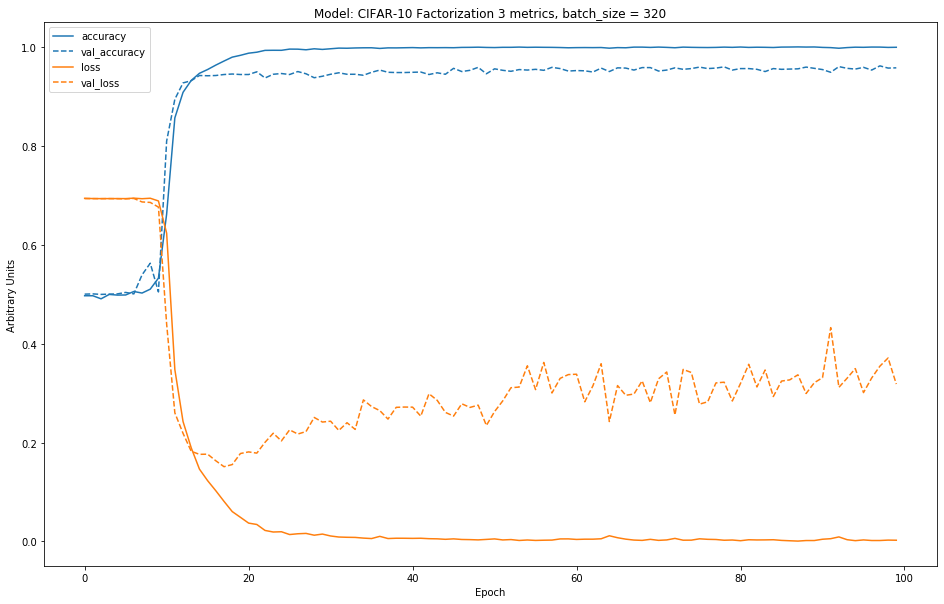

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 4...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 474us/sample - loss: 0.7220 - accuracy: 0.5249 - val_loss: 0.6926 - val_accuracy: 0.5030
Epoch 2/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6951 - accuracy: 0.5052 - val_loss: 0.6932 - val_accuracy: 0.5005
Epoch 3/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6931 - accuracy: 0.5001 - val_loss: 0.6931 - val_accuracy: 0.5005
Epoch 4/100
16000/16000 [==============================] - 7s 427us/sample - loss: 0.6932 - accuracy: 0.5011 - val_loss: 0.6920 - val_accuracy: 0.5010
Epoch 5/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6887 - accuracy: 0.5189 - val_loss: 0.6849 - val_accuracy: 0.5650
Epoch 6/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6904 - accuracy: 0.5260 - val_loss: 0.6801 - val_accuracy: 0.5870
Epoch 7/100
16000/16000 [

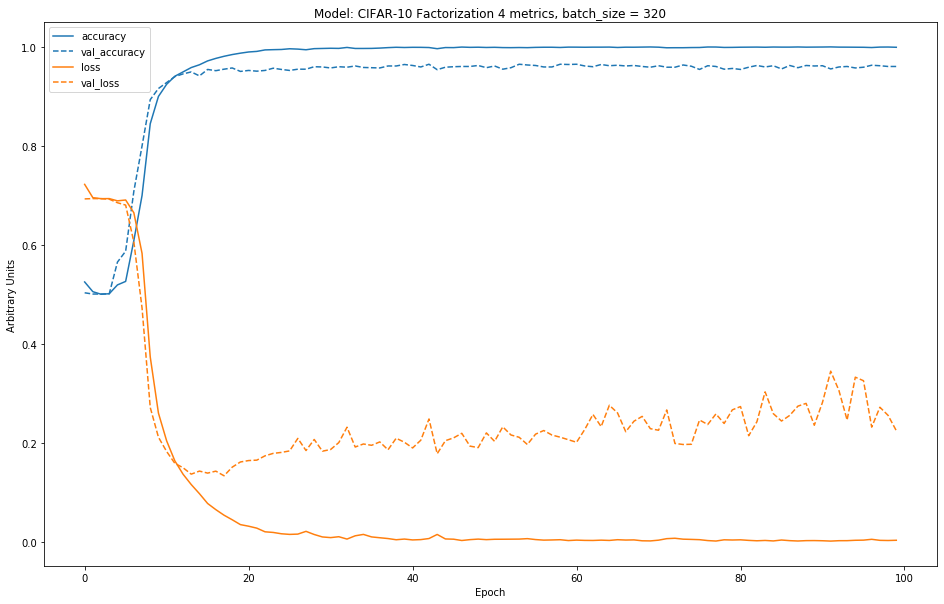

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 5...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 472us/sample - loss: 0.6942 - accuracy: 0.5038 - val_loss: 0.6934 - val_accuracy: 0.5000
Epoch 2/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6933 - accuracy: 0.4949 - val_loss: 0.6931 - val_accuracy: 0.5005
Epoch 3/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6936 - accuracy: 0.5089 - val_loss: 0.6893 - val_accuracy: 0.5260
Epoch 4/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6857 - accuracy: 0.5541 - val_loss: 0.6497 - val_accuracy: 0.6670
Epoch 5/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.5455 - accuracy: 0.7322 - val_loss: 0.3626 - val_accuracy: 0.8660
Epoch 6/100
16000/16000 [==============================] - 7s 430us/sample - loss: 0.2710 - accuracy: 0.8963 - val_loss: 0.2165 - val_accuracy: 0.9185
Epoch 7/100
16000/16000 [

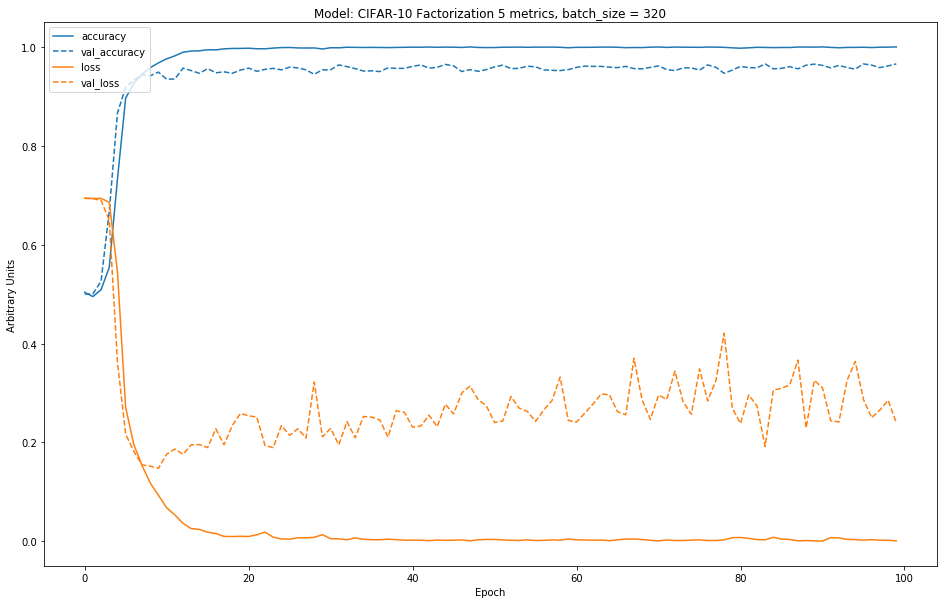

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 6...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 494us/sample - loss: 0.6936 - accuracy: 0.5022 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 2/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6938 - accuracy: 0.5001 - val_loss: 0.6920 - val_accuracy: 0.5105
Epoch 3/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6896 - accuracy: 0.5271 - val_loss: 0.6779 - val_accuracy: 0.5025
Epoch 4/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6745 - accuracy: 0.5786 - val_loss: 0.6180 - val_accuracy: 0.6835
Epoch 5/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.5986 - accuracy: 0.6924 - val_loss: 0.5245 - val_accuracy: 0.7420
Epoch 6/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.3707 - accuracy: 0.8450 - val_loss: 0.2391 - val_accuracy: 0.9060
Epoch 7/100
16000/16000 [

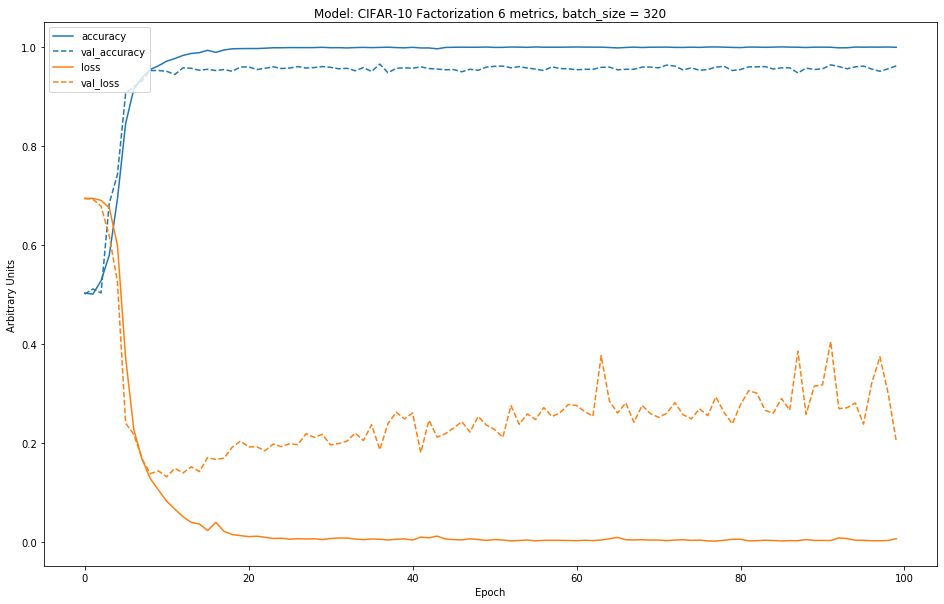

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 7...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 476us/sample - loss: 0.6943 - accuracy: 0.4956 - val_loss: 0.6931 - val_accuracy: 0.5005
Epoch 2/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6932 - accuracy: 0.5015 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 3/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6931 - accuracy: 0.4958 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 4/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6933 - accuracy: 0.4954 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 5/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6932 - accuracy: 0.4948 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 6/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6932 - accuracy: 0.4998 - val_loss: 0.6931 - val_accuracy: 0.5005
Epoch 7/100
16000/16000 [

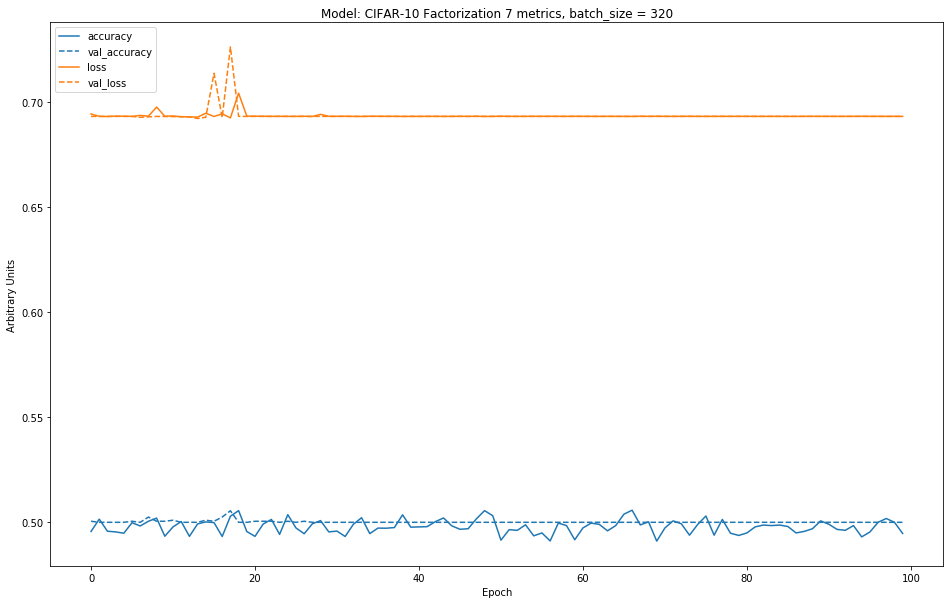

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 8...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 475us/sample - loss: 0.6932 - accuracy: 0.5050 - val_loss: 0.6929 - val_accuracy: 0.5255
Epoch 2/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6949 - accuracy: 0.5045 - val_loss: 0.6936 - val_accuracy: 0.5000
Epoch 3/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6934 - accuracy: 0.5013 - val_loss: 0.6941 - val_accuracy: 0.5000
Epoch 4/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6935 - accuracy: 0.4988 - val_loss: 0.6930 - val_accuracy: 0.5020
Epoch 5/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6938 - accuracy: 0.5091 - val_loss: 0.6918 - val_accuracy: 0.5060
Epoch 6/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.6911 - accuracy: 0.5046 - val_loss: 0.6896 - val_accuracy: 0.5970
Epoch 7/100
16000/16000 [

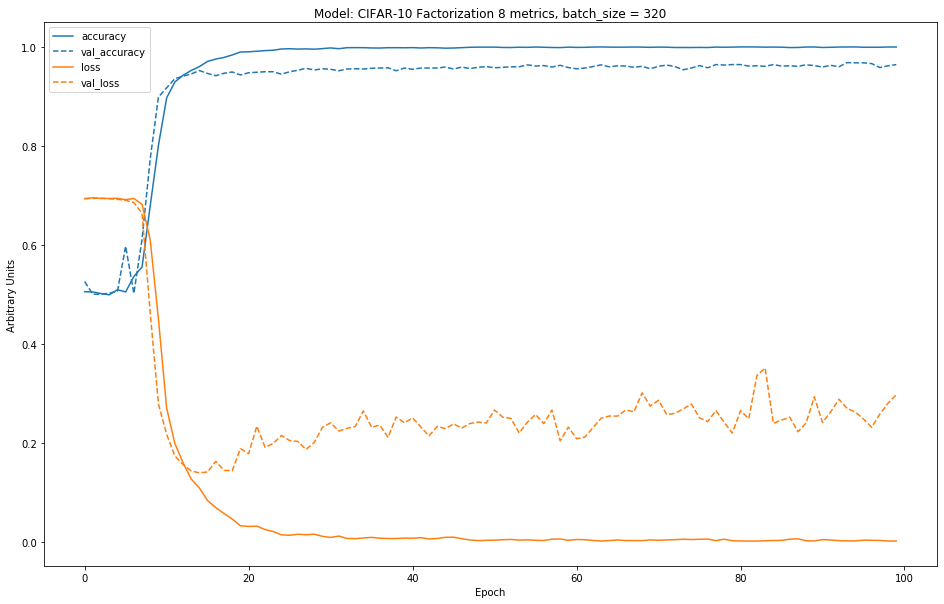

Converting training epochs plots to ROOT...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:201: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


Creating model 9...
Train on 16000 samples, validate on 2000 samples
Epoch 1/100
16000/16000 [==============================] - 8s 474us/sample - loss: 0.6936 - accuracy: 0.4975 - val_loss: 0.6931 - val_accuracy: 0.5005
Epoch 2/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6930 - accuracy: 0.5096 - val_loss: 0.7469 - val_accuracy: 0.5000
Epoch 3/100
16000/16000 [==============================] - 7s 428us/sample - loss: 0.6842 - accuracy: 0.5579 - val_loss: 0.6595 - val_accuracy: 0.6420
Epoch 4/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.5834 - accuracy: 0.6886 - val_loss: 0.2993 - val_accuracy: 0.8920
Epoch 5/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.3236 - accuracy: 0.8686 - val_loss: 0.2390 - val_accuracy: 0.9065
Epoch 6/100
16000/16000 [==============================] - 7s 429us/sample - loss: 0.2142 - accuracy: 0.9191 - val_loss: 0.1991 - val_accuracy: 0.9245
Epoch 7/100
16000/16000 [

In [0]:
def evaluate_architecture(model,name,opt=Adam(),batch_size=320,numEpochs=100,iterations=10,verbosity=1):
  #################################### Stability (changing all layers) ########################################
  metrics = [ [], [], [],  [ [], [], [] ],  [ [], [], [] ]  ]
  minimum = 1
  maximum = iterations+1
  step = 1
  batch = batch_size
  name = str(name)
  chdir('/content/gdrive/My Drive/')
  # rmtree(name)
  listdir()
  mkdir(name)
  listdir()
  chdir(name)
  for n in range(minimum,maximum,step):
    print("Creating model "+str((n - minimum + 1))+"...")
    
    ############################################### TensorFlow Example Architecture ###########################################
    # check out https://www.tensorflow.org/tutorials/images/cnn
    # # CNN takes 3 dimensional tensor input (image height, image width, color channel)
    # model = models.Sequential()
    # # Padding='same' significantly improves results
    # # model.add(layers.Masking(mask_value=0.1, input_shape=(48, 144, 1)))
    # model.add(layers.Conv2D(32, (3, 3), strides=(1,1), padding='same', activation='relu', input_shape=(48, 144, 1)))
    # model.add(layers.MaxPooling2D((2, 2)))
    # model.add(layers.Conv2D(64, (3, 3), strides=(1,1), activation='relu'))
    # model.add(layers.MaxPooling2D((2, 2)))
    # model.add(layers.Conv2D(64, (3, 3), strides=(1,1), activation='relu'))
    # model.add(layers.Flatten())
    # # model.add(layers.Dropout(0.1))
    # model.add(layers.Dense(64, activation='relu'))
    # # model.add(layers.Dropout(0.1))
    # # Final layer must have two outputs since we are distinguishing between only two particles
    # model.add(layers.Dense(2, activation='softmax'))

    # # Print CNN Architecture
    # model.summary()

    # # Train CNN
    # model.compile(optimizer='adam',
    #               loss='sparse_categorical_crossentropy',
    #               metrics=['accuracy'])

    ################################### Simple CNN for CIFAR-10 Dataset, use Adam Optimizer #######################################
    # Check out https://keras.io/examples/cifar10_resnet/ for examples of this architecture and others
    # num_classes = 2
    # model = models.Sequential()
    # model.add(Conv2D(32, (3, 3), padding='same',
    #                 input_shape=(48, 144, 1)))
    # model.add(Activation('relu'))
    # model.add(Conv2D(32, (3, 3)))
    # model.add(Activation('relu'))
    # model.add(MaxPooling2D(pool_size=(2, 2)))
    # model.add(Dropout(0.25))

    # model.add(Conv2D(64, (3, 3), padding='same'))
    # model.add(Activation('relu'))
    # model.add(Conv2D(64, (3, 3)))
    # model.add(Activation('relu'))
    # model.add(MaxPooling2D(pool_size=(2, 2)))
    # model.add(Dropout(0.25))

    # model.add(Flatten())
    # model.add(Dense(512))
    # model.add(Activation('relu'))
    # model.add(Dropout(0.5))
    # model.add(Dense(num_classes))
    # model.add(Activation('softmax'))

    # initiate RMSprop optimizer
    # opt = tf.keras.optimizers.RMSprop(learning_rate=0.0001, decay=1e-6)

    ####################################### Try Bottleneck Layers ############################################
    # num_classes = 2
    # model = models.Sequential()
    # model.add(Conv2D(32, (3, 3), padding='same',
    #                 input_shape=(48, 144, 1)))
    # model.add(Activation('relu'))
    # model.add(Conv2D(32, (3, 3)))
    # model.add(Activation('relu'))
    # model.add(MaxPooling2D(pool_size=(2, 2)))
    # model.add(Dropout(0.25))

    # model.add(Conv2D(64, (3, 3), padding='same'))
    # model.add(Activation('relu'))
    # model.add(Conv2D(64, (1, 1))) # Bottleneck layers
    # model.add(Conv2D(64, (3, 3))) # ...
    # model.add(Conv2D(64, (1, 1))) # ...
    # model.add(Activation('relu'))
    # model.add(MaxPooling2D(pool_size=(2, 2)))
    # model.add(Dropout(0.25))

    # model.add(Flatten())
    # model.add(Dense(512))
    # model.add(Activation('relu'))
    # model.add(Dropout(0.5))
    # model.add(Dense(num_classes))
    # model.add(Activation('softmax'))

    #################################### Try Factorization Layers #########################################
    num_classes = 2
    model = models.Sequential()
    model.add(Conv2D(32, (3, 3), padding='same',
                    input_shape=(48, 144, 1)))
    model.add(Activation('relu'))
    model.add(Conv2D(64, (1, 3))) # Factorization layers
    model.add(Conv2D(64, (3, 1))) # ...
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    model.add(Conv2D(64, (3, 3), padding='same'))
    model.add(Activation('relu'))
    model.add(Conv2D(64, (1, 3))) # Factorization layers
    model.add(Conv2D(64, (3, 1))) # ...
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(num_classes))
    model.add(Activation('softmax'))
    #####################################################################################################################
    # Write architecture summary to file
    outF = open(name+"_summary.txt", "w")
    def myFunc(text):
      outF.write(text+'\n')
    model.summary(print_fn=myFunc)
    outF.close()
    if verbosity = 1:
      model.summary()

    # Compile Model
    model.compile(loss='sparse_categorical_crossentropy',
                  optimizer=opt, # adam optimizer has significantly better results than the RMSprop with batch=320
                  metrics=['accuracy'])

    # Fit Model
    history = model.fit(data_train_images, target_train_images, epochs=numEpochs, verbose=verbosity, batch_size=batch, validation_data=(data_val_images,target_val_images)) #, steps_per_epoch=100

    # Accuracy and Loss for CNN
    results = model.evaluate(data_test_images, target_test_images, batch_size=batch, verbose=verbosity)
    print(len(results))
    metrics[0].append(n)
    metrics[1].append(results[0])
    metrics[2].append(results[1])

    # Plot metrics and save in a .png file
    f = plt.figure(figsize=(16,10))
    val = plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'],'--', color=val[0].get_color())
    val = plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'],'--', color=val[0].get_color())
    #val = plt.plot(history.history['mse']) 
    #plt.plot(history.history['val_mse'],'--', color=val[0].get_color())
    plt.title('Model: '+name+' '+str(n)+' metrics, batch_size = '+str(batch))
    plt.ylabel('Arbitrary Units')
    plt.xlabel('Epoch')
    plt.legend(['accuracy', 'val_accuracy','loss', 'val_loss'], loc='upper left')
    plt.show()
    f.savefig("epochs_metrics"+str(n)+".png")

    # Convert accuracy and loss plots into ROOT histograms
    print("Converting training epochs plots to ROOT...")
    epochs = np.array([i for i in range(numEpochs)])

    file = uproot.recreate("epochs_accuracy.root", compression=uproot.ZLIB(4))
    file["acc"] = np.histogram2d(history.history['accuracy'],epochs)

    file = uproot.recreate("epochs_val_accuracy.root", compression=uproot.ZLIB(4))
    file["val_acc"] = np.histogram2d(history.history['val_accuracy'],epochs)

    file = uproot.recreate("epochs_loss.root", compression=uproot.ZLIB(4))
    file["loss"] = np.histogram2d(history.history['loss'],epochs)

    file = uproot.recreate("epochs_val_loss.root", compression=uproot.ZLIB(4))
    file["val_loss"] = np.histogram2d(history.history['val_loss'],epochs)
    
    ###################  Stability Evaluation  #################

    # Evaluate performance by comparing test and training classifier (model) response
    decisions = []
    for (X,y) in ((data_train_images, target_train_images), (data_test_images, target_test_images)):
      d1 = model.predict_proba(X[y>0.5])[:,1].ravel()
      d2 = model.predict_proba(X[y<0.5])[:,1].ravel()
      decisions += [d1, d2]
    
    ################  Find Purity and Chi2  ################  
    
    # set histogram parameters
    bins = 100
    low = min(np.min(d) for d in decisions)
    high = max(np.max(d) for d in decisions)
    low_high = (low,high)

    # make test and train decisions histograms for kaon
    hist_kaon_test, bins = np.histogram( decisions[0], bins=bins, range=low_high, density=False)
    hist_kaon_train, bins = np.histogram( decisions[2], bins=bins, range=low_high, density=False)
    
    # find chi2 values and error for kaon
    hist_kaon_chi2 = np.nan_to_num(np.divide(np.square(np.subtract(hist_kaon_test, hist_kaon_train)),np.add(hist_kaon_test,hist_kaon_train)))
    scale = len(decisions[2]) / sum(hist_kaon_chi2)
    err_kaon = np.sqrt(hist_kaon_chi2 * scale) / scale
    
    # make test and train decisions histograms for pion
    hist_pion_test, bins = np.histogram( decisions[1], bins=bins, range=low_high, density=False)
    hist_pion_train, bins = np.histogram( decisions[3], bins=bins, range=low_high, density=False)
    
    # find chi2 values and error for pion
    hist_pion_chi2 = np.nan_to_num(np.divide(np.square(np.subtract(hist_pion_test, hist_pion_train)),np.add(hist_pion_test,hist_pion_train)))
    scale = len(decisions[2]) / sum(hist_pion_chi2)
    err_pion = np.sqrt(hist_pion_chi2 * scale) / scale
    
    # find chi2 for kaon and pion and total
    chi2_kaon = sum(hist_kaon_chi2)
    chi2_pion = sum(hist_pion_chi2)
    chi2_total = chi2_kaon + chi2_pion
    err_total = math.sqrt(sum(err_kaon**2 + err_pion**2))
    metrics[3][0].append(chi2_kaon)
    metrics[3][1].append(chi2_pion)
    metrics[3][2].append(chi2_total)
    metrics[4][0].append(err_kaon)
    metrics[4][1].append(err_pion)
    metrics[4][2].append(err_total)


  ################  Plot Purity and Chi2  ################
  print("Plotting purity and \u03C7\u00b2")

  # Plot accuracy
  f = plt.figure()
  plt.plot(metrics[0],metrics[1],'b.', scaley = False)
  plt.title("Model: "+name+", Accuracy, batch_size = "+str(batch))
  plt.xlabel("Iteration")
  plt.ylabel("Arbitrary units")
  plt.show()
  f.savefig("stability_acc.png")

  # Plot loss
  f = plt.figure()
  plt.plot(metrics[0],metrics[2],'b.', scaley = False)
  plt.title("Model: "+name+", Loss, batch_size = "+str(batch))
  plt.xlabel("Iteration")
  plt.ylabel("Arbitrary units")
  plt.show()
  f.savefig("stability_loss.png")

  # Plot kaon chi2
  f = plt.figure()
  plt.plot(metrics[0],metrics[3][0],'b.')
  plt.title("Model: "+name+", Kaon \u03C7\u00b2, batch_size = "+str(batch))
  plt.xlabel("Iteration")
  plt.ylabel("Arbitrary units")
  plt.show()
  f.savefig("stability_chi2_kaon.png")

  # Plot pion chi2
  f = plt.figure()
  plt.plot(metrics[0],metrics[3][1],'b.')
  plt.title("Model: "+name+", Pion \u03C7\u00b2, batch_size = "+str(batch))
  plt.xlabel("Iteration")
  plt.ylabel("Arbitrary units")
  plt.show()
  f.savefig("stability_chi2_pion.png")

  # Plot total chi2
  f = plt.figure()
  plt.plot(metrics[0],metrics[3][2],'b.')
  plt.title("Model: "+name+", Total \u03C7\u00b2, Layers = 32, batch_size = "+str(batch))
  plt.xlabel("Iteration")
  plt.ylabel("Arbitrary units")
  plt.show()
  f.savefig("stability_chi2_tot.png")
    
  # Convert accuracy and loss plots into ROOT histograms
  print("Converting stability plots to ROOT...")

  file = uproot.recreate("stability_acc.root", compression=uproot.ZLIB(4))
  file["acc"] = np.histogram2d(metrics[0],metrics[1])

  file = uproot.recreate("stability_loss.root", compression=uproot.ZLIB(4))
  file["loss"] = np.histogram2d(metrics[0],metrics[2])

  file = uproot.recreate("stability_chi2_kaon.root", compression=uproot.ZLIB(4))
  file["chi2k"] = np.histogram2d(metrics[0],metrics[3][0])

  file = uproot.recreate("stability_chi2_pion.root", compression=uproot.ZLIB(4))
  file["chi2p"] = np.histogram2d(metrics[0],metrics[3][1])

  file = uproot.recreate("stability_chi2_tot.root", compression=uproot.ZLIB(4))
  file["chi2t"] = np.histogram2d(metrics[0],metrics[3][2])

  # go back up to home directory
  listdir()
  chdir("..")
  listdir()


  ################################################################################################


In [0]:
# Training times callback class definition
import time
class training_times(tf.keras.callbacks.Callback):
    def __init__(self,n):
        self.times = []
        self.t0 = 0
        
    def get_times(self):
        return self.times
      
    def on_epoch_begin(self,epoch,logs = {}):
        self.t0 = time.clock()
        
    def on_epoch_end(self,epoch,logs = {}):
        t=time.clock()
        self.times.append((epoch,(t - self.t0)/10))
        
"""
    def on_train_end(self,logs = {}):
        f = plt.figure(figsize=(16,10))
        plt.xlabel('Epoch')
        plt.ylabel('Time per epoch (s)')
        plt.plot(*zip(*self.times))
        plt.show()
        f.savefig("epochs_times"+str(n)+".png")
        file = uproot.recreate("epochs_times"+str(n)+".root", compression=uproot.ZLIB(4))
        file["times"] = np.histogram2d(*zip(*self.times))
"""

'\n    def on_train_end(self,logs = {}):\n        f = plt.figure(figsize=(16,10))\n        plt.xlabel(\'Epoch\')\n        plt.ylabel(\'Time per epoch (s)\')\n        plt.plot(*zip(*self.times))\n        plt.show()\n        f.savefig("epochs_times"+str(n)+".png")\n        file = uproot.recreate("epochs_times"+str(n)+".root", compression=uproot.ZLIB(4))\n        file["times"] = np.histogram2d(*zip(*self.times))\n'

In [0]:
class CategoricalTruePositives(tf.keras.metrics.Metric):

    def __init__(self, name='categorical_true_positives', **kwargs):
      super(CategoricalTruePositives, self).__init__(name=name, **kwargs)
      self.true_positives = self.add_weight(name='tp', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
      y_pred = tf.reshape(tf.argmax(y_pred, axis=1), shape=(-1,1))
      values = tf.cast(y_true, 'int32') == tf.cast(y_pred, 'int32')
      values = tf.cast(values, 'float32')
      if sample_weight is not None:
        sample_weight = tf.cast(sample_weight, 'float32')
        values = tf.multiply(values, sample_weight)
      self.true_positives.assign_add(tf.reduce_sum(values))

    def result(self):
      return self.true_positives

    def reset_states(self):
      # The state of the metric will be reset at the start of each epoch.
      self.true_positives.assign(0.)


In [0]:
class chi2(tf.keras.metrics.Metric):

    def __init__(self, name='chi2', **kwargs):
      super(mse, self).__init__(name=name, **kwargs)
      self.true_positives = self.add_weight(name='tp', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
      y_pred = tf.reshape(tf.argmax(y_pred, axis=1), shape=(-1,1))
      values = tf.cast(y_true, 'int32') == tf.cast(y_pred, 'int32')
      values = tf.cast(values, 'float32')
      if sample_weight is not None:
        sample_weight = tf.cast(sample_weight, 'float32')
        values = tf.multiply(values, sample_weight)
      self.true_positives.assign_add(tf.reduce_sum(values))

    def result(self):
      return self.true_positives

    def reset_states(self):
      # The state of the metric will be reset at the start of each epoch.
      self.true_positives.assign(0.)



Creating model 1...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


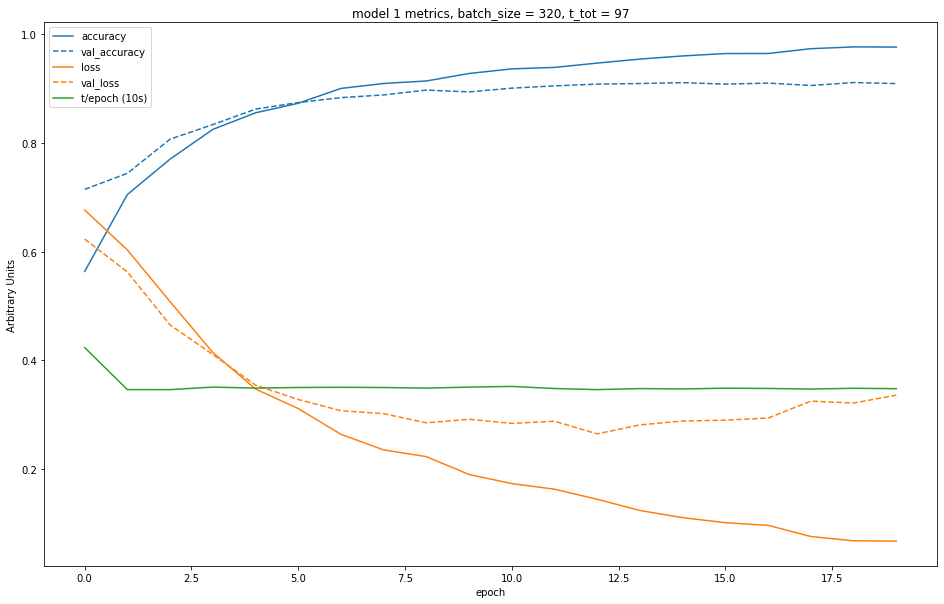

Creating model 2...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


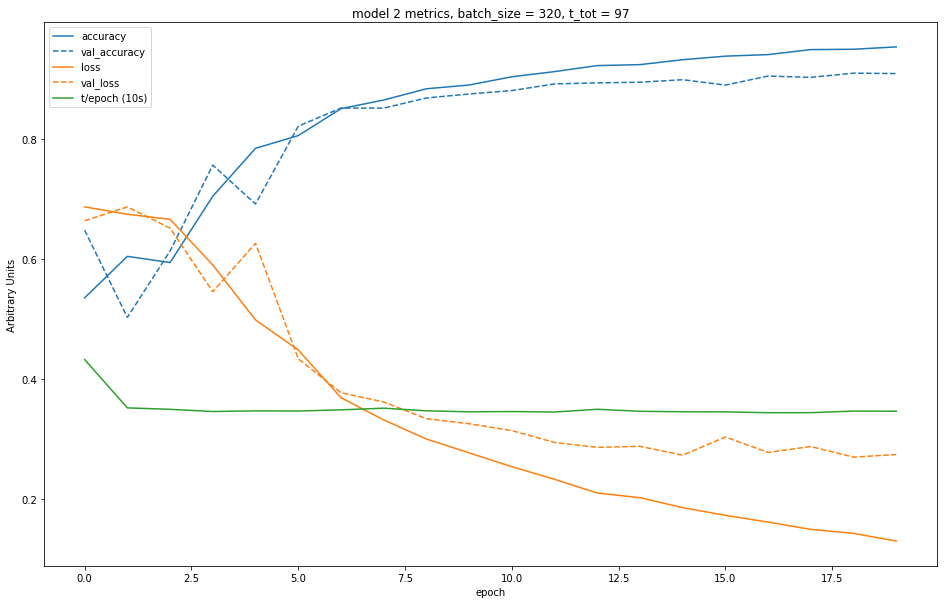

Creating model 3...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


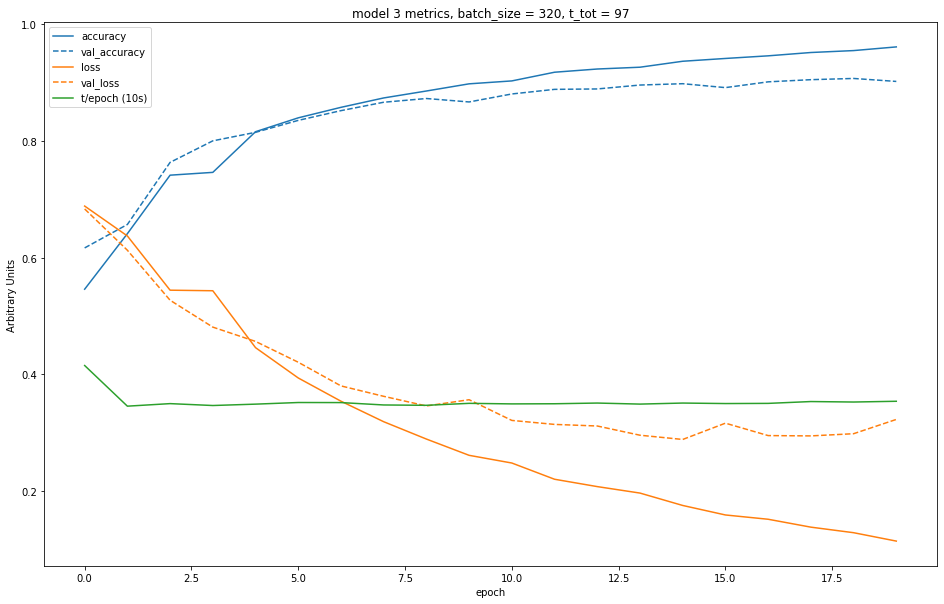

Creating model 4...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


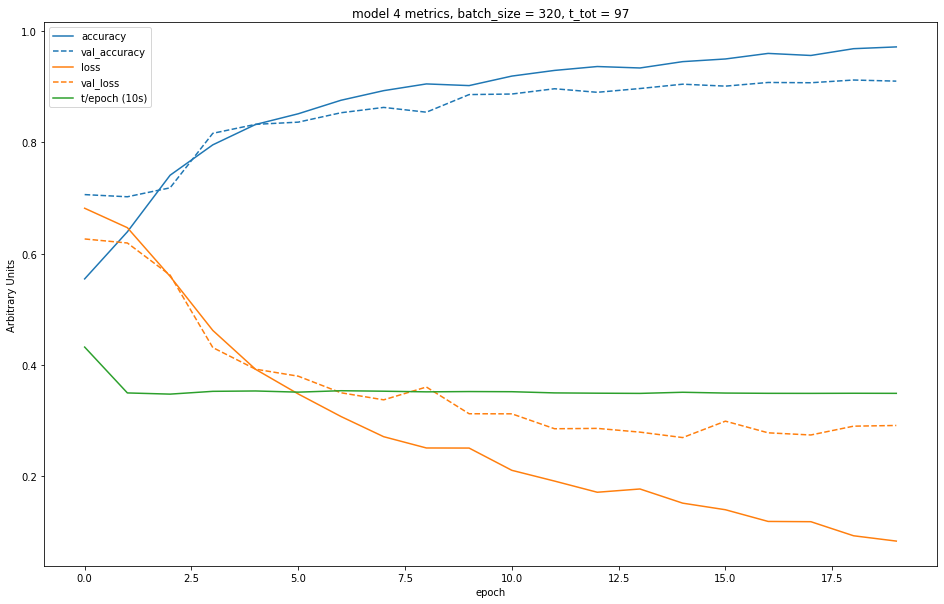

Creating model 5...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


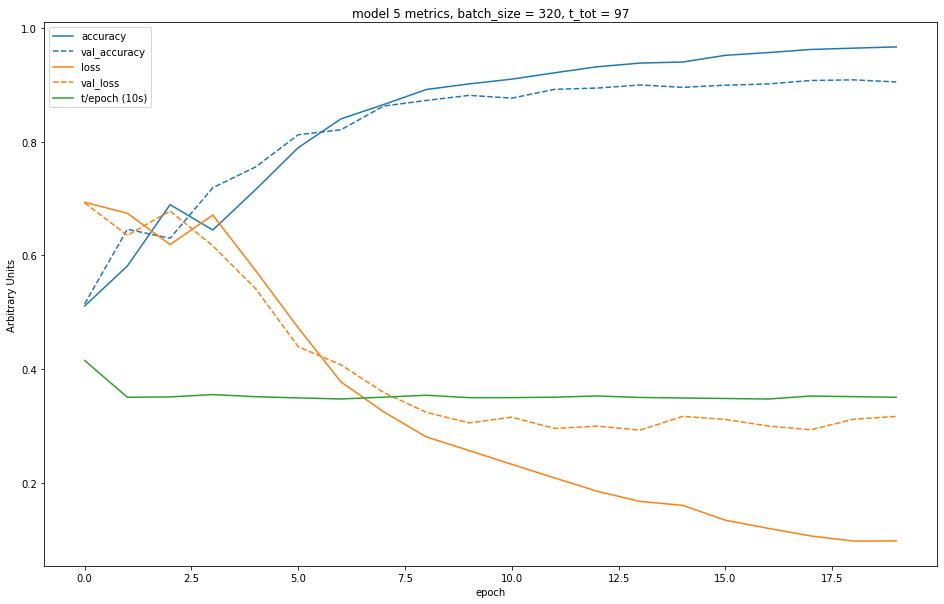

Creating model 6...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


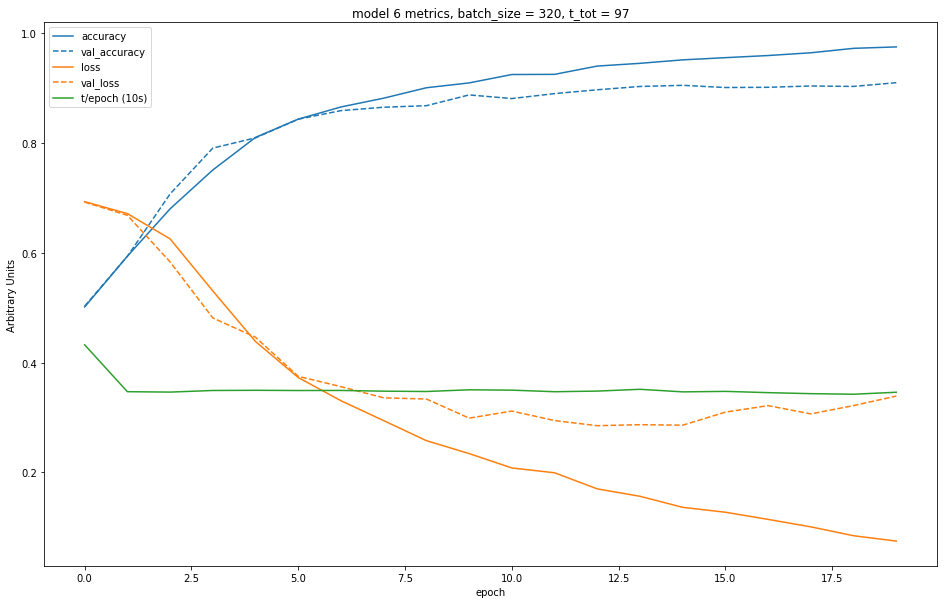

Creating model 7...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


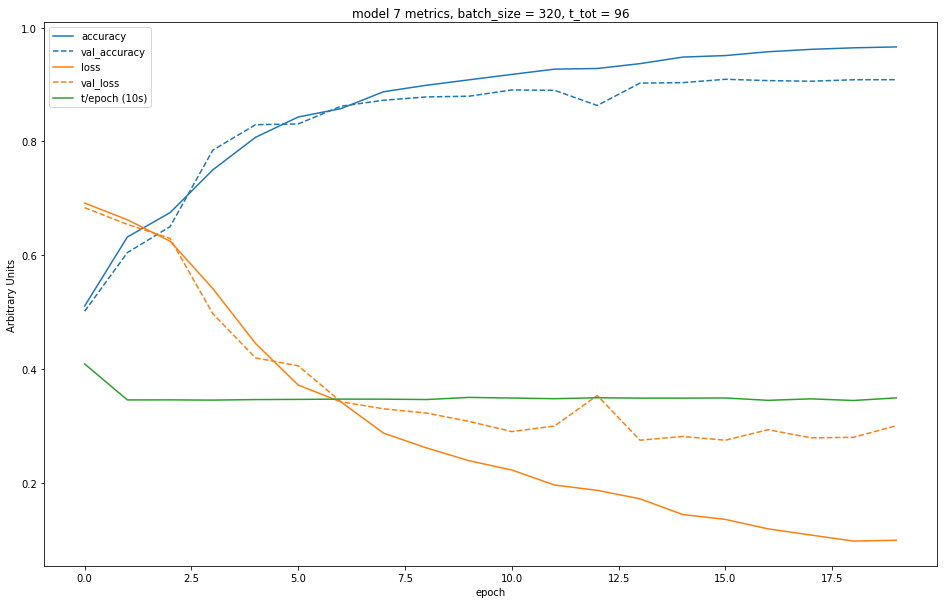

Creating model 8...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


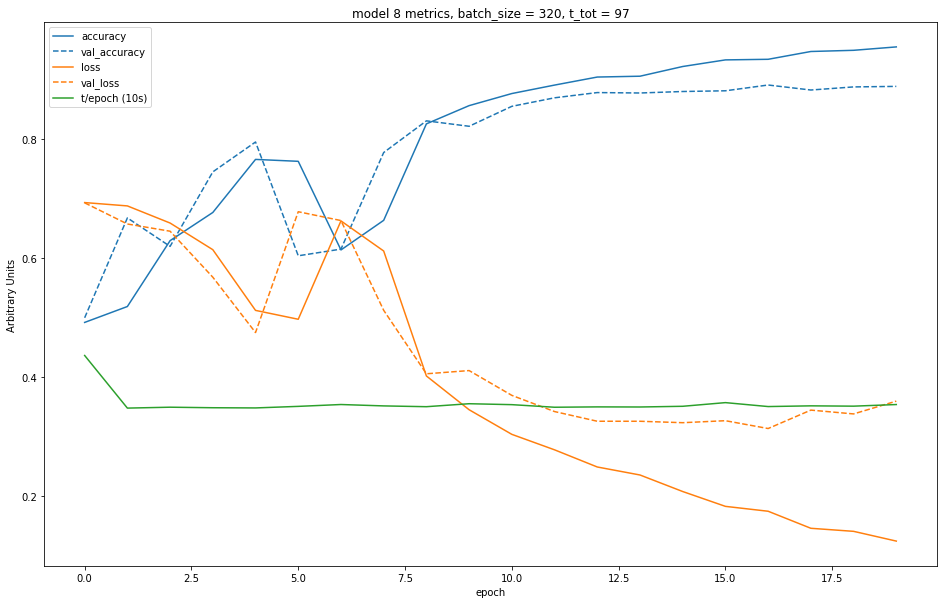

Creating model 9...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


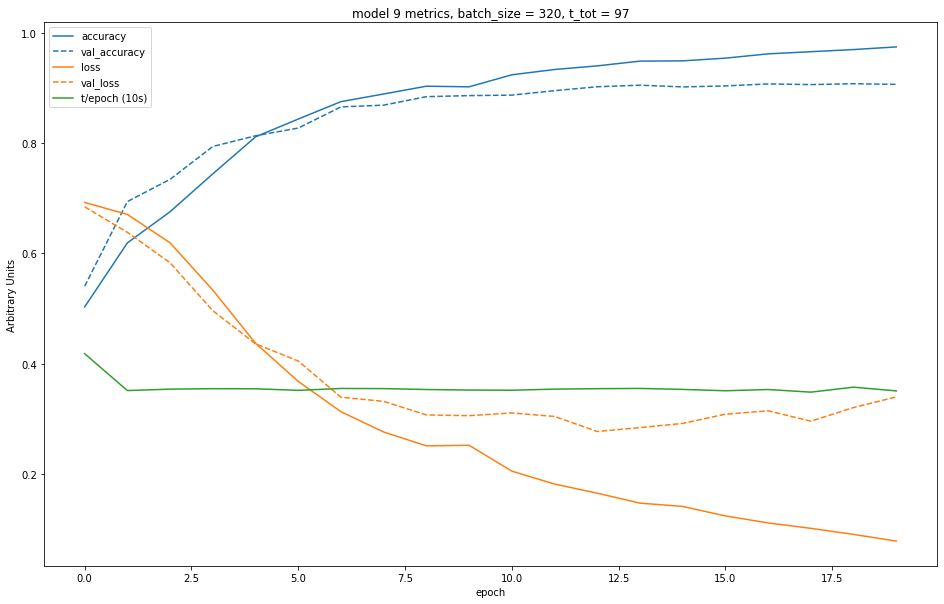

Creating model 10...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


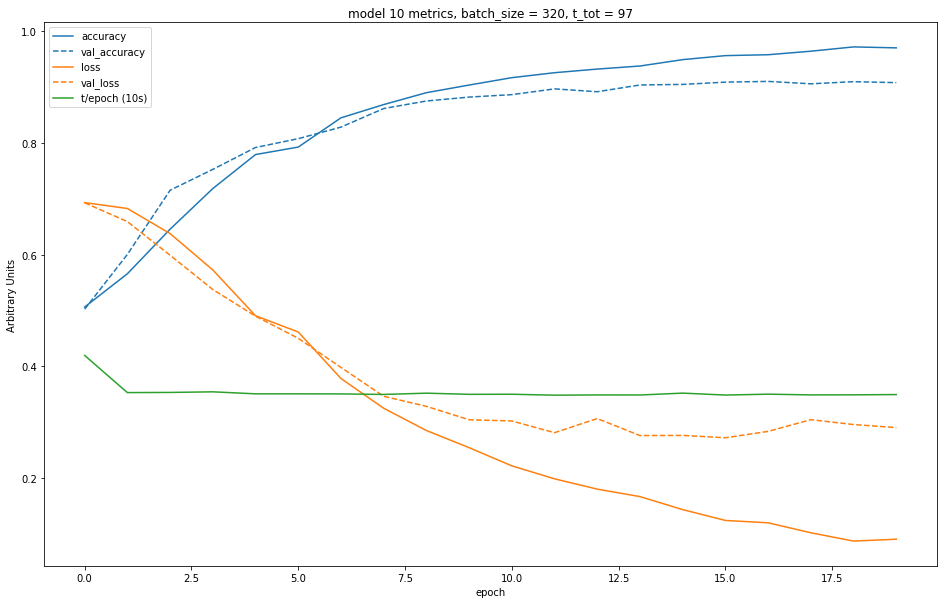

Creating model 11...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


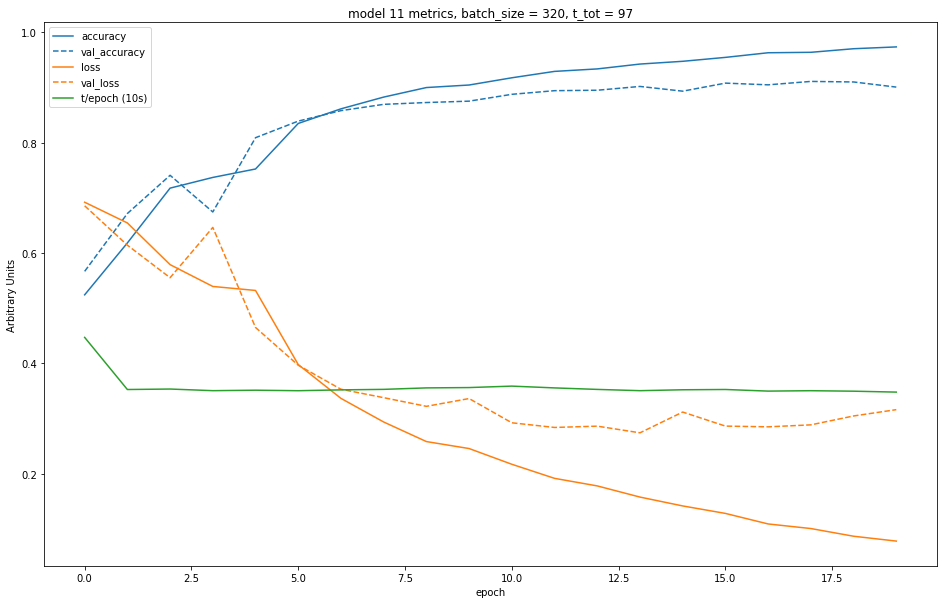

Creating model 12...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


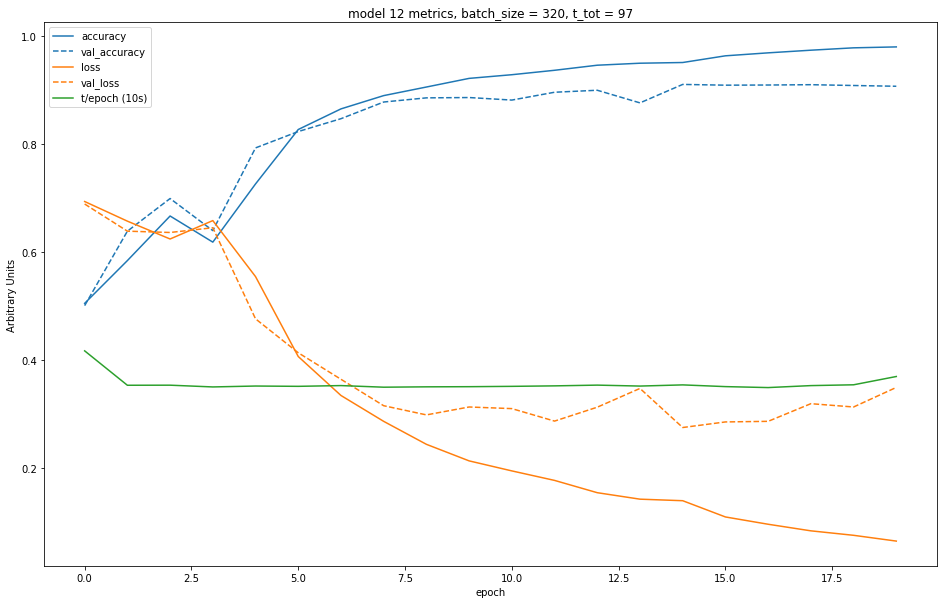

Creating model 13...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


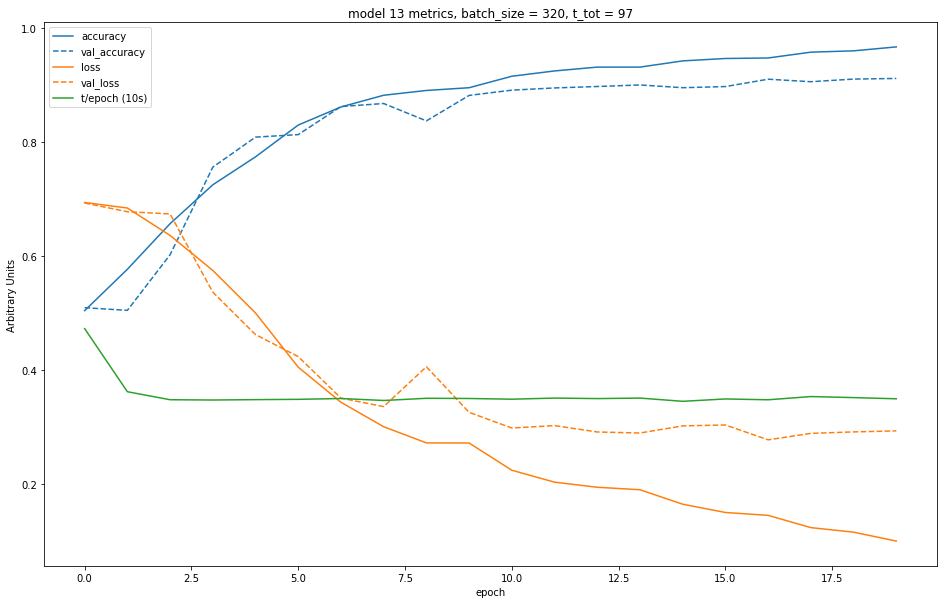

Creating model 14...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


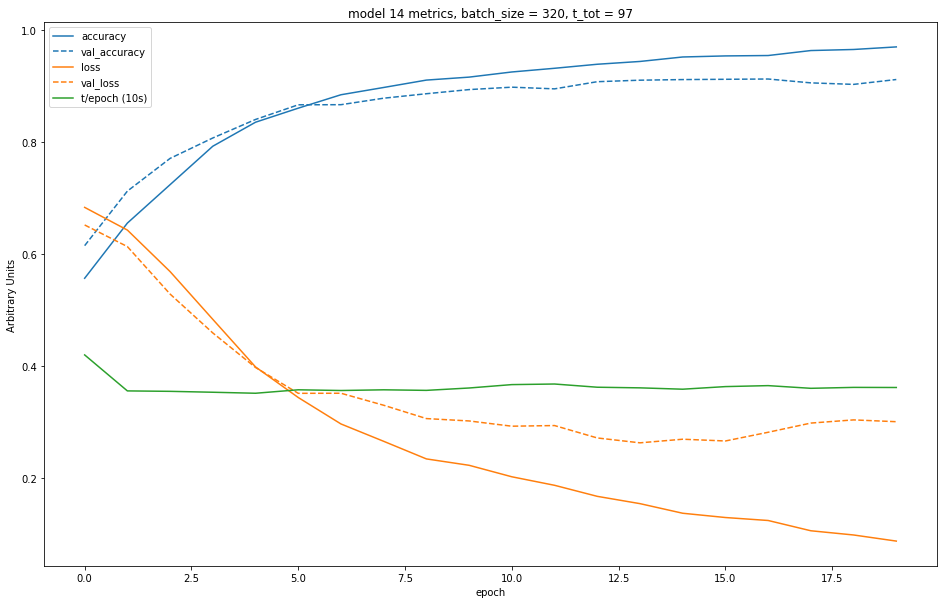

Creating model 15...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


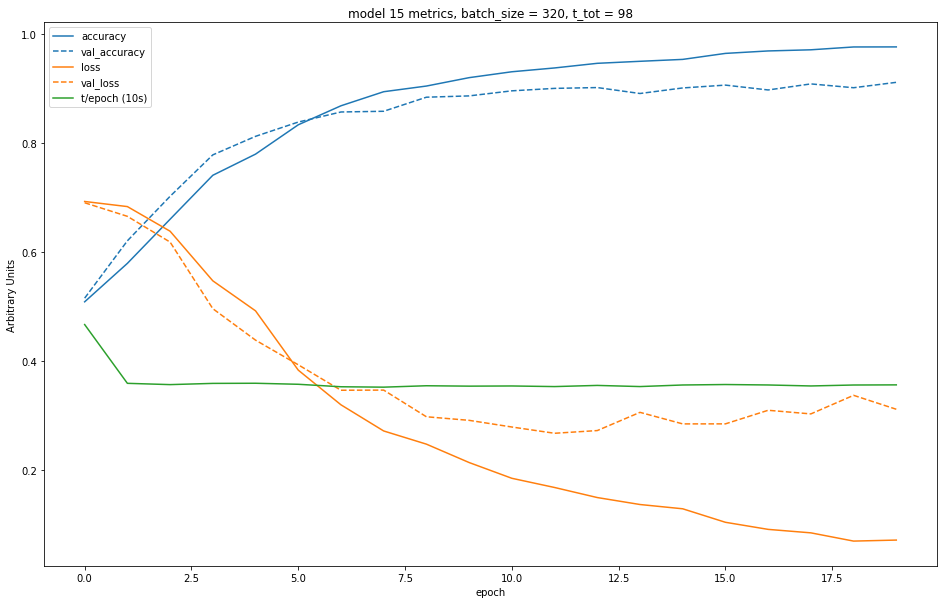

Creating model 16...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


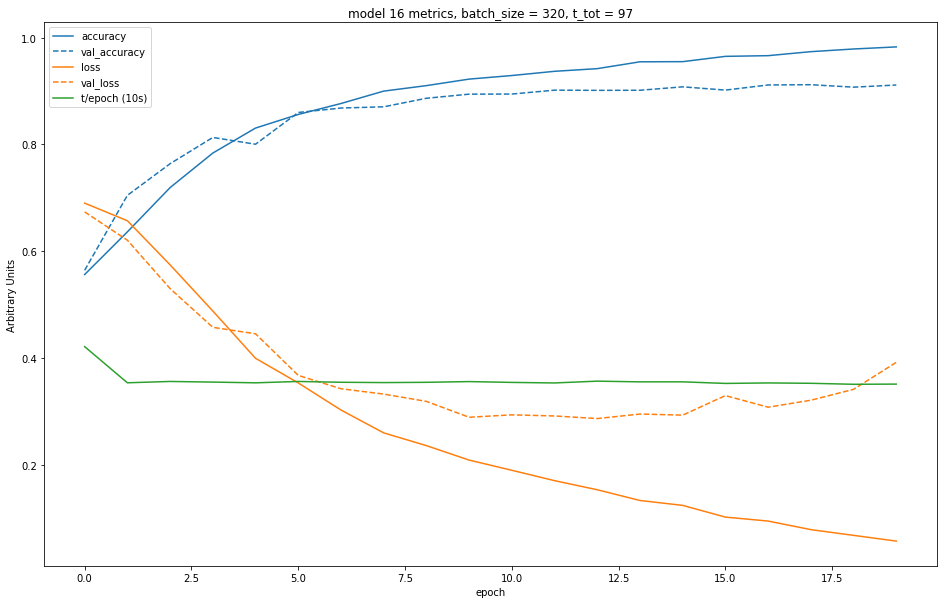

Creating model 17...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


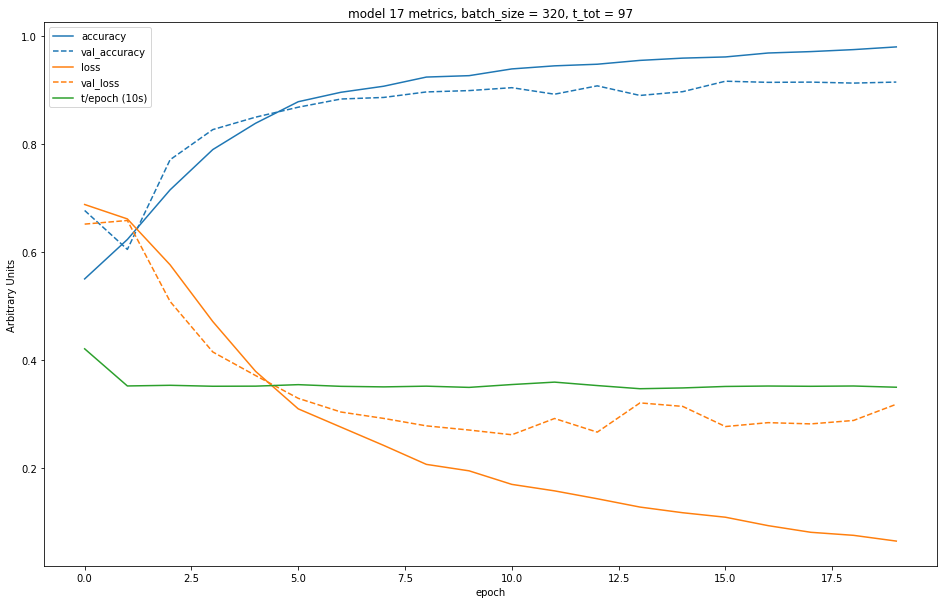

Creating model 18...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


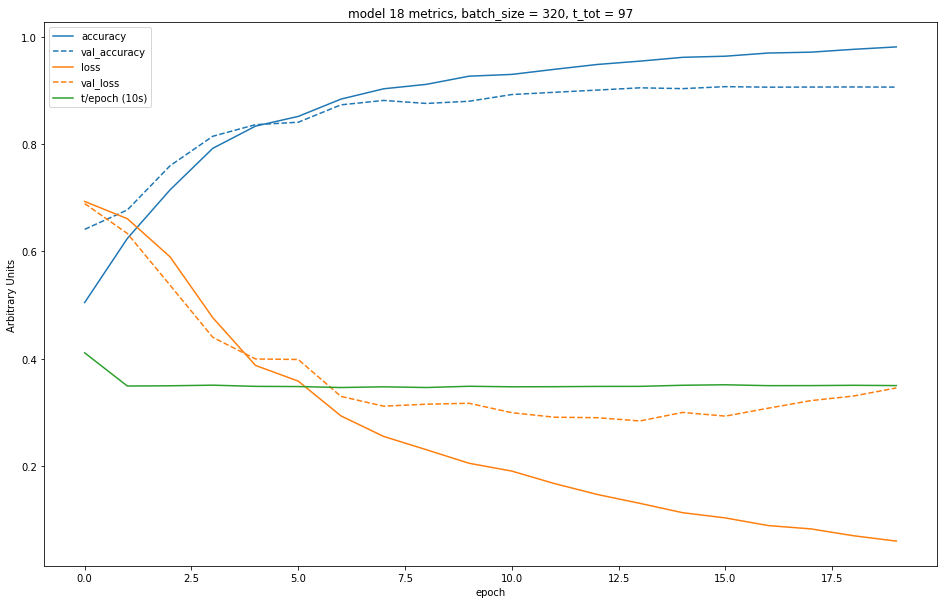

Creating model 19...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


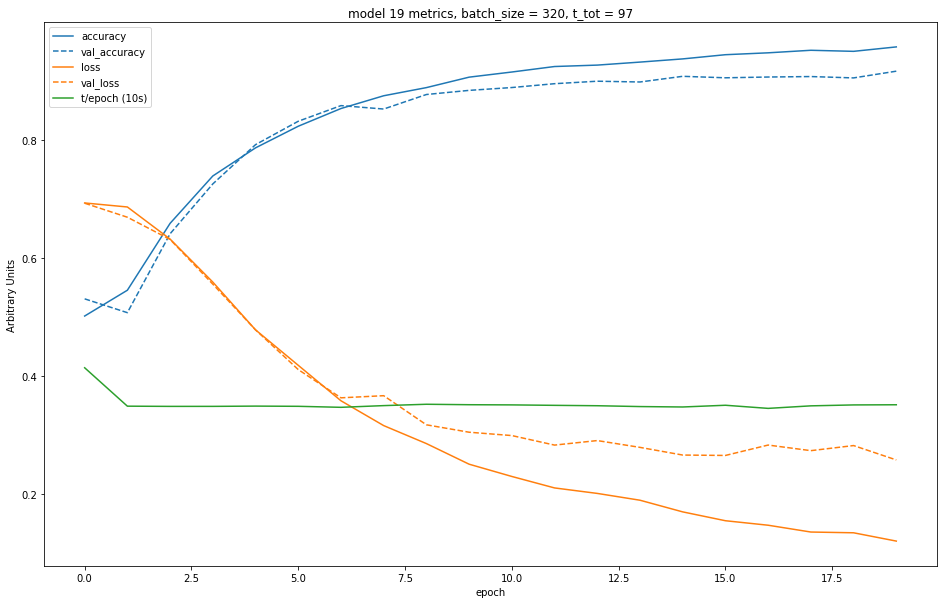

Creating model 20...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


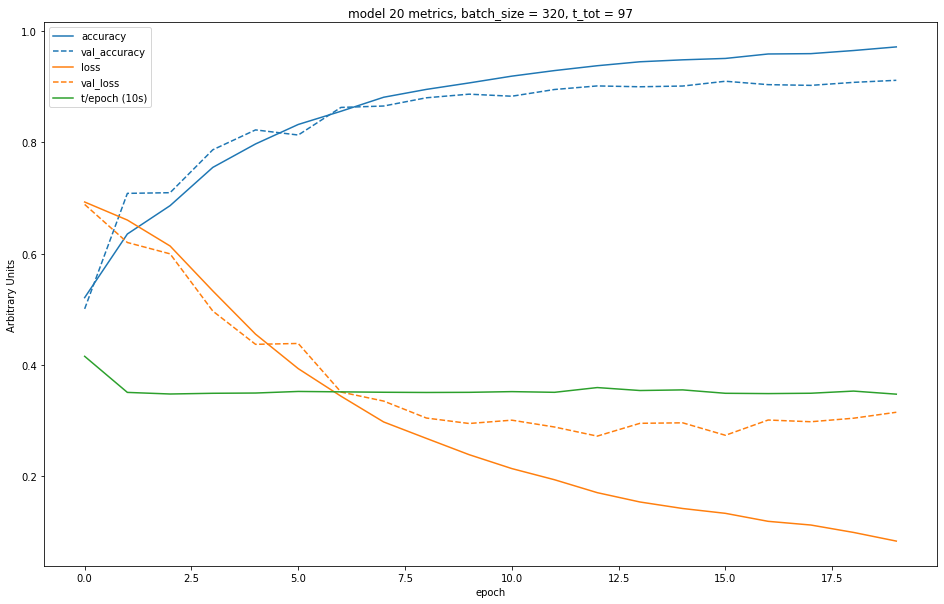

Creating model 21...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


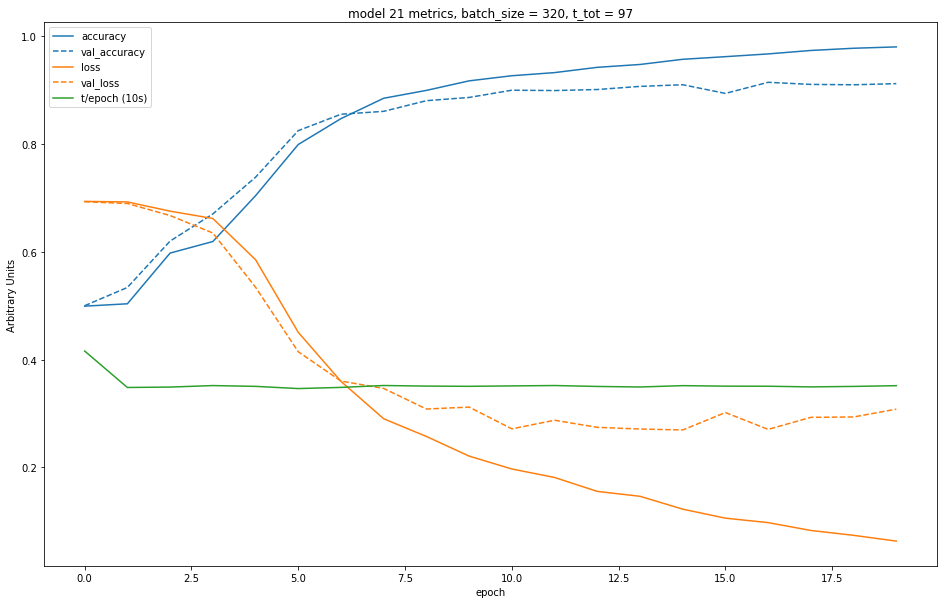

Creating model 22...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


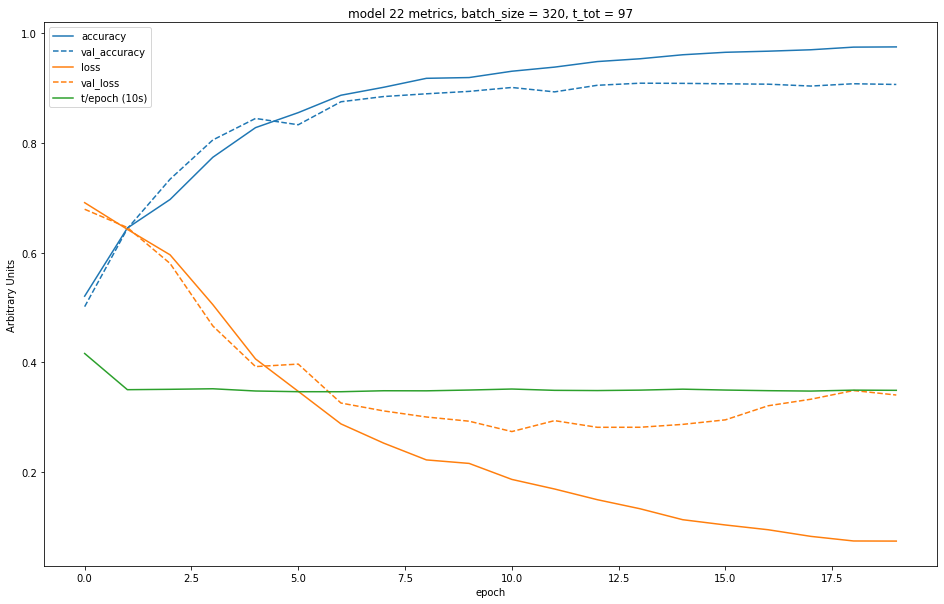

Creating model 23...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


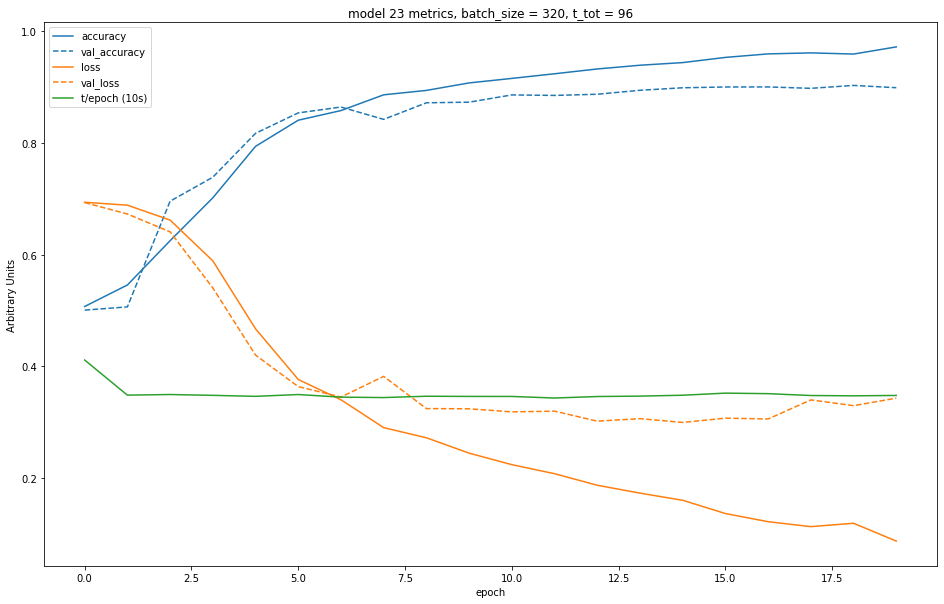

Creating model 24...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


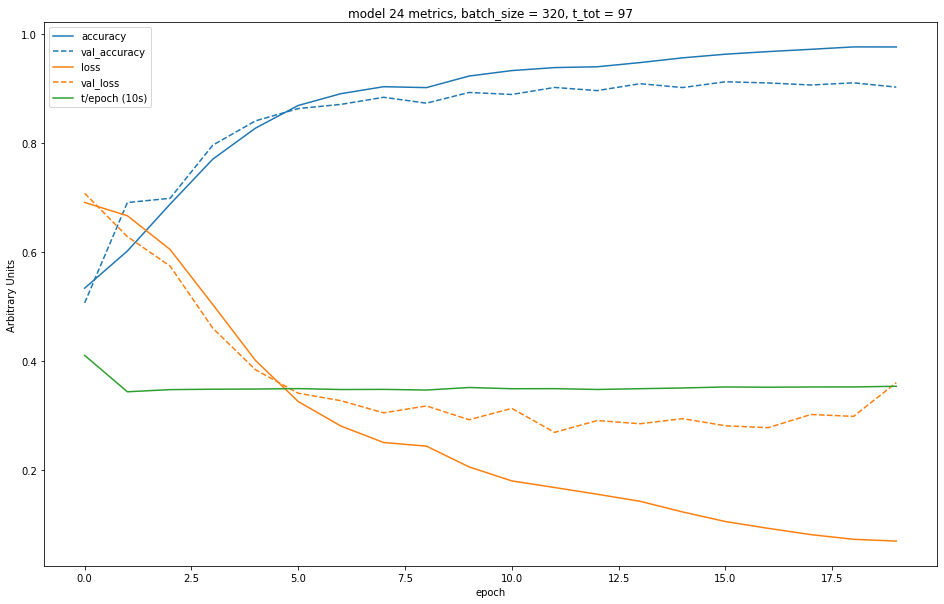

Creating model 25...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


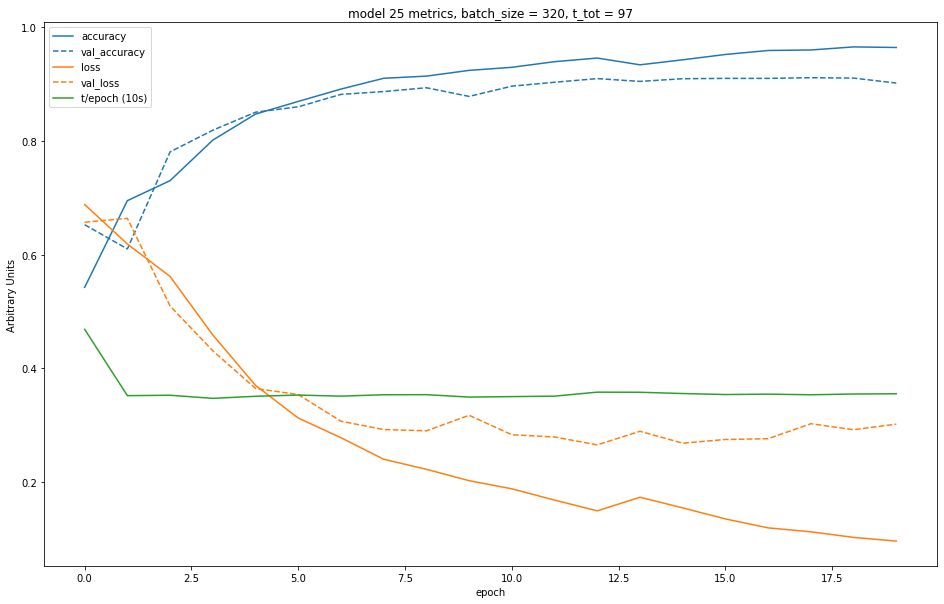

Creating model 26...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


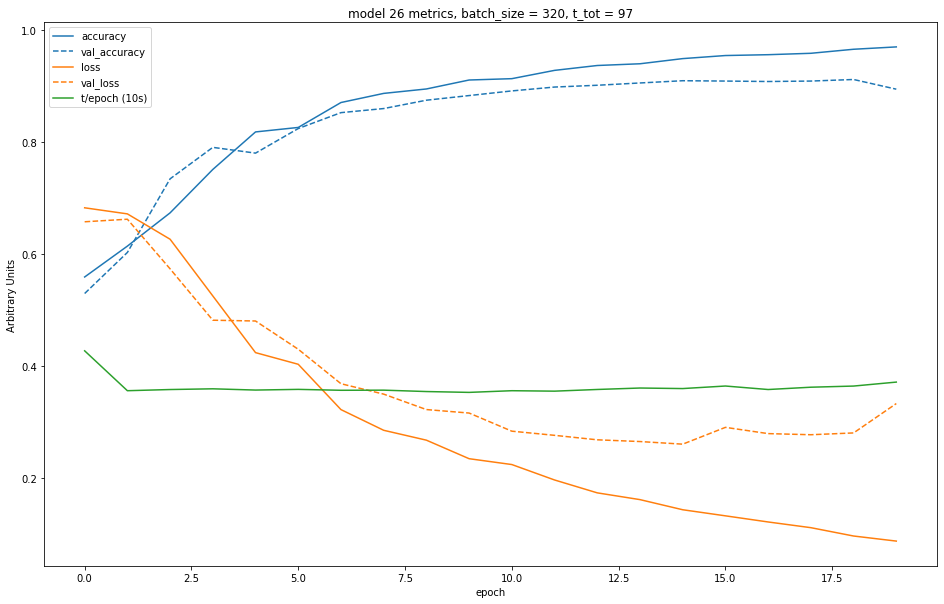

Creating model 27...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


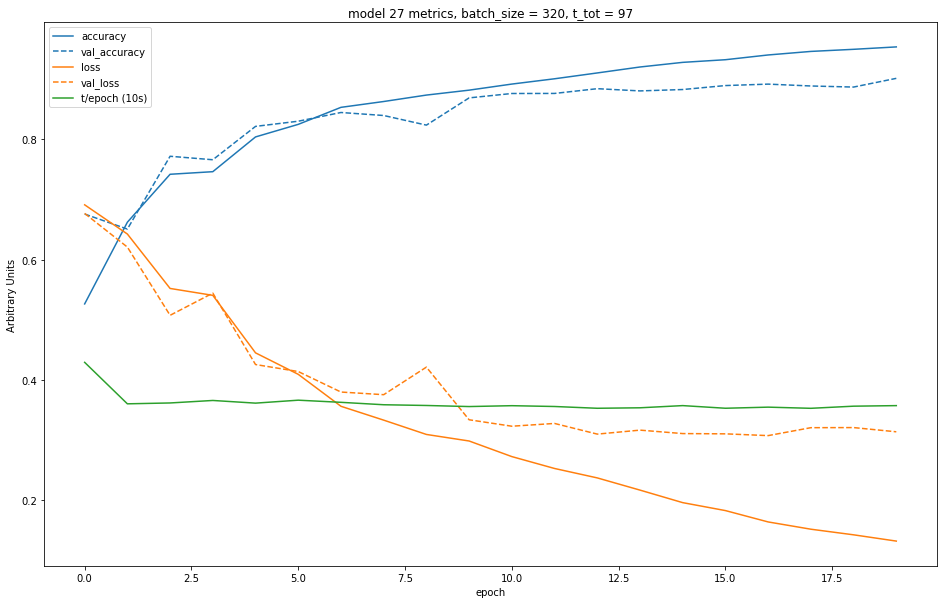

Creating model 28...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


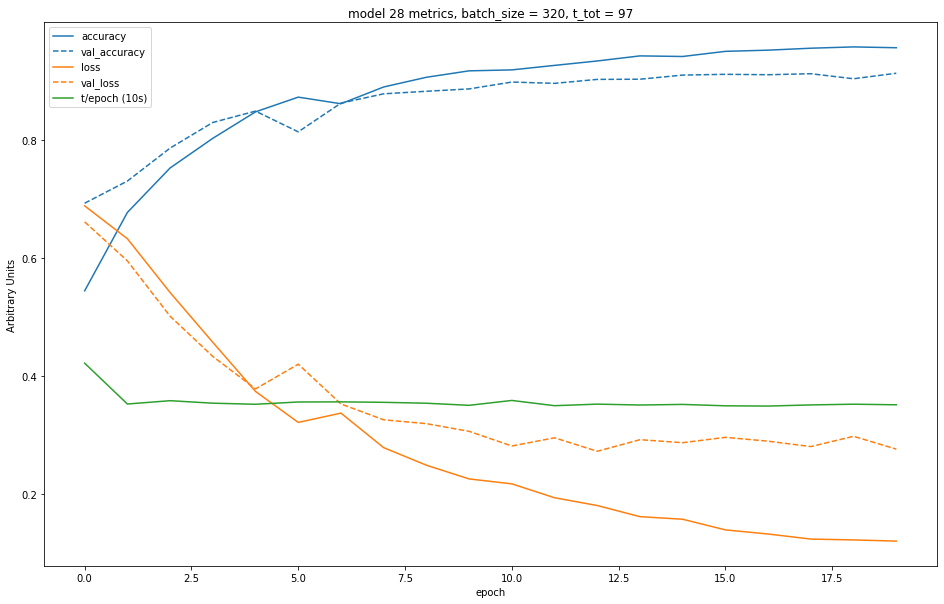

Creating model 29...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


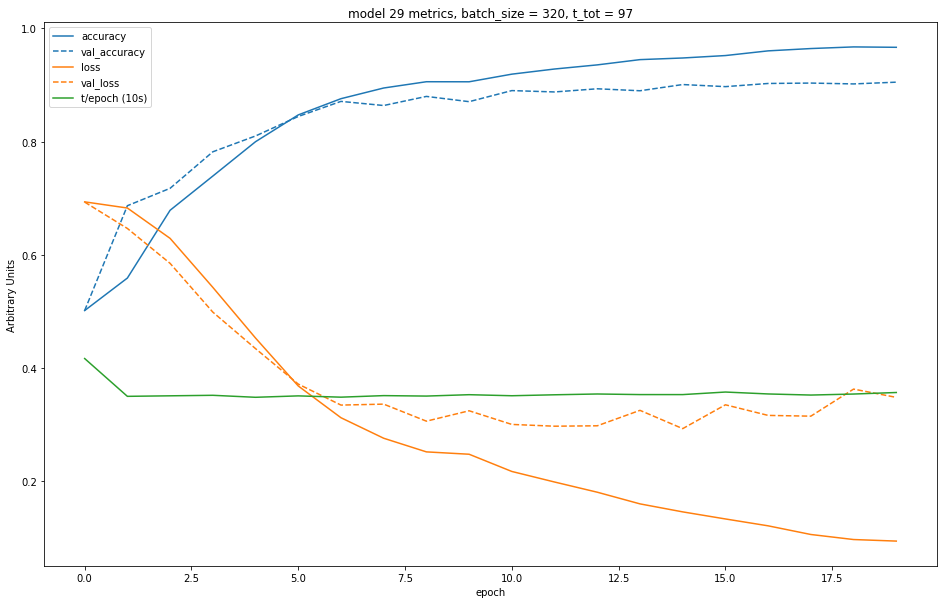

Creating model 30...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


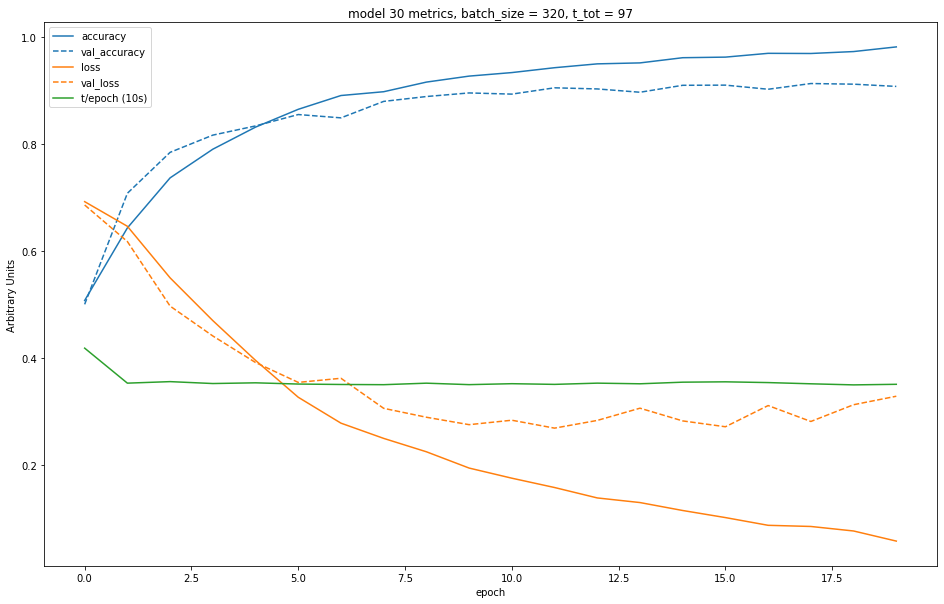

Creating model 31...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


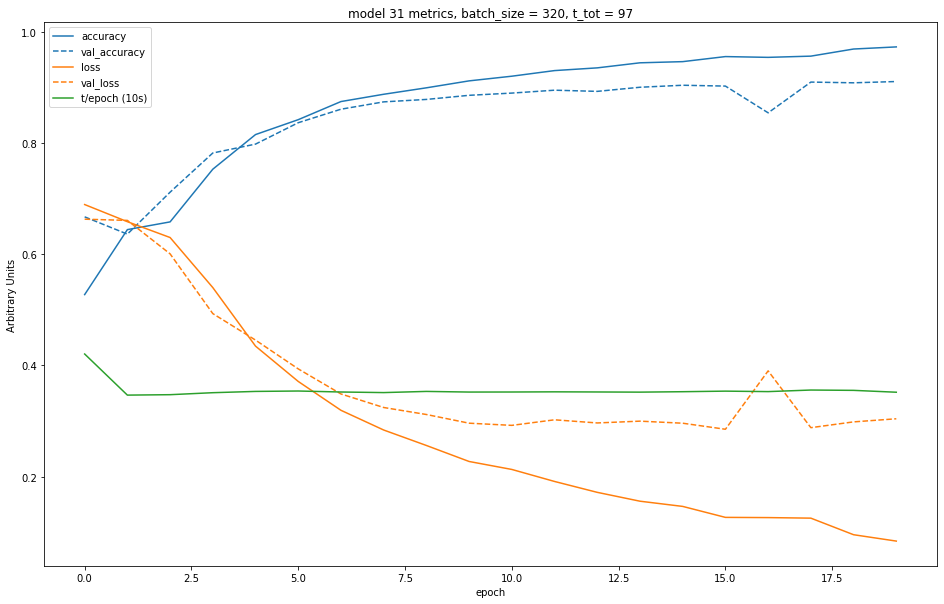

Creating model 32...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


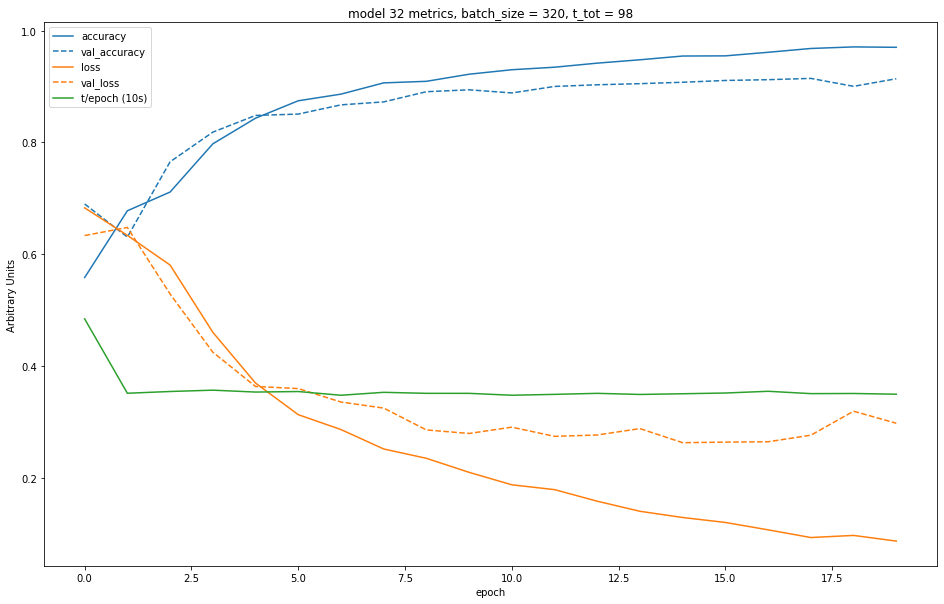

Creating model 33...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


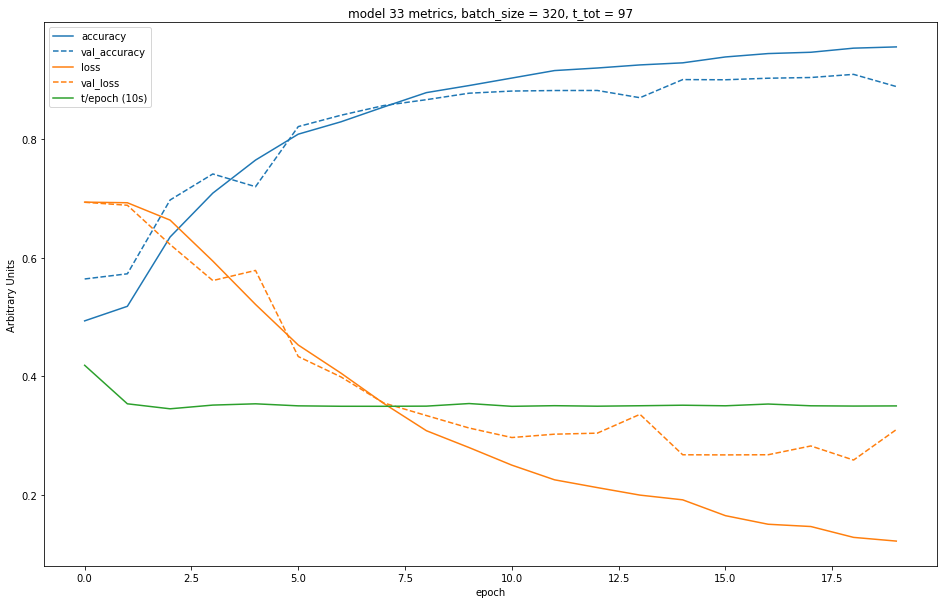

Creating model 34...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


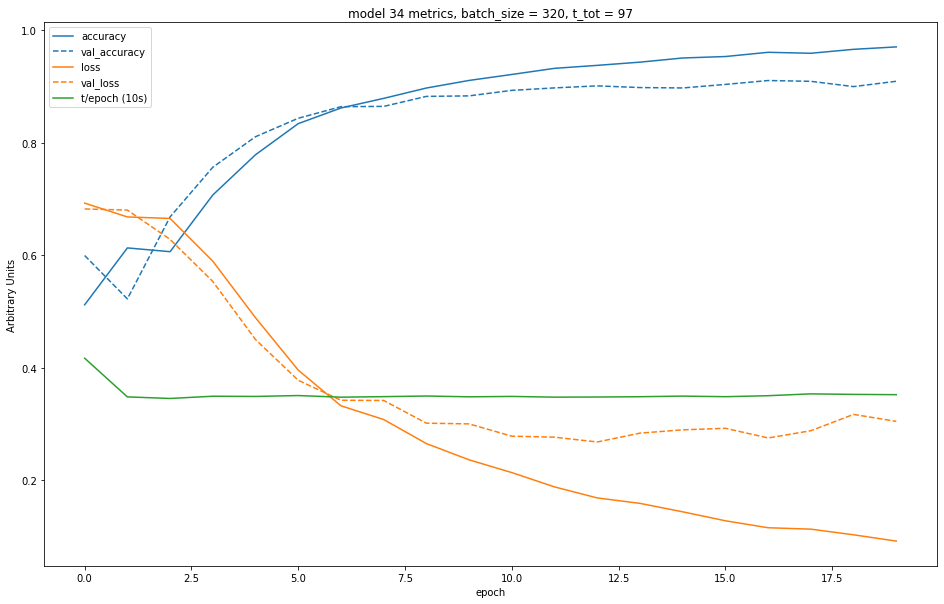

Creating model 35...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


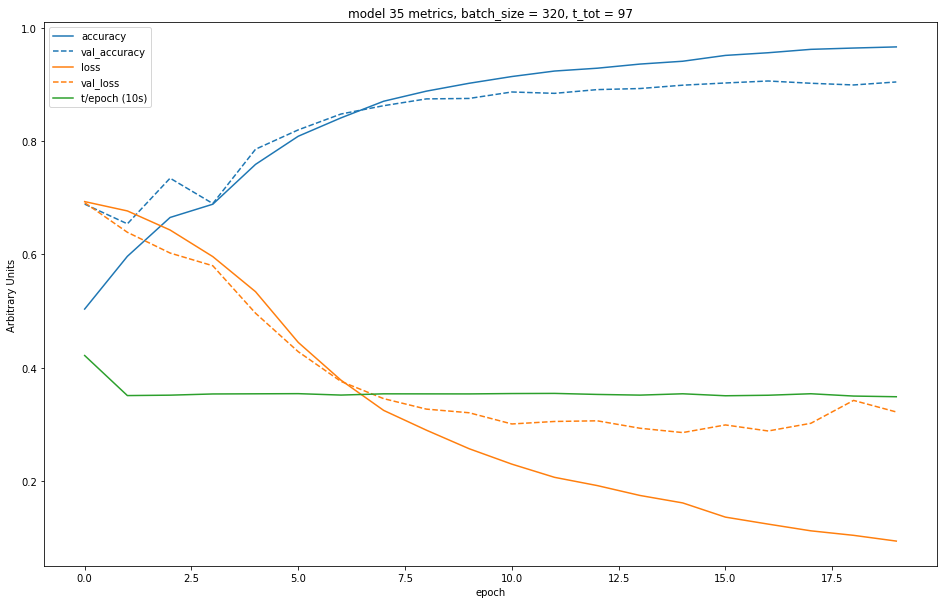

Creating model 36...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


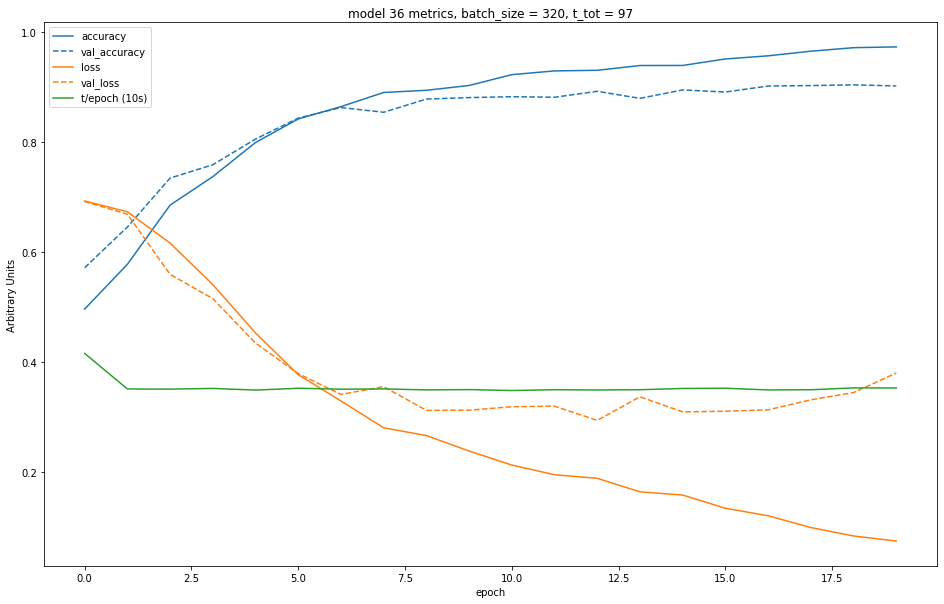

Creating model 37...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


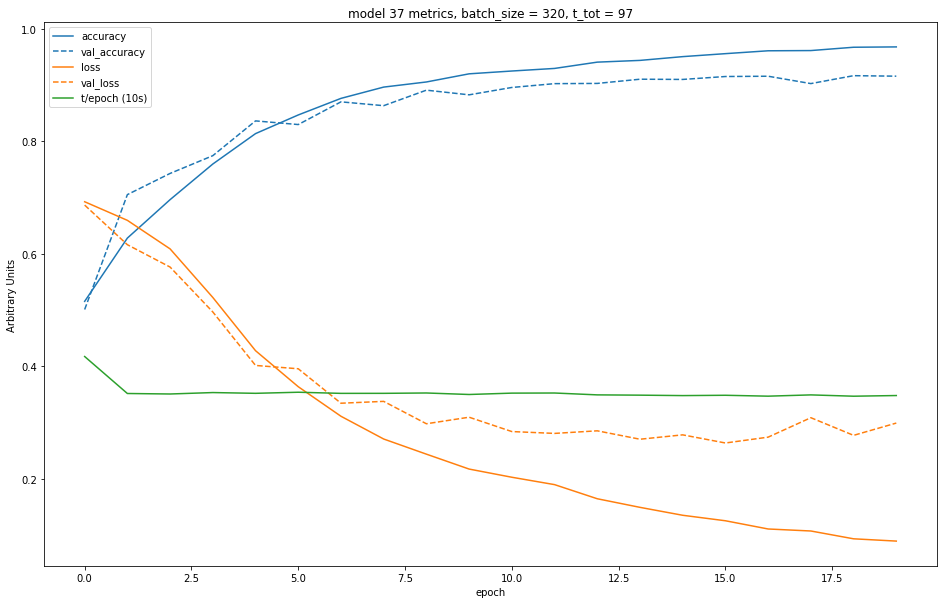

Creating model 38...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


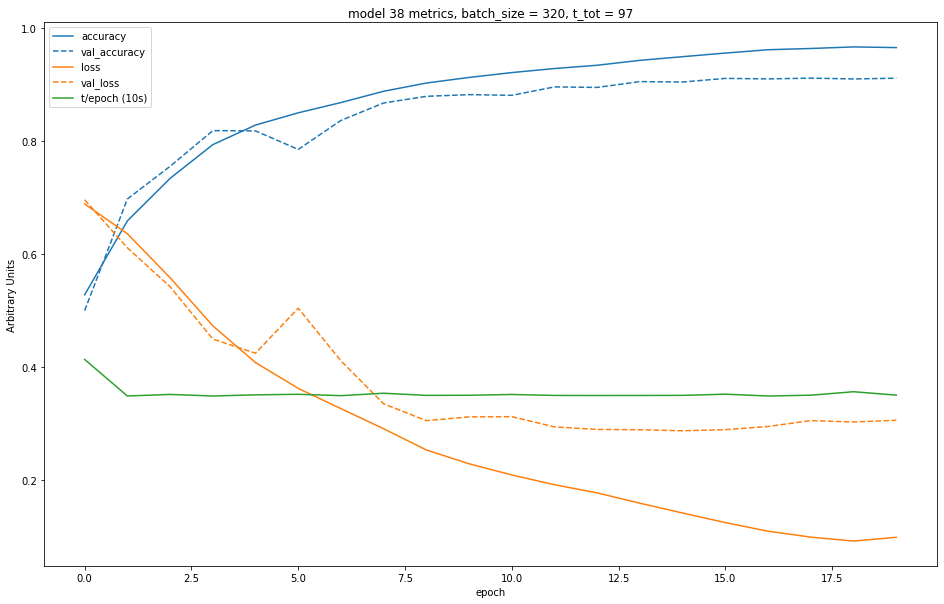

Creating model 39...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


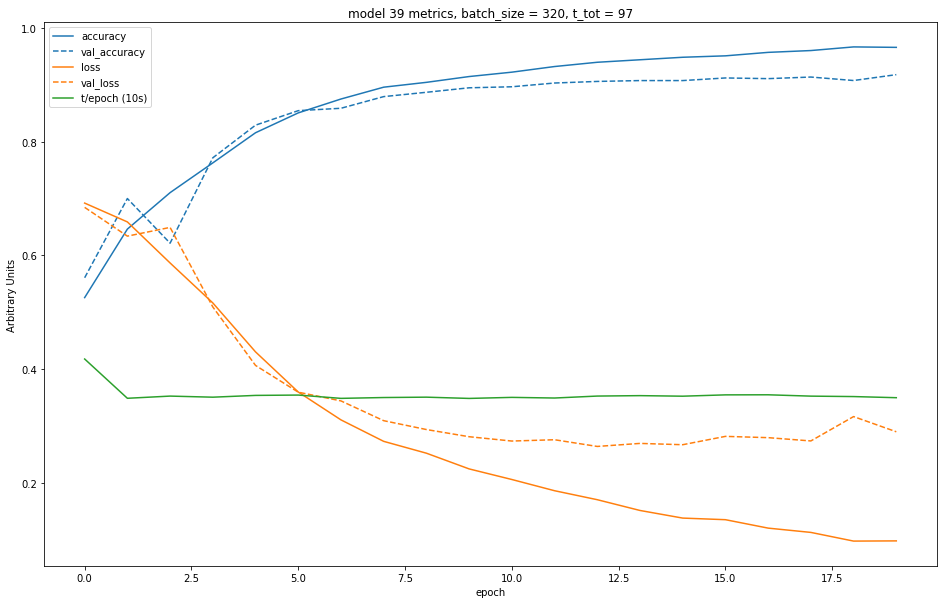

Creating model 40...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


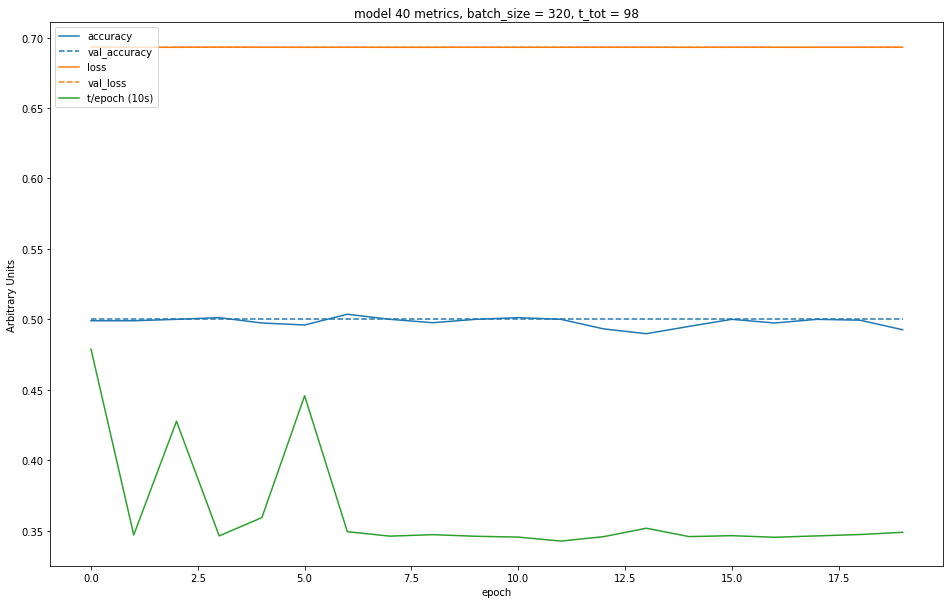

Creating model 41...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


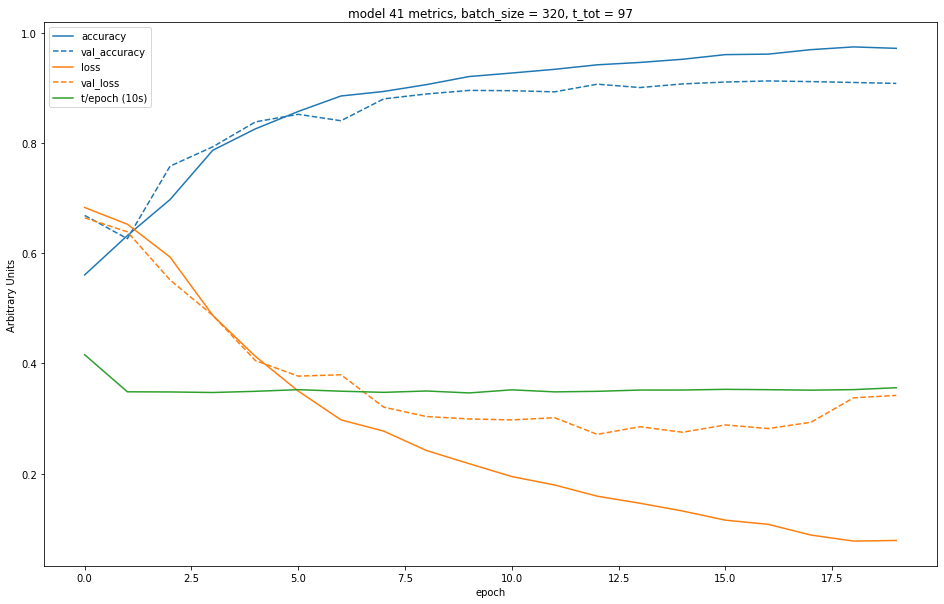

Creating model 42...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


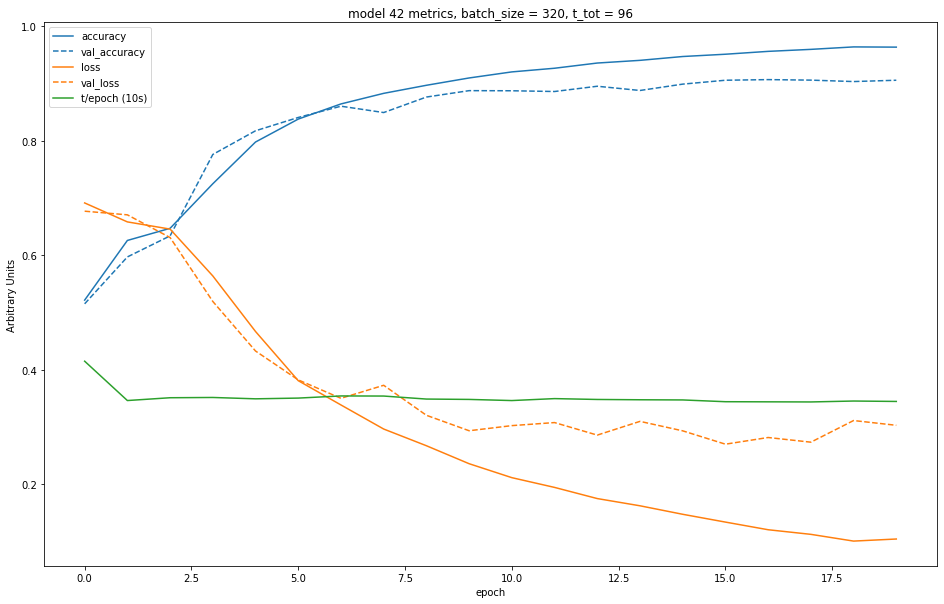

Creating model 43...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


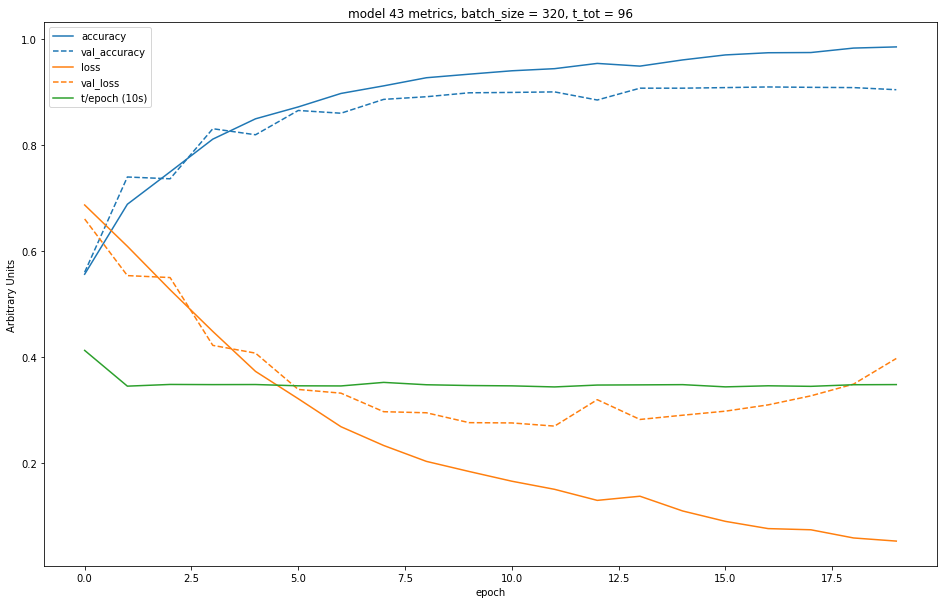

Creating model 44...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


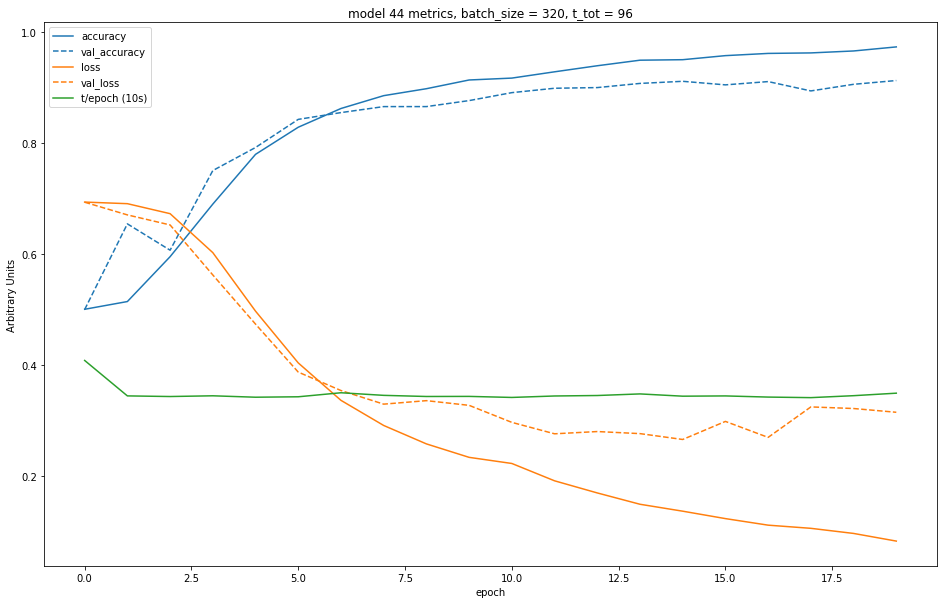

Creating model 45...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


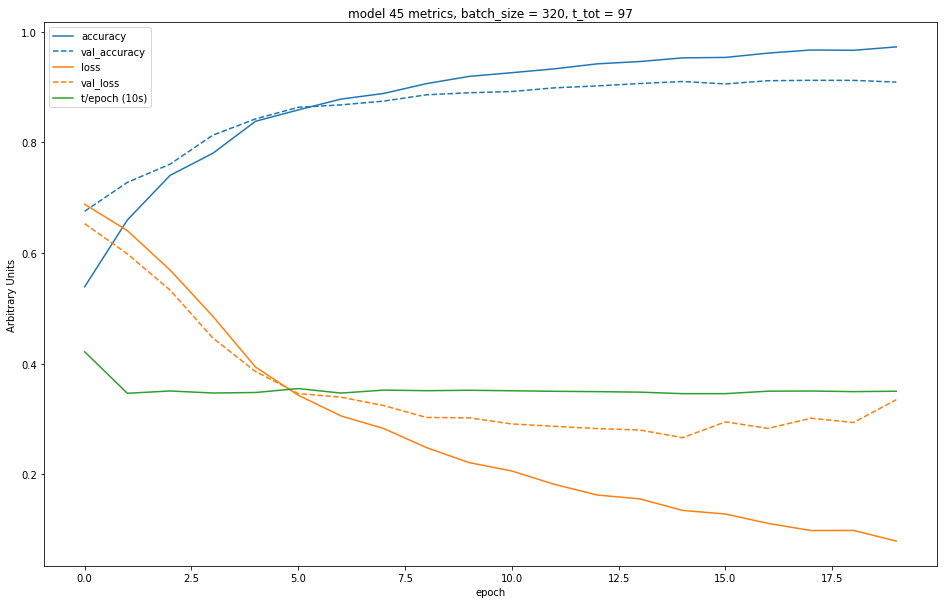

Creating model 46...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


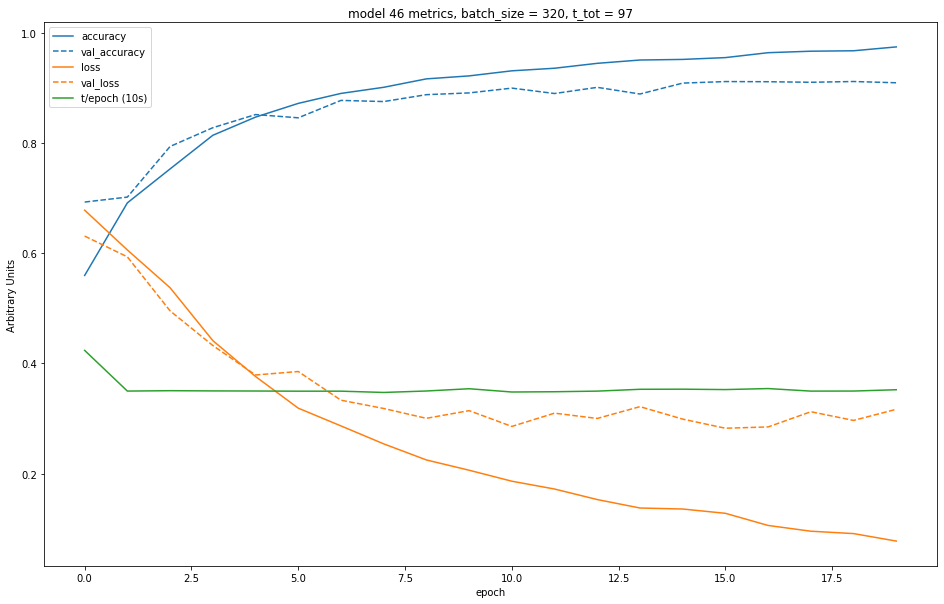

Creating model 47...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


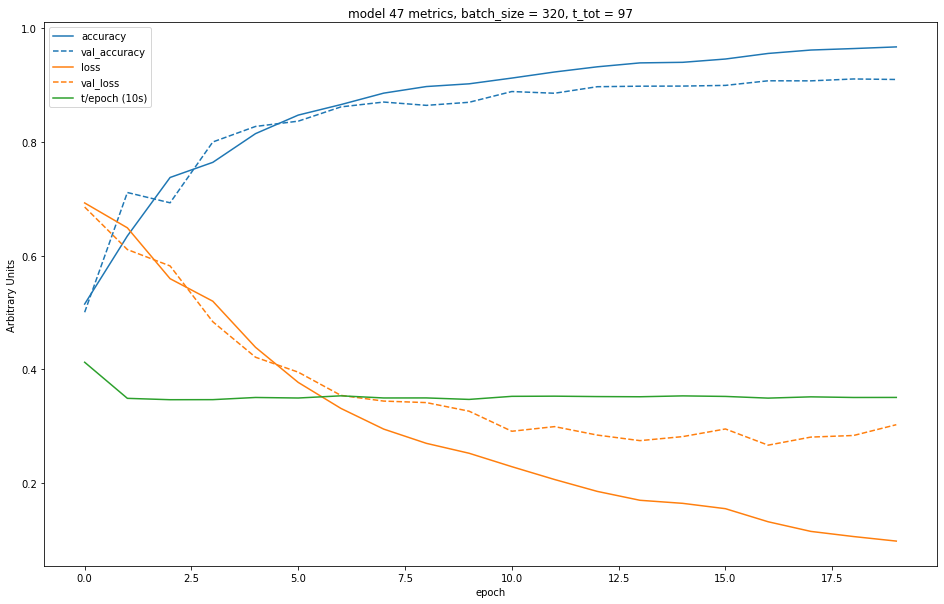

Creating model 48...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


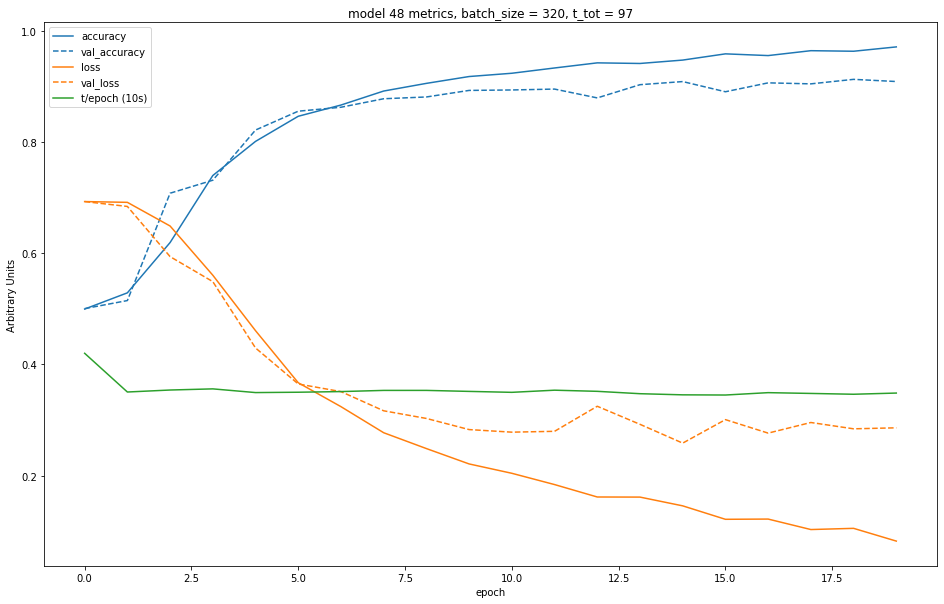

Creating model 49...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


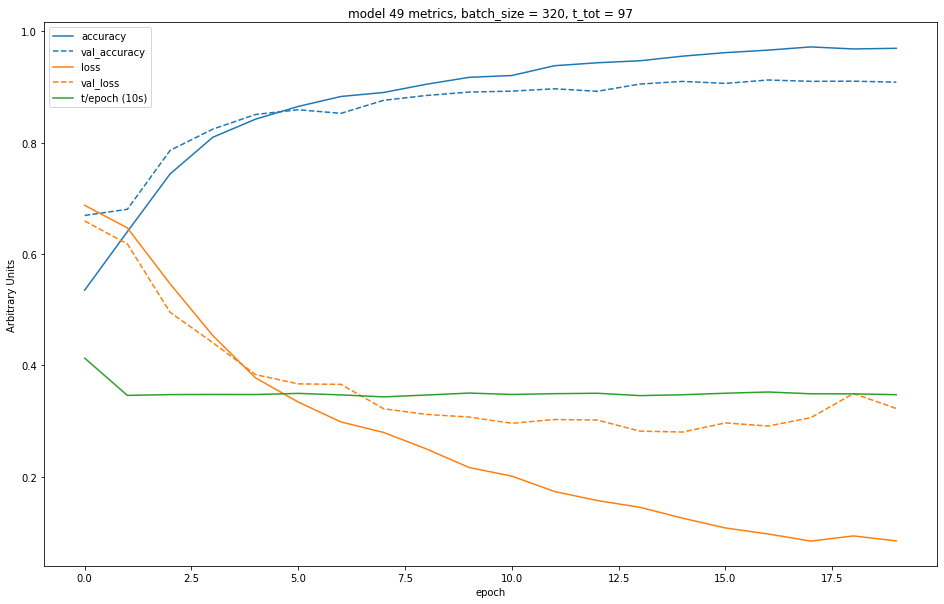

Creating model 50...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


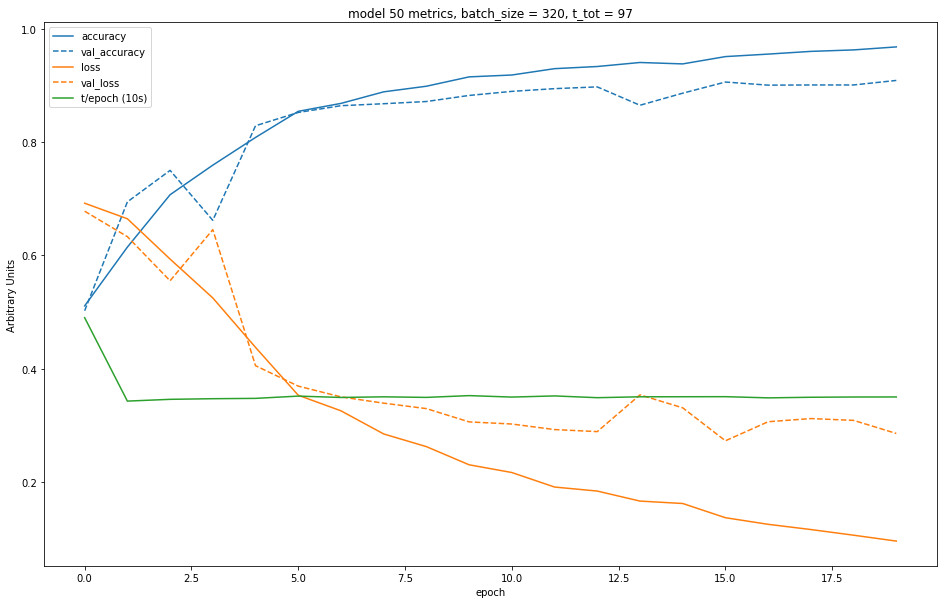

Creating model 51...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


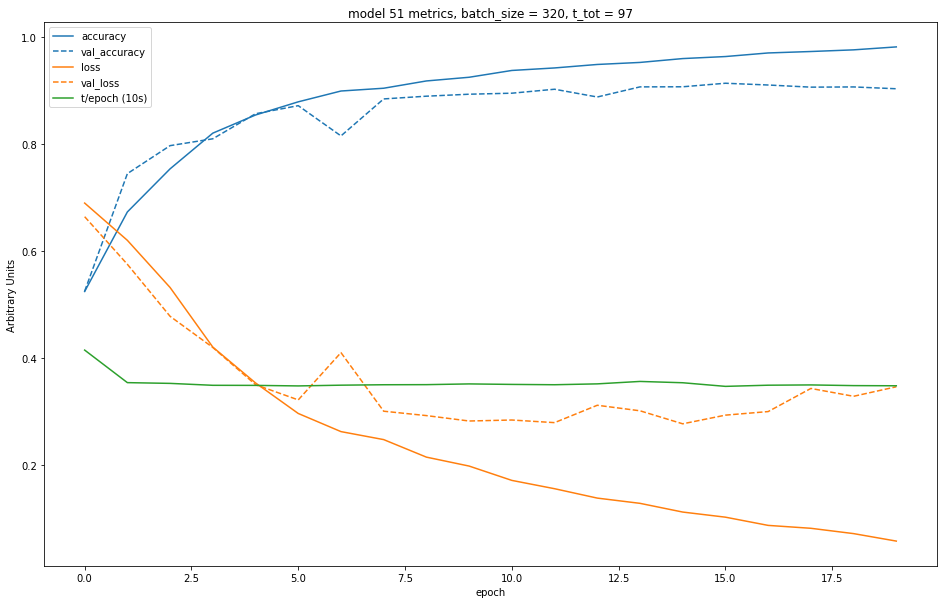

Creating model 52...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


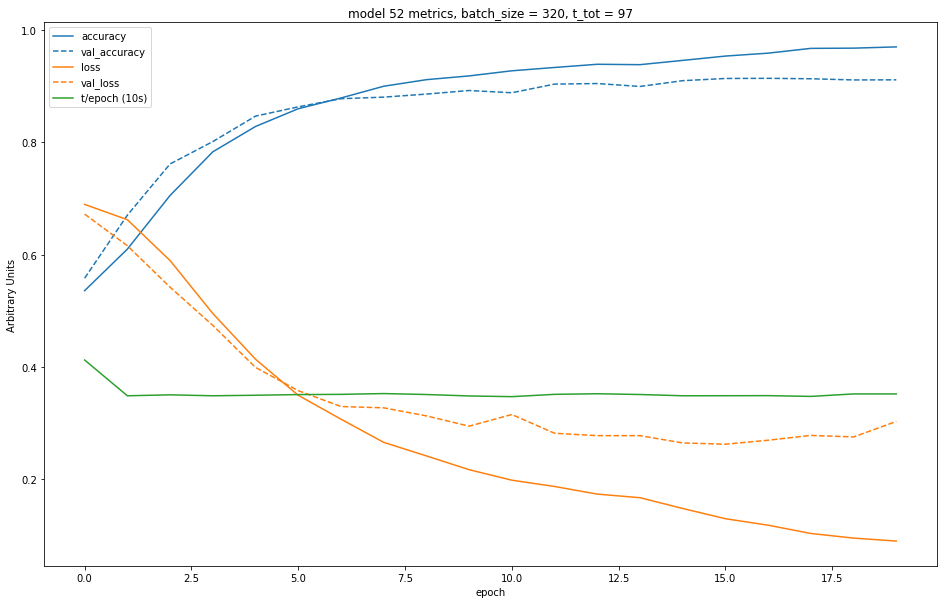

Creating model 53...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


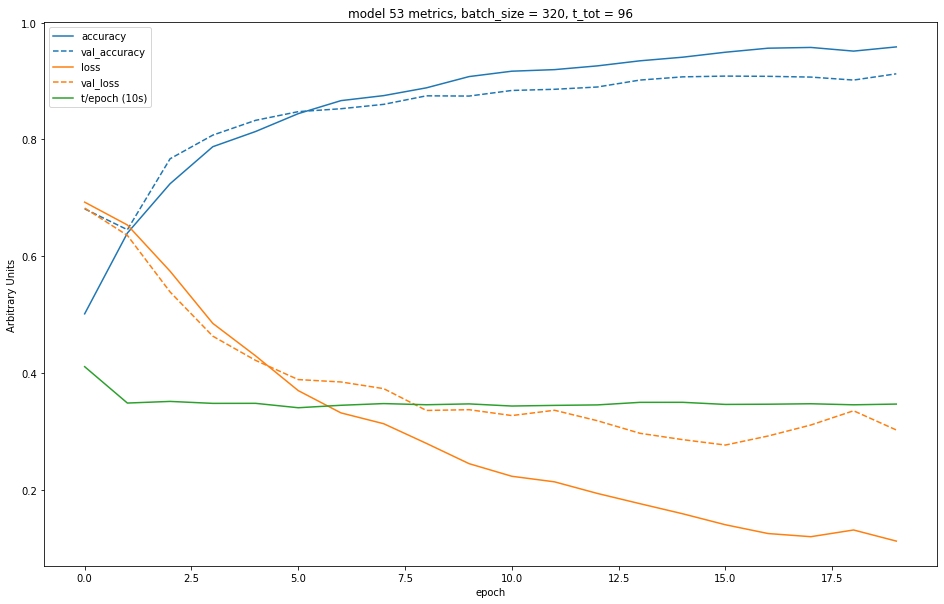

Creating model 54...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


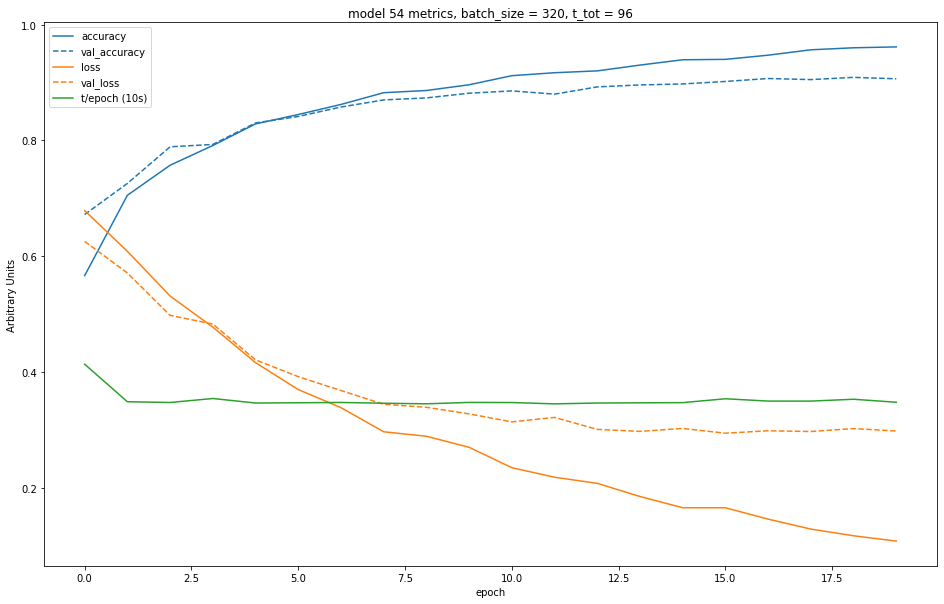

Creating model 55...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


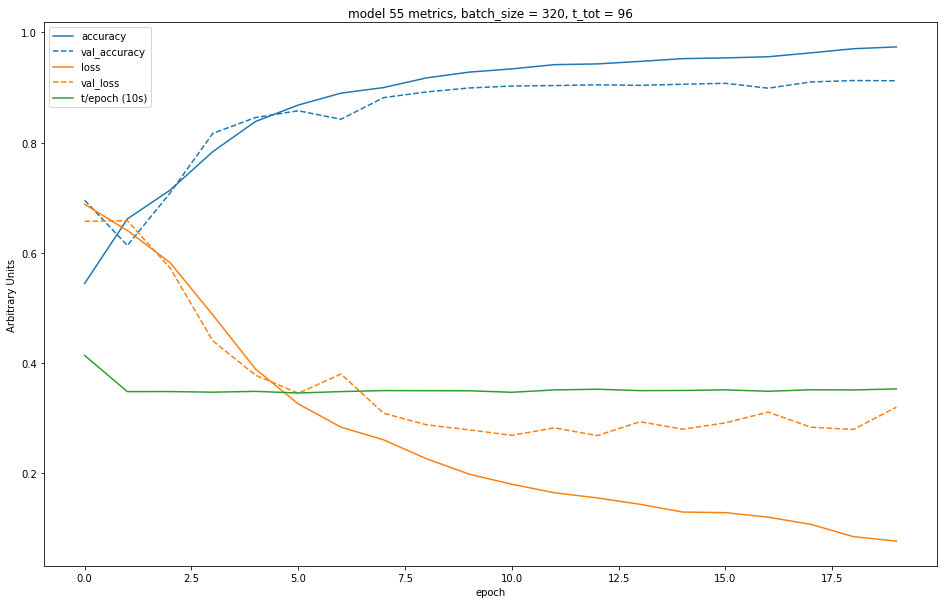

Creating model 56...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


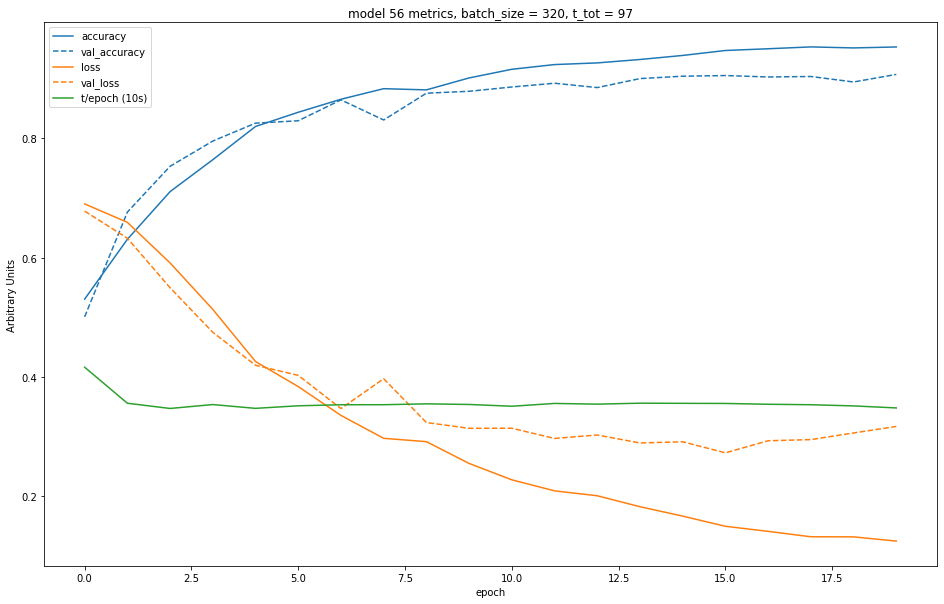

Creating model 57...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


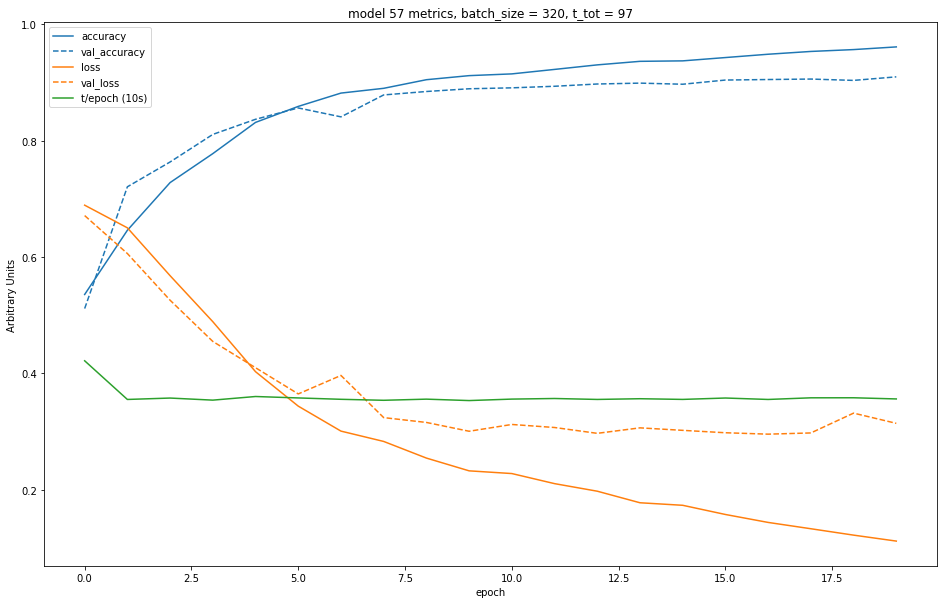

Creating model 58...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


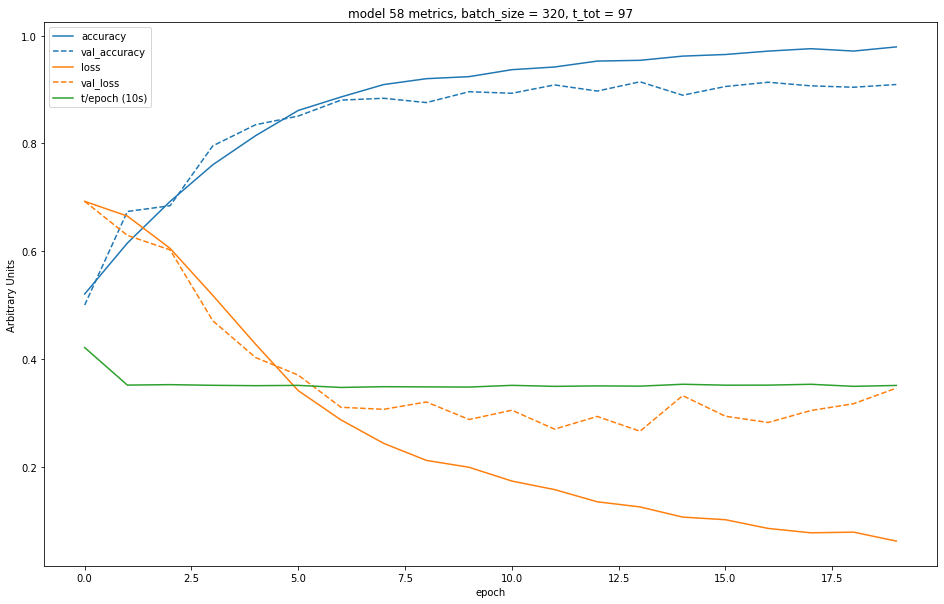

Creating model 59...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


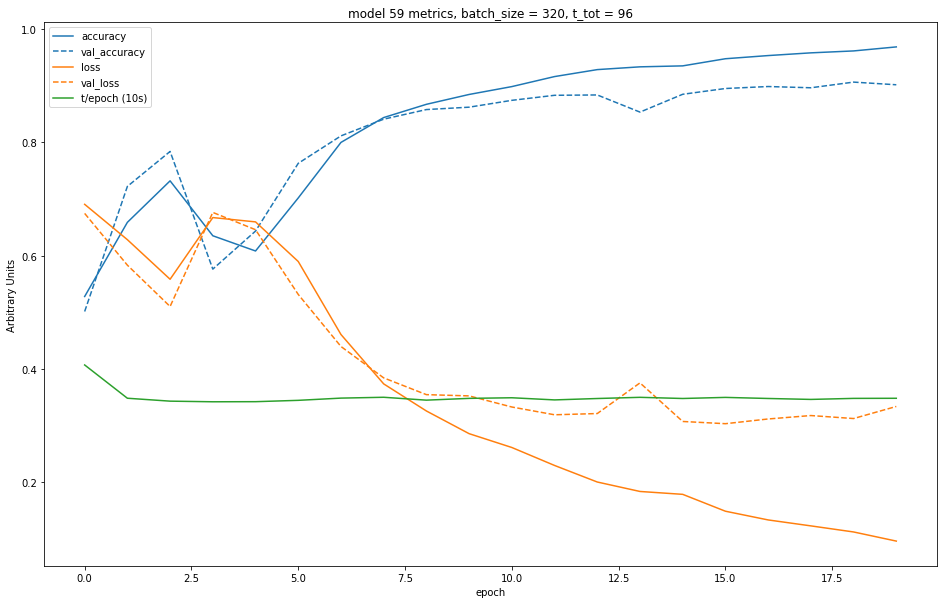

Creating model 60...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


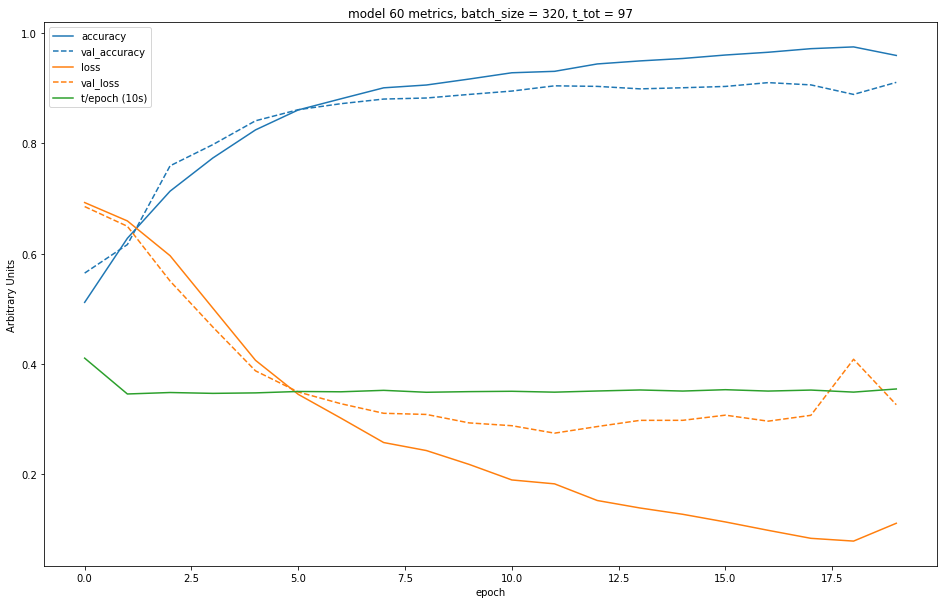

Creating model 61...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


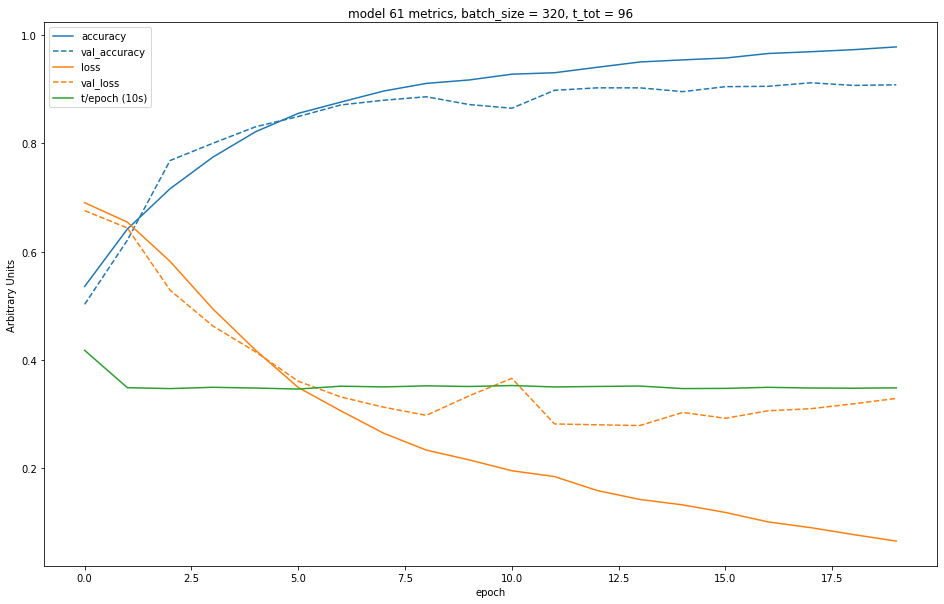

Creating model 62...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


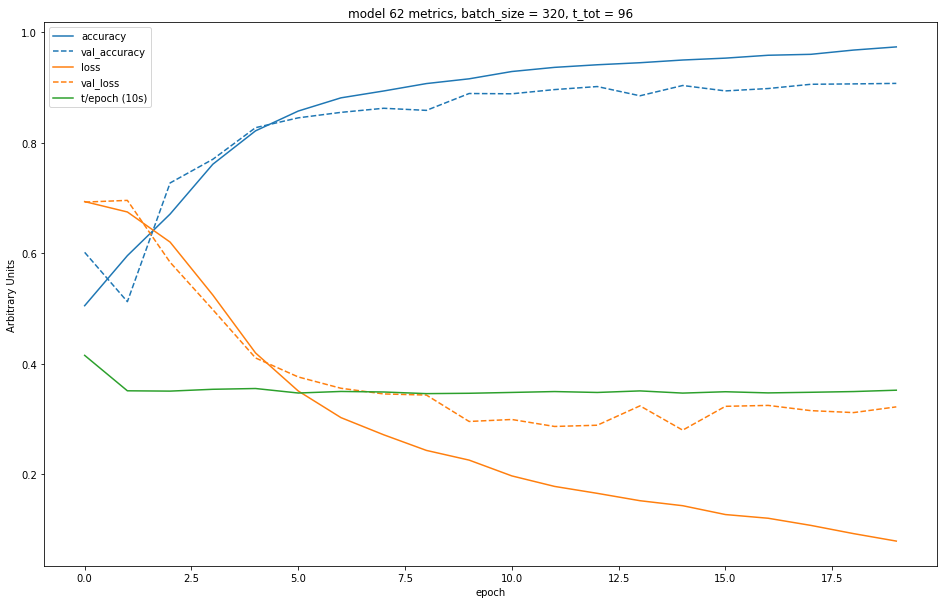

Creating model 63...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


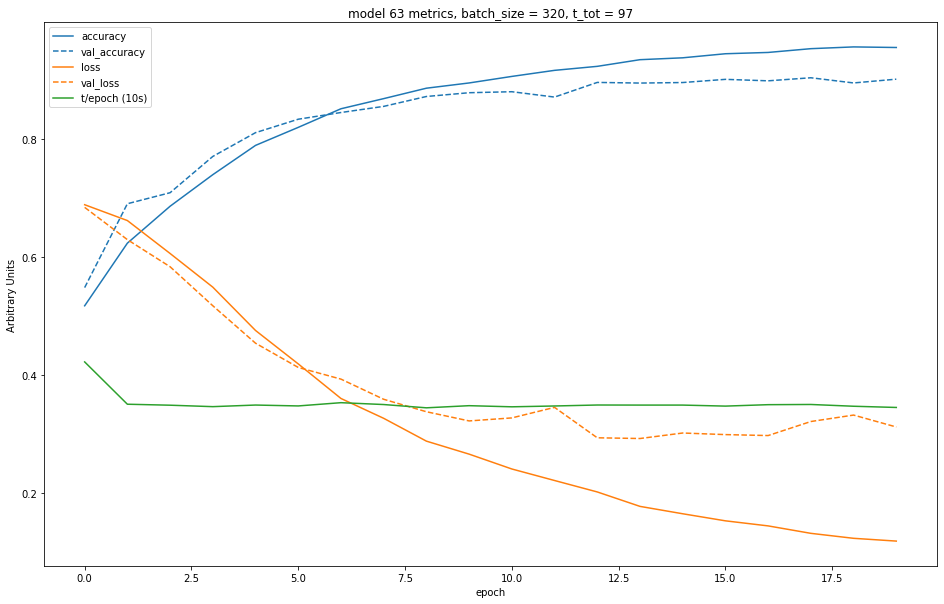

Creating model 64...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


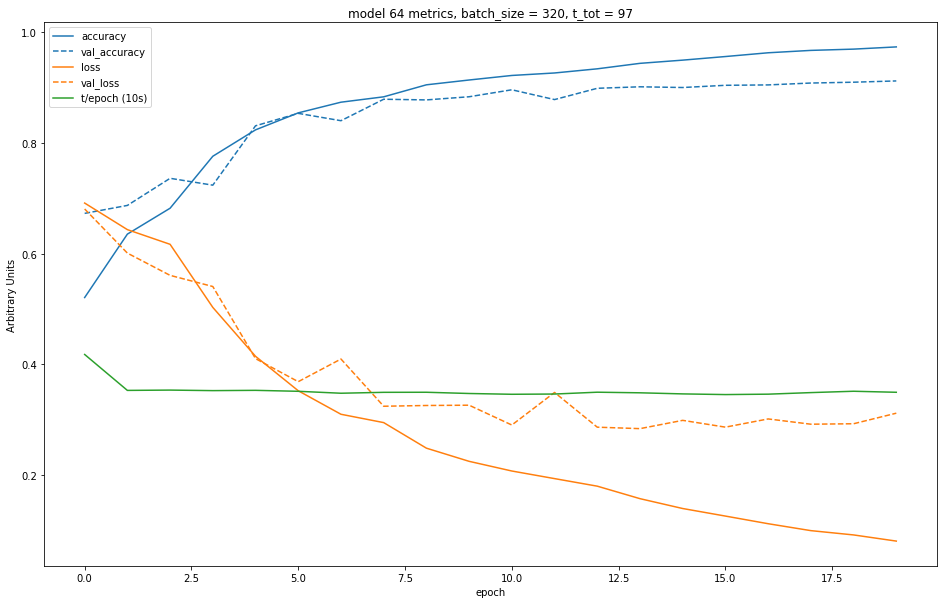

Creating model 65...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


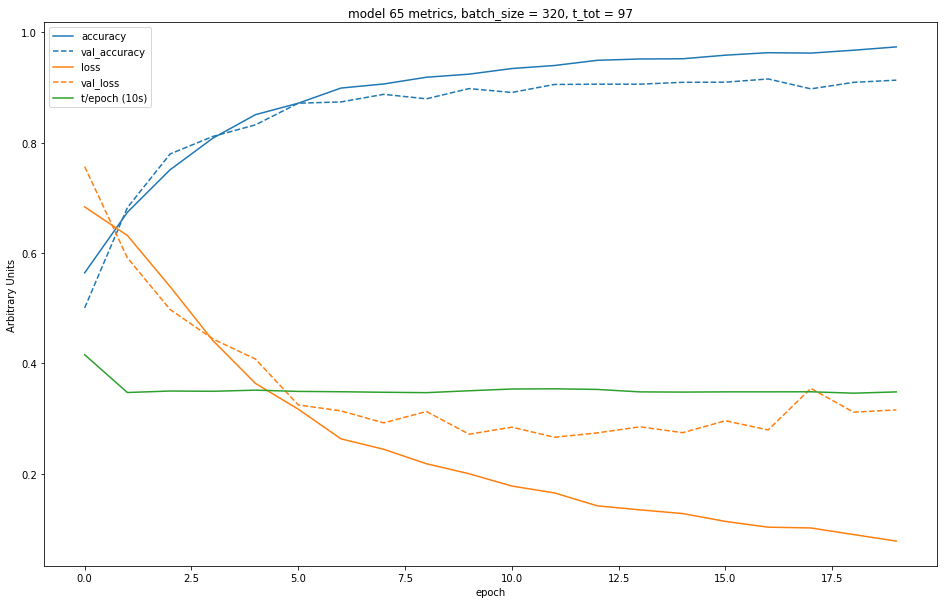

Creating model 66...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


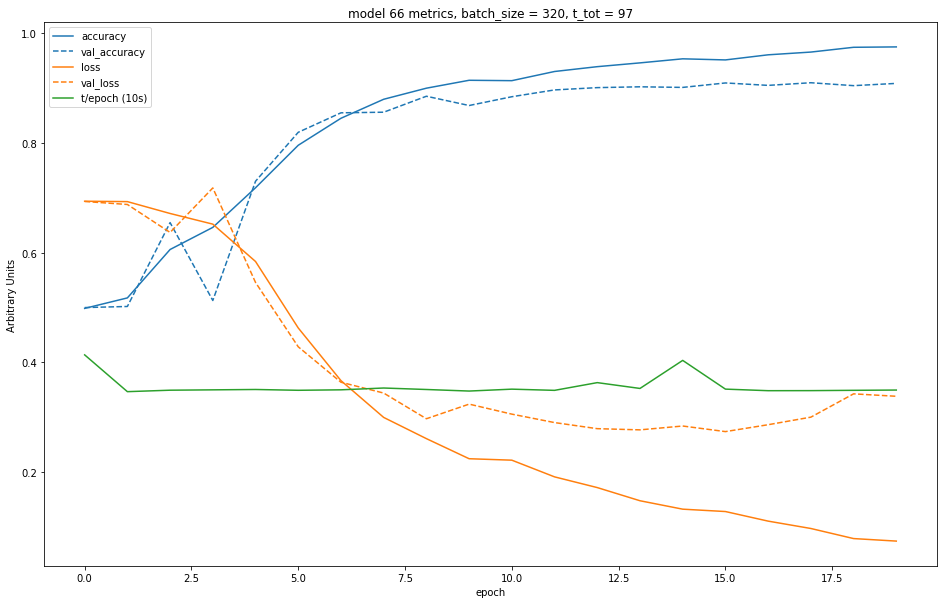

Creating model 67...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


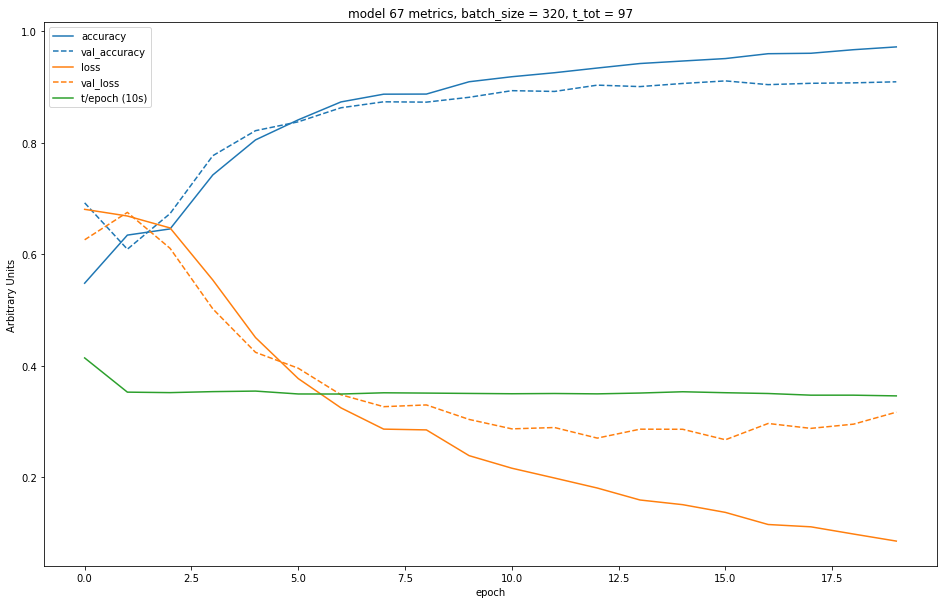

Creating model 68...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


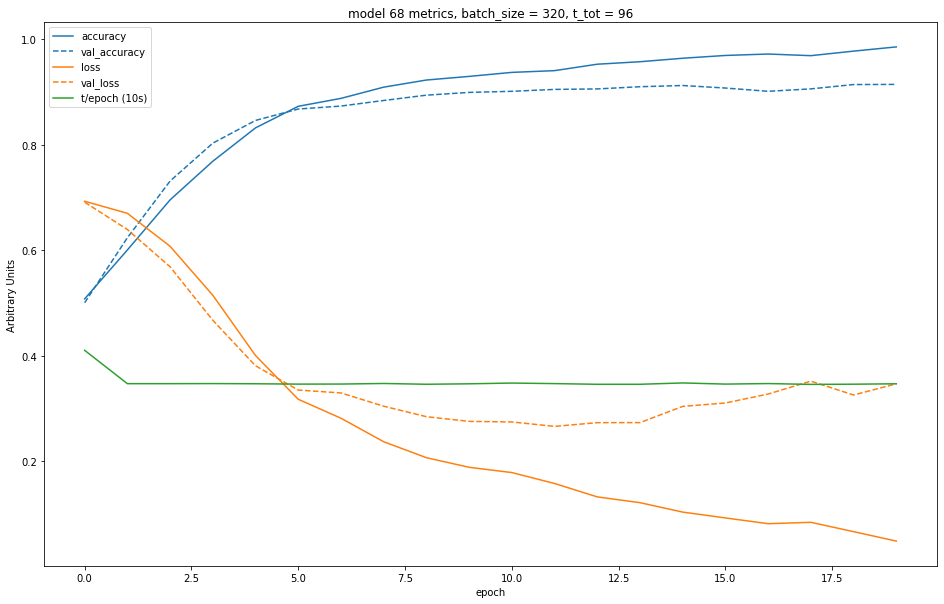

Creating model 69...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


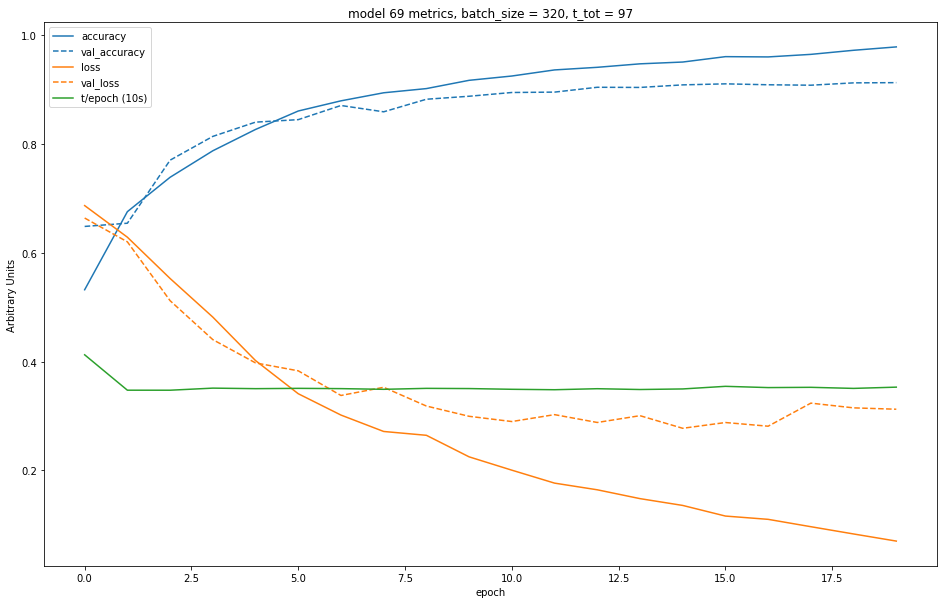

Creating model 70...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


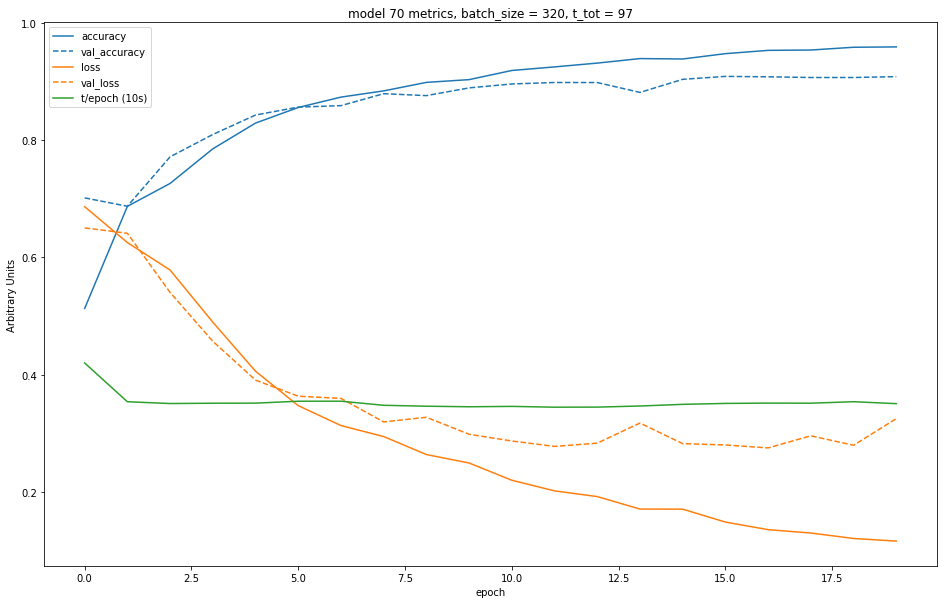

Creating model 71...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


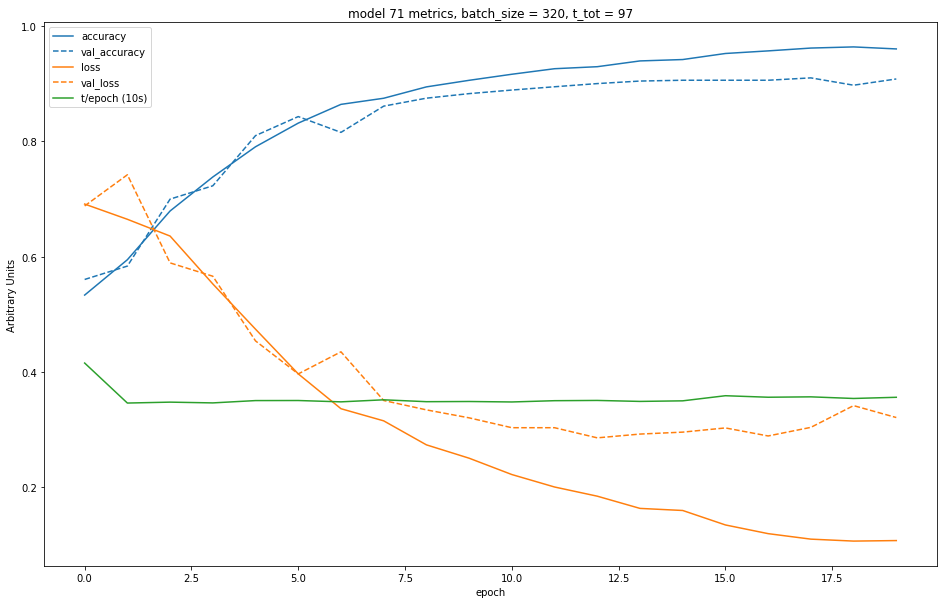

Creating model 72...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


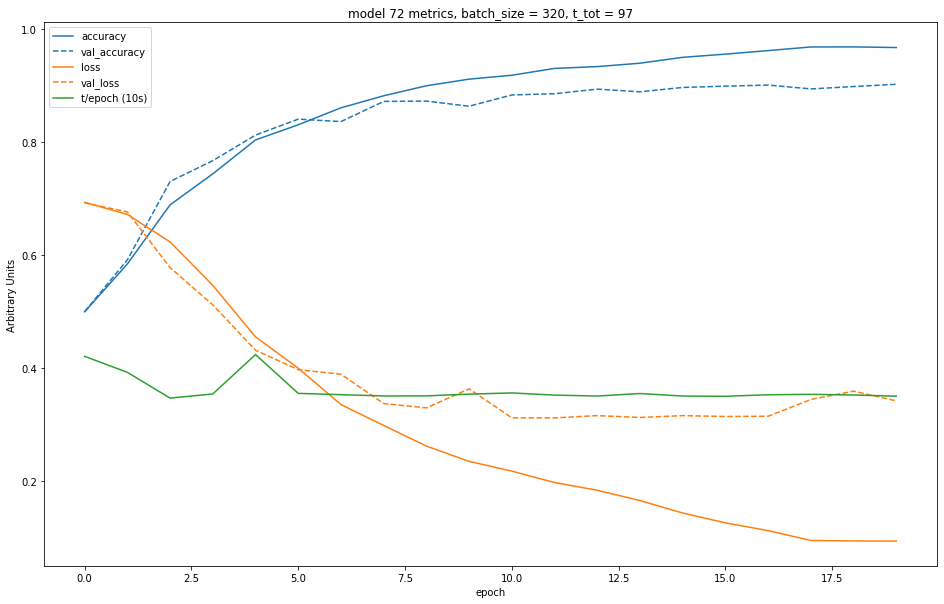

Creating model 73...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


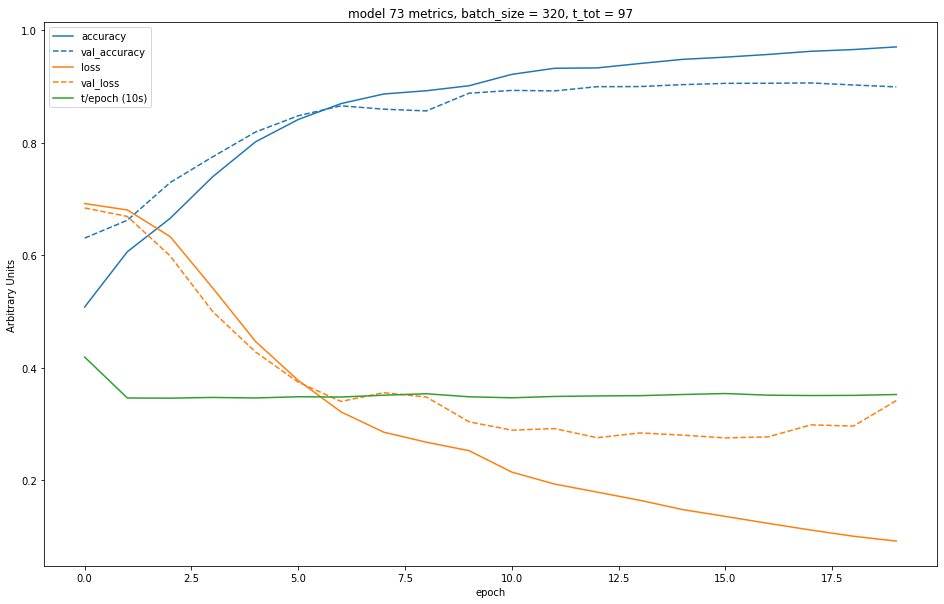

Creating model 74...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


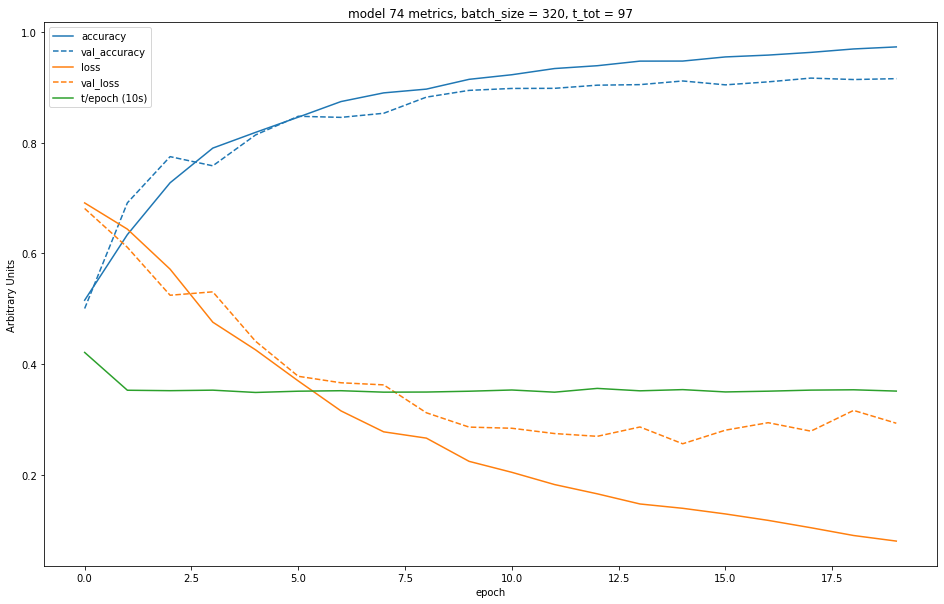

Creating model 75...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


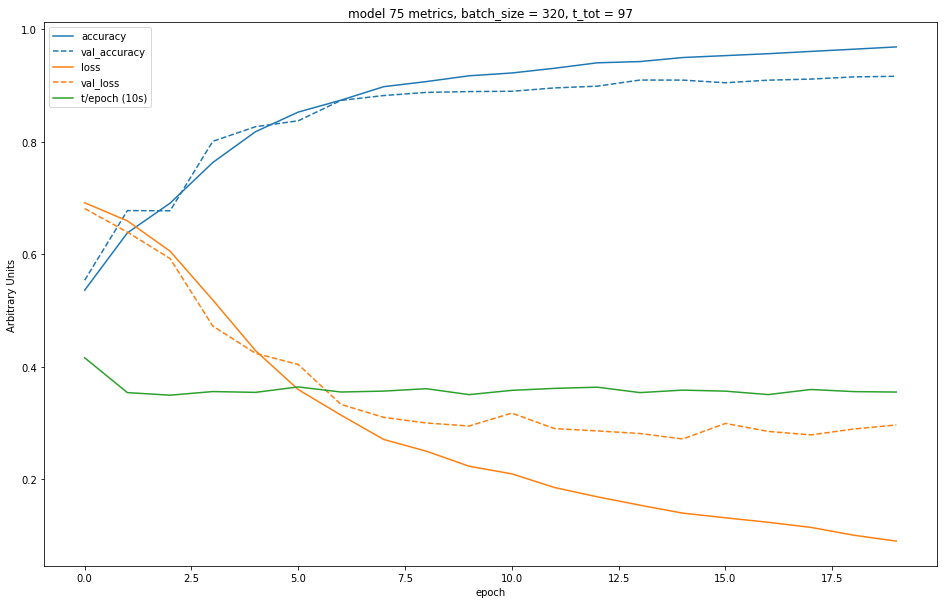

Creating model 76...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


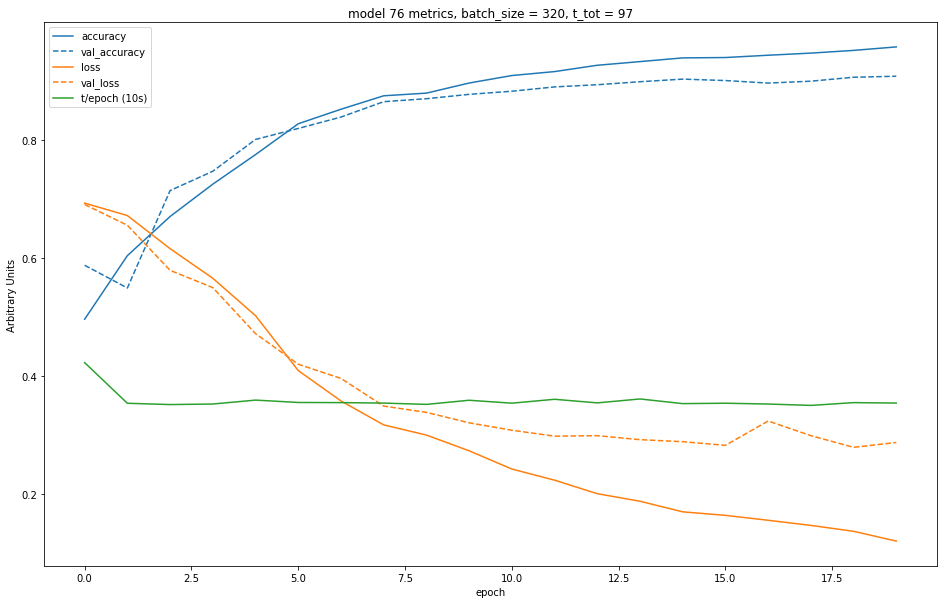

Creating model 77...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


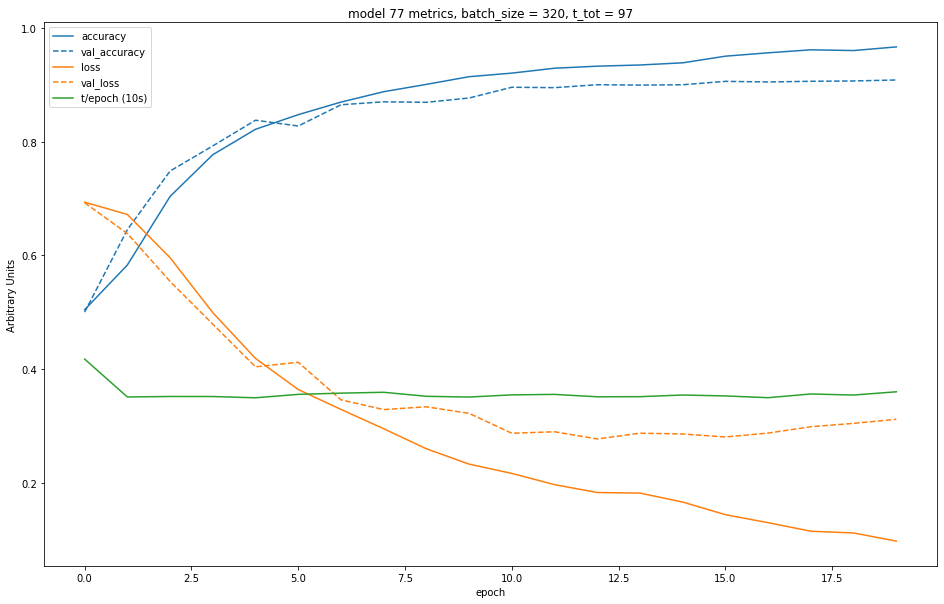

Creating model 78...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


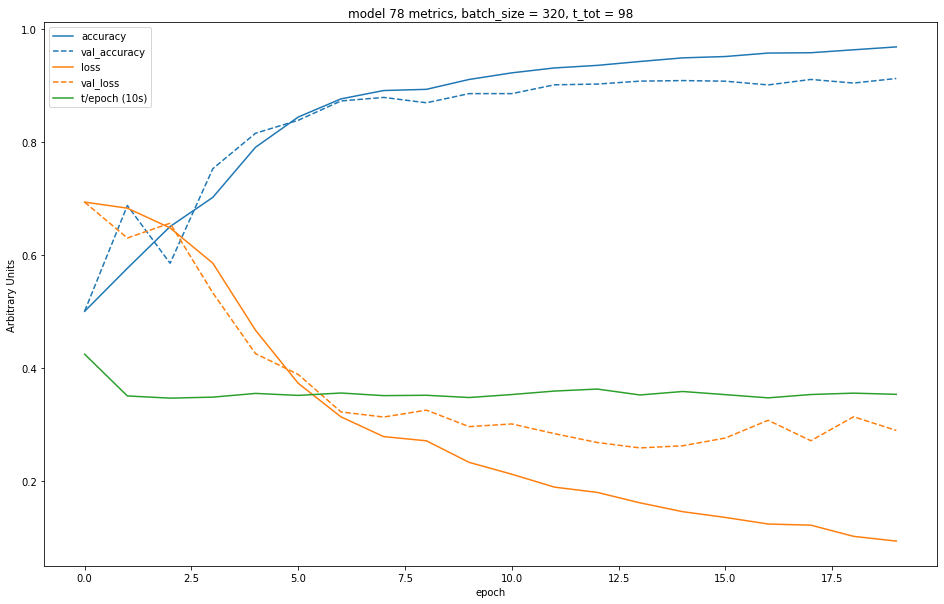

Creating model 79...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


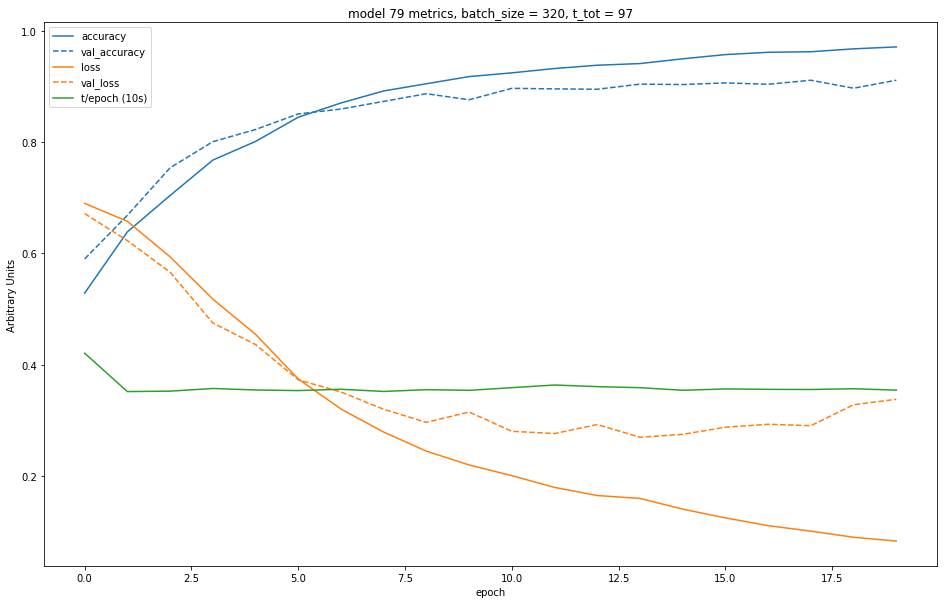

Creating model 80...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


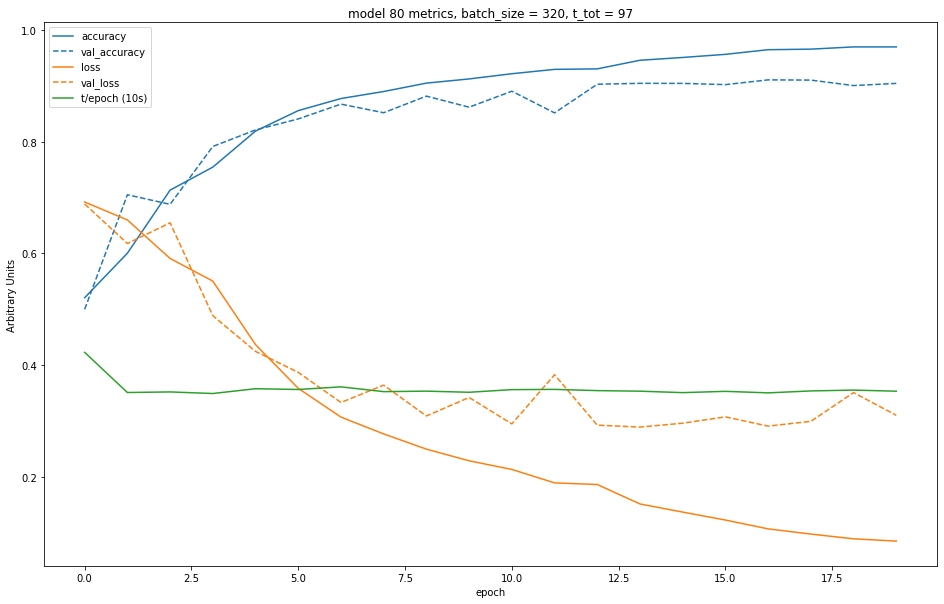

Creating model 81...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


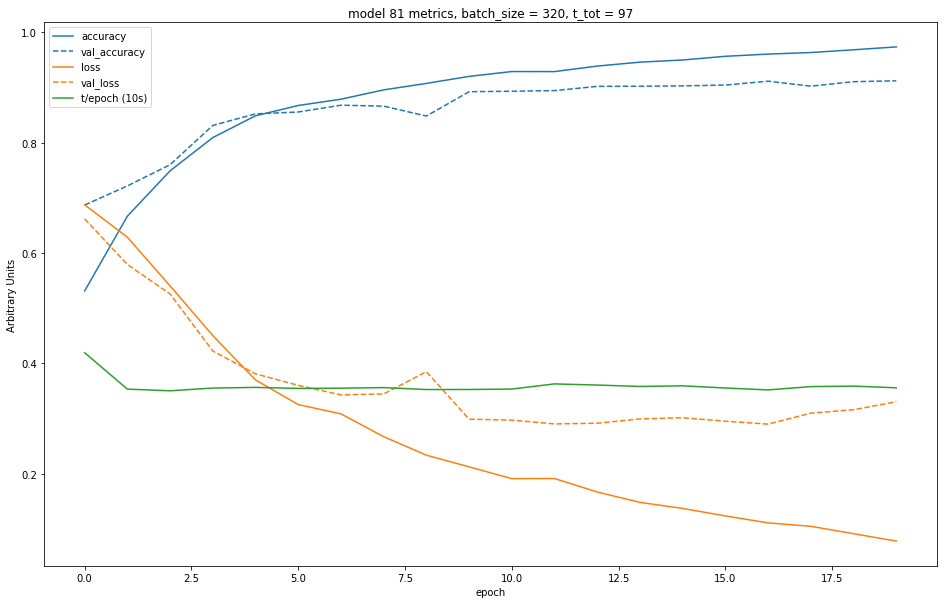

Creating model 82...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


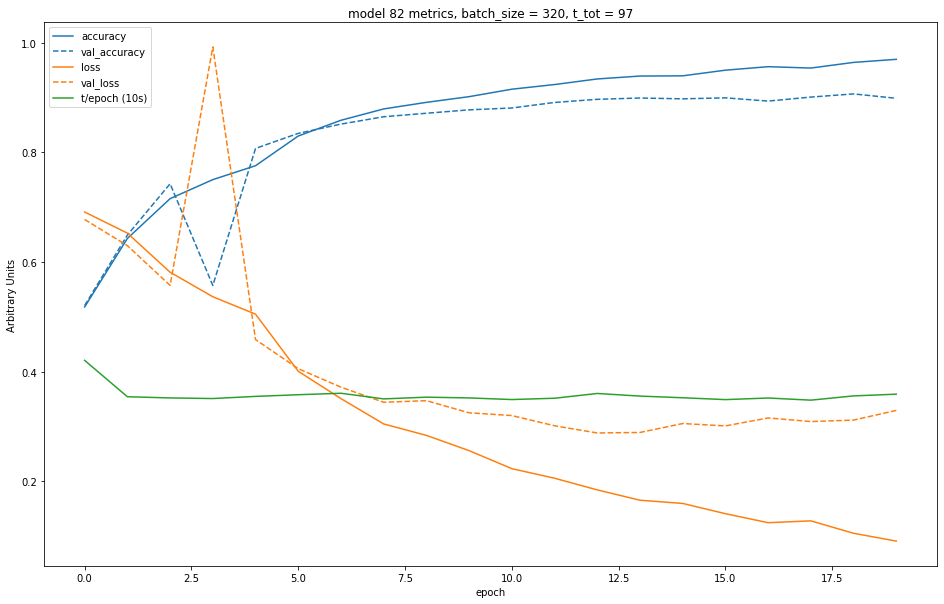

Creating model 83...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


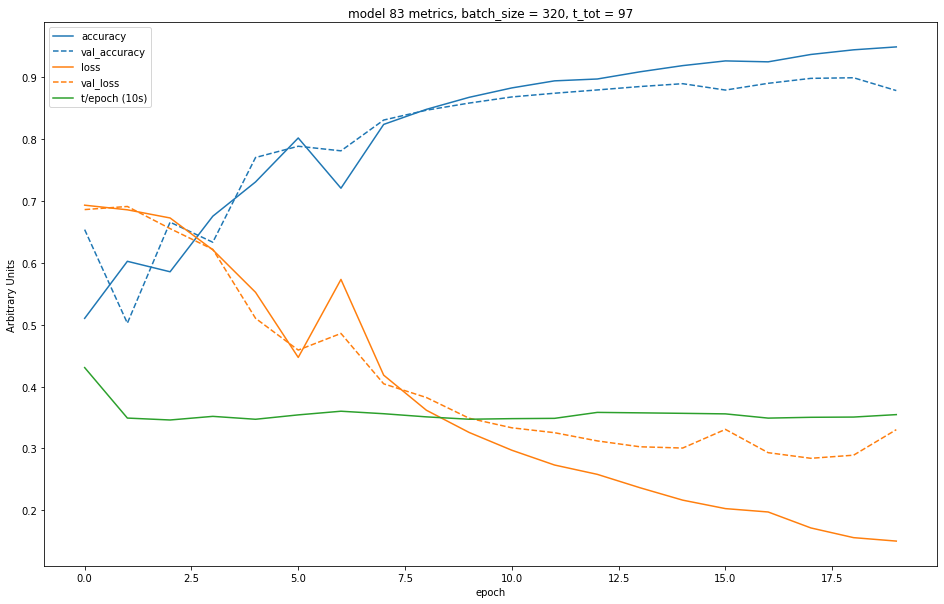

Creating model 84...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


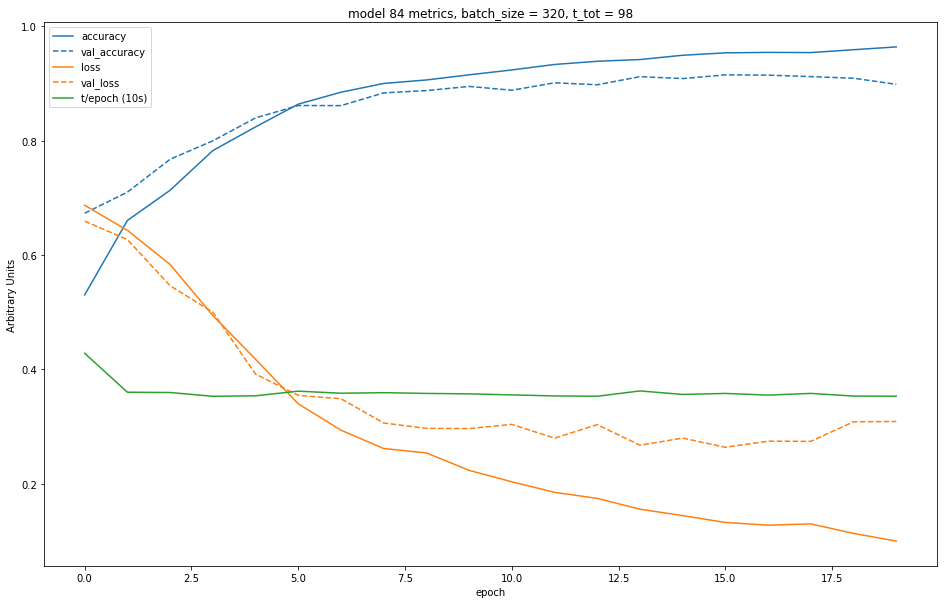

Creating model 85...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


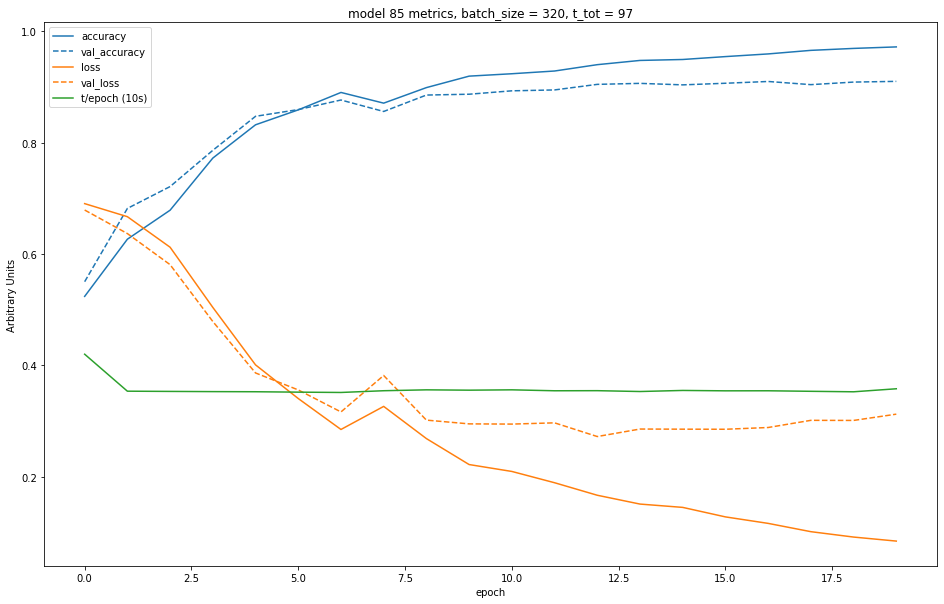

Creating model 86...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


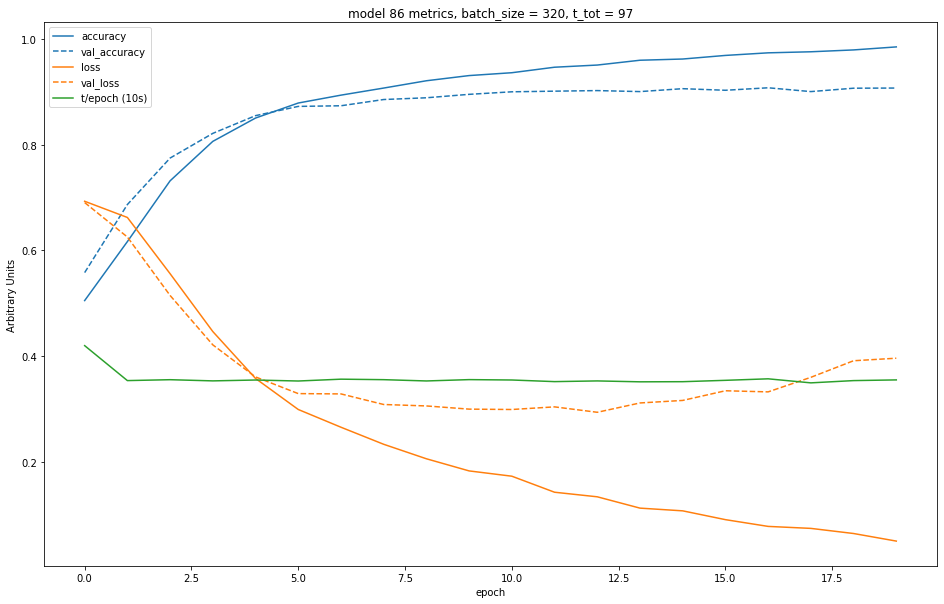

Creating model 87...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


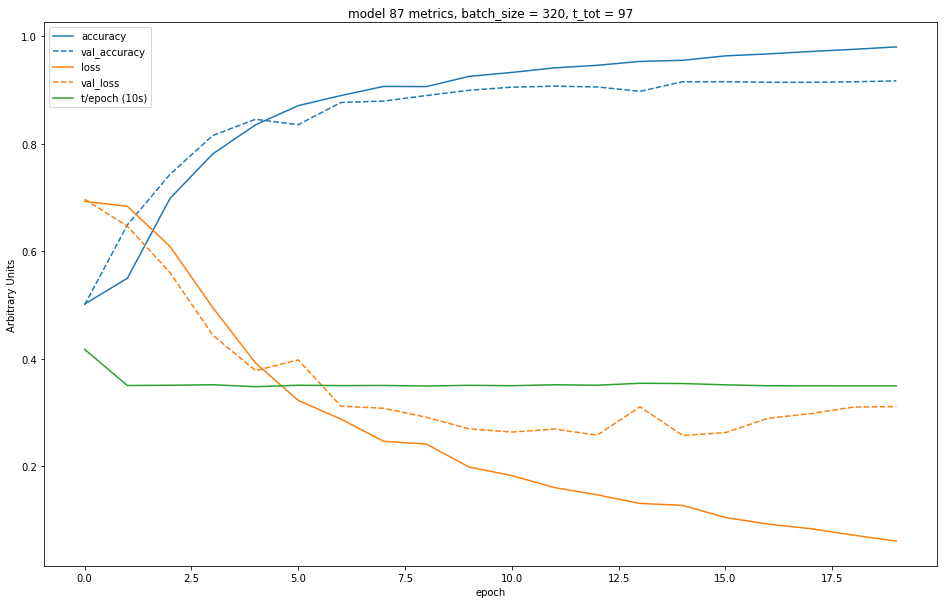

Creating model 88...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


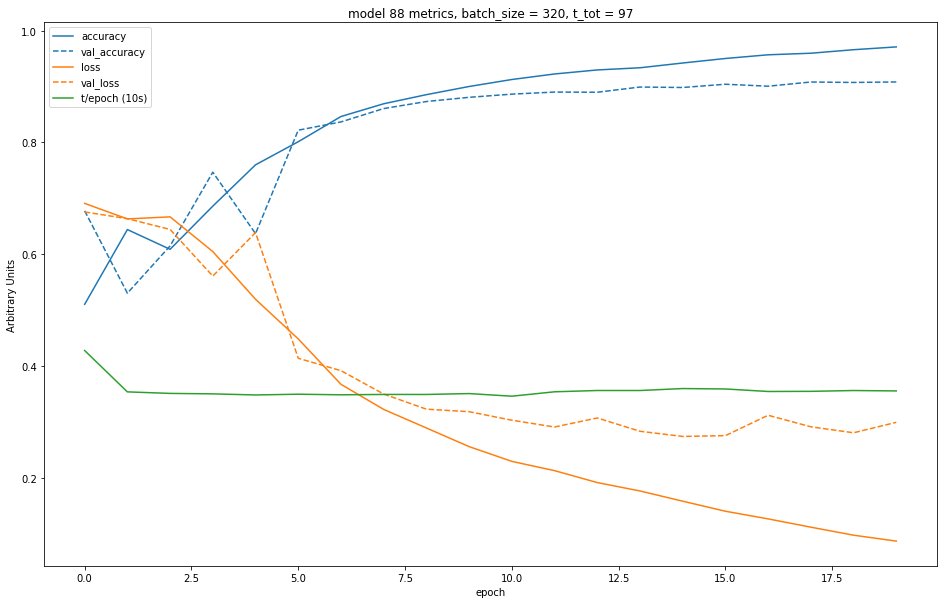

Creating model 89...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


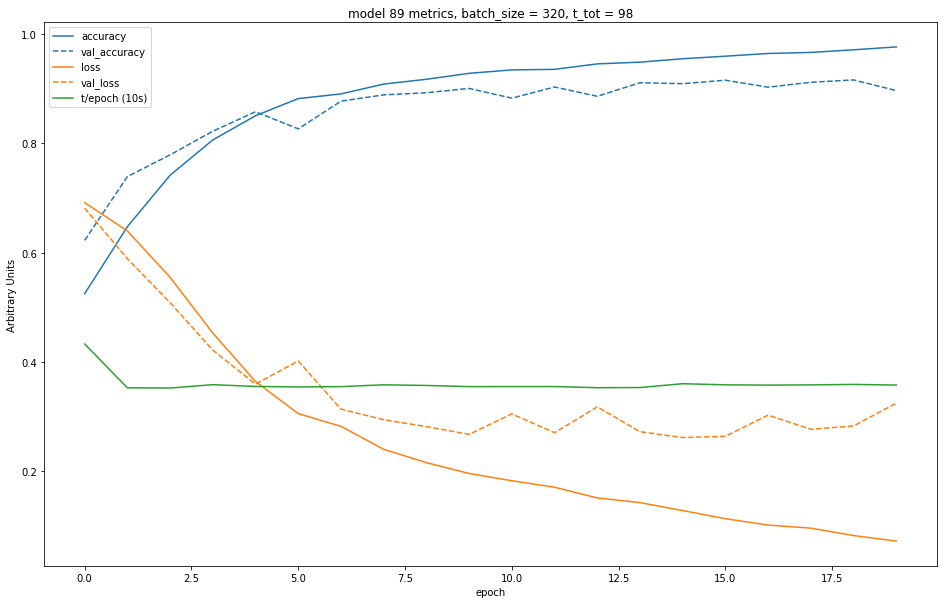

Creating model 90...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


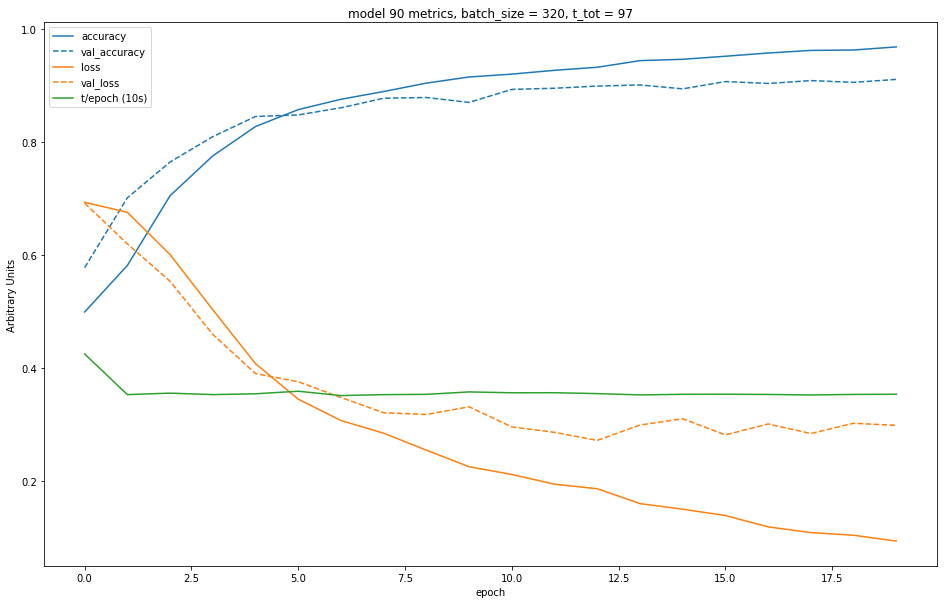

Creating model 91...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


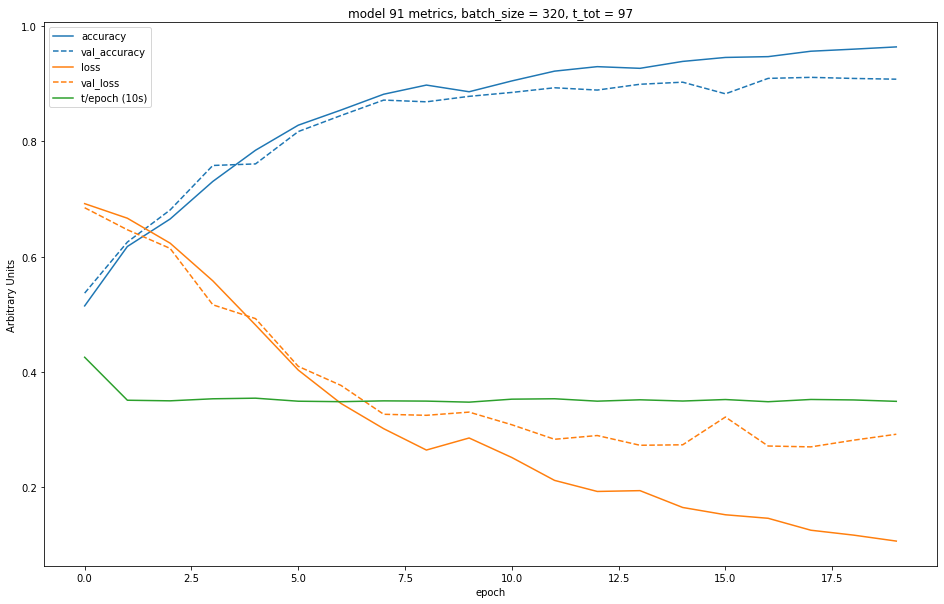

Creating model 92...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


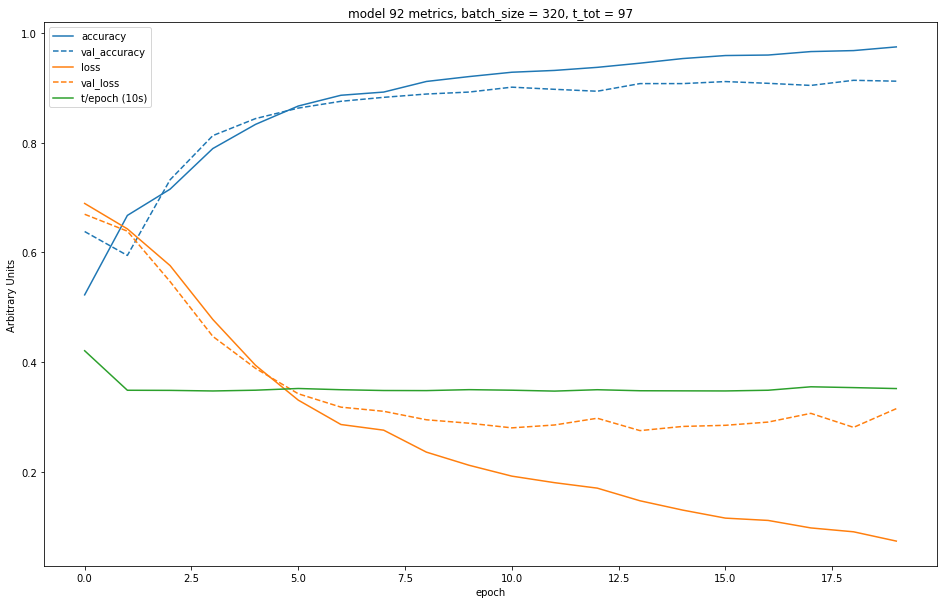

Creating model 93...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


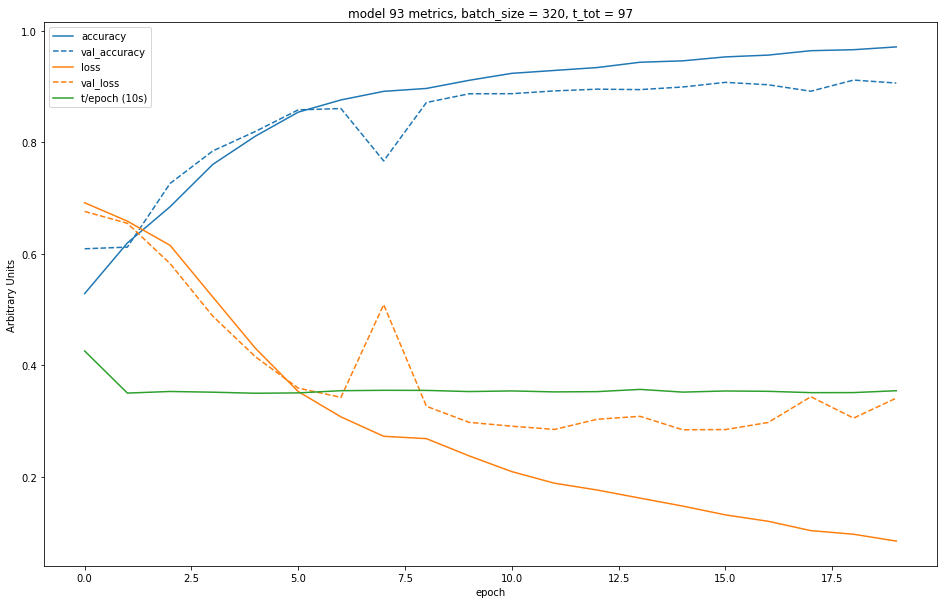

Creating model 94...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


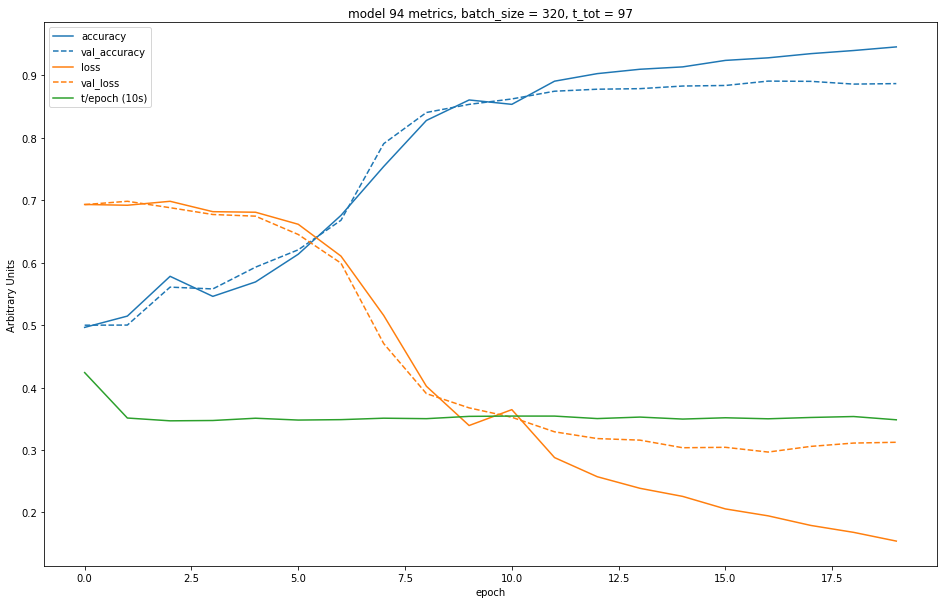

Creating model 95...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


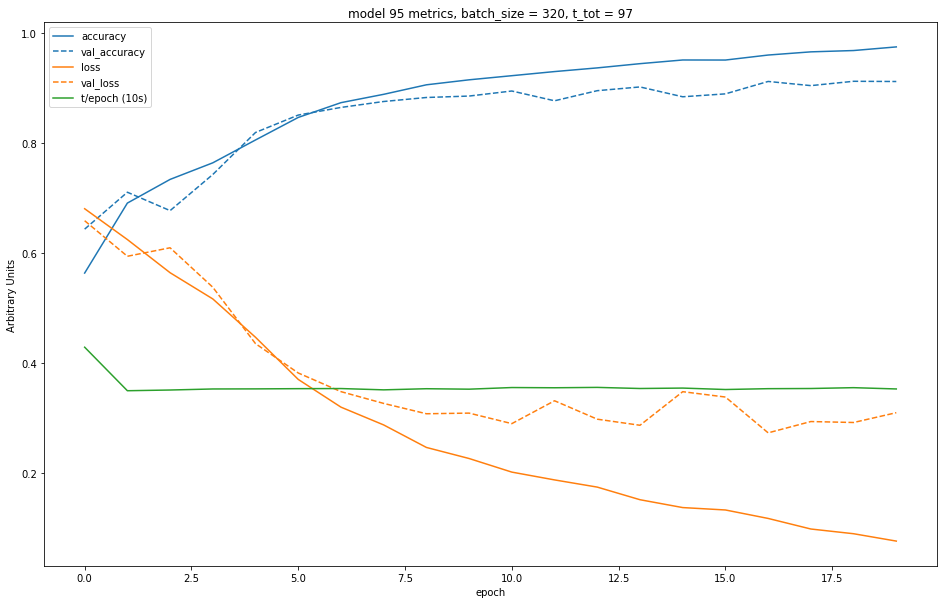

Creating model 96...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


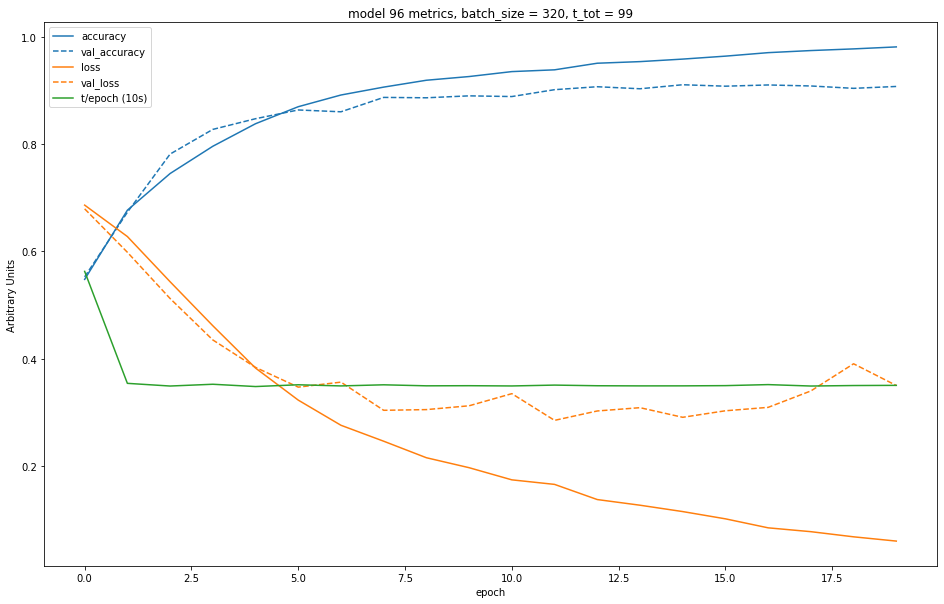

Creating model 97...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


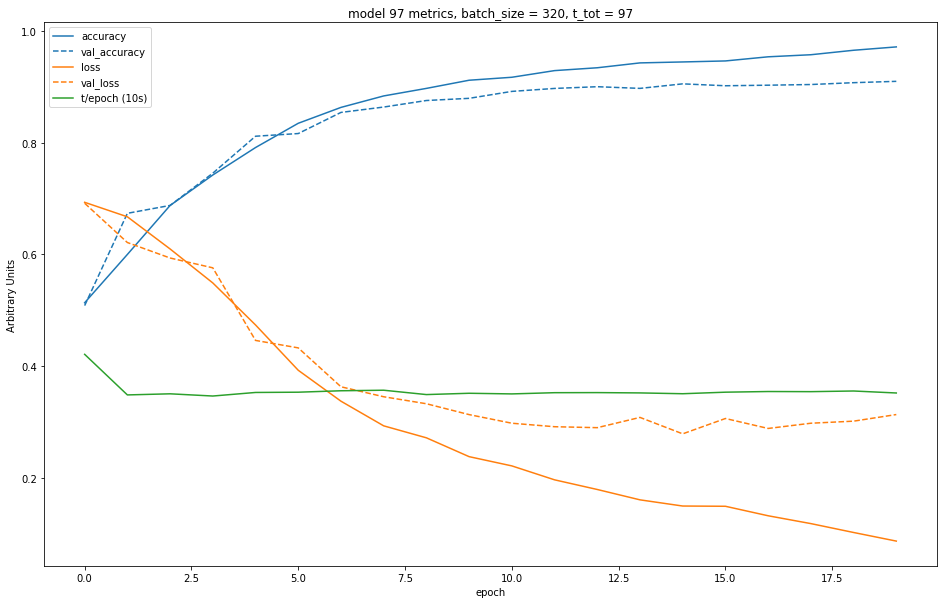

Creating model 98...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


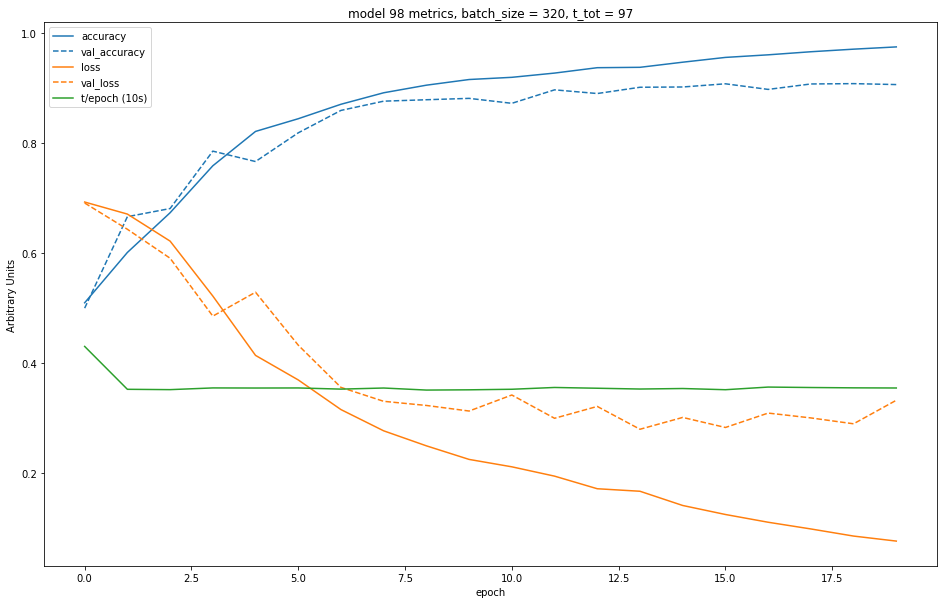

Creating model 99...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


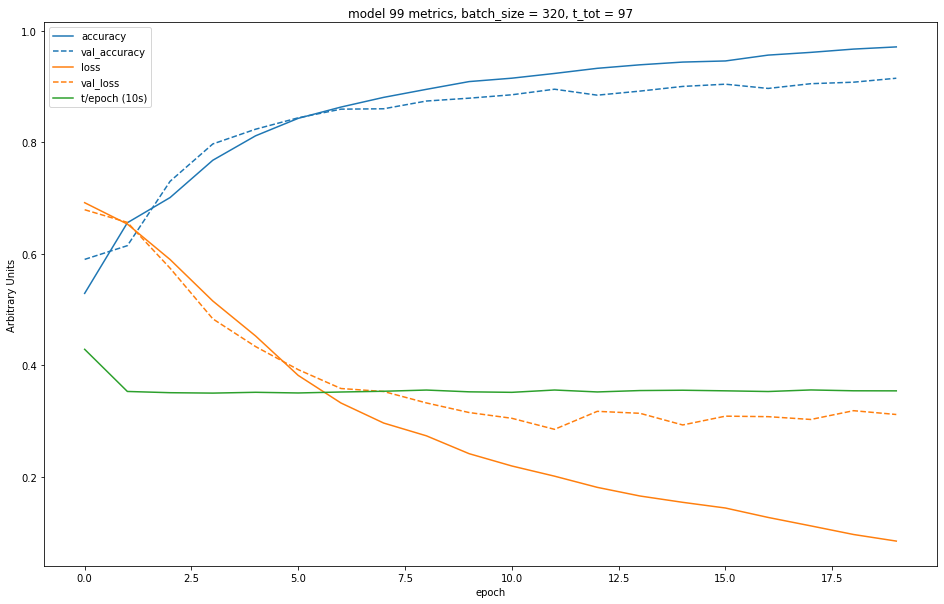

Creating model 100...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


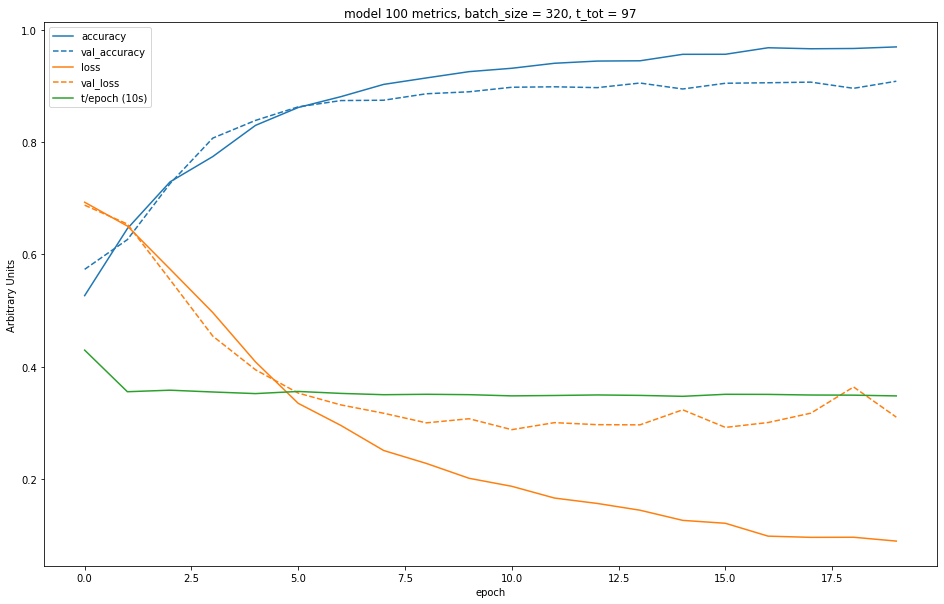

Creating model 101...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


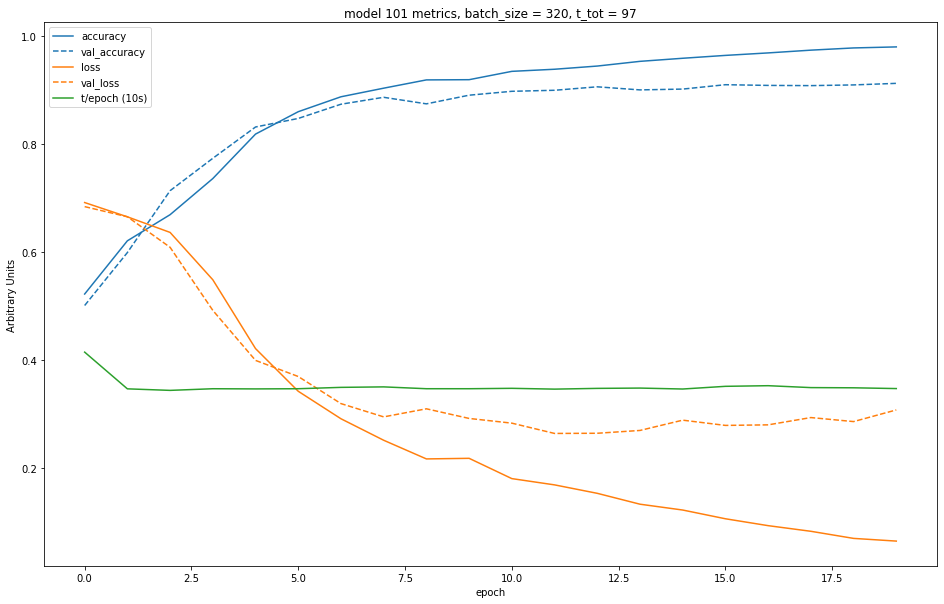

Creating model 102...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


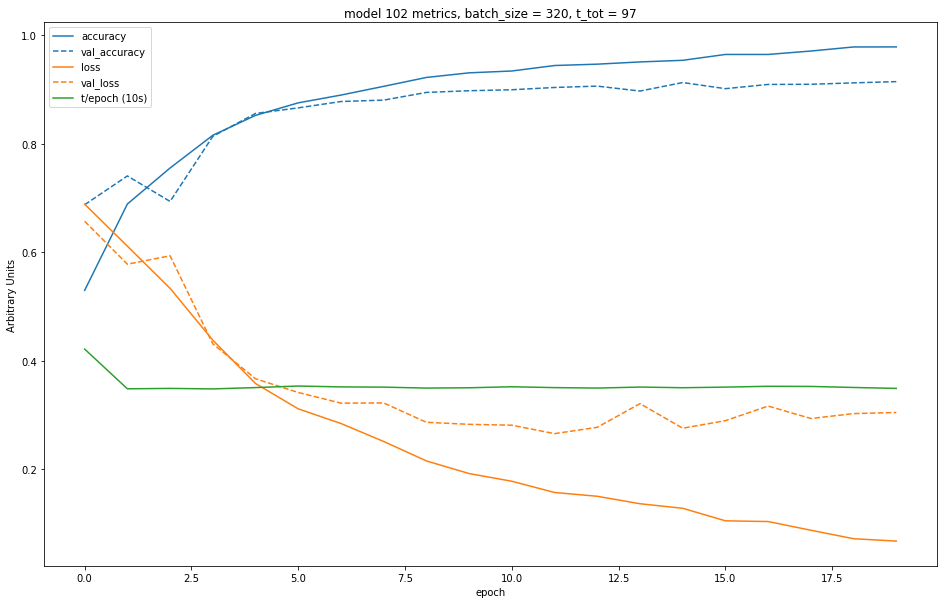

Creating model 103...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


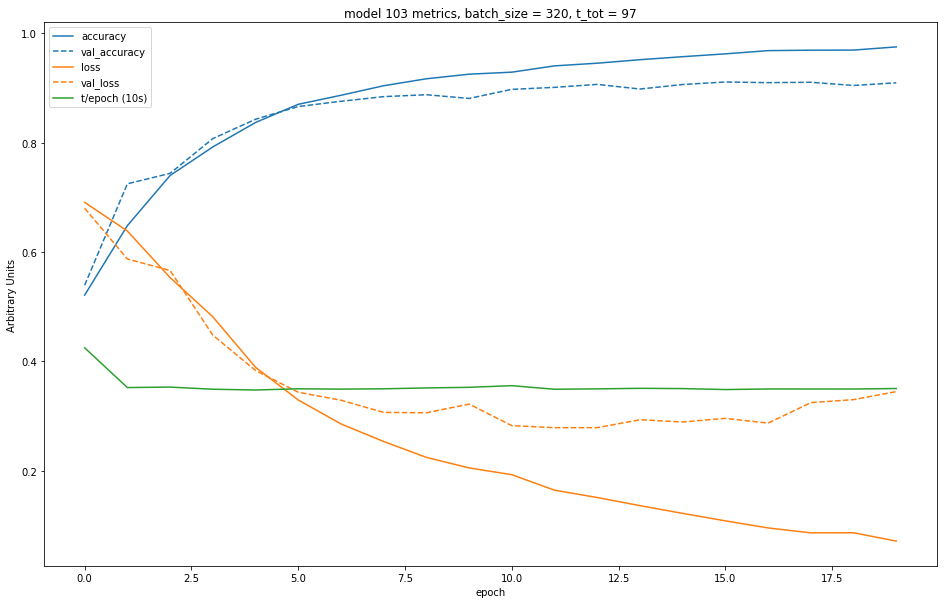

Creating model 104...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


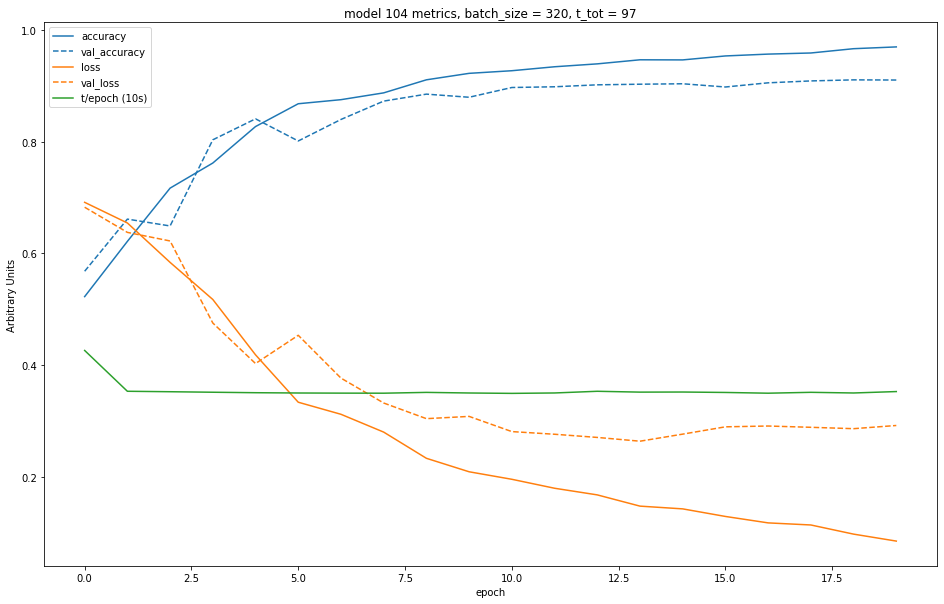

Creating model 105...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


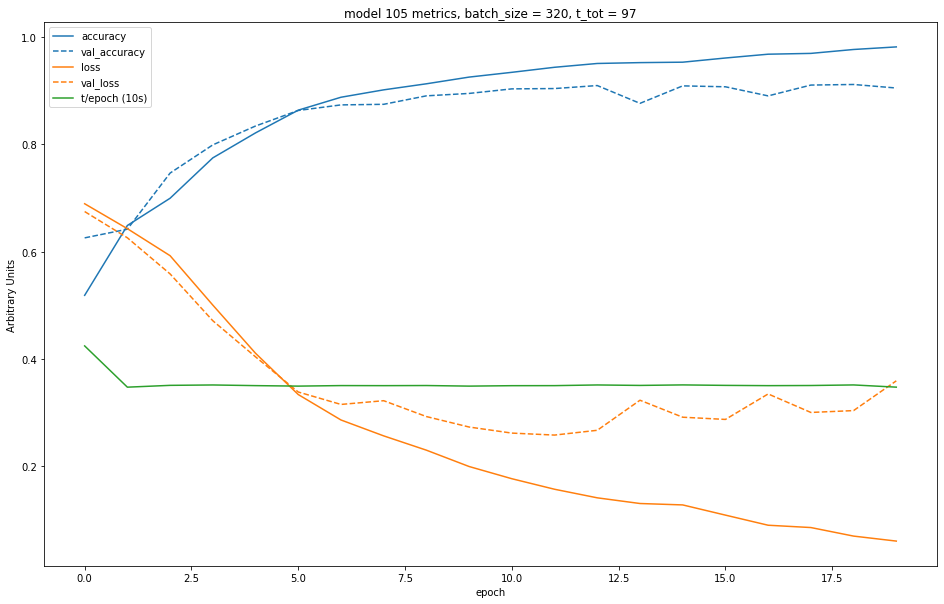

Creating model 106...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


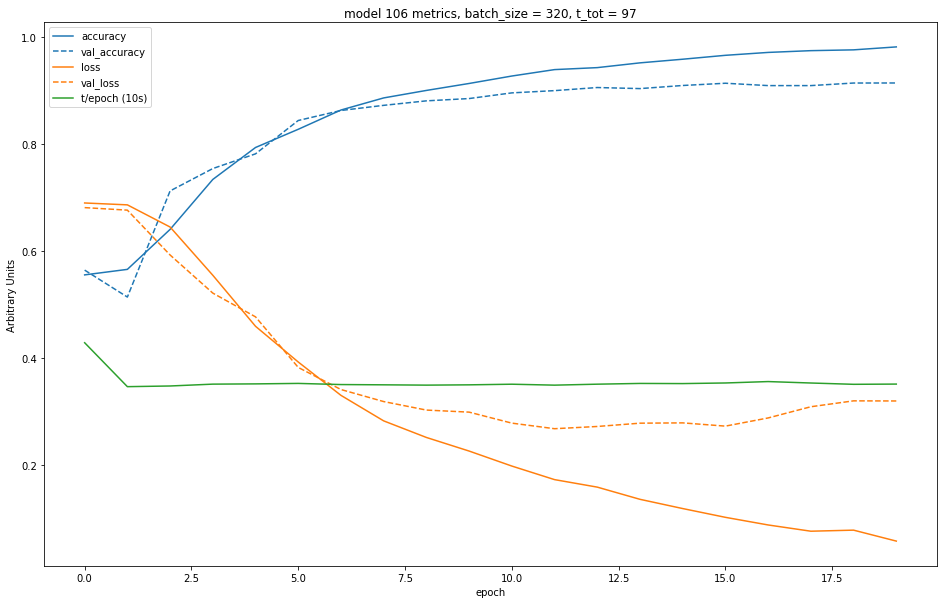

Creating model 107...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


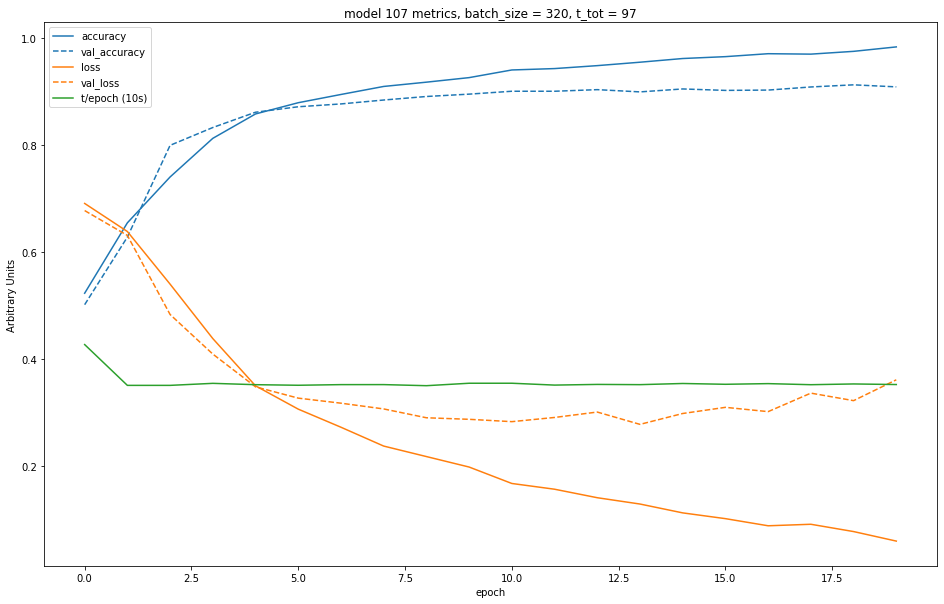

Creating model 108...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


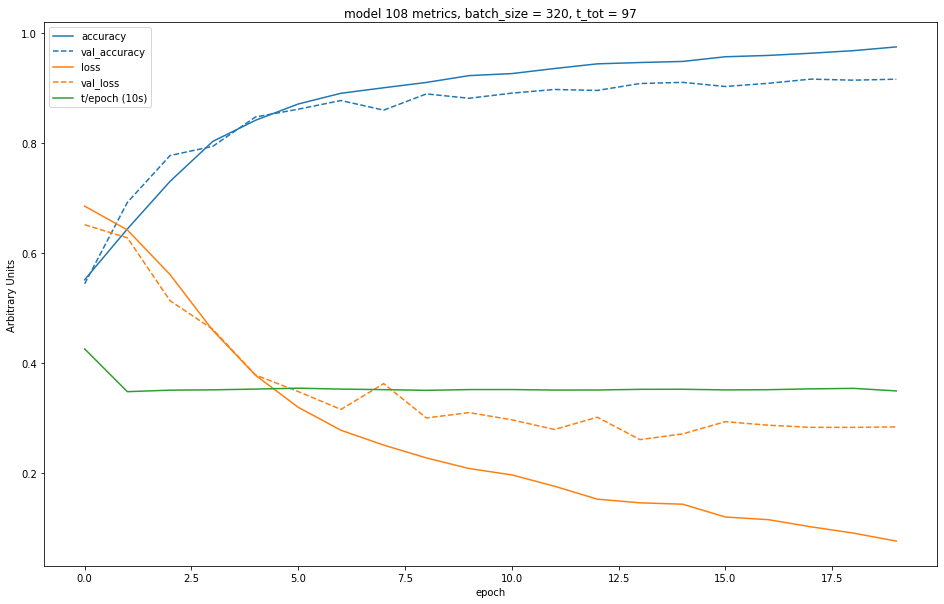

Creating model 109...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


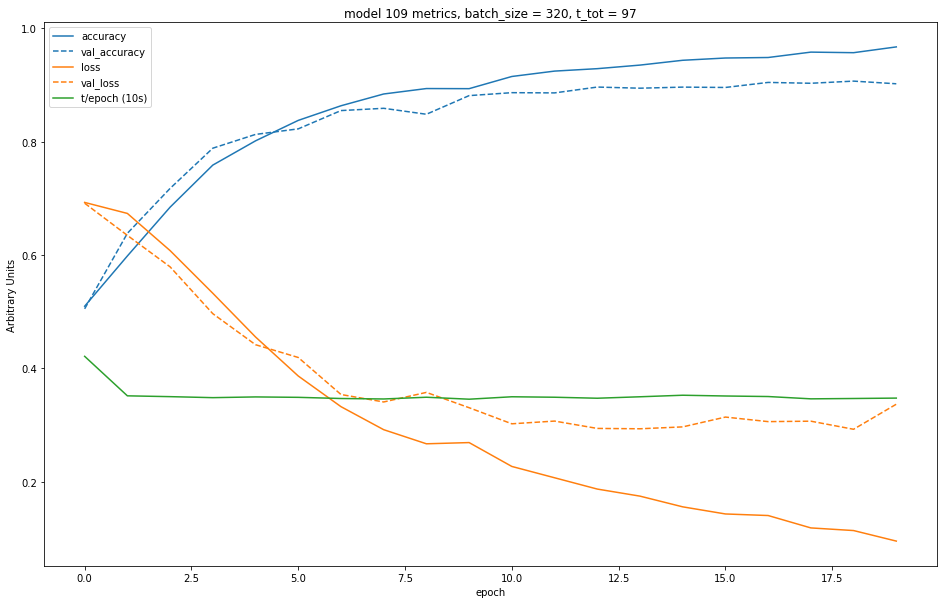

Creating model 110...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


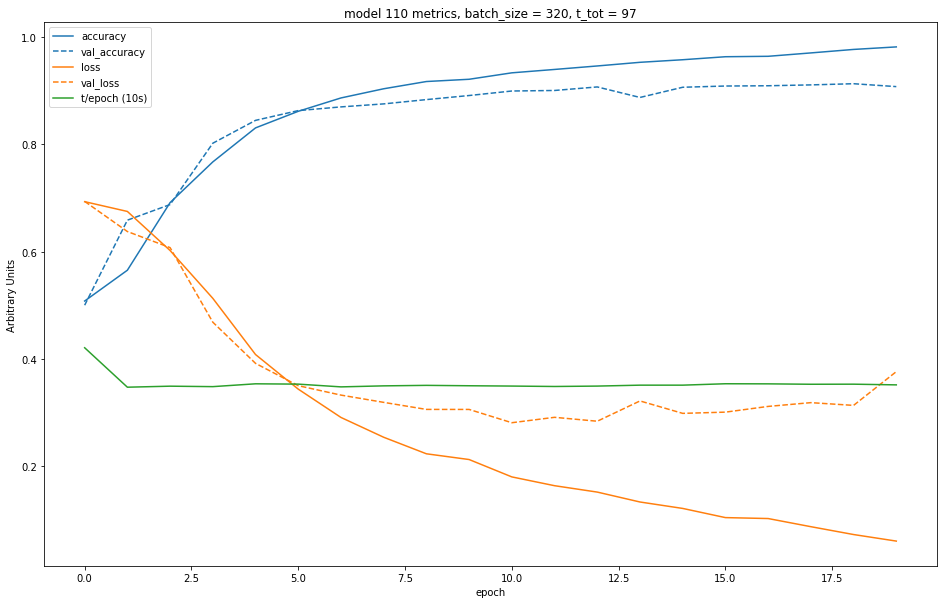

Creating model 111...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


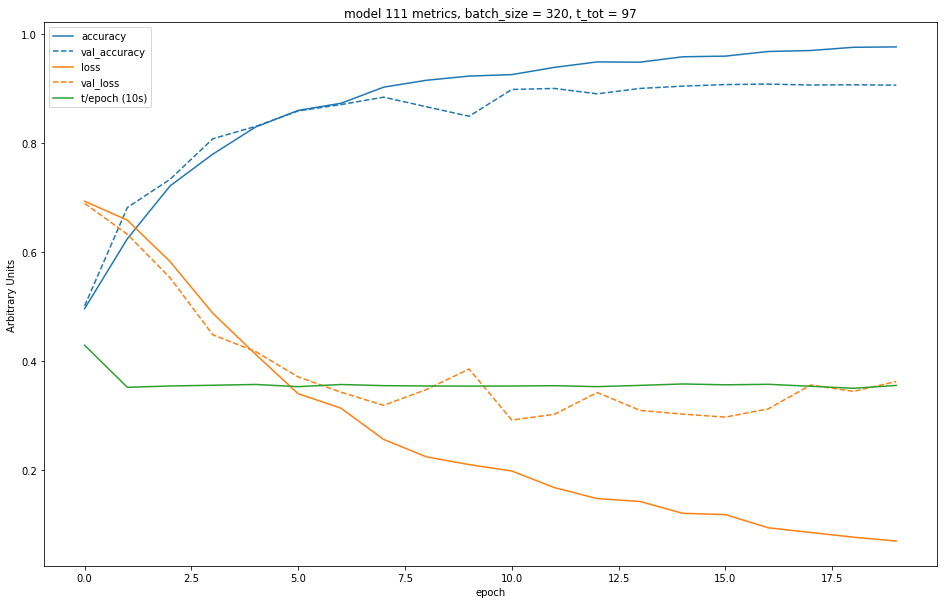

Creating model 112...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


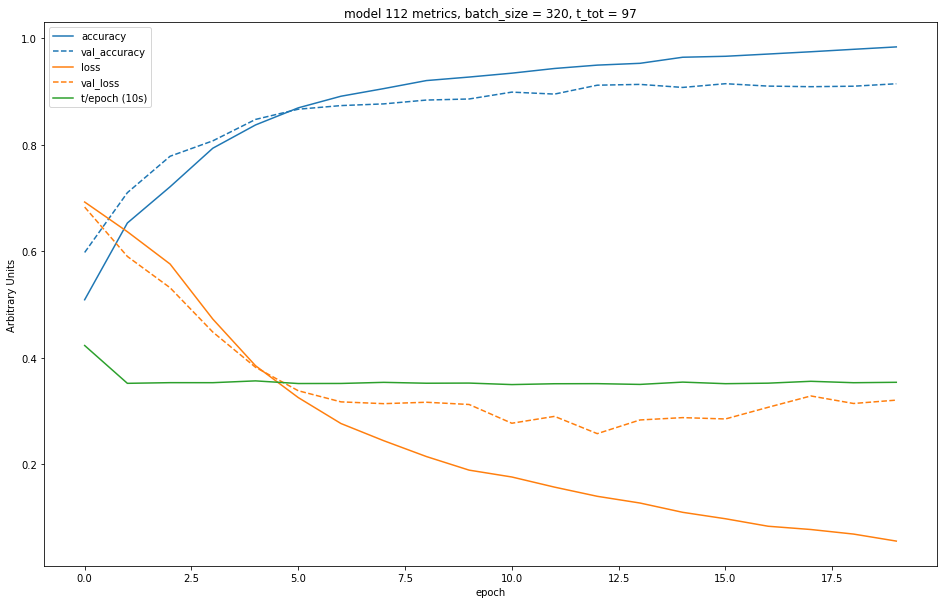

Creating model 113...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


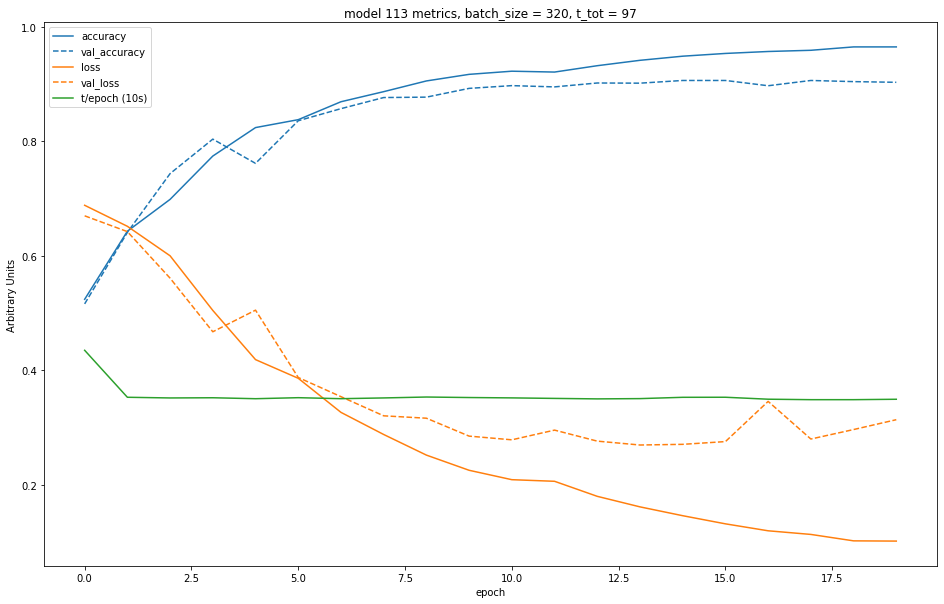

Creating model 114...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


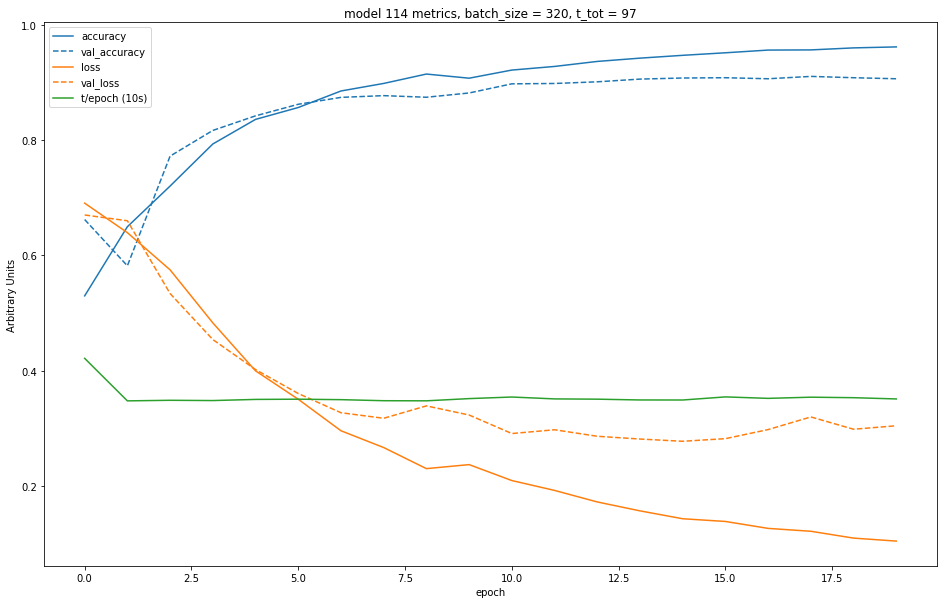

Creating model 115...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


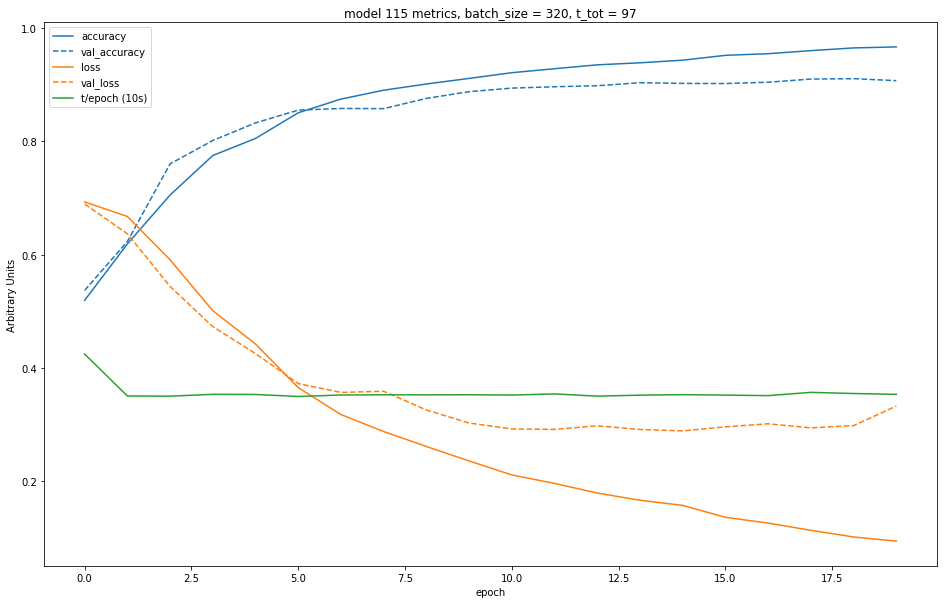

Creating model 116...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


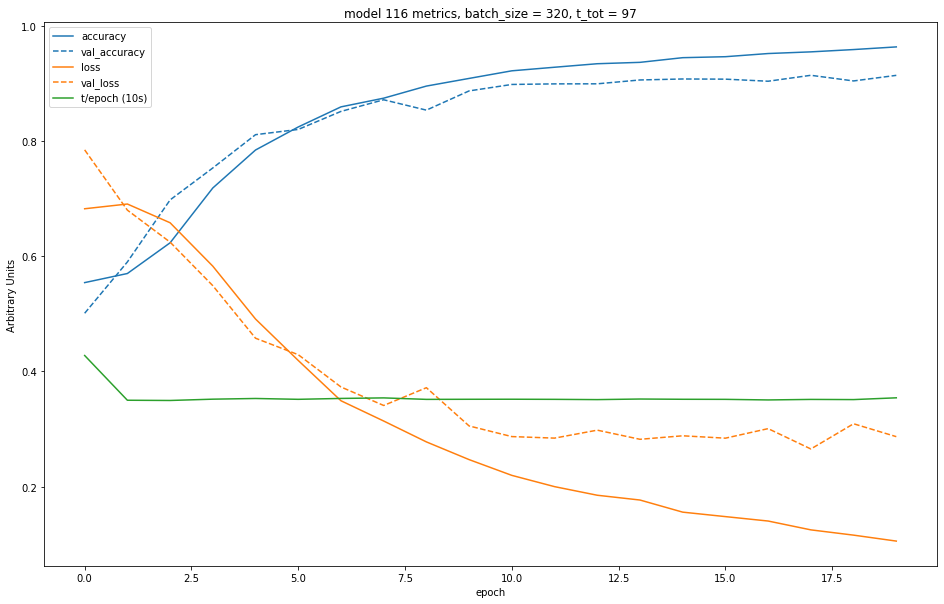

Creating model 117...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


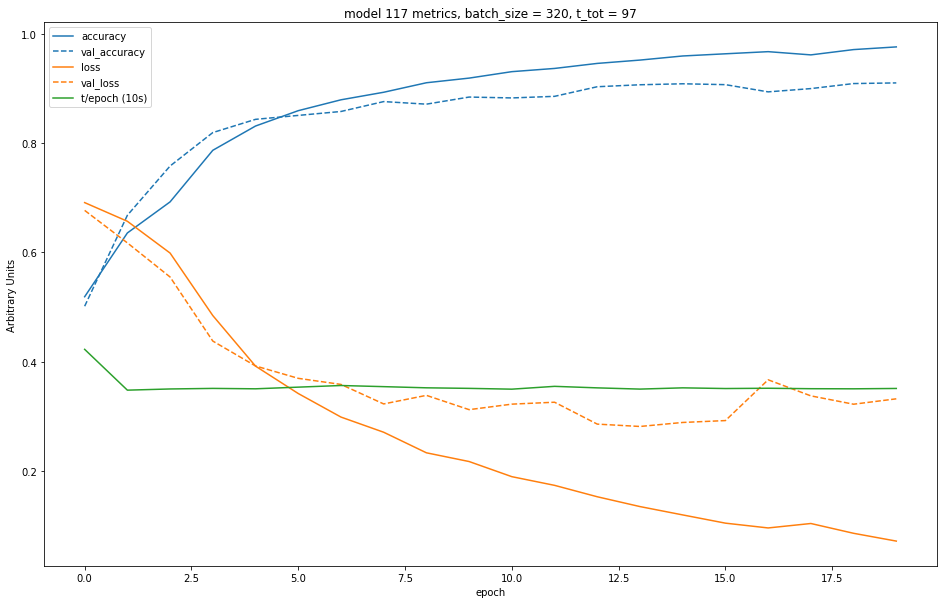

Creating model 118...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


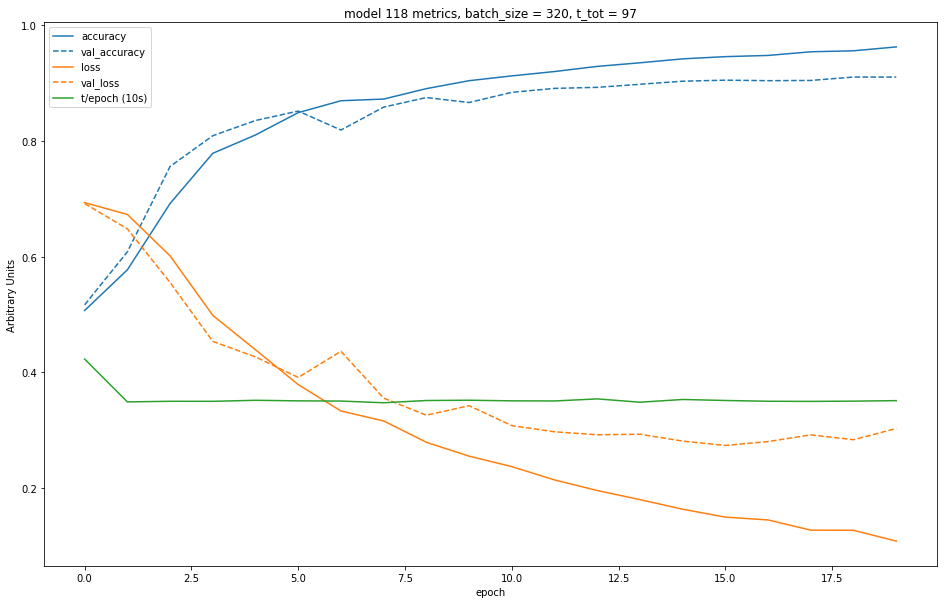

Creating model 119...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


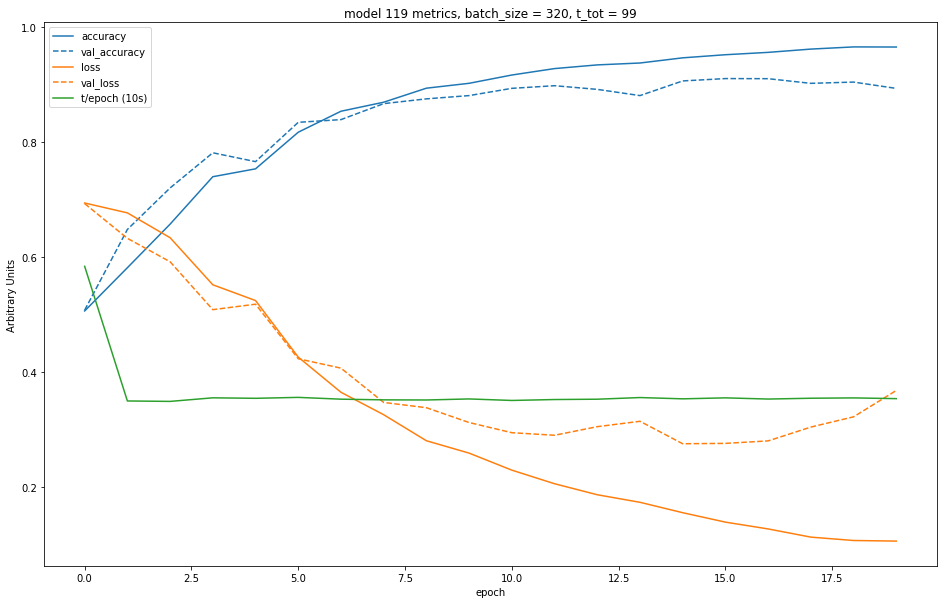

Creating model 120...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


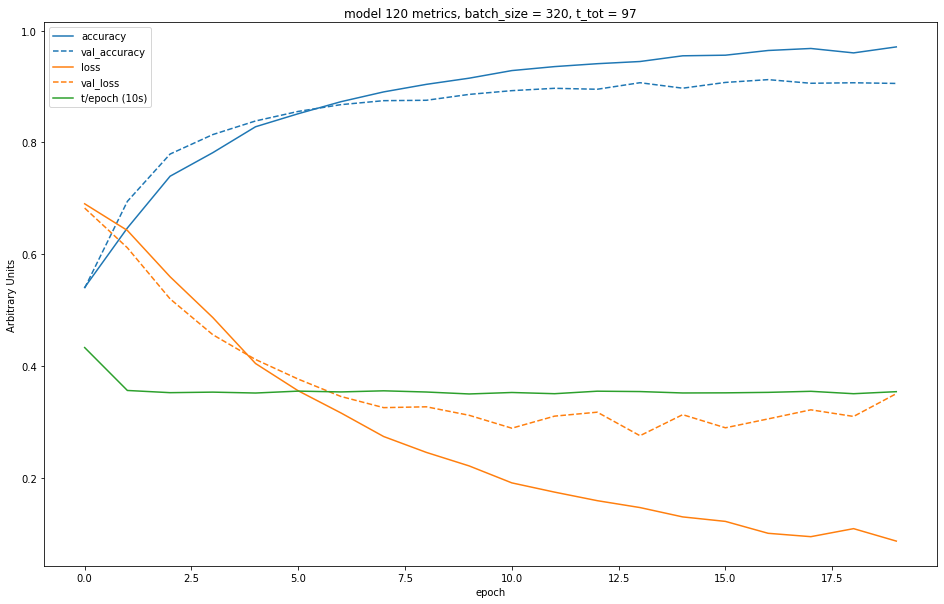

Creating model 121...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


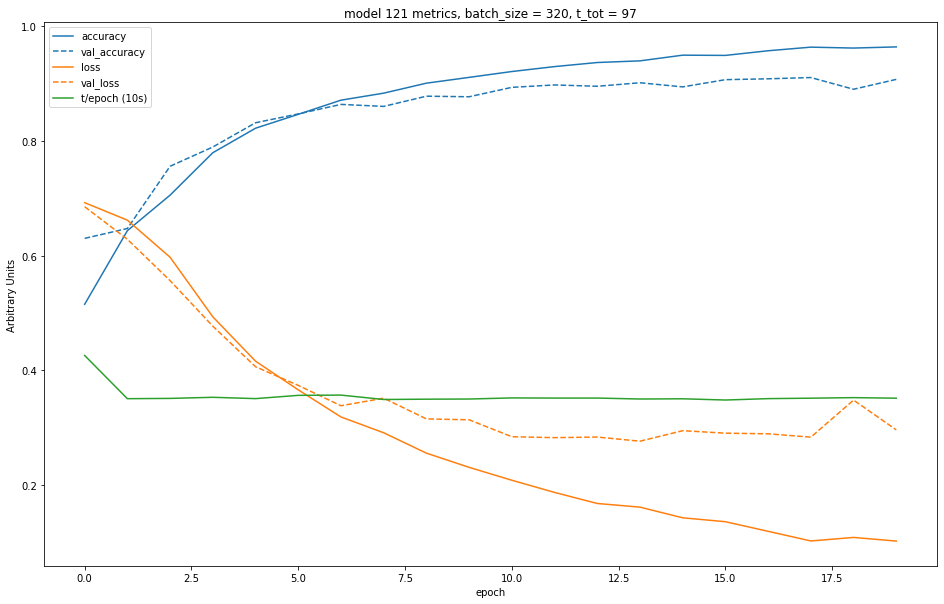

Creating model 122...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


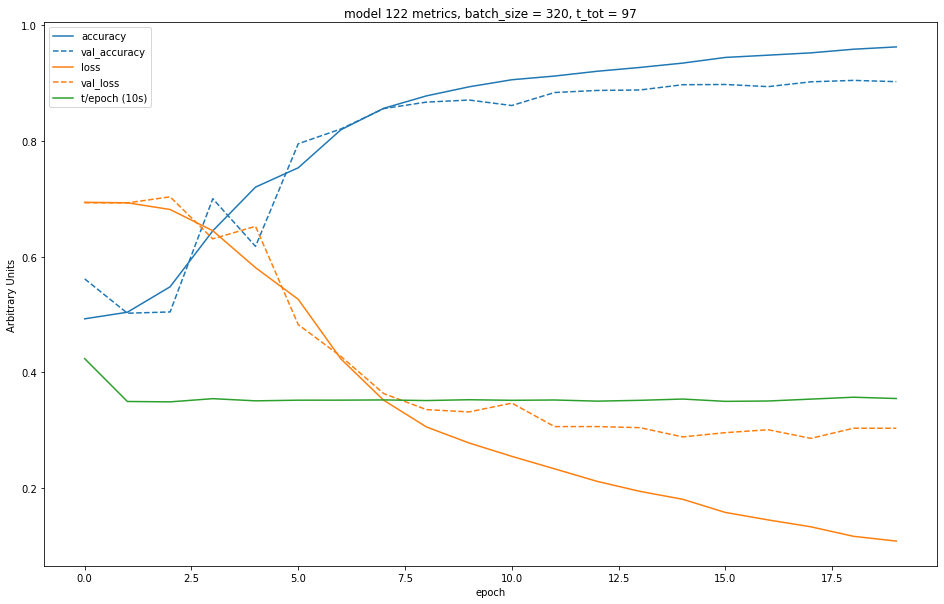

Creating model 123...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


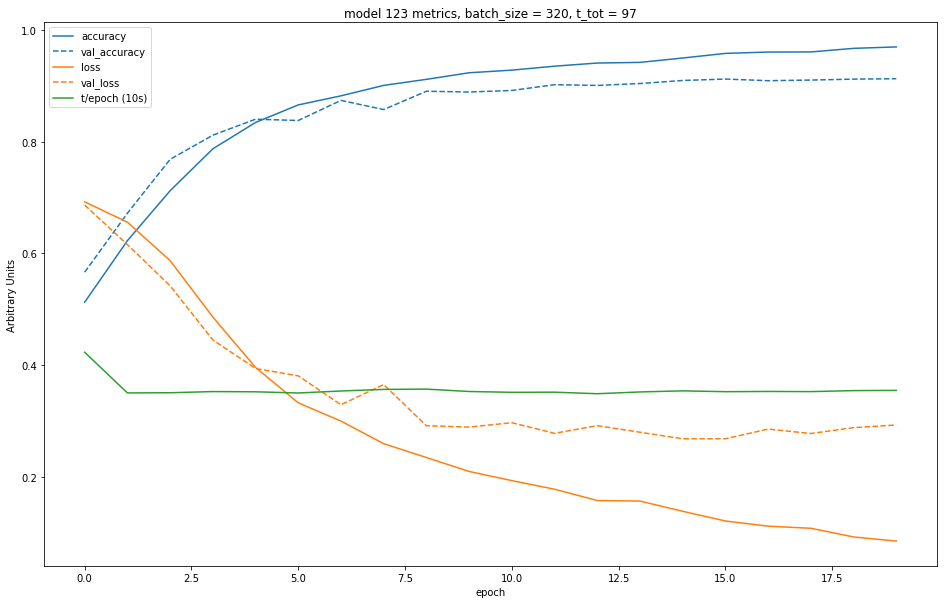

Creating model 124...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


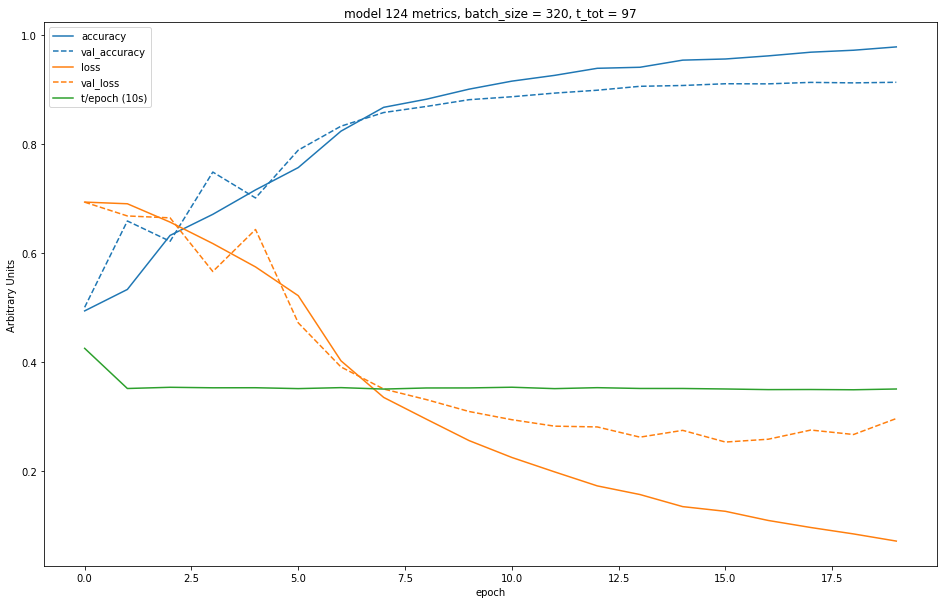

Creating model 125...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


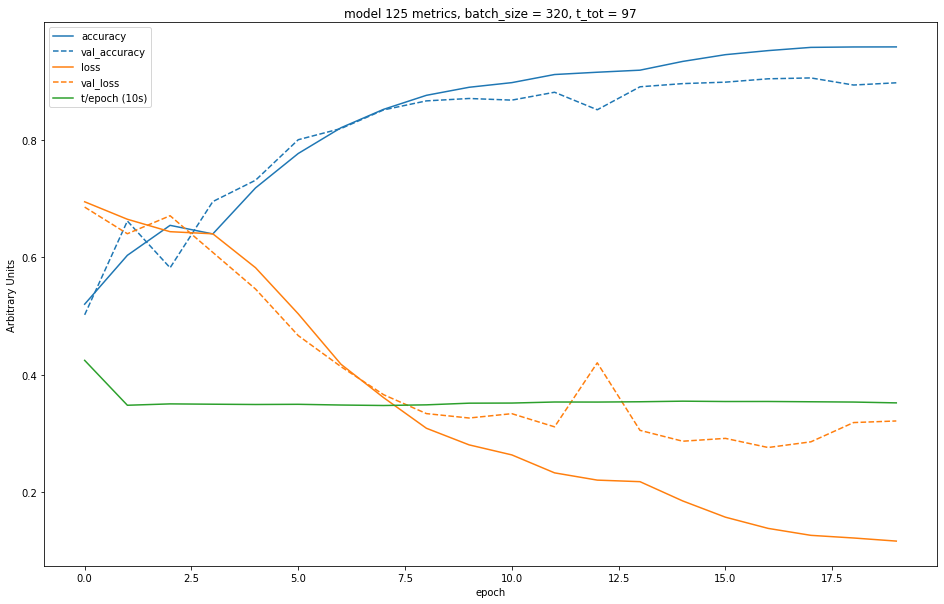

Creating model 126...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


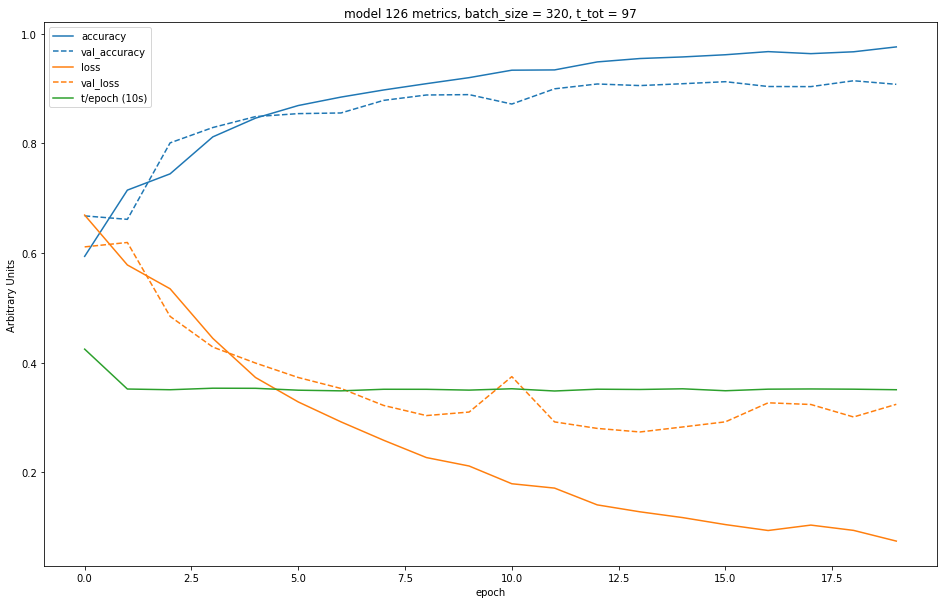

Creating model 127...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


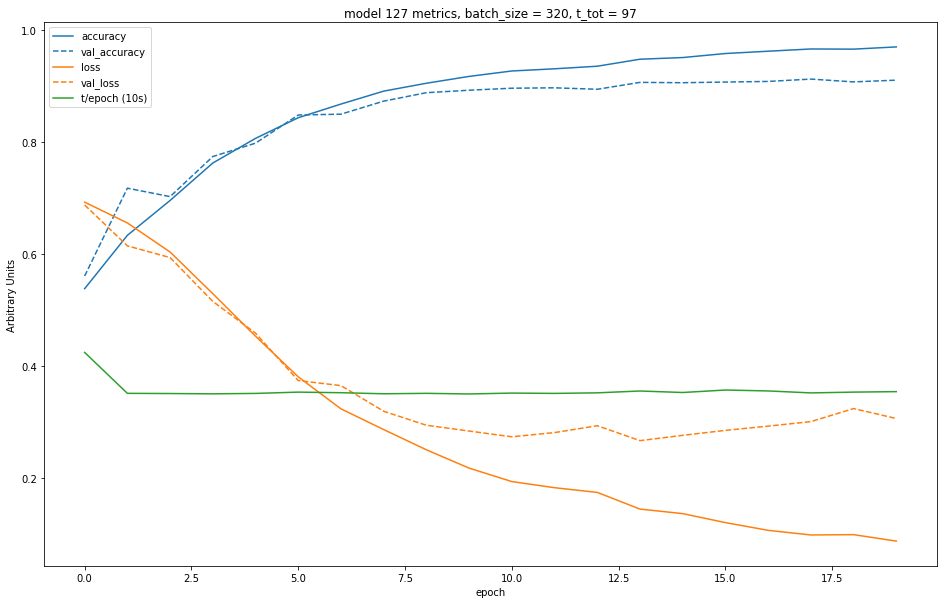

Creating model 128...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


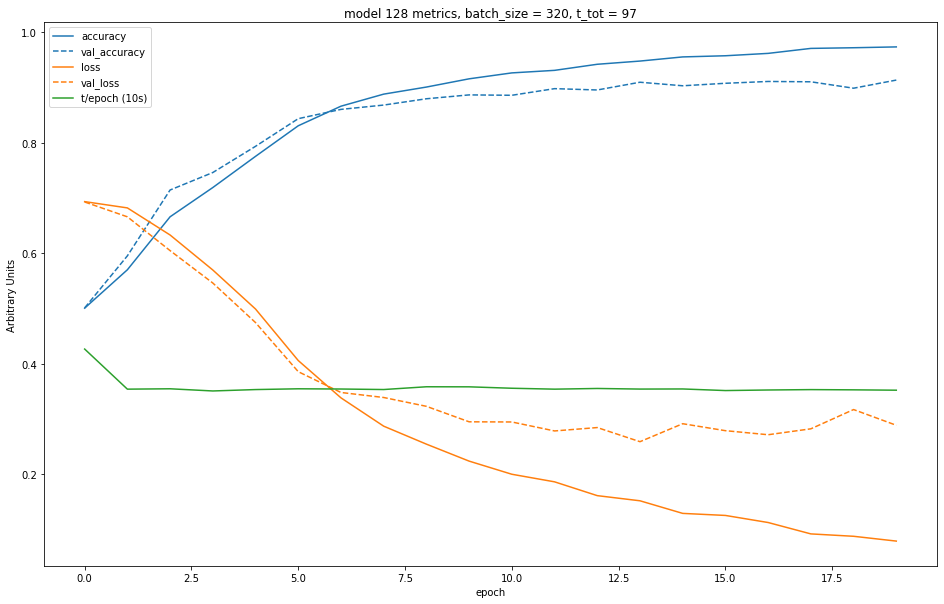

Creating model 129...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


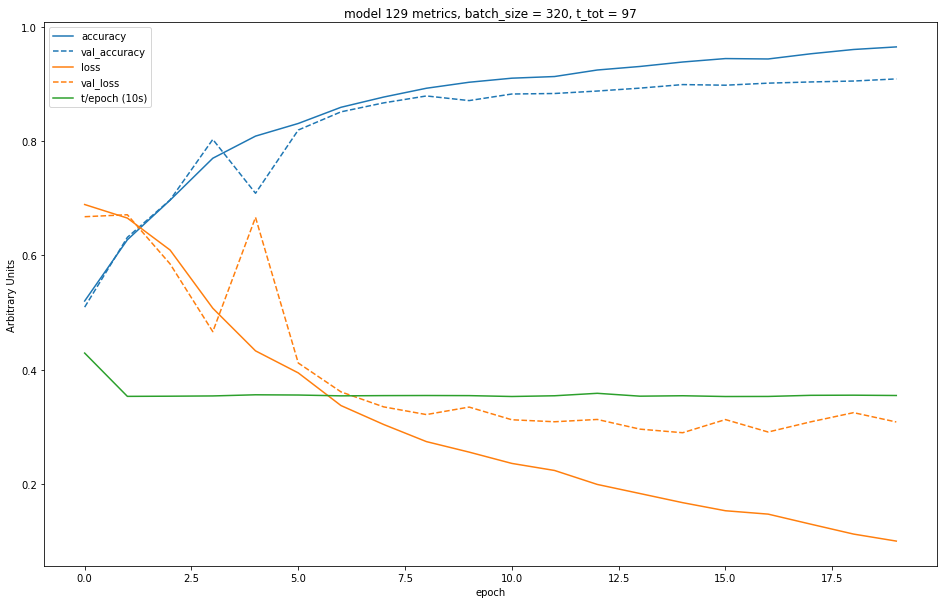

Creating model 130...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


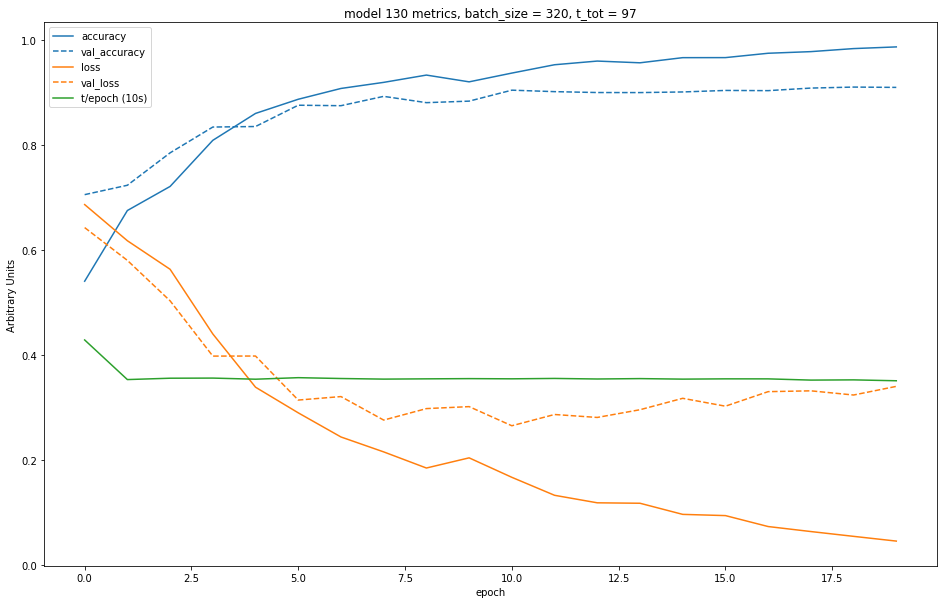

Creating model 131...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


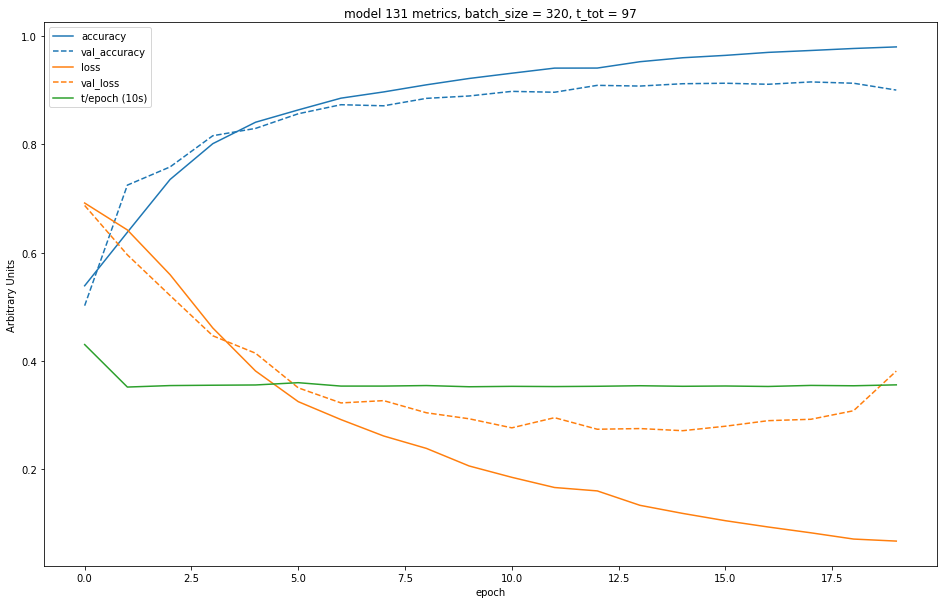

Creating model 132...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


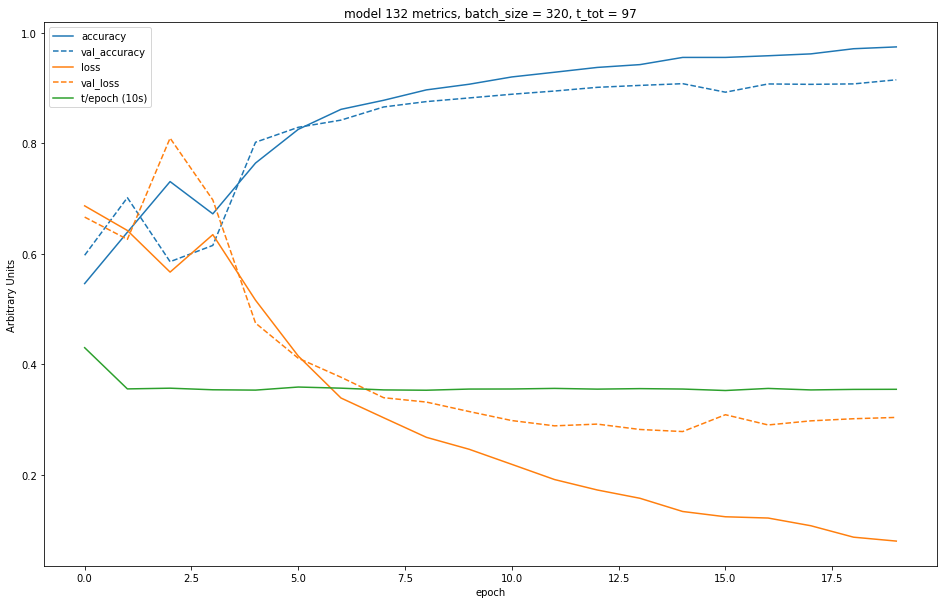

Creating model 133...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


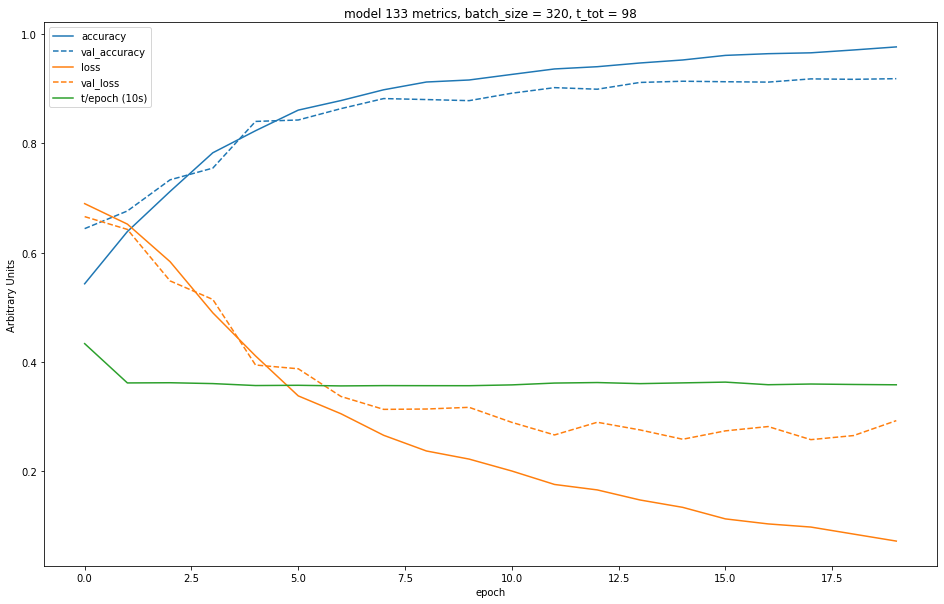

Creating model 134...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


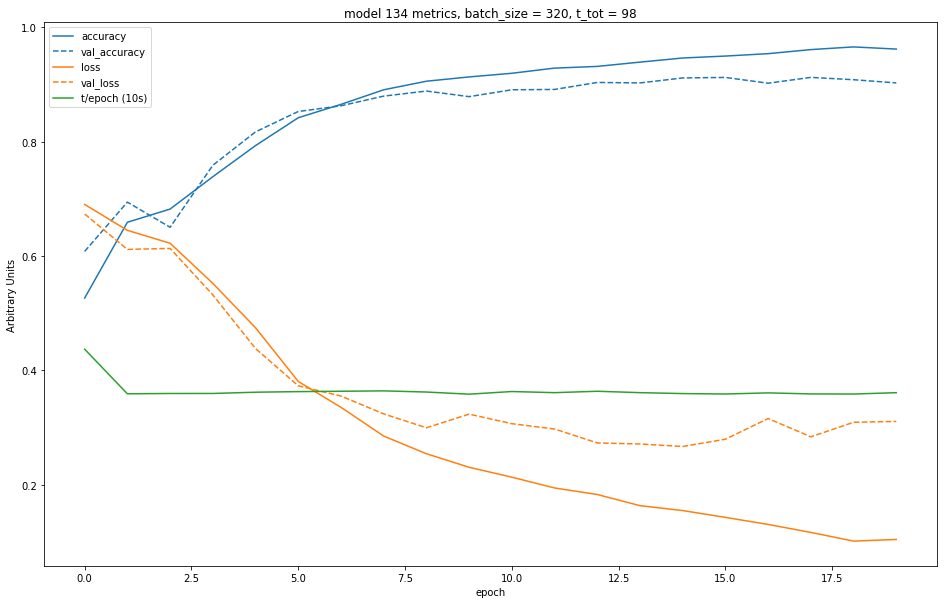

Creating model 135...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


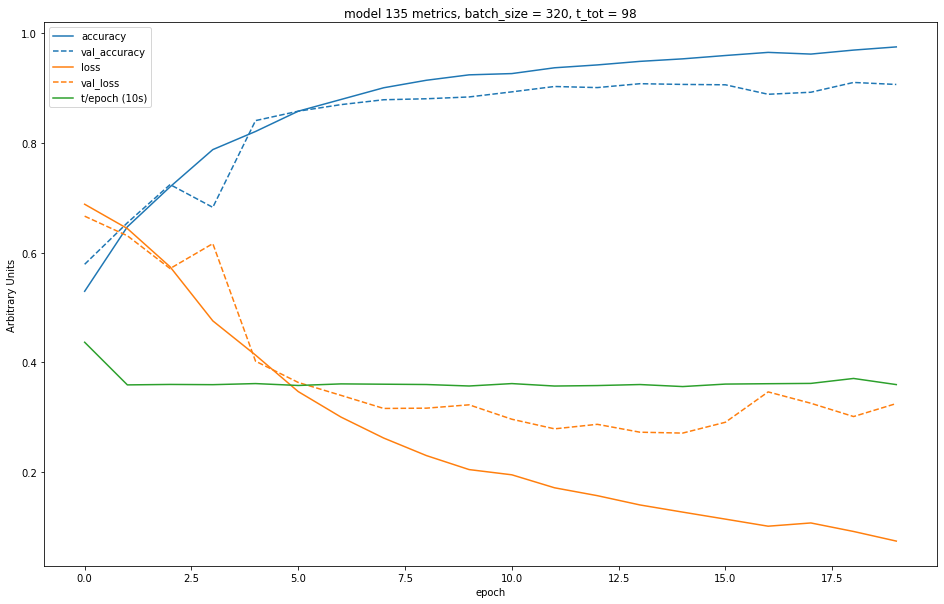

Creating model 136...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


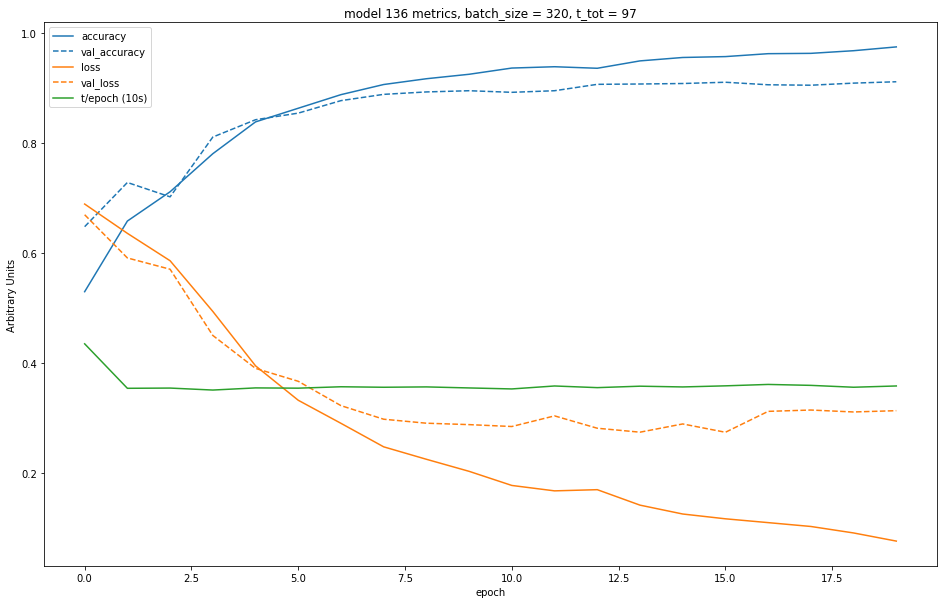

Creating model 137...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


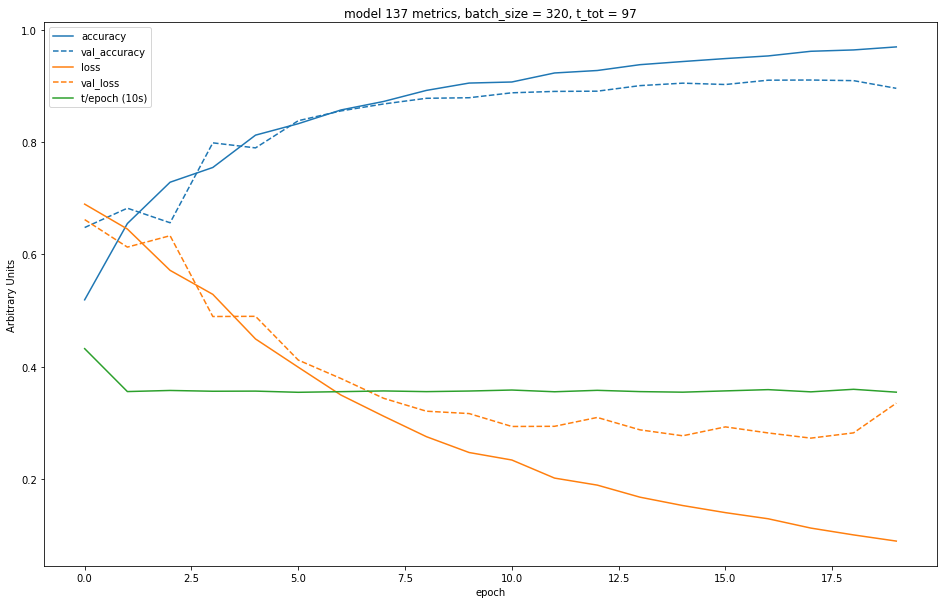

Creating model 138...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


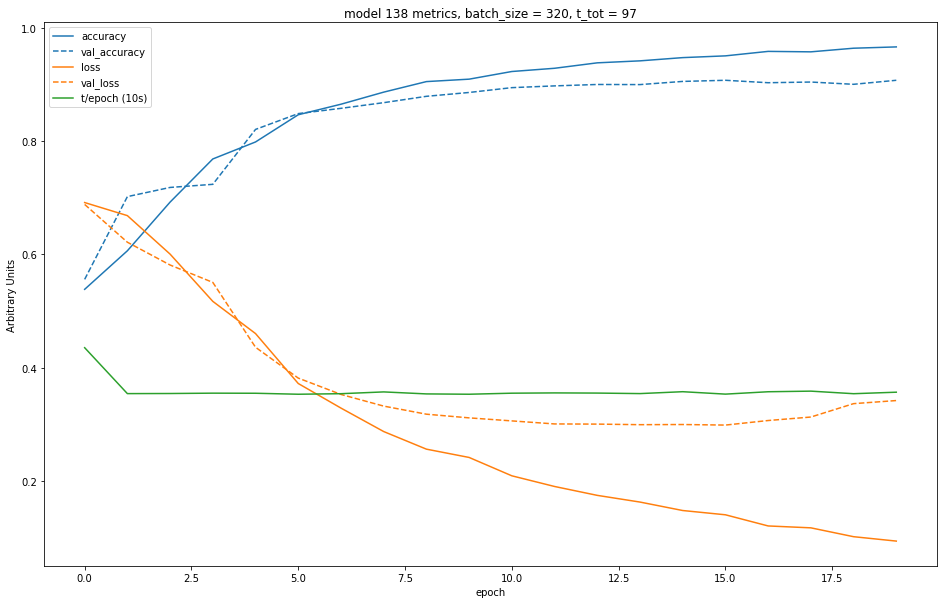

Creating model 139...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


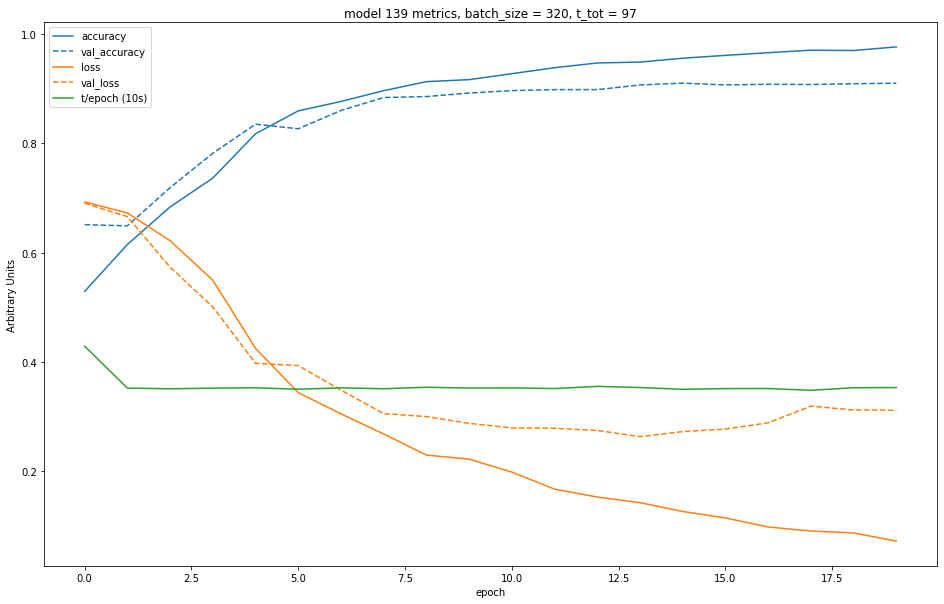

Creating model 140...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


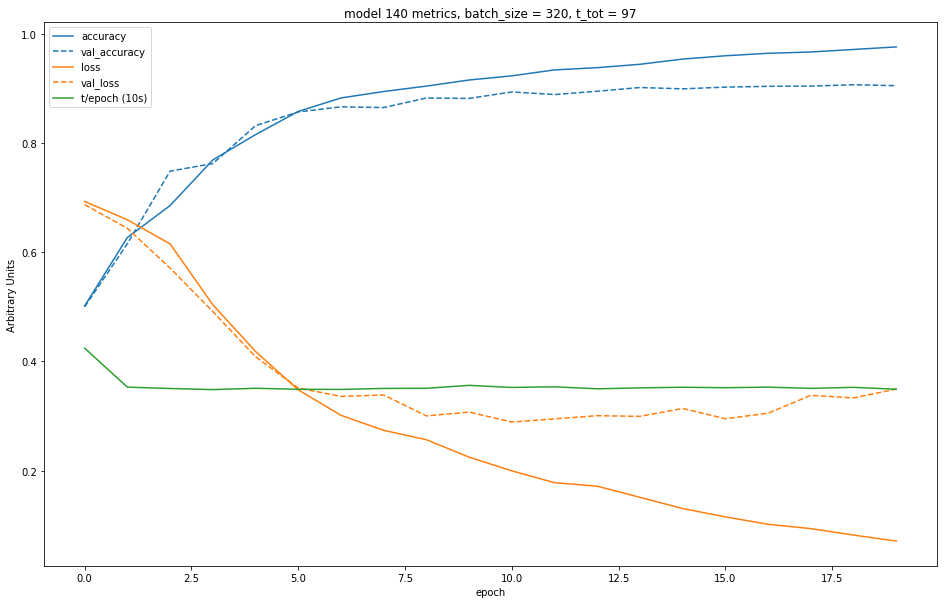

Creating model 141...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


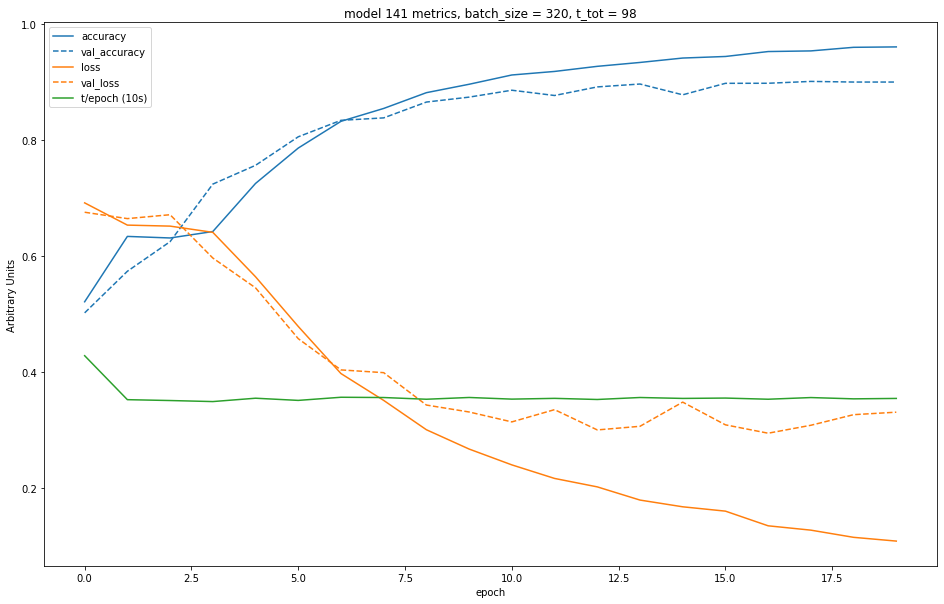

Creating model 142...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


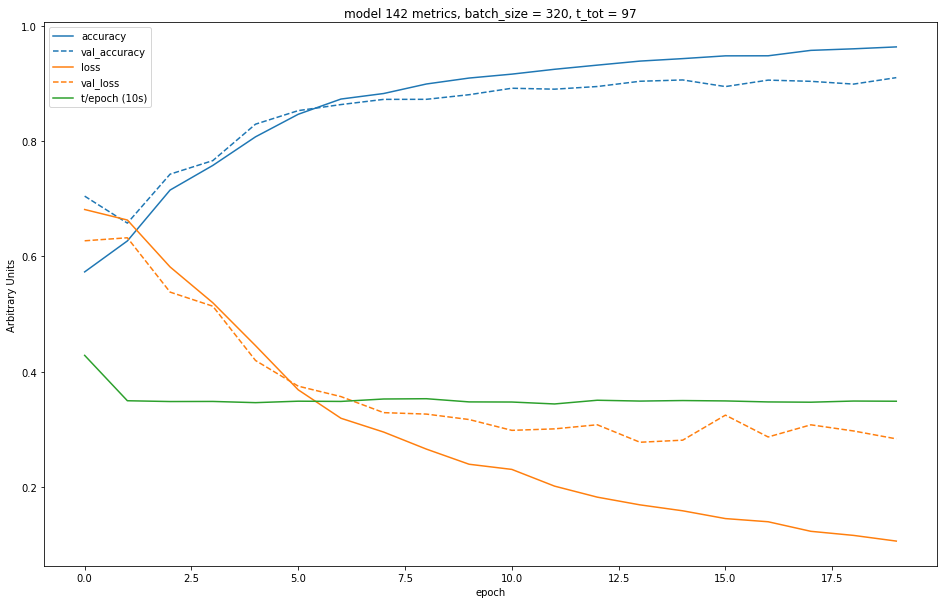

Creating model 143...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


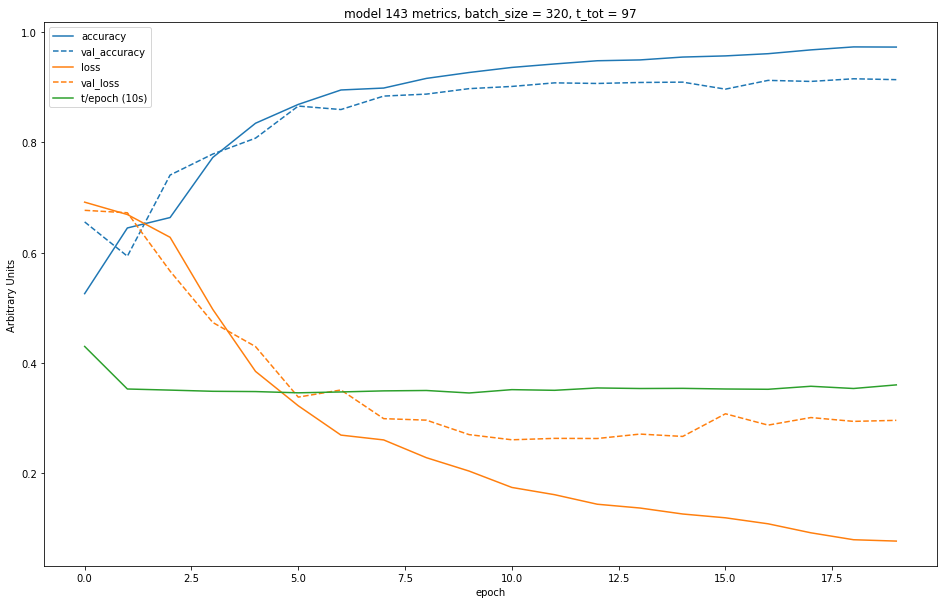

Creating model 144...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


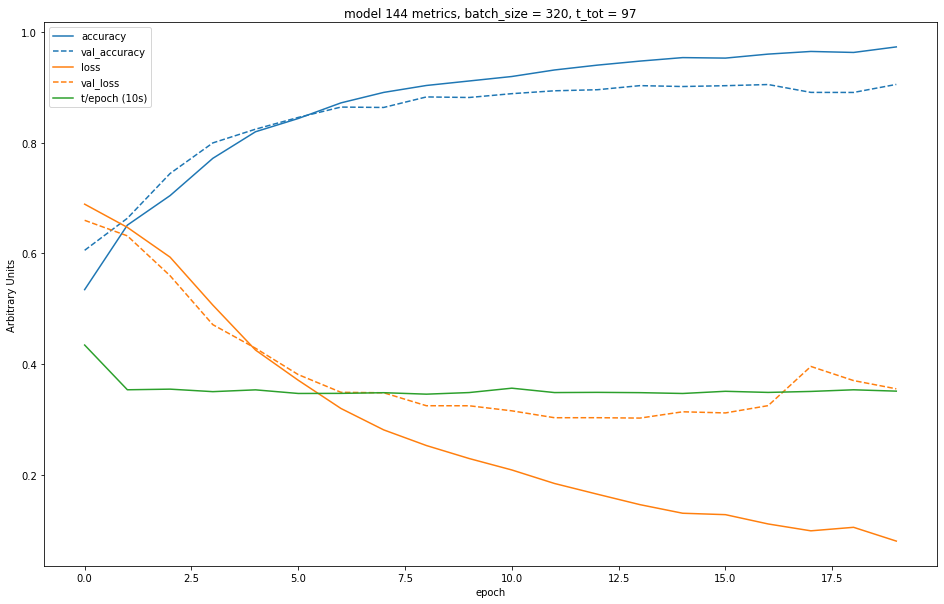

Creating model 145...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


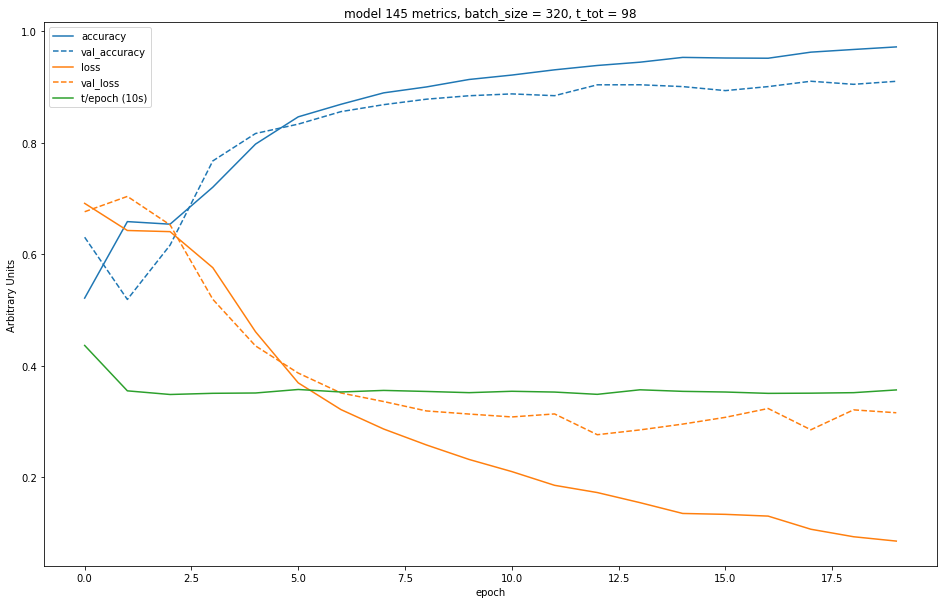

Creating model 146...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


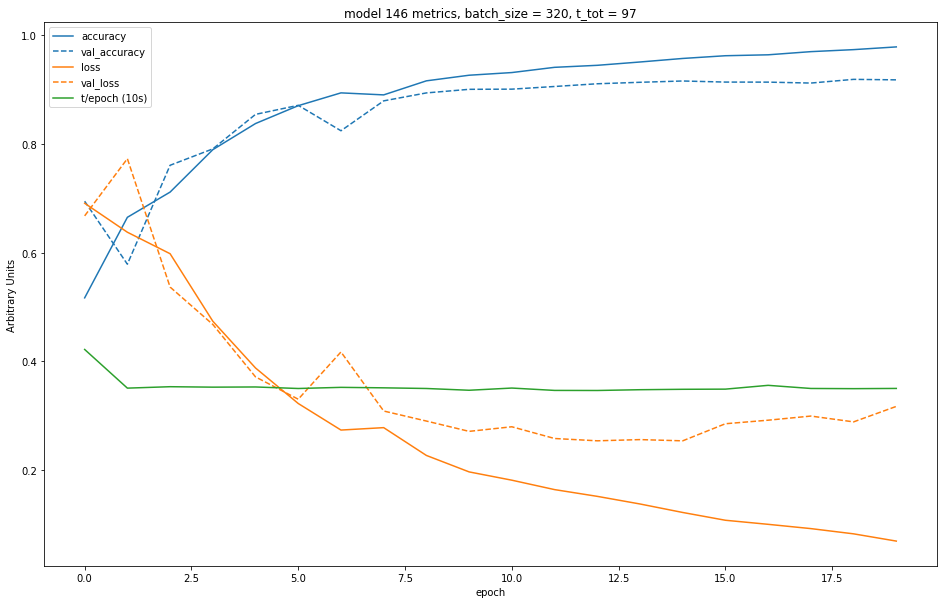

Creating model 147...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


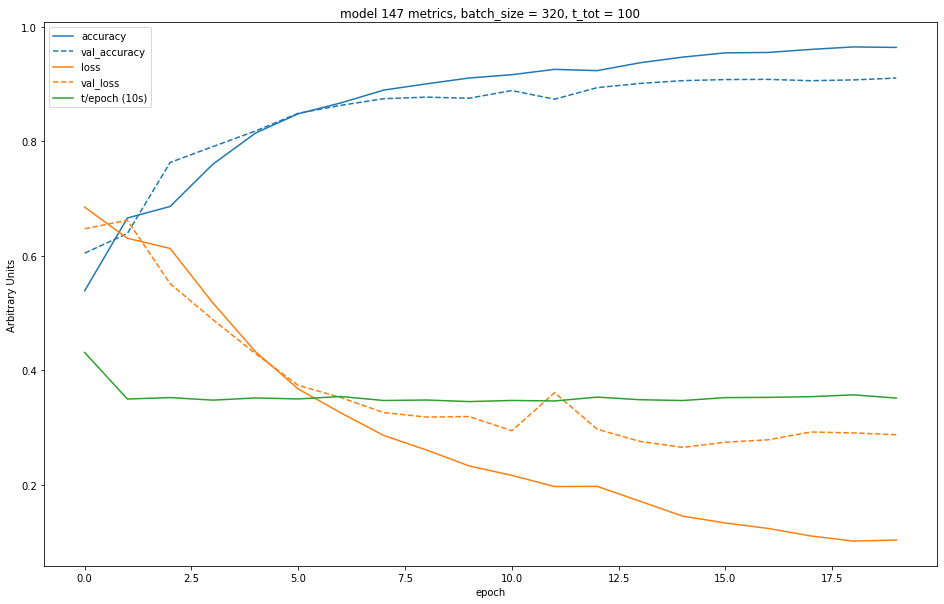

Creating model 148...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


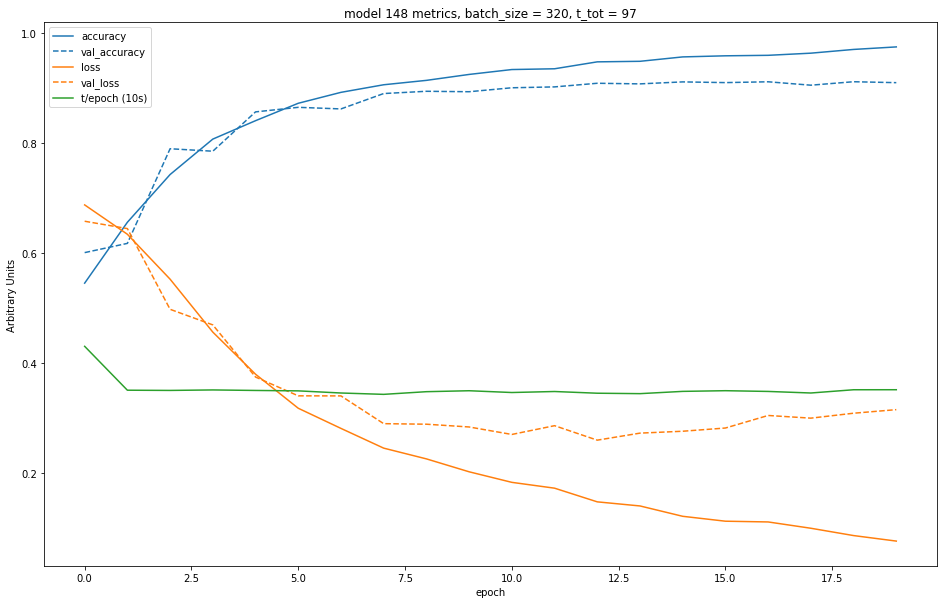

Creating model 149...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


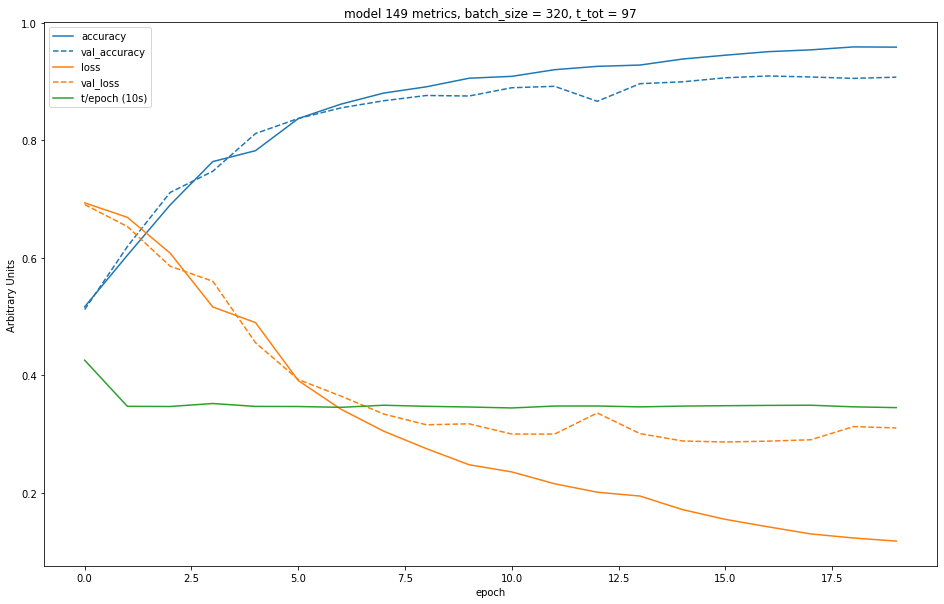

Creating model 150...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


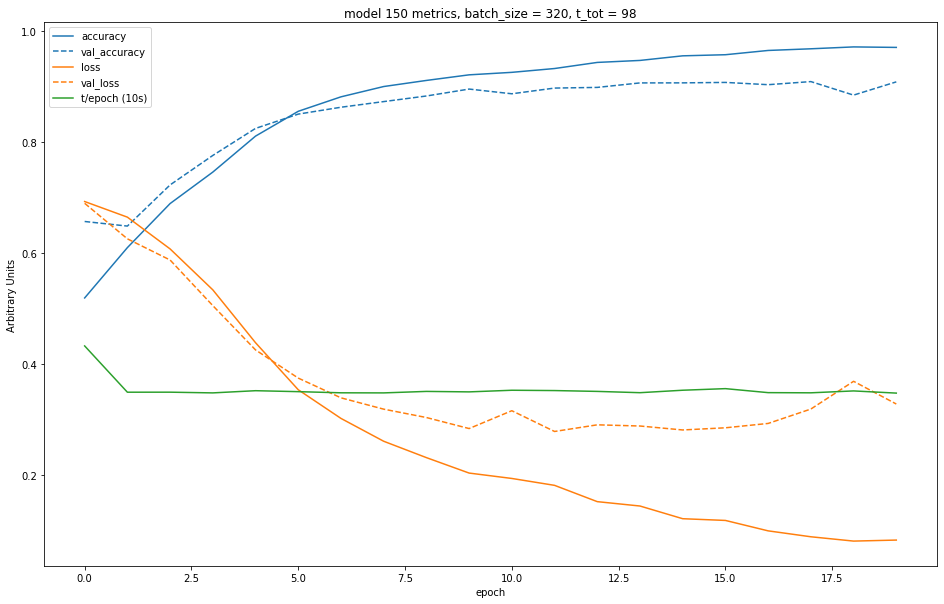

Creating model 151...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


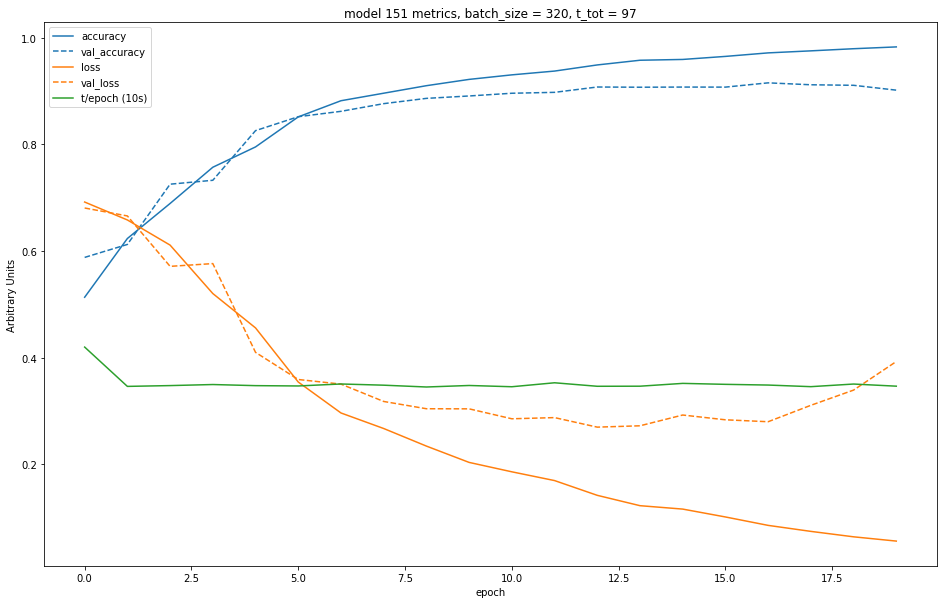

Creating model 152...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


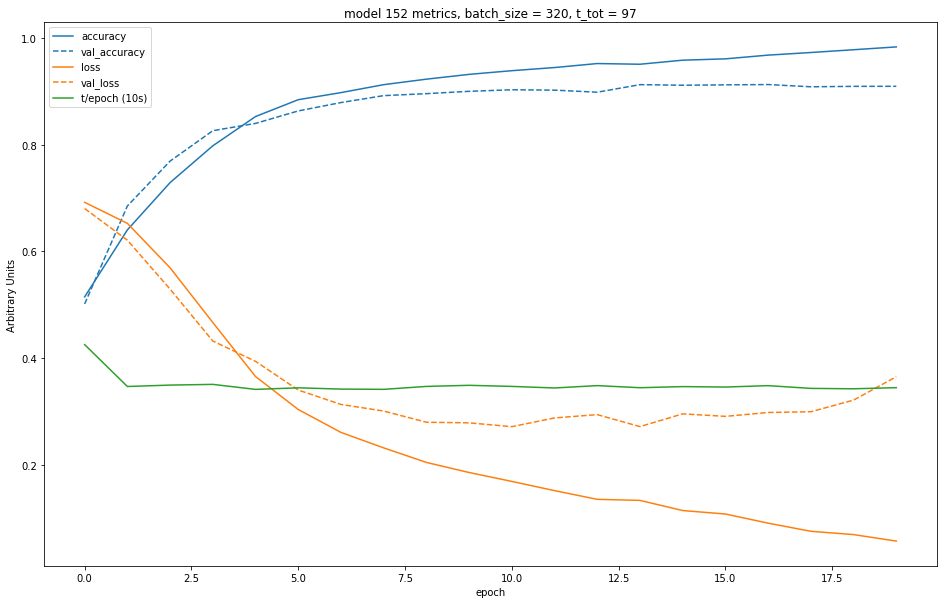

Creating model 153...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


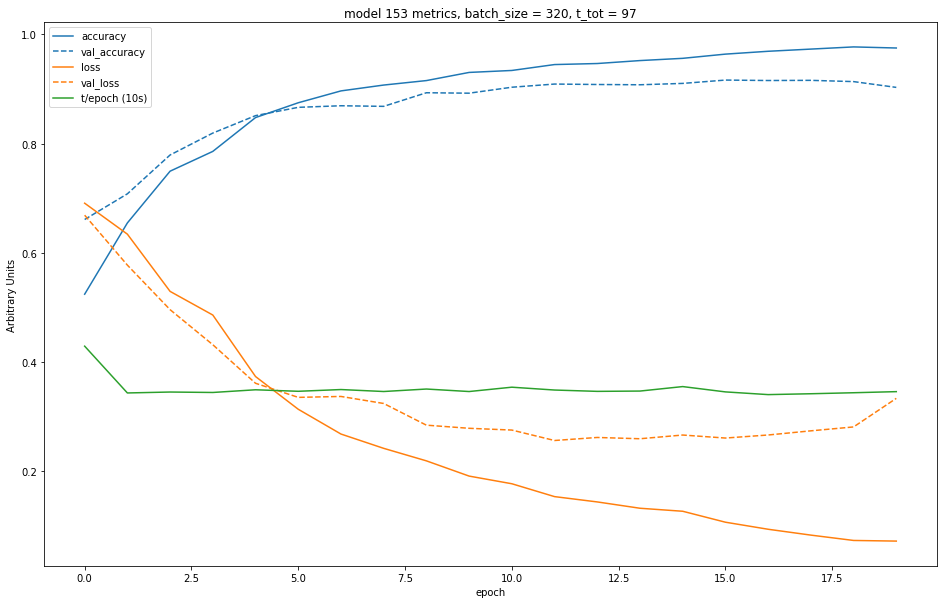

Creating model 154...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


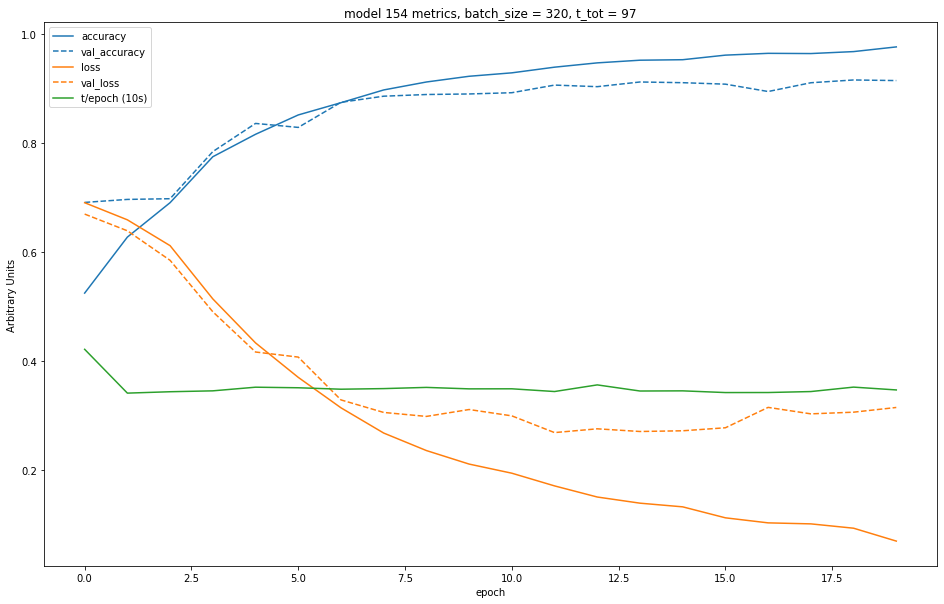

Creating model 155...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


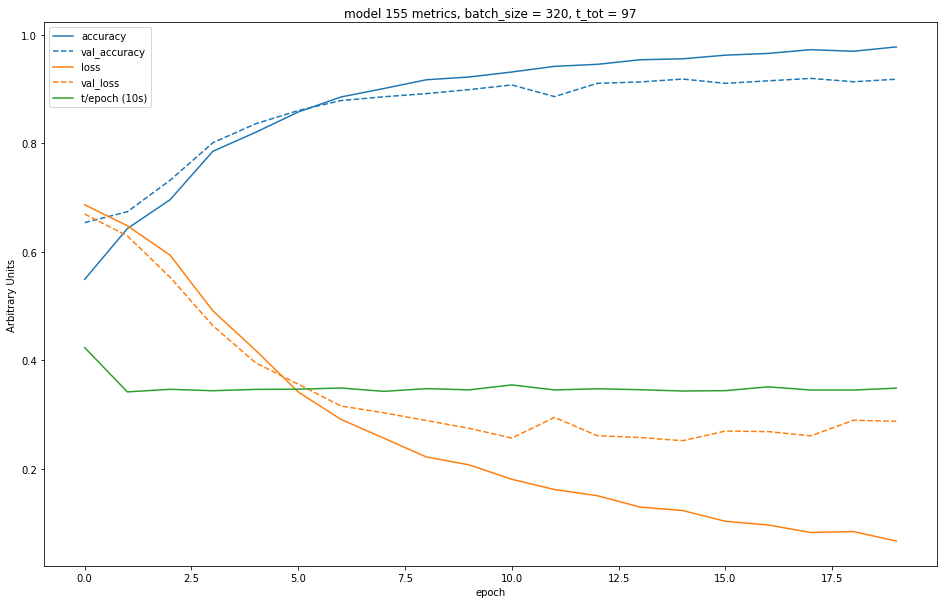

Creating model 156...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


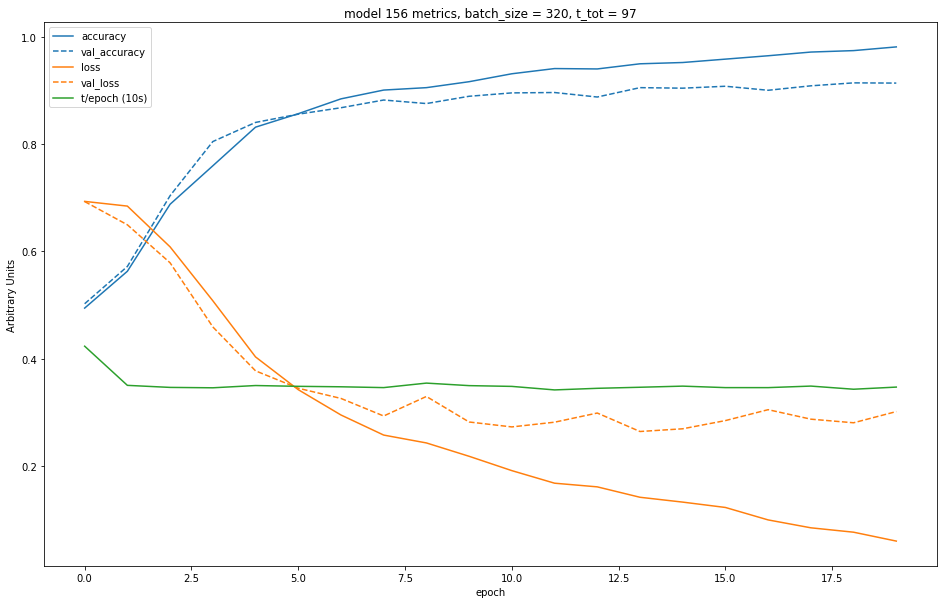

Creating model 157...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


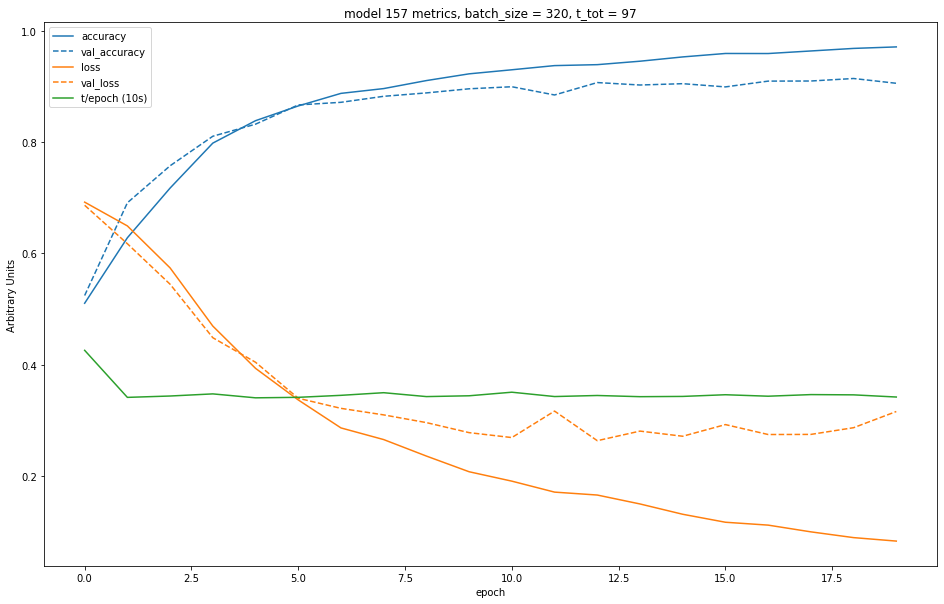

Creating model 158...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


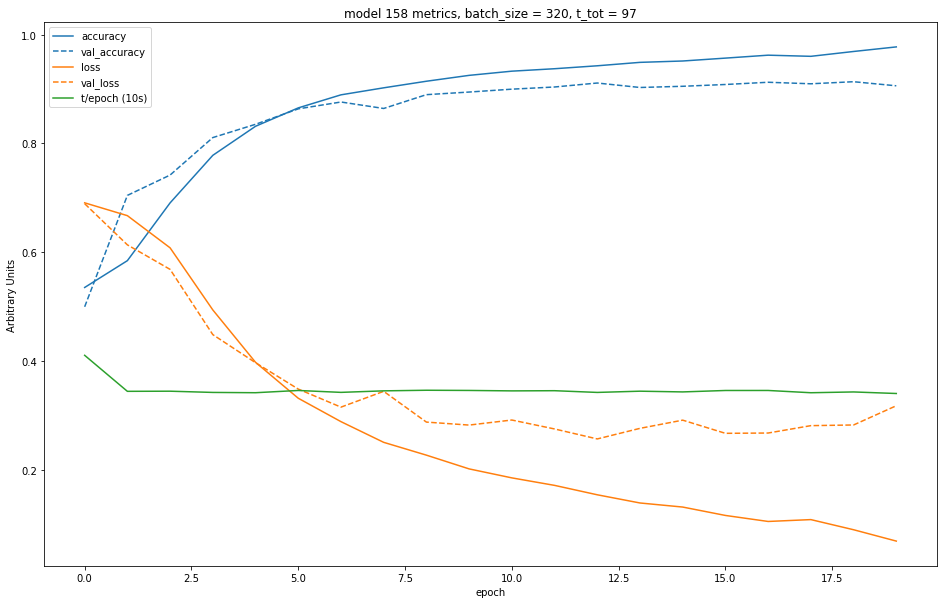

Creating model 159...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


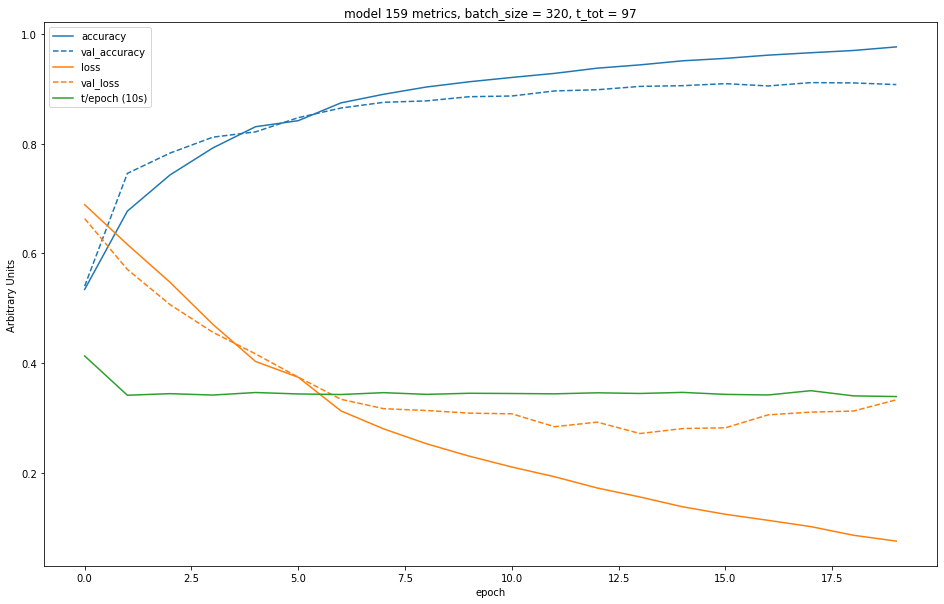

Creating model 160...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


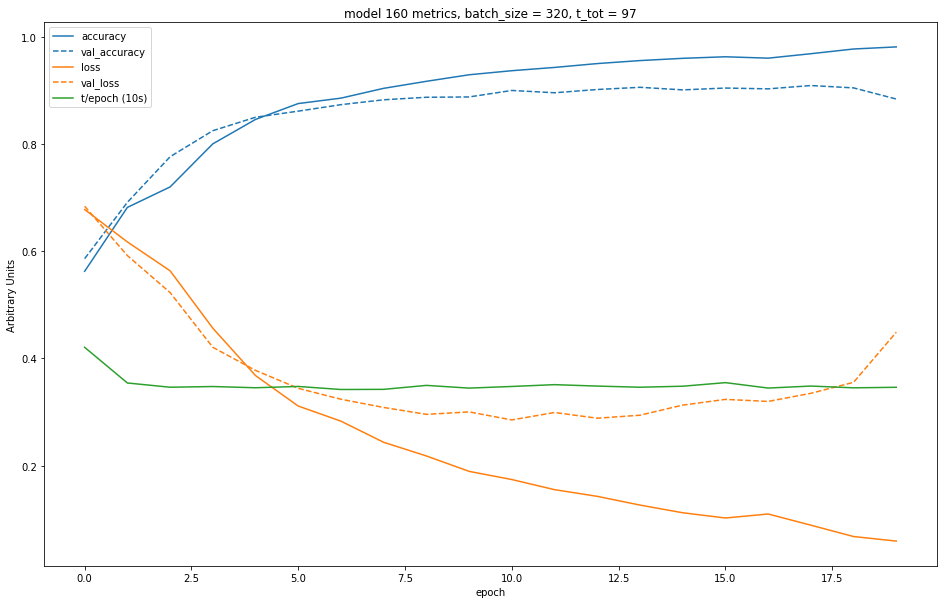

Creating model 161...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


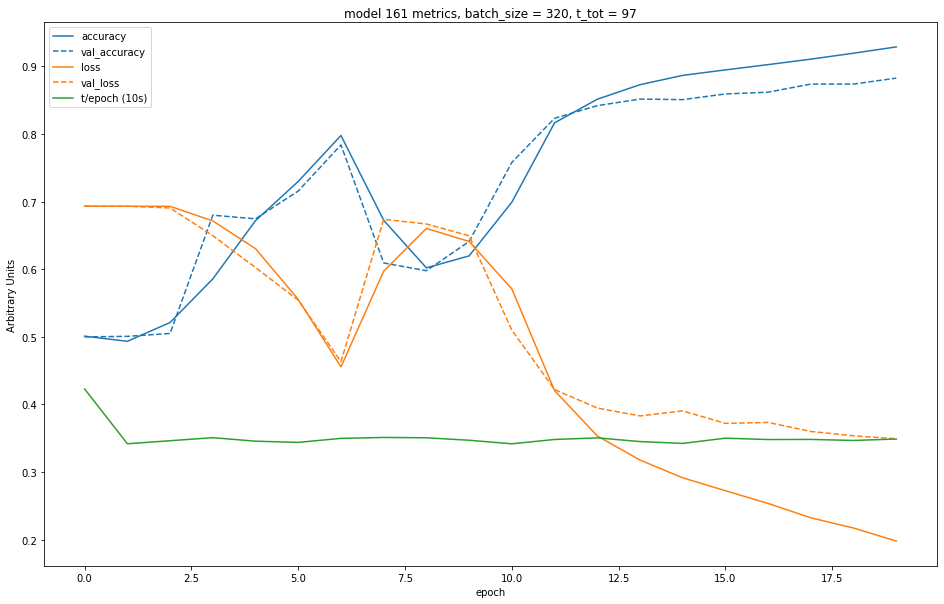

Creating model 162...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


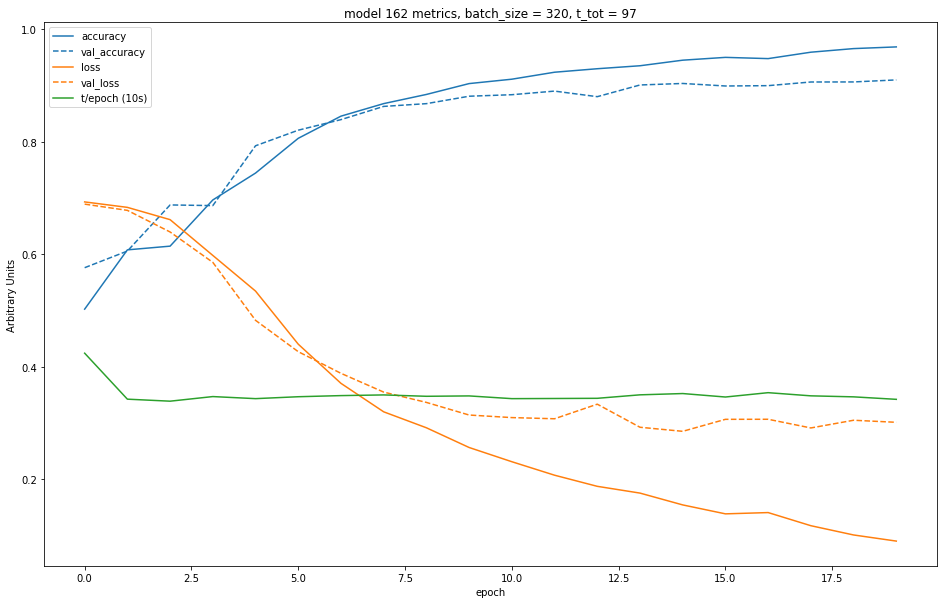

Creating model 163...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


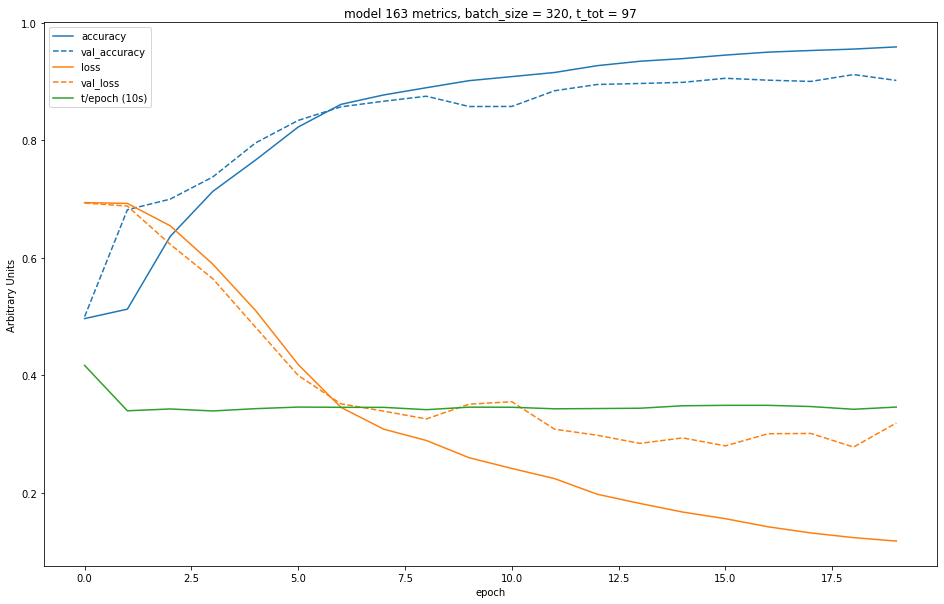

Creating model 164...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


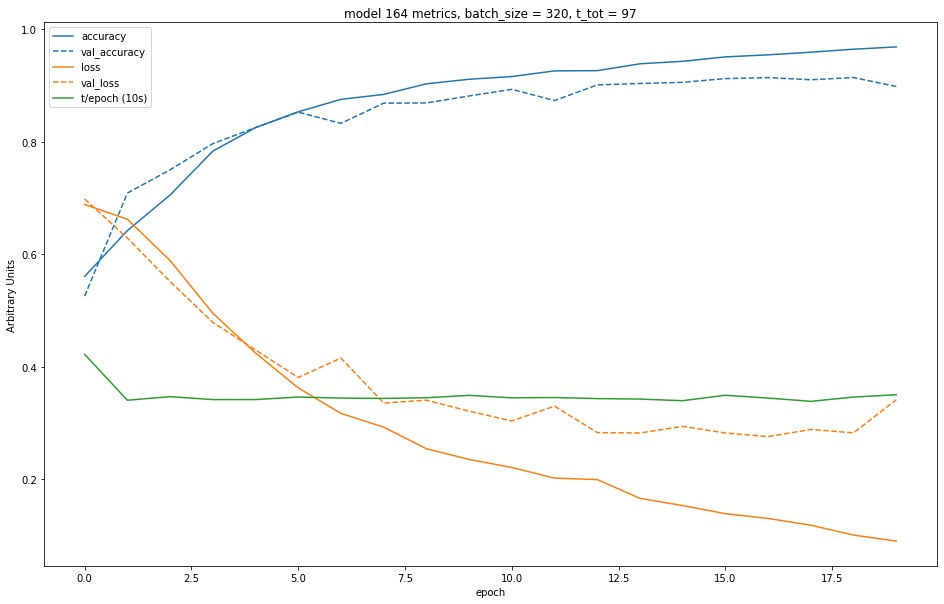

Creating model 165...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


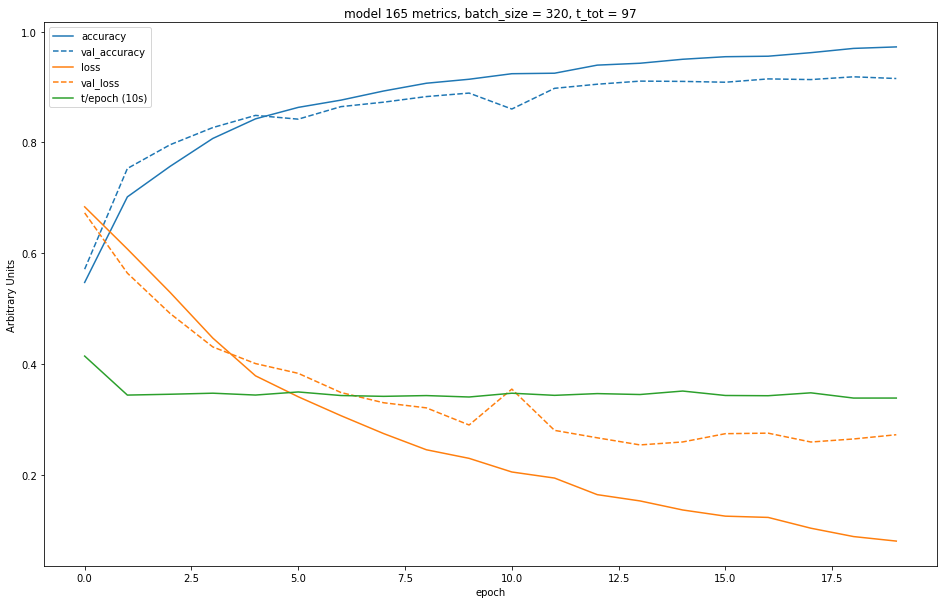

Creating model 166...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


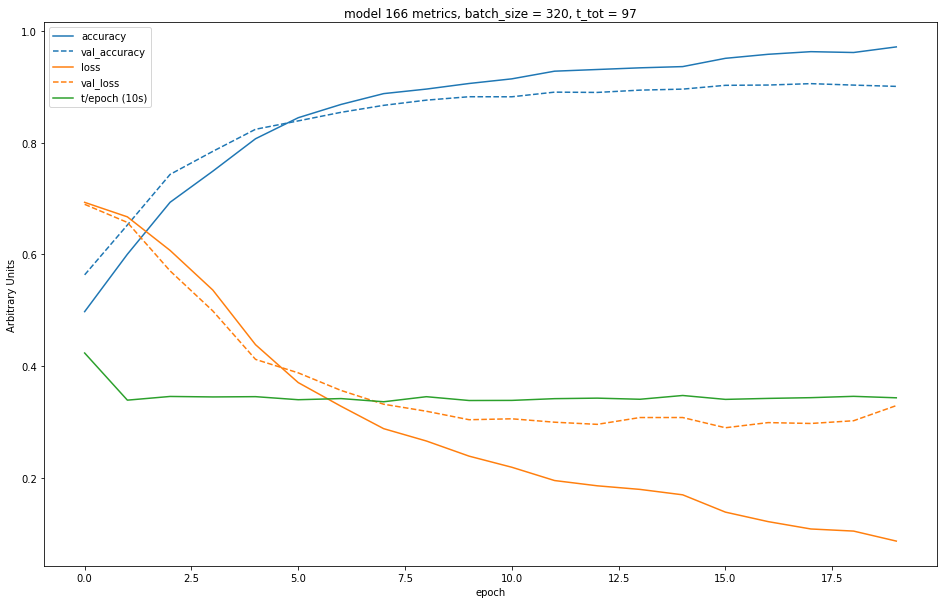

Creating model 167...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


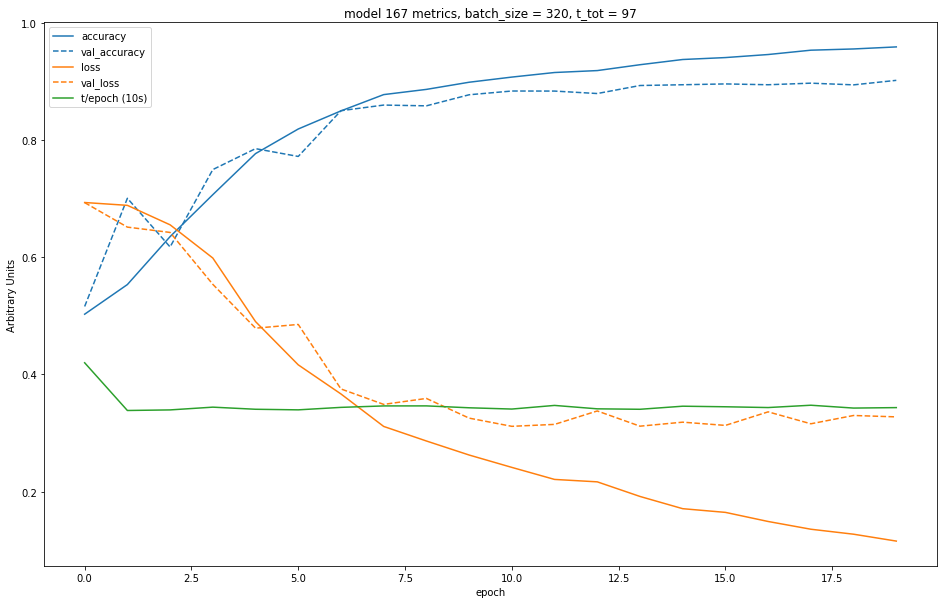

Creating model 168...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


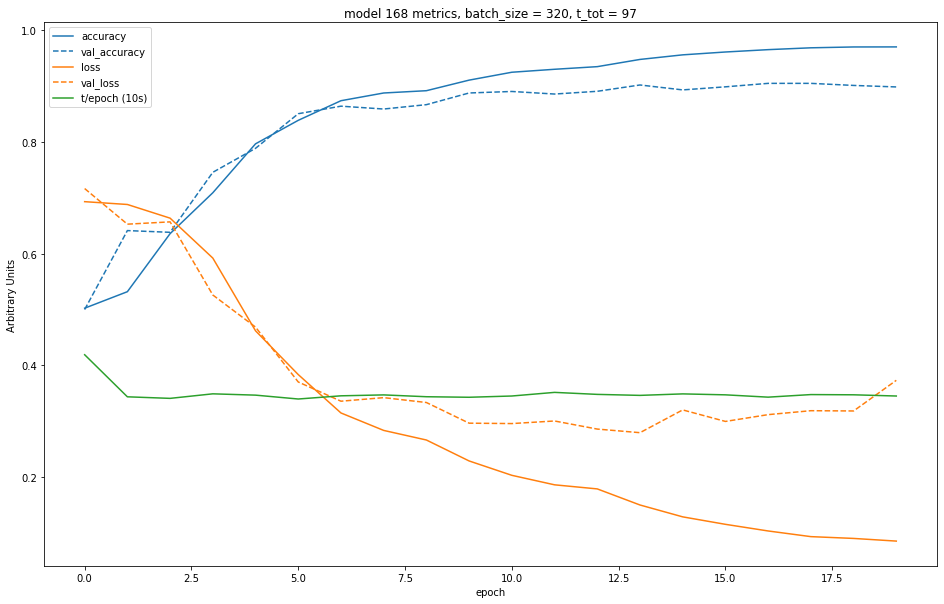

Creating model 169...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


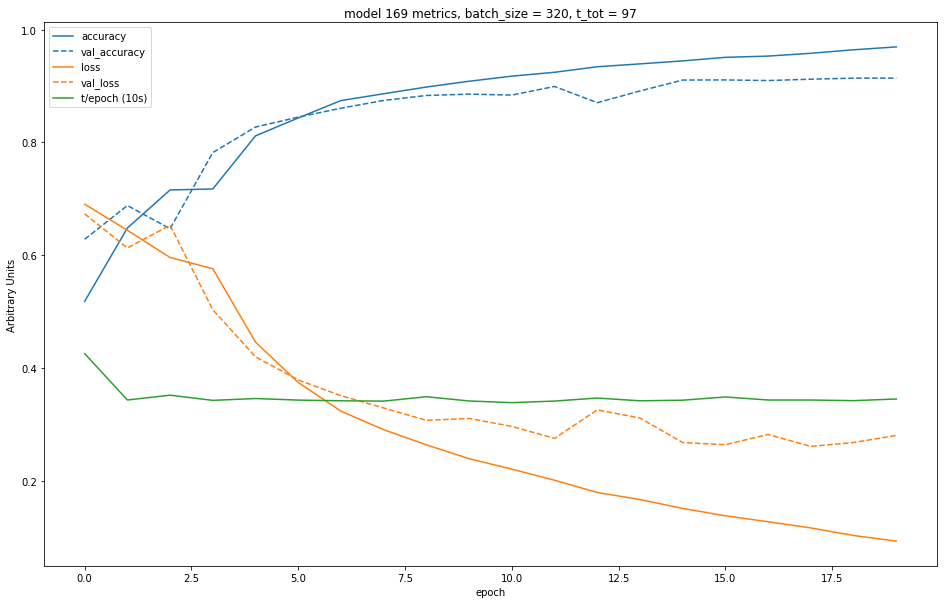

Creating model 170...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


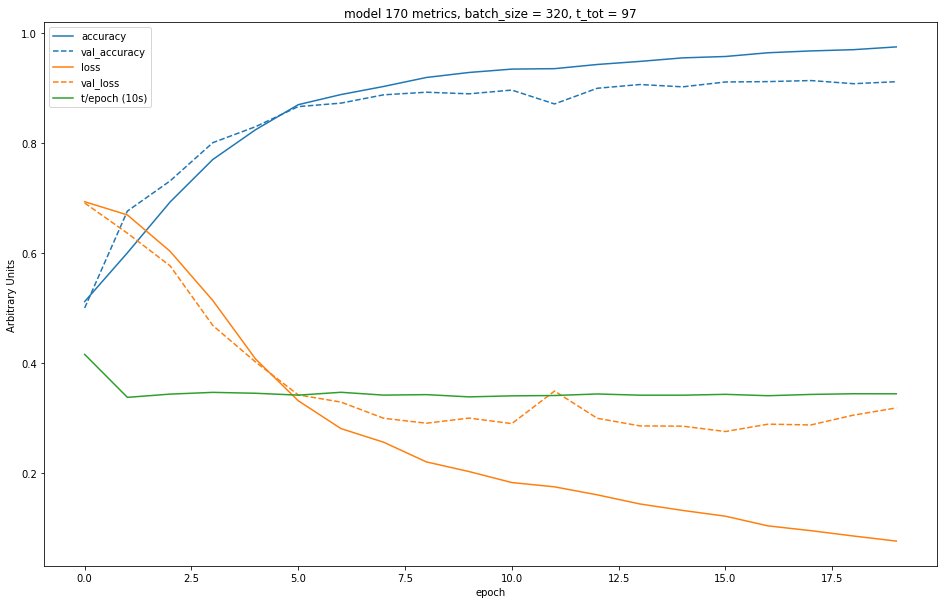

Creating model 171...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


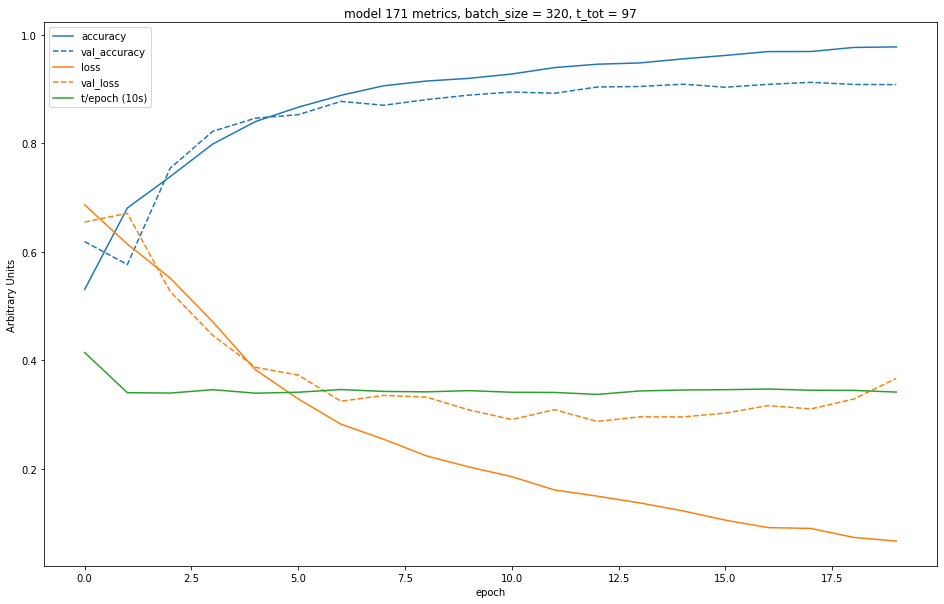

Creating model 172...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


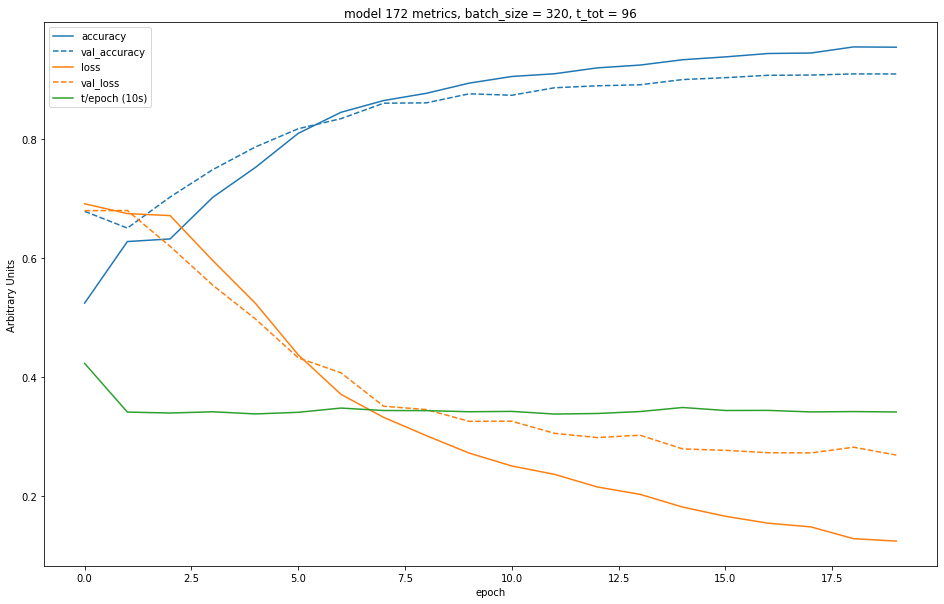

Creating model 173...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


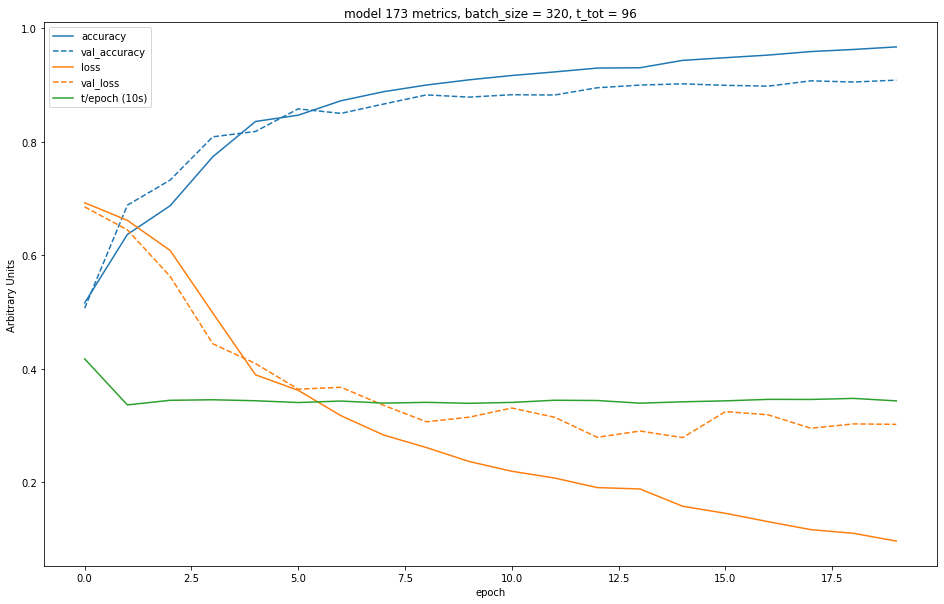

Creating model 174...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


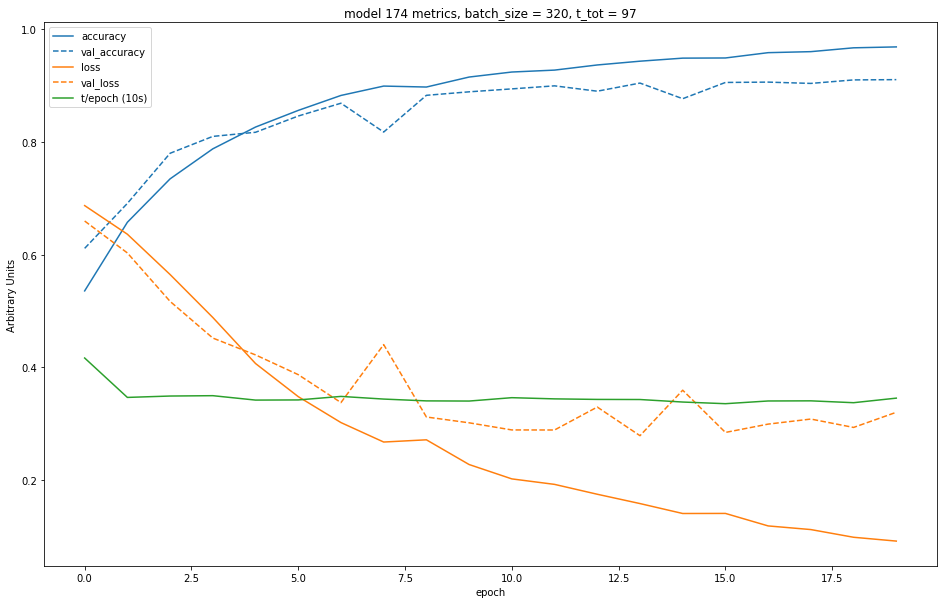

Creating model 175...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


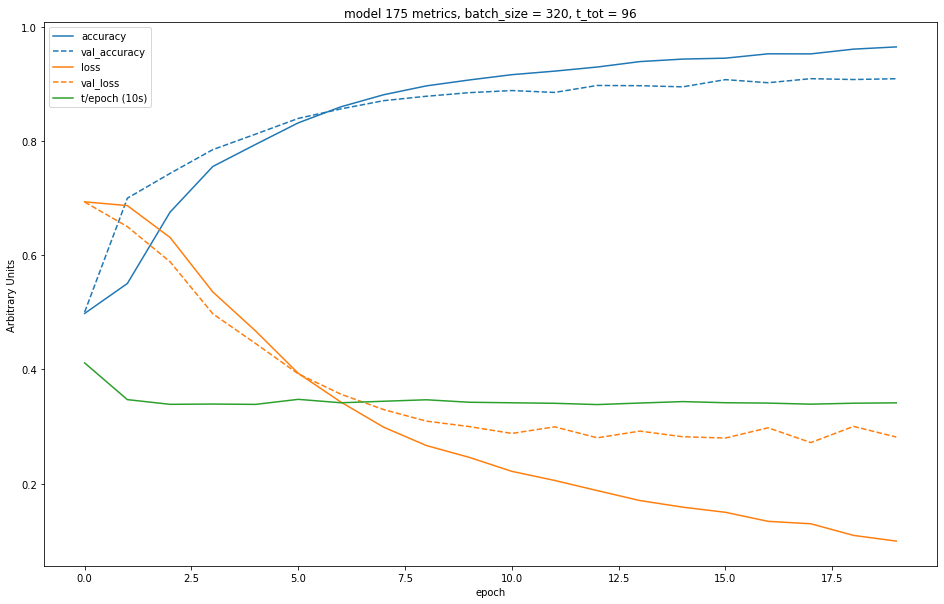

Creating model 176...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


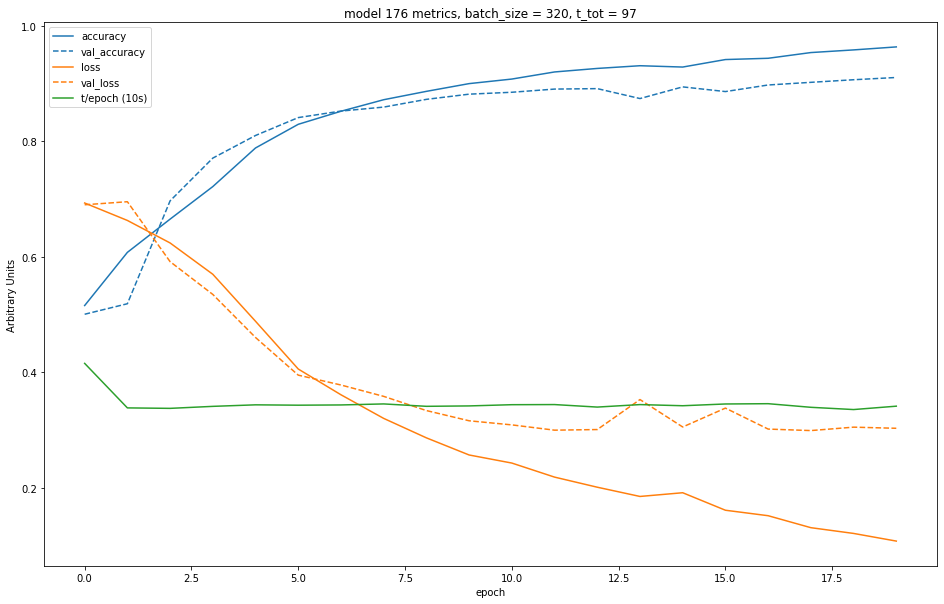

Creating model 177...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


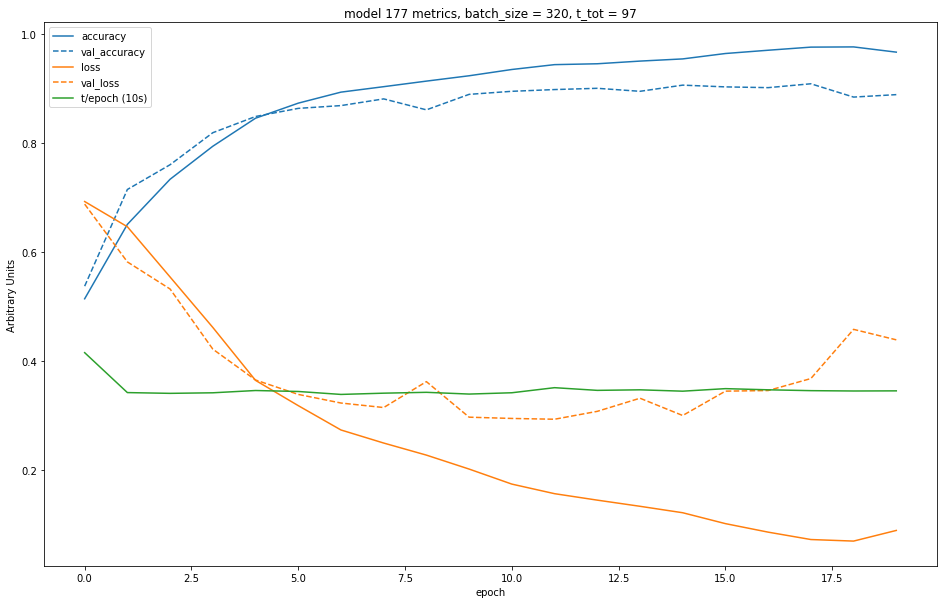

Creating model 178...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


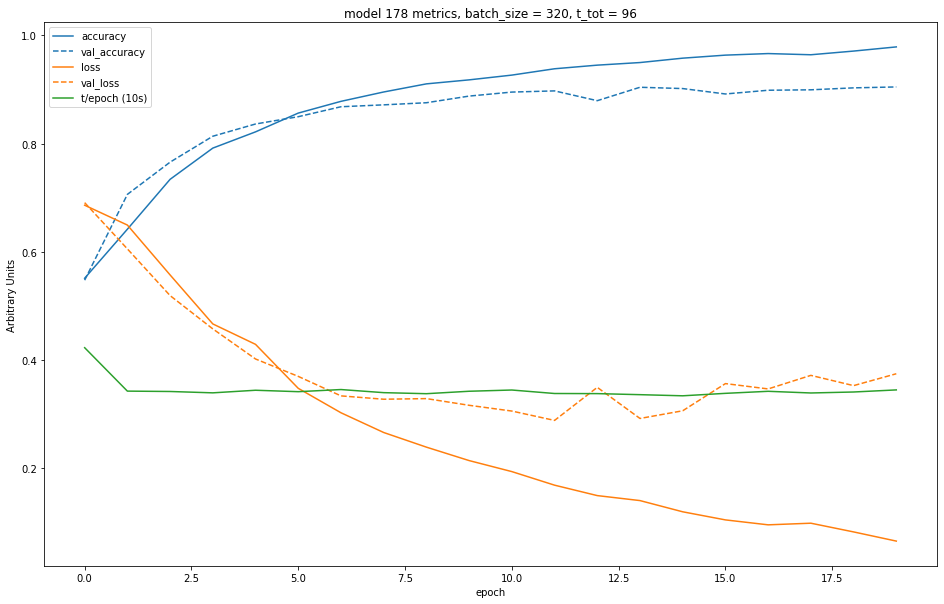

Creating model 179...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


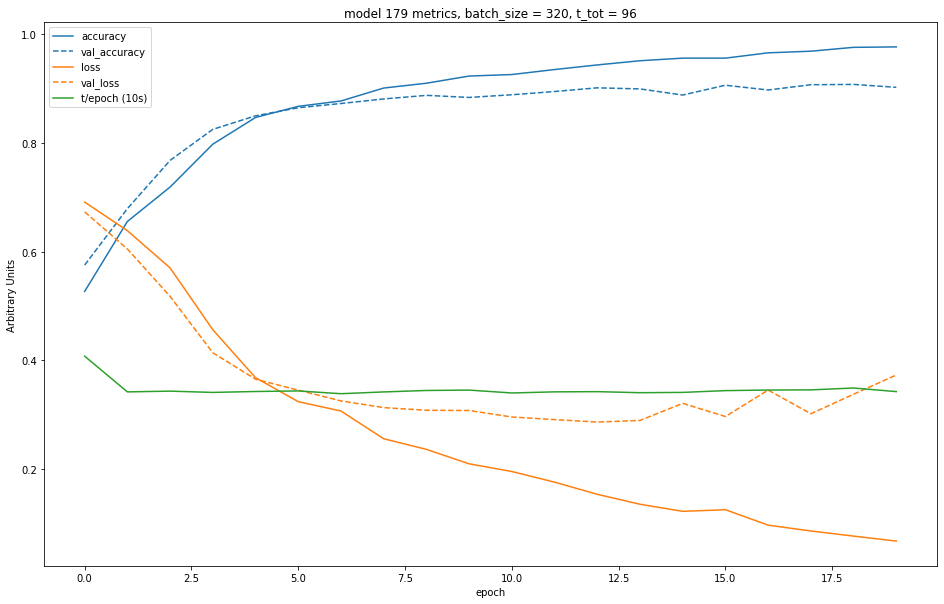

Creating model 180...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


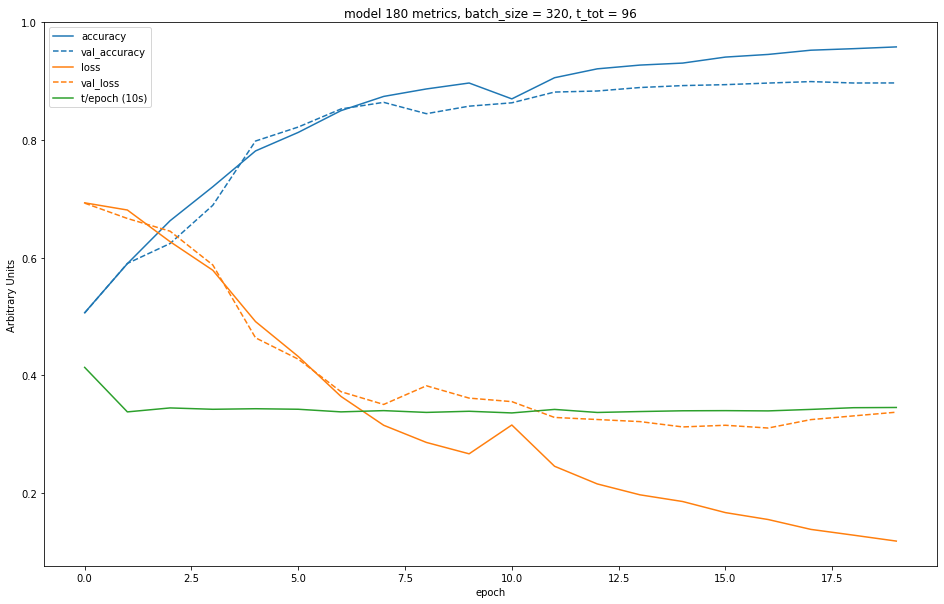

Creating model 181...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


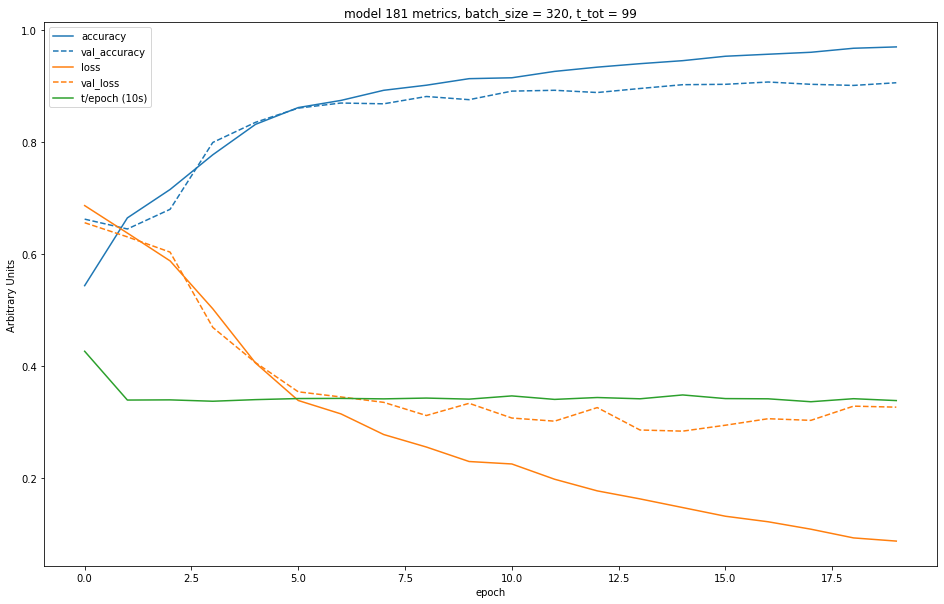

Creating model 182...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


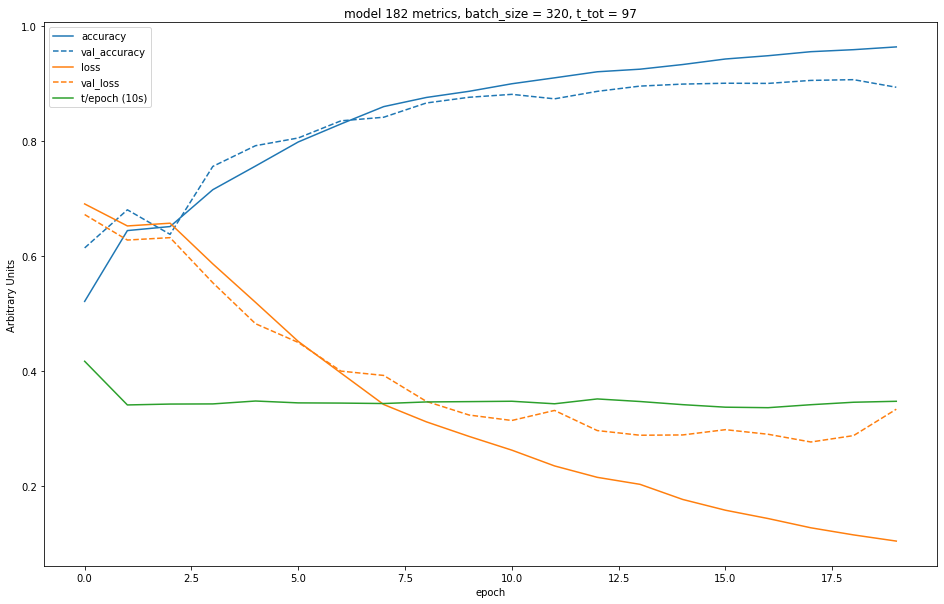

Creating model 183...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


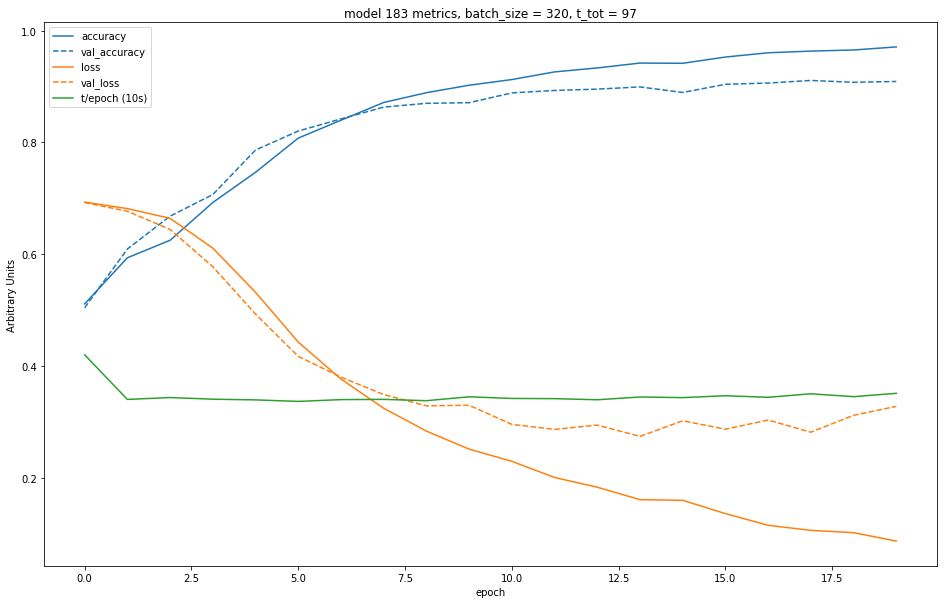

Creating model 184...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


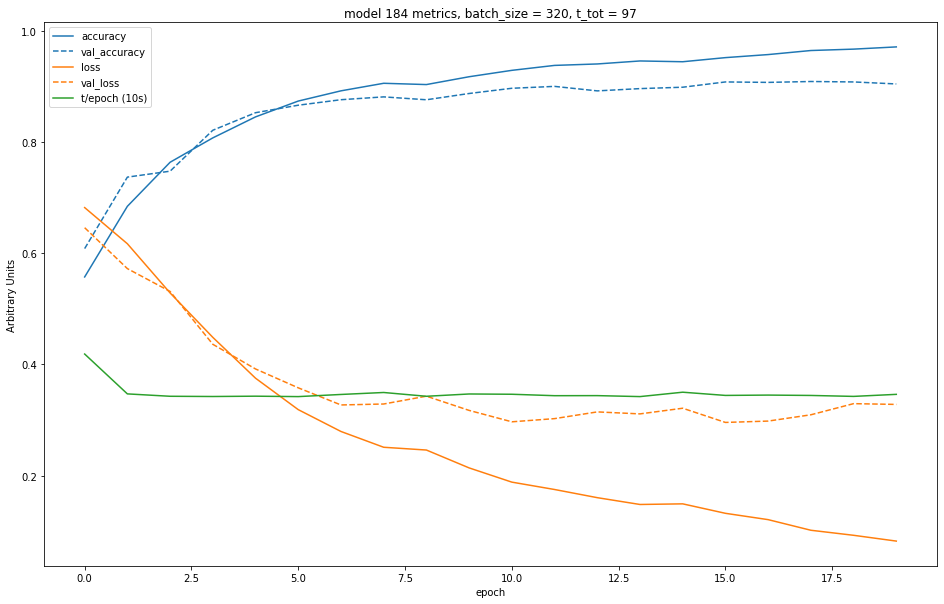

Creating model 185...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


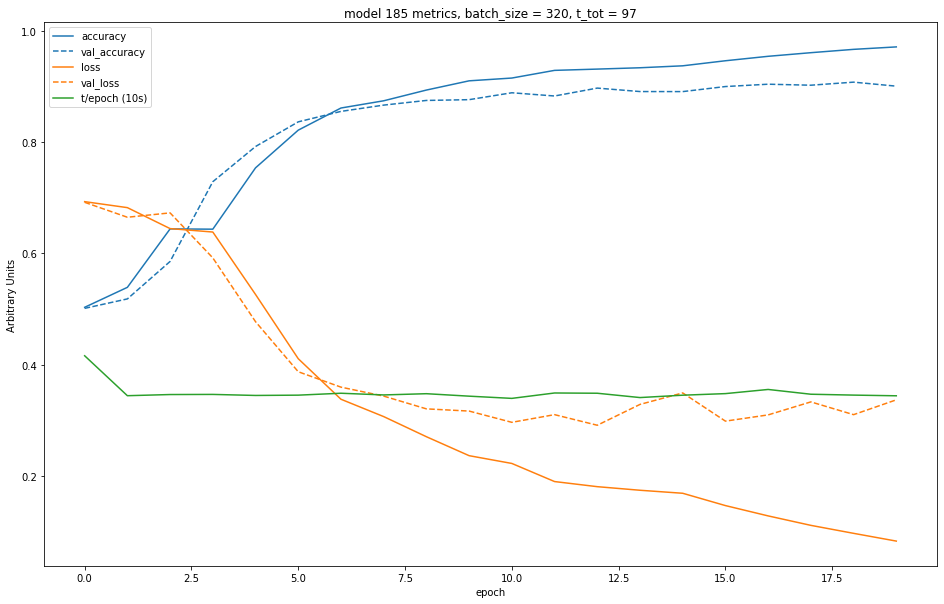

Creating model 186...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


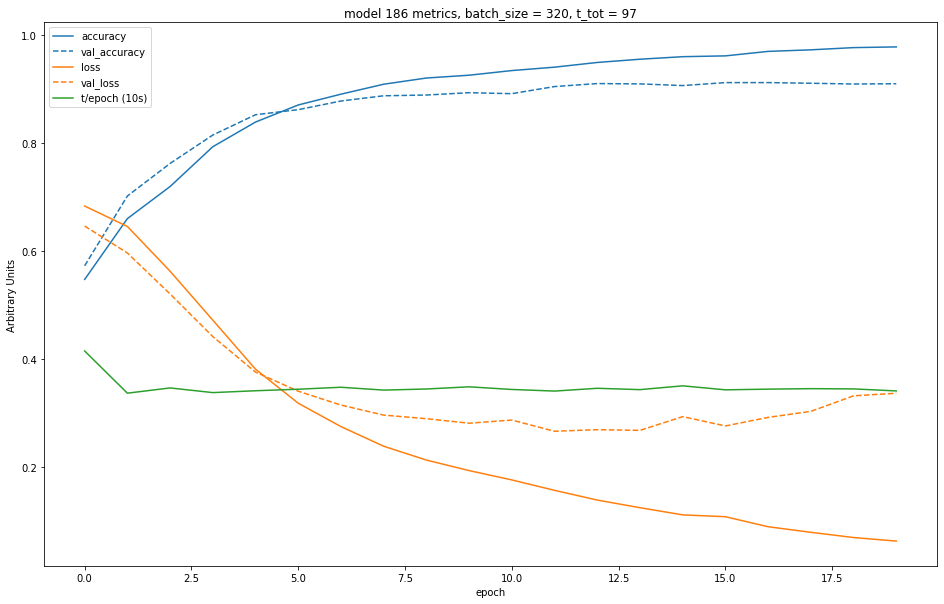

Creating model 187...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


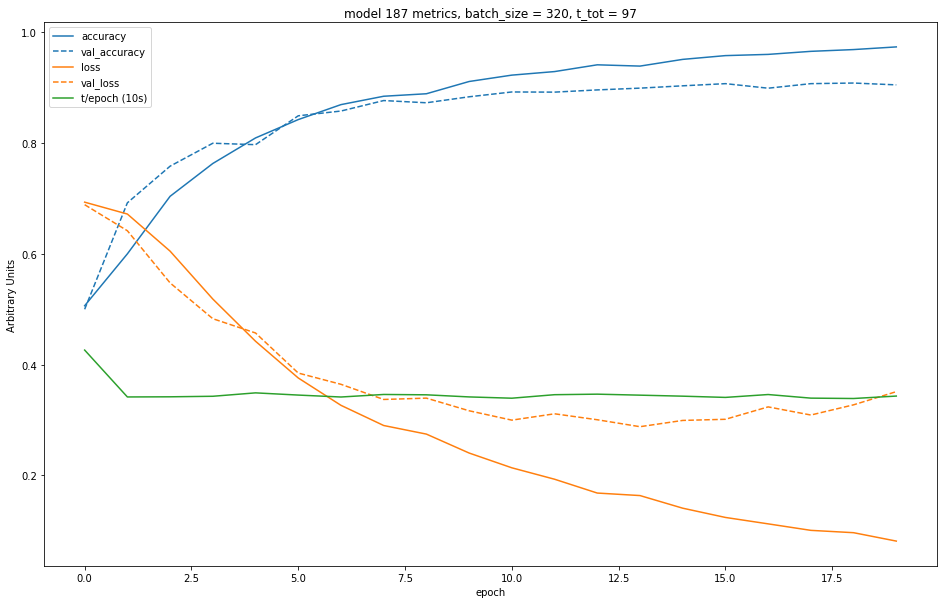

Creating model 188...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


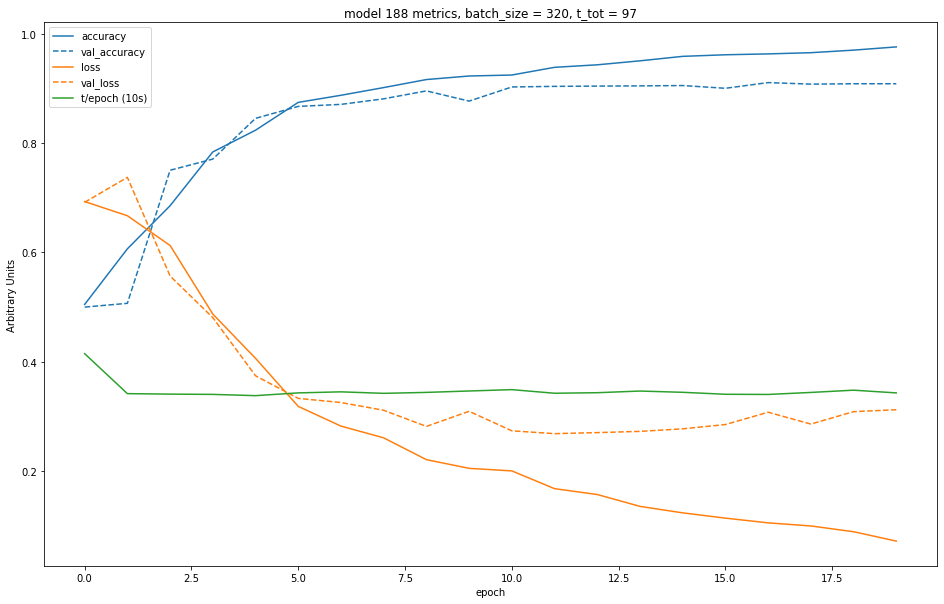

Creating model 189...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


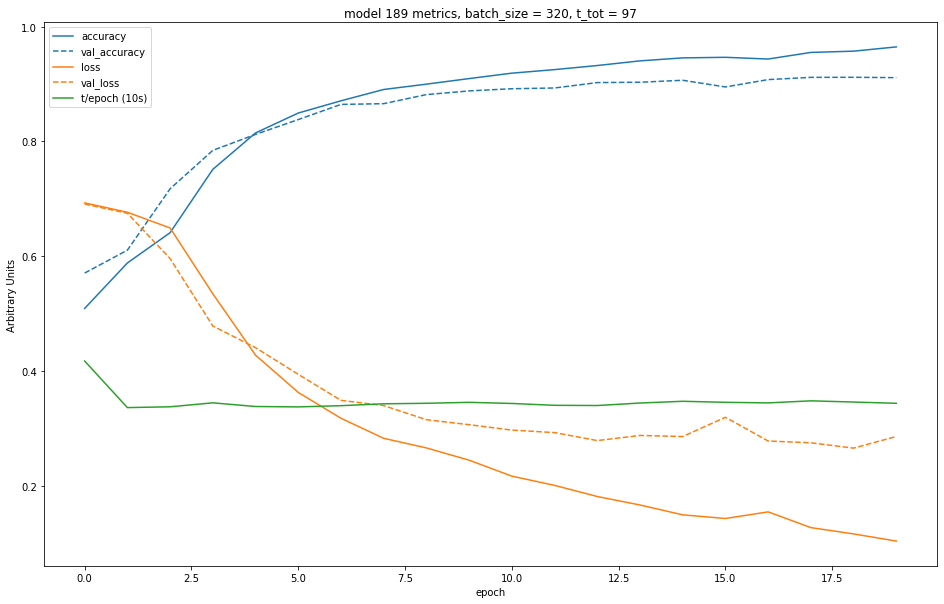

Creating model 190...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


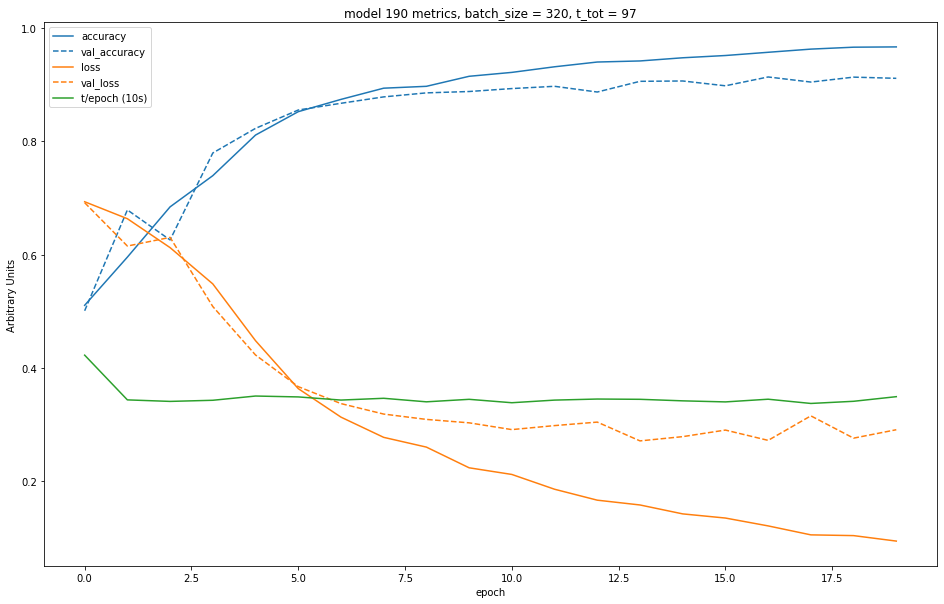

Creating model 191...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


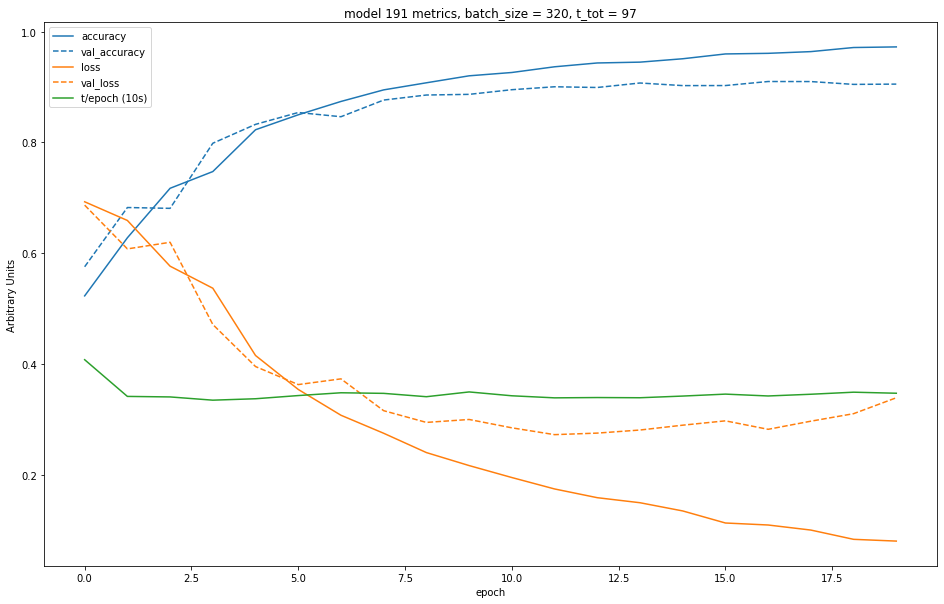

Creating model 192...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


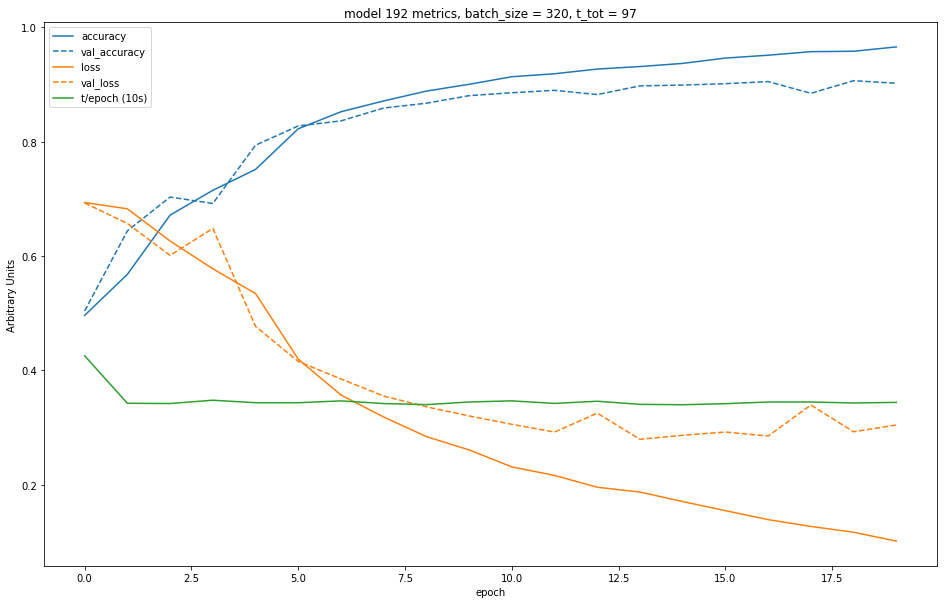

Creating model 193...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


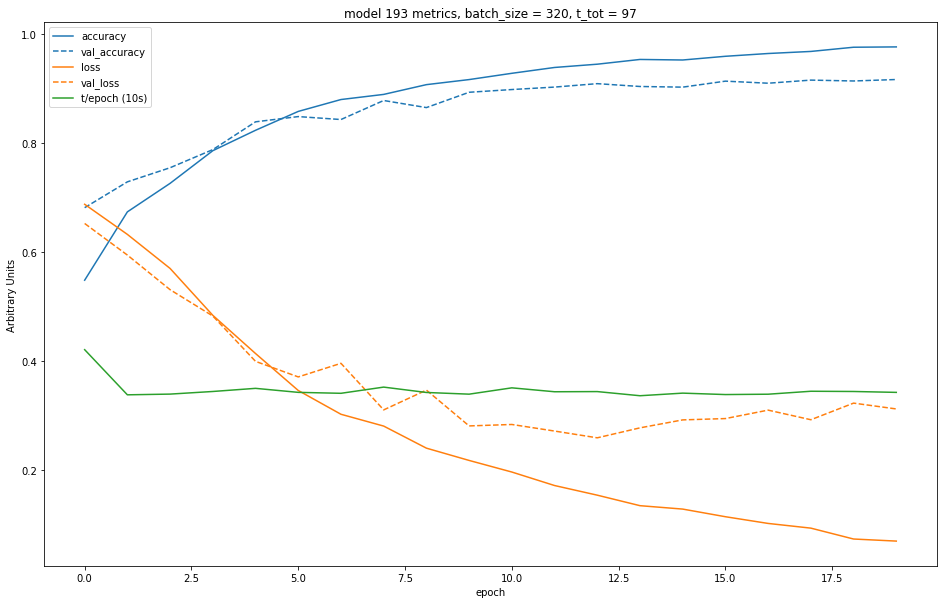

Creating model 194...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


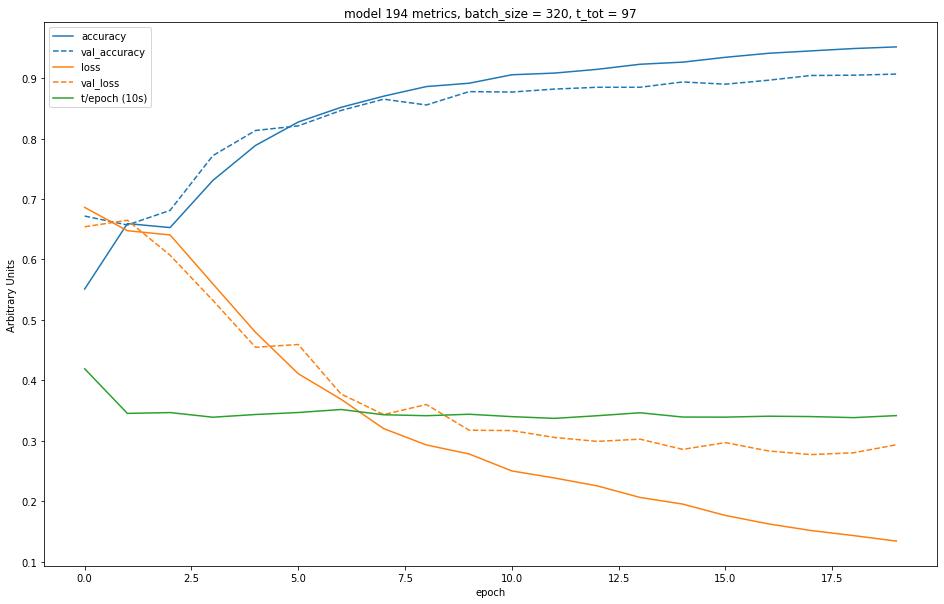

Creating model 195...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


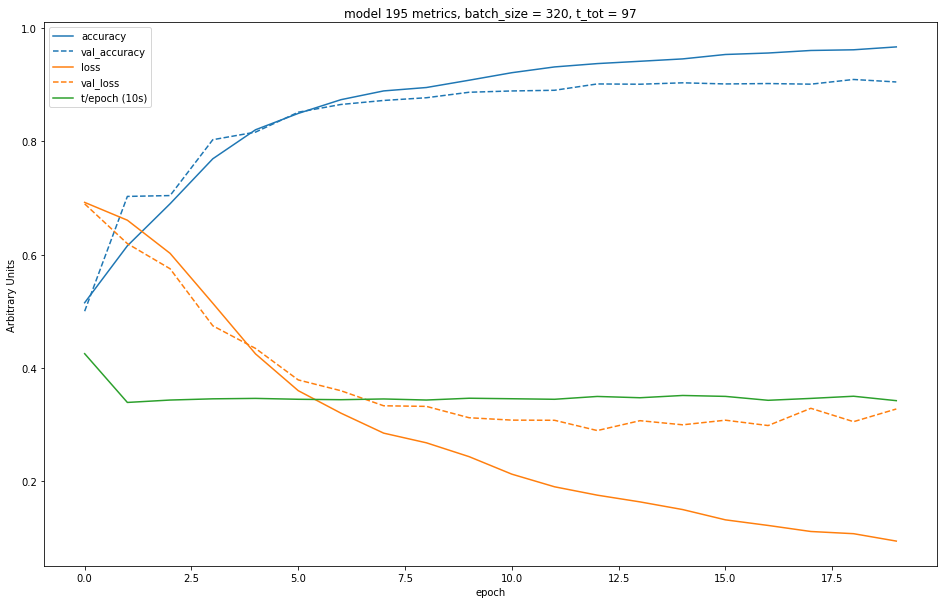

Creating model 196...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


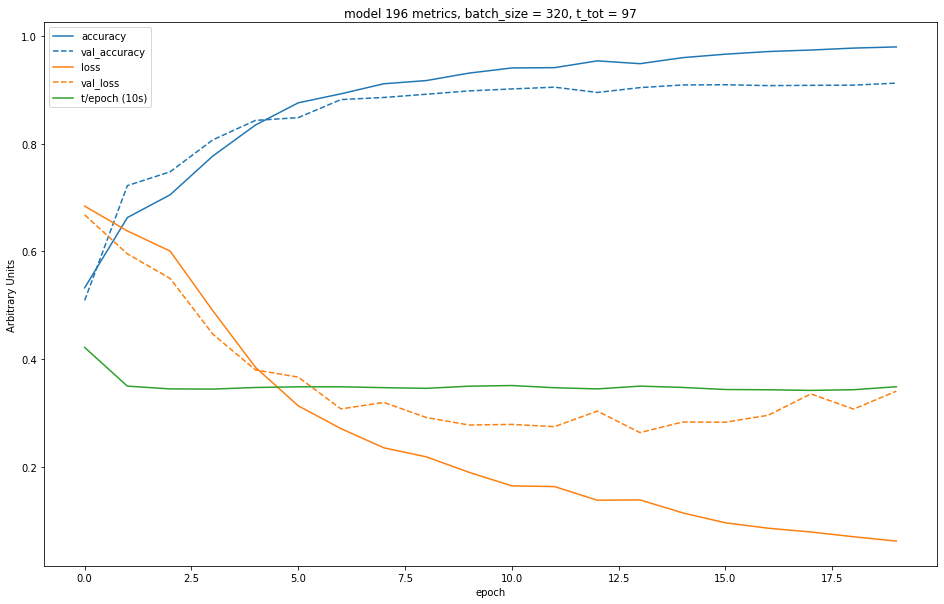

Creating model 197...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


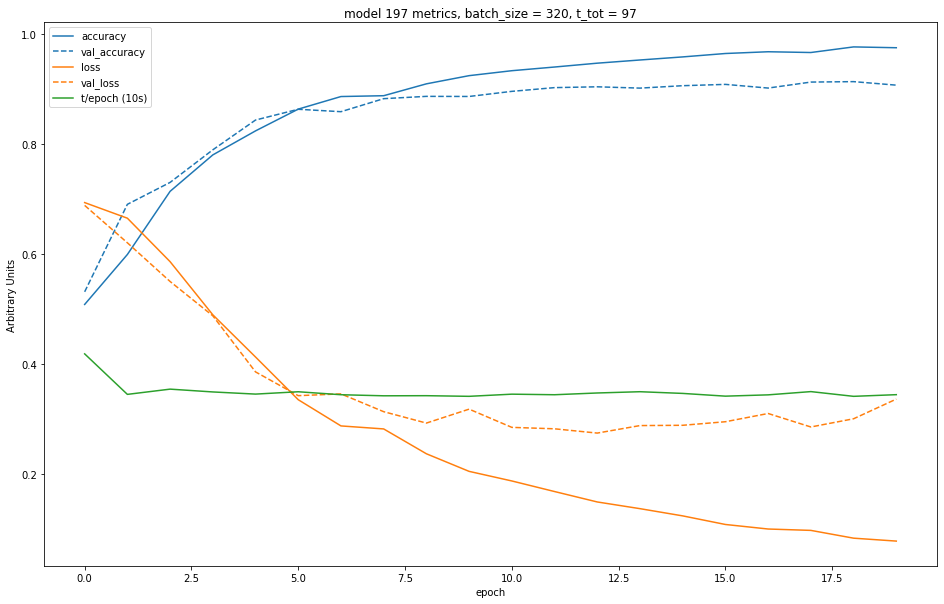

Creating model 198...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


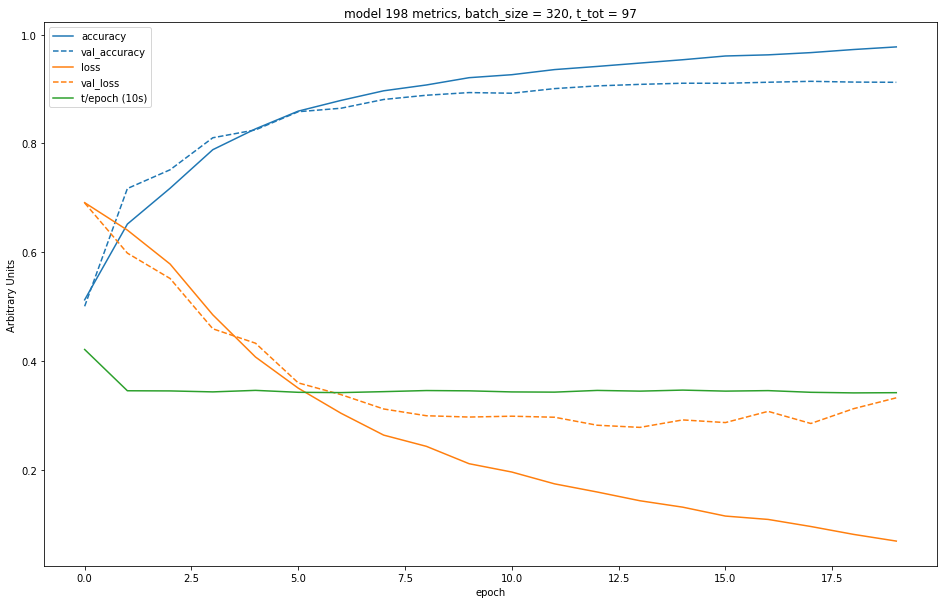

Creating model 199...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


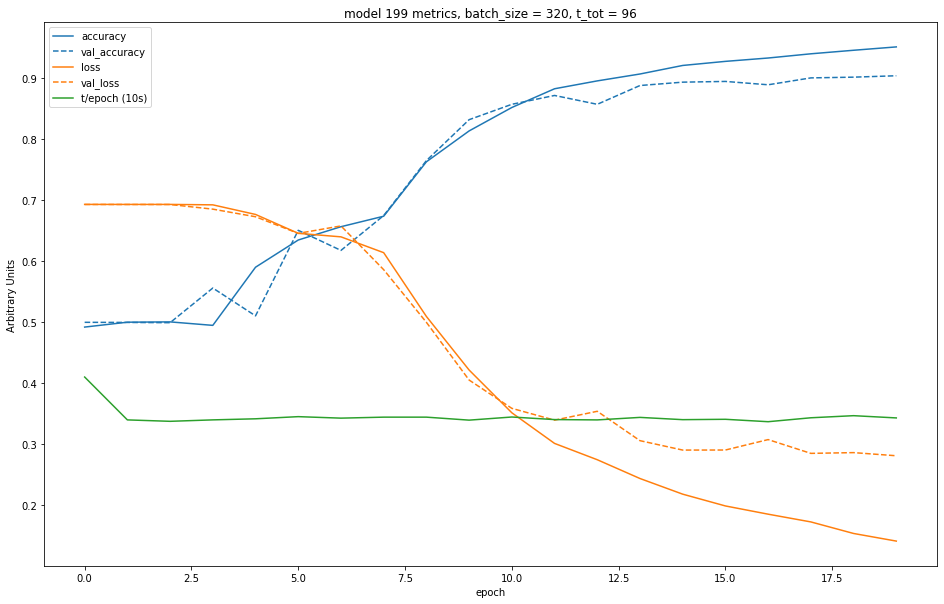

Creating model 200...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


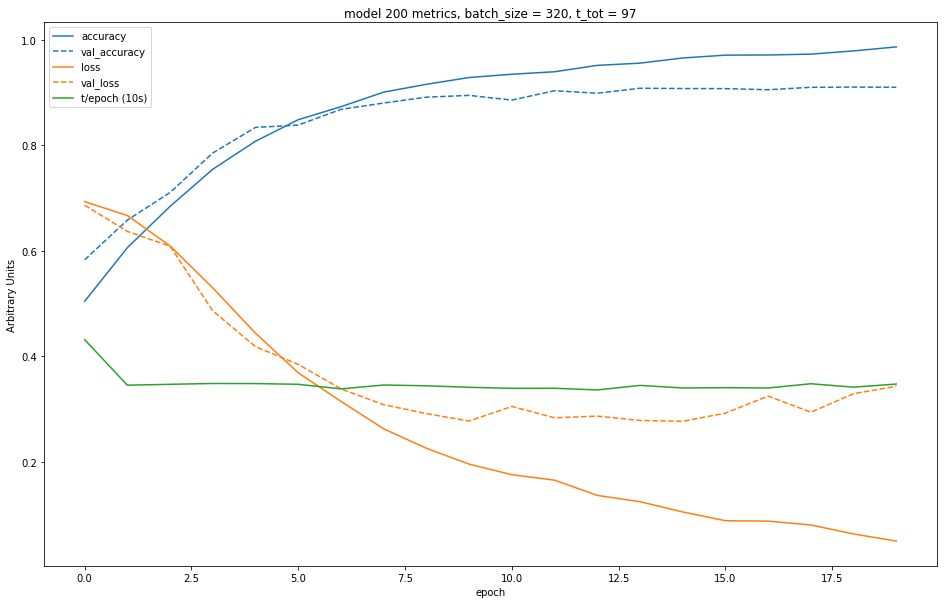

Creating model 201...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


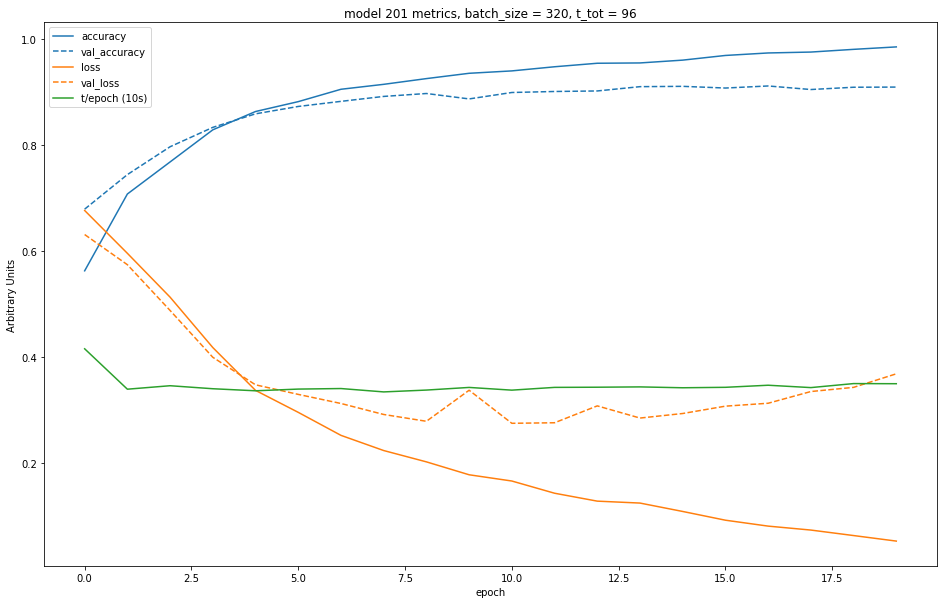

Creating model 202...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


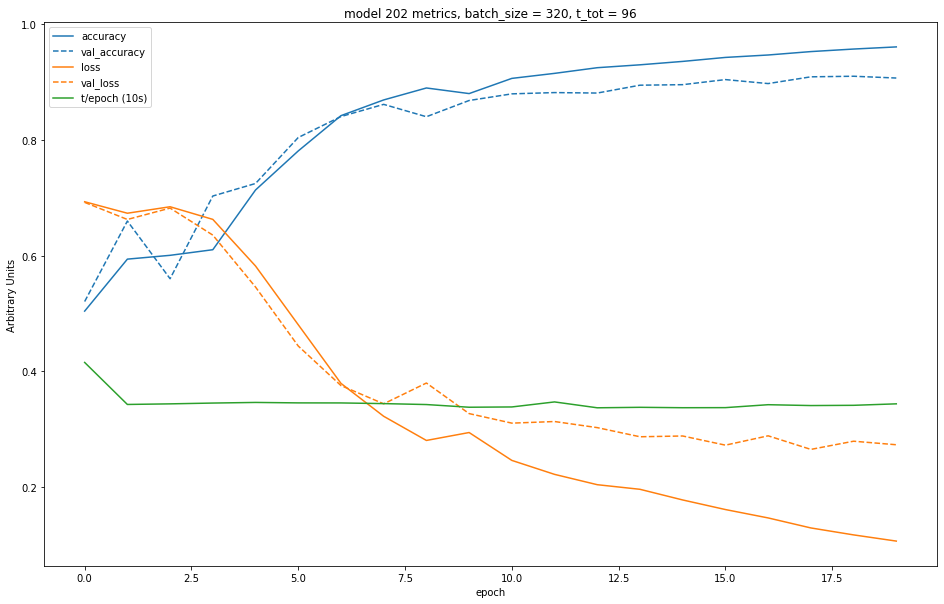

Creating model 203...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


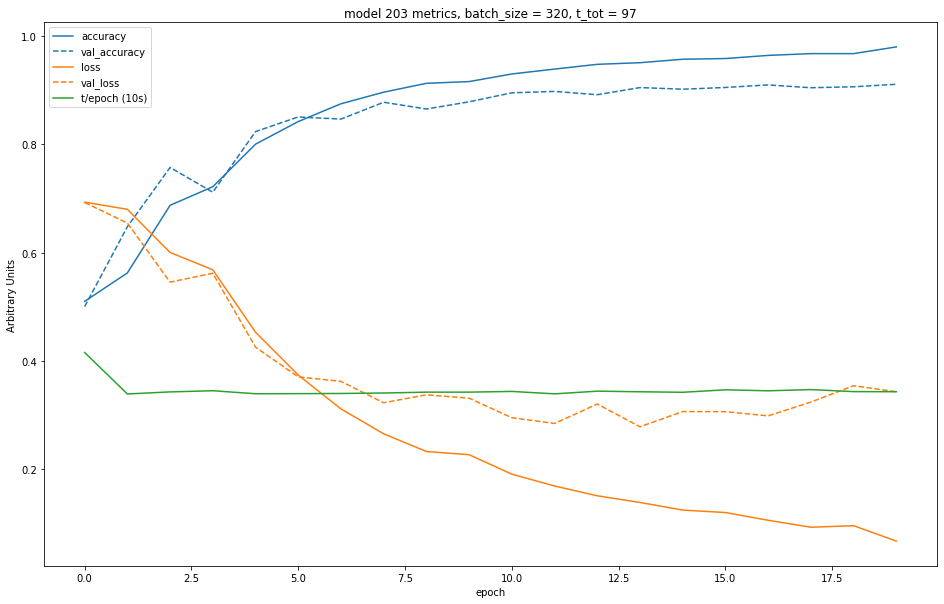

Creating model 204...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


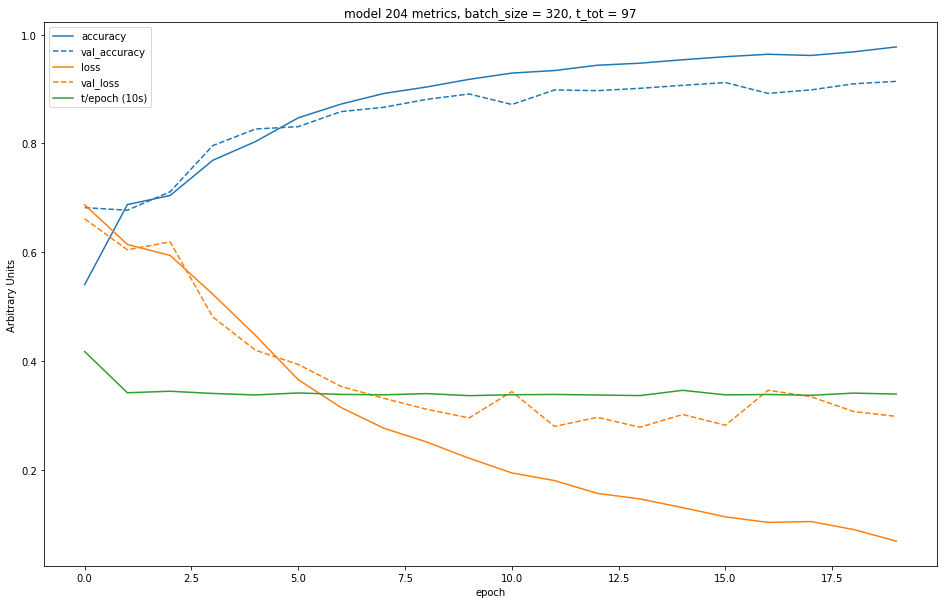

Creating model 205...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


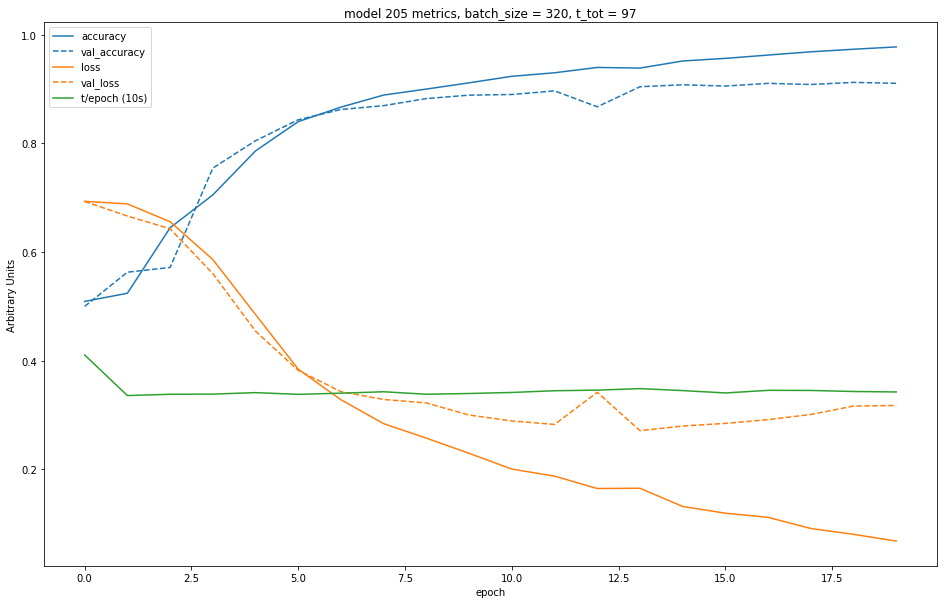

Creating model 206...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


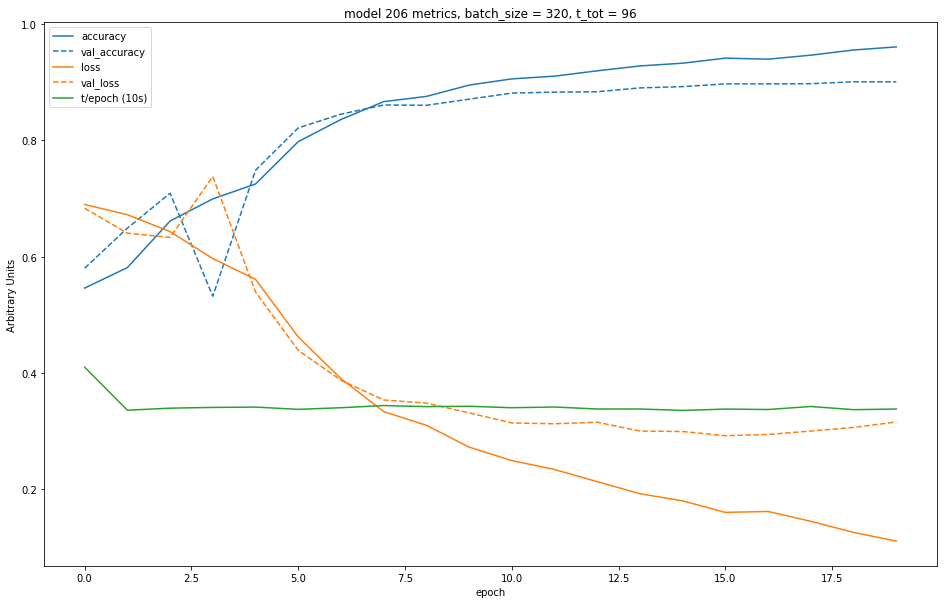

Creating model 207...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


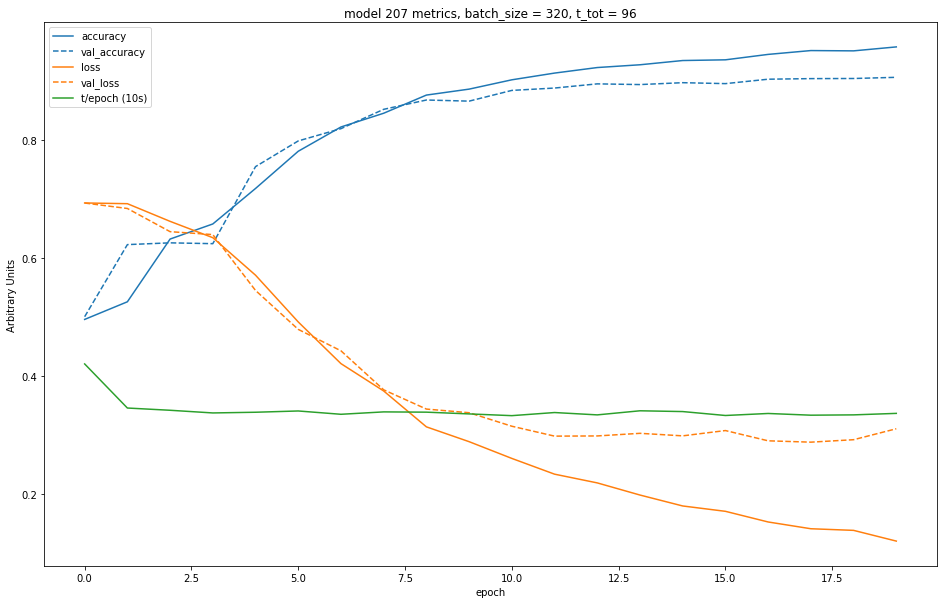

Creating model 208...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


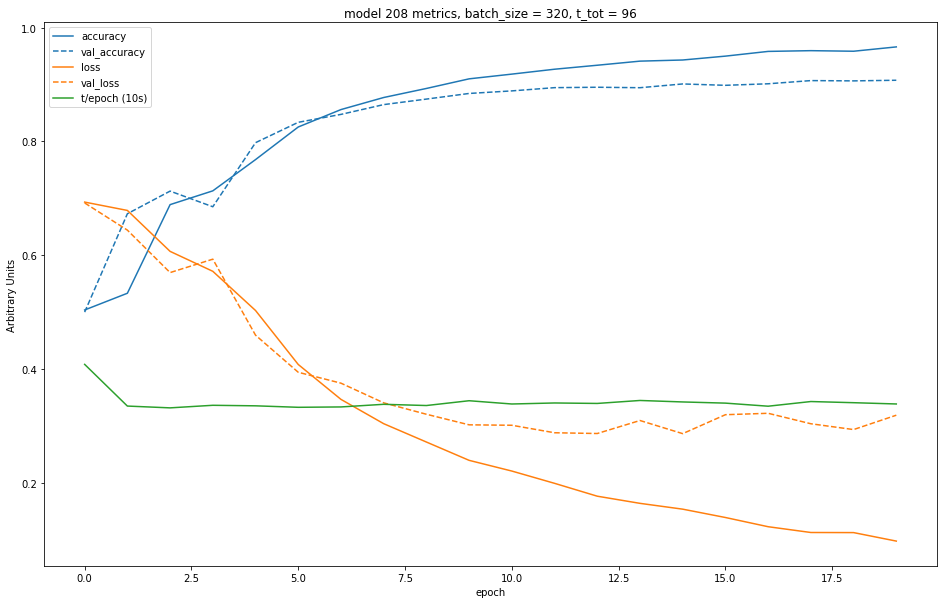

Creating model 209...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


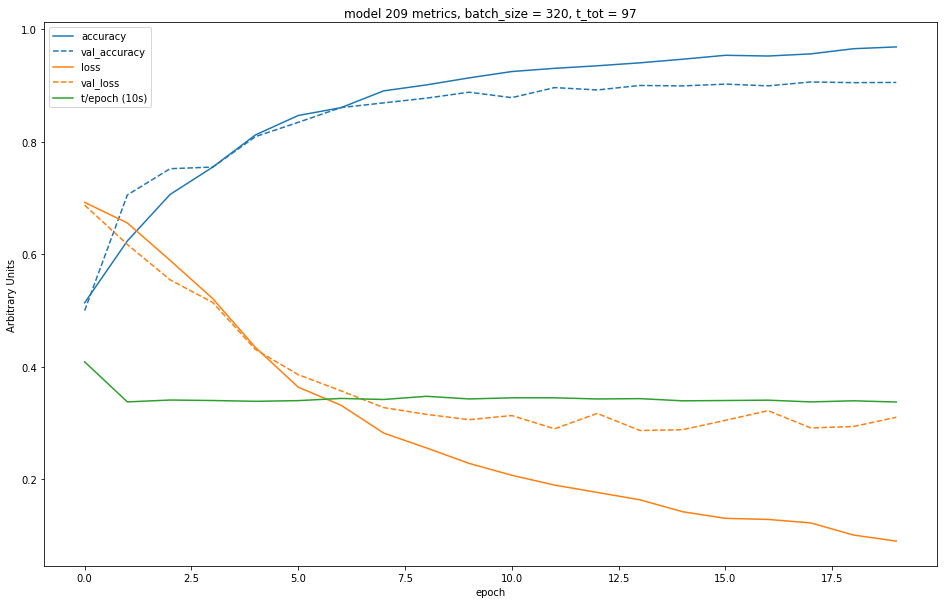

Creating model 210...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


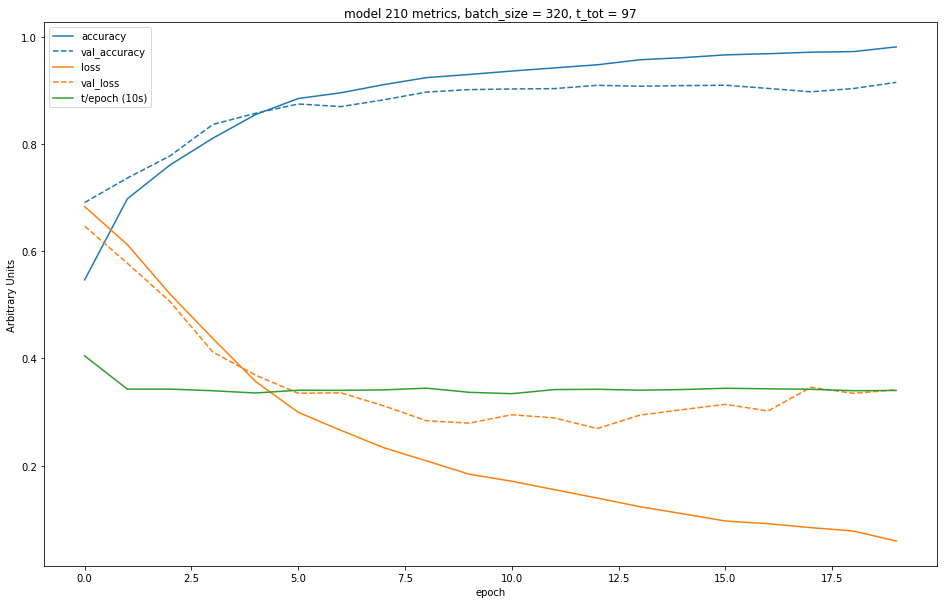

Creating model 211...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


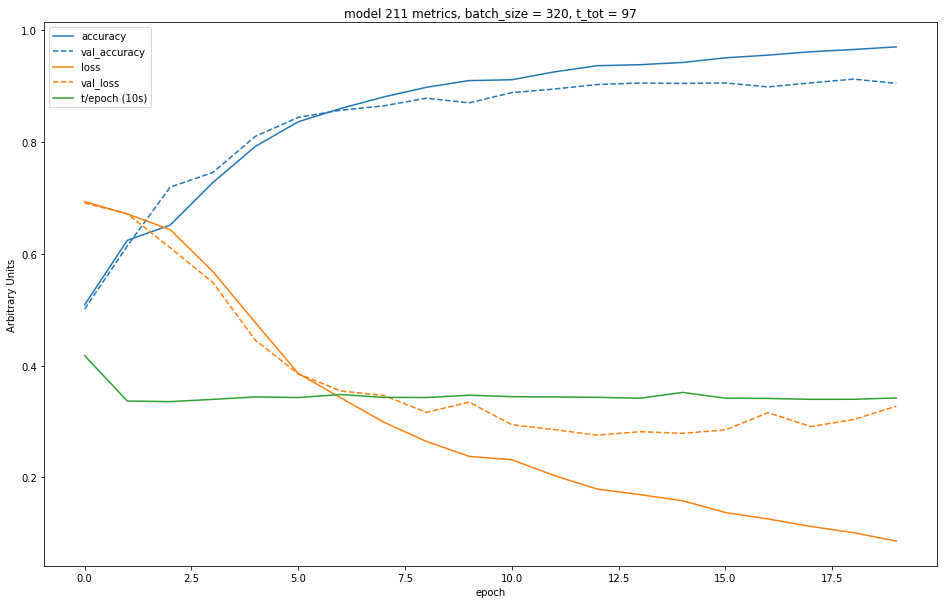

Creating model 212...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


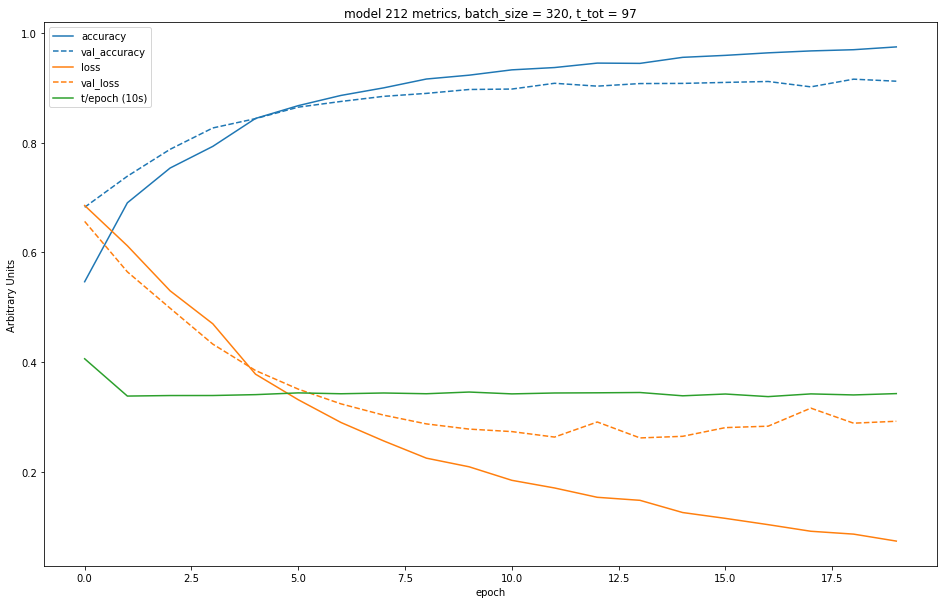

Creating model 213...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


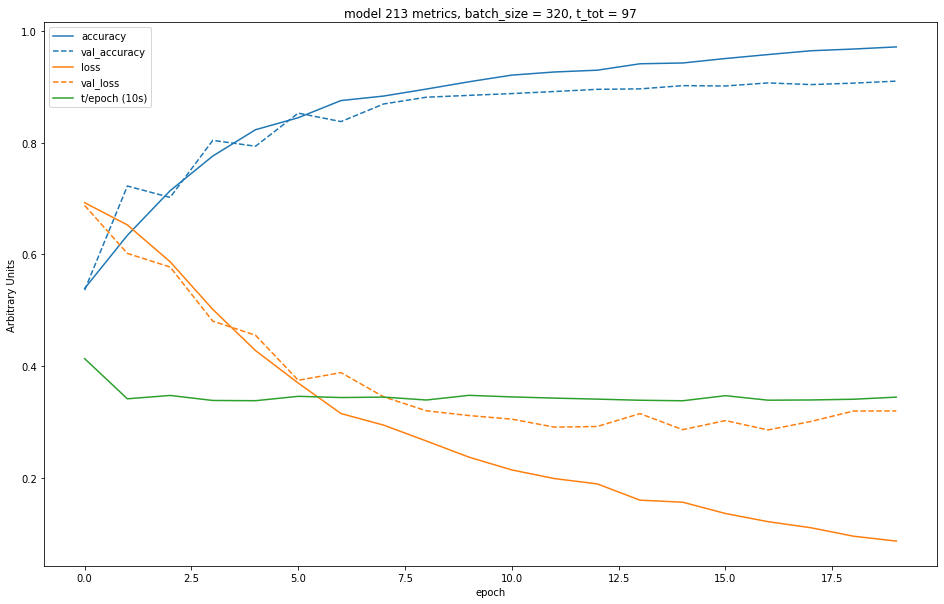

Creating model 214...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


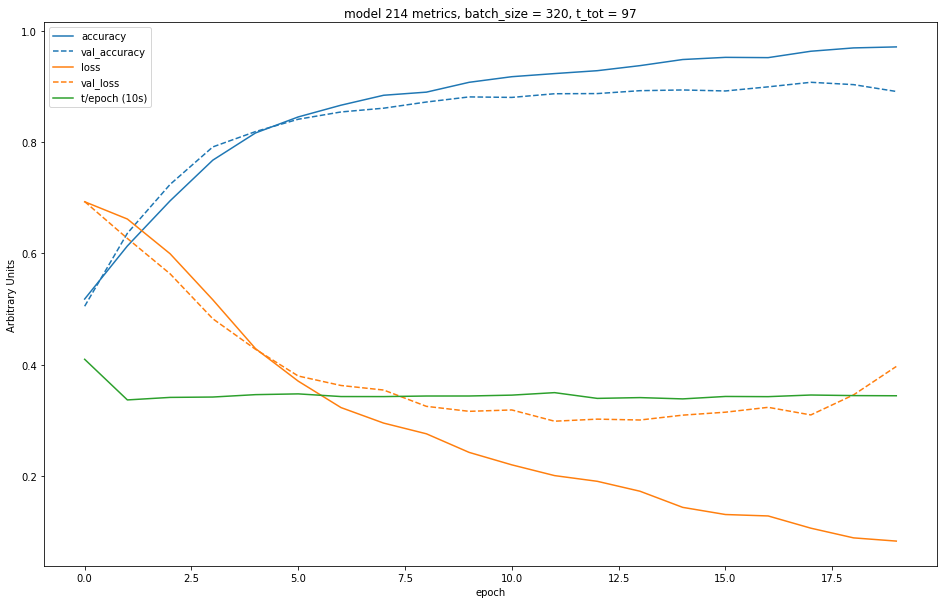

Creating model 215...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


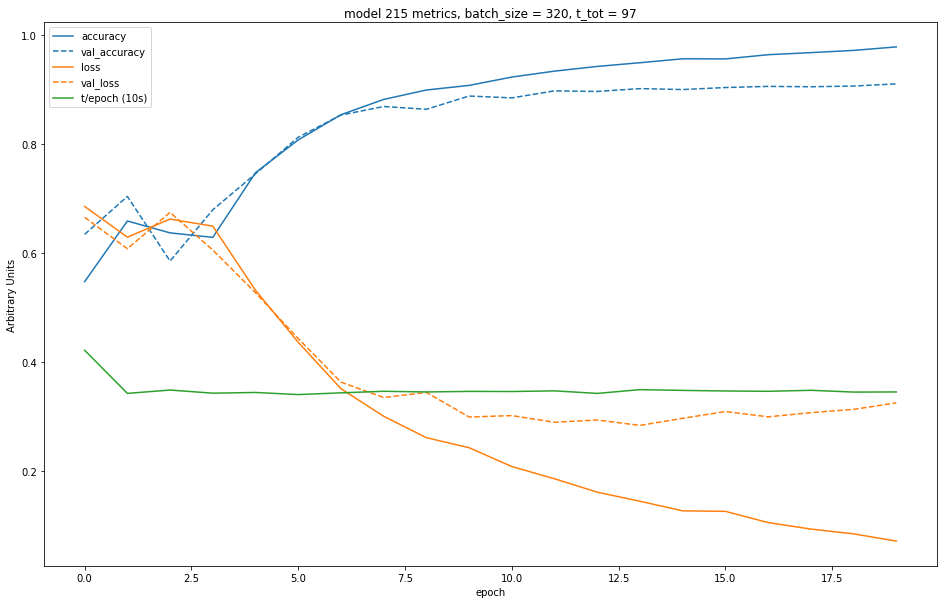

Creating model 216...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


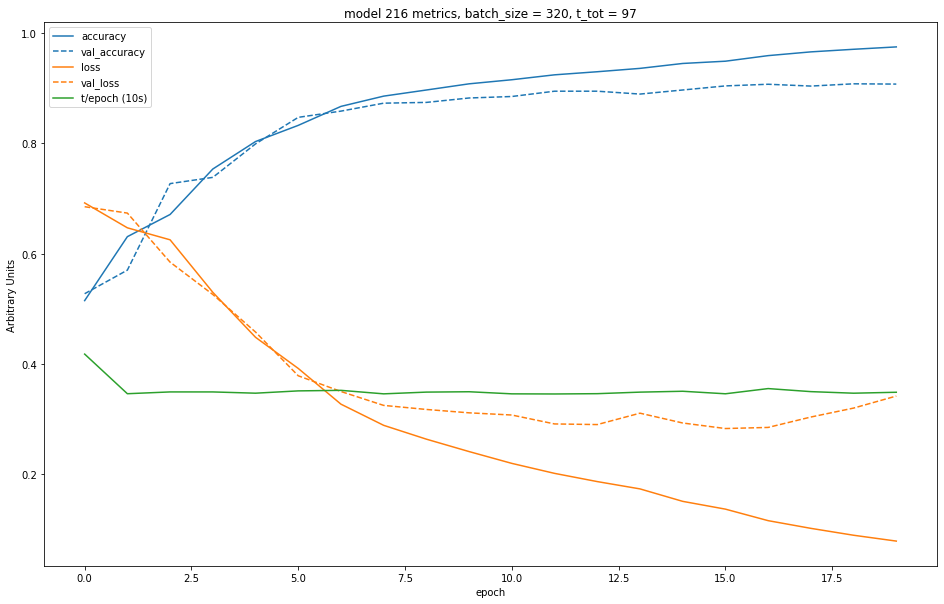

Creating model 217...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


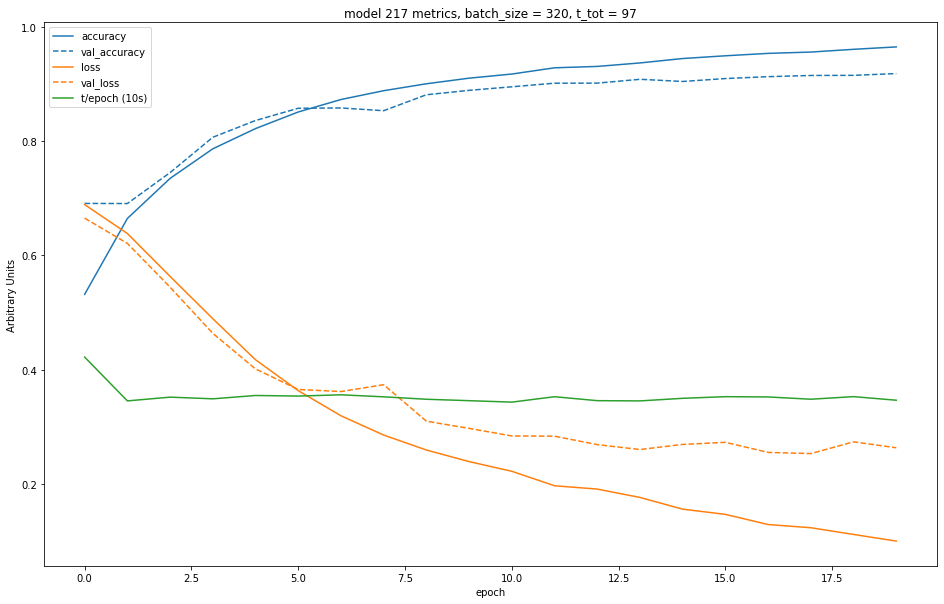

Creating model 218...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


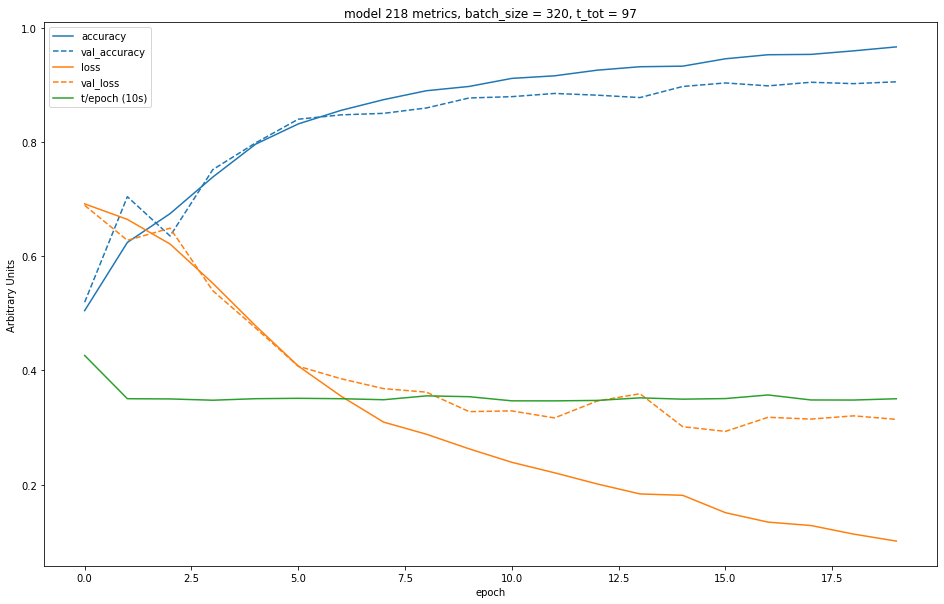

Creating model 219...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


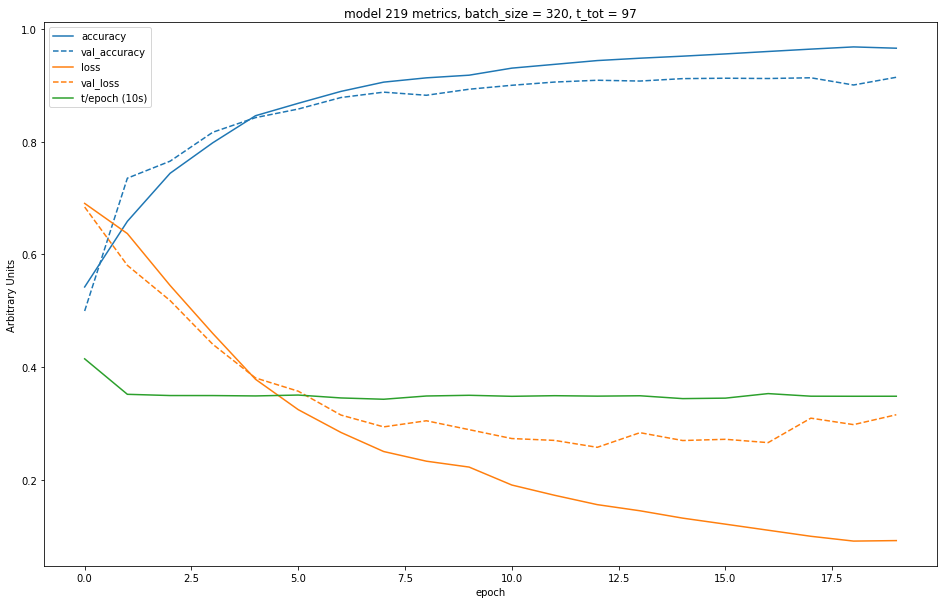

Creating model 220...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


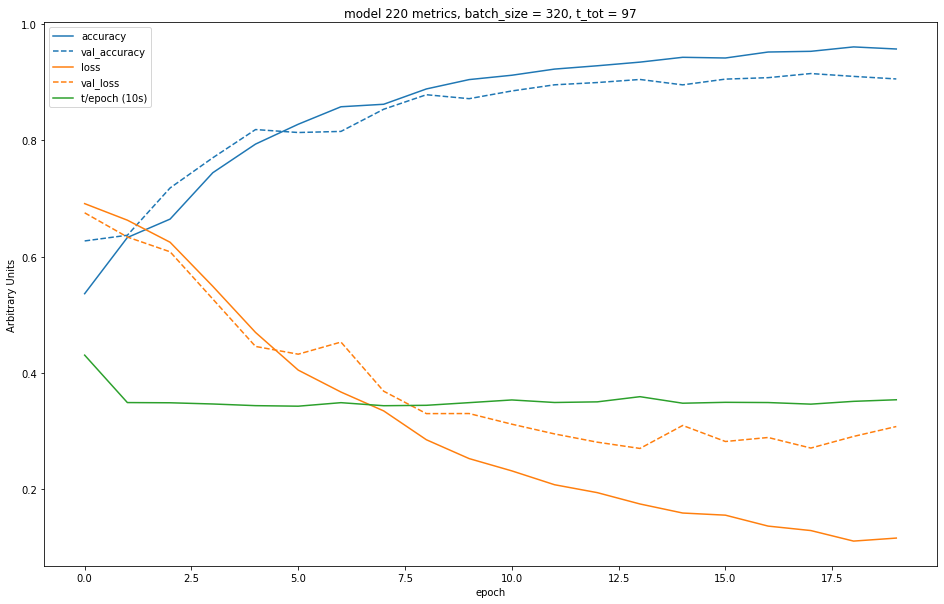

Creating model 221...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


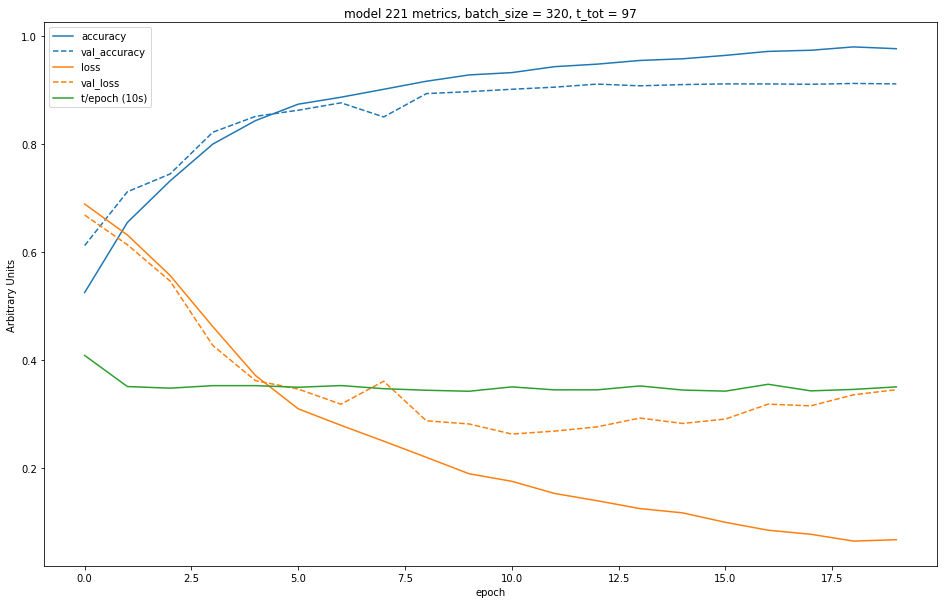

Creating model 222...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


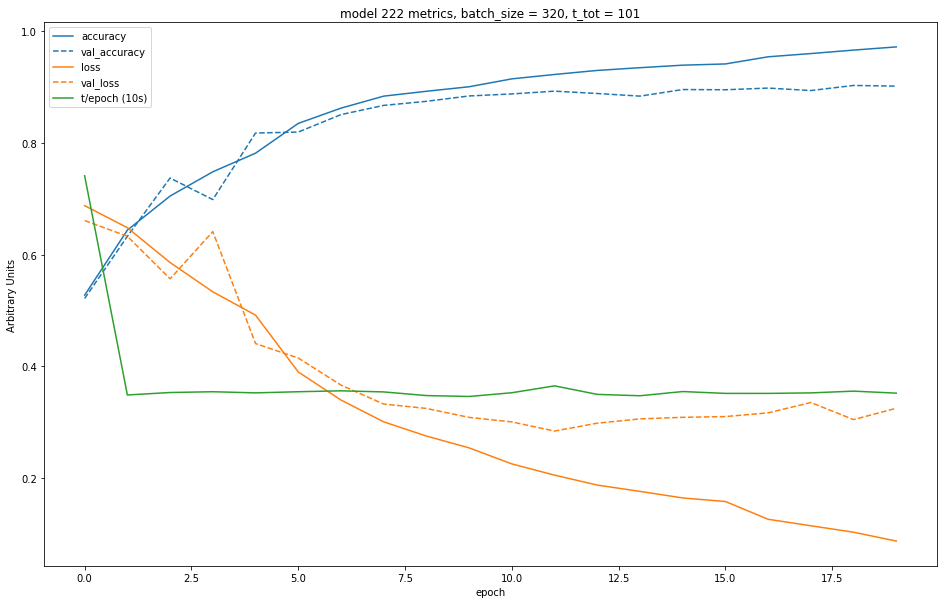

Creating model 223...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


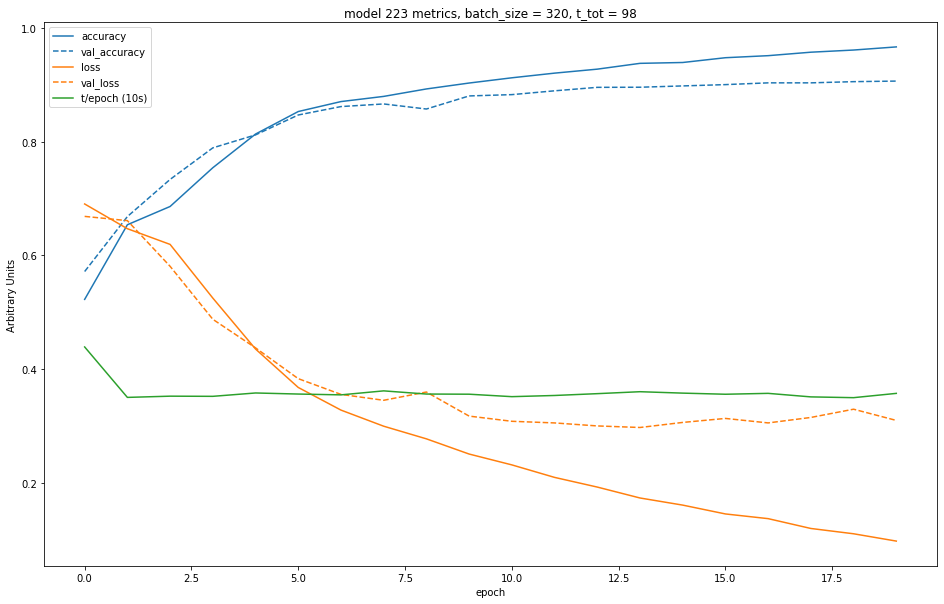

Creating model 224...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


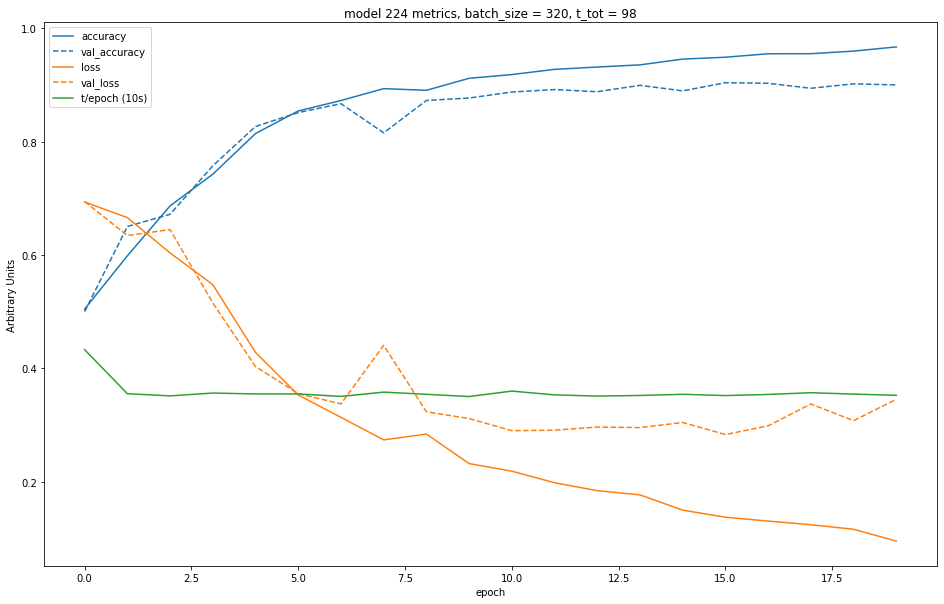

Creating model 225...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


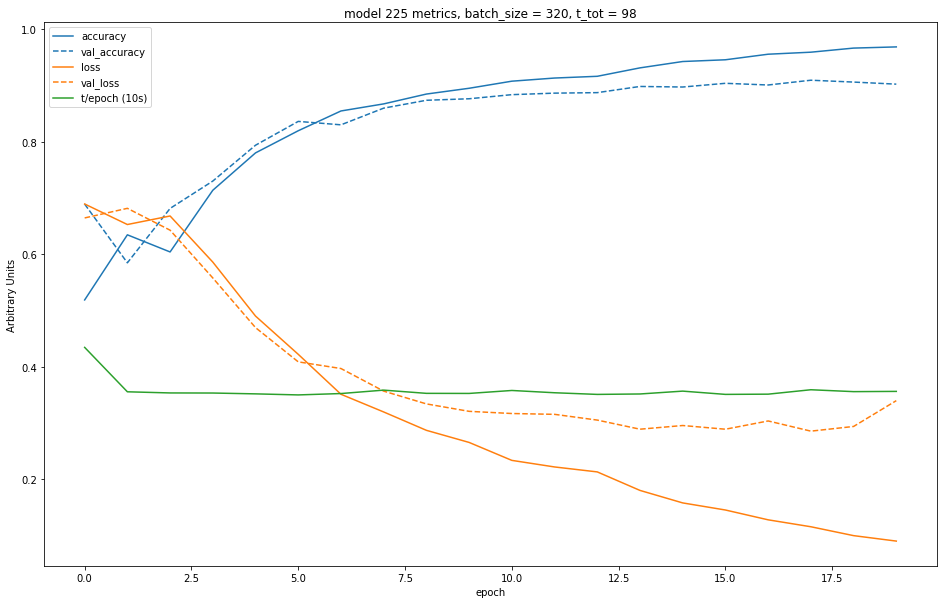

Creating model 226...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


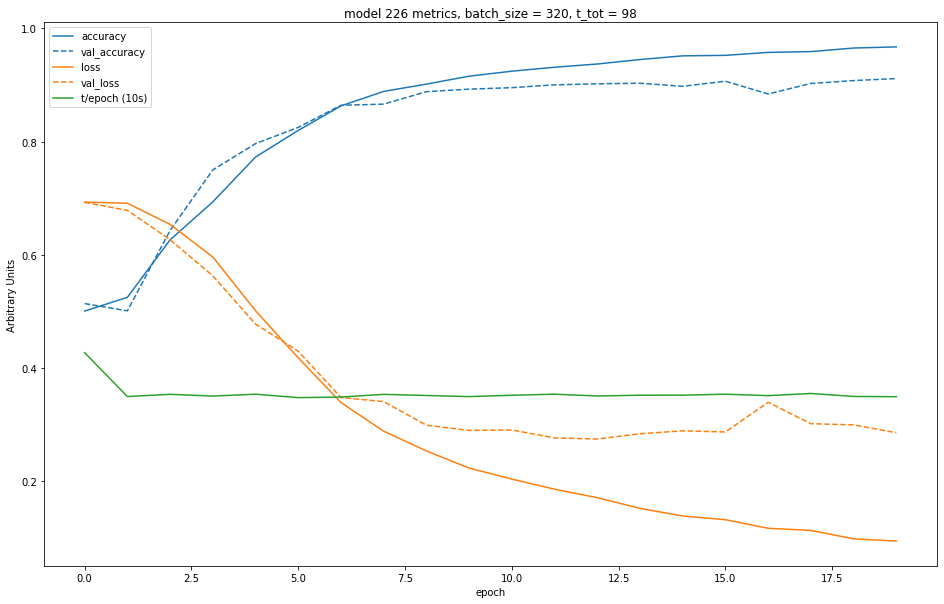

Creating model 227...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


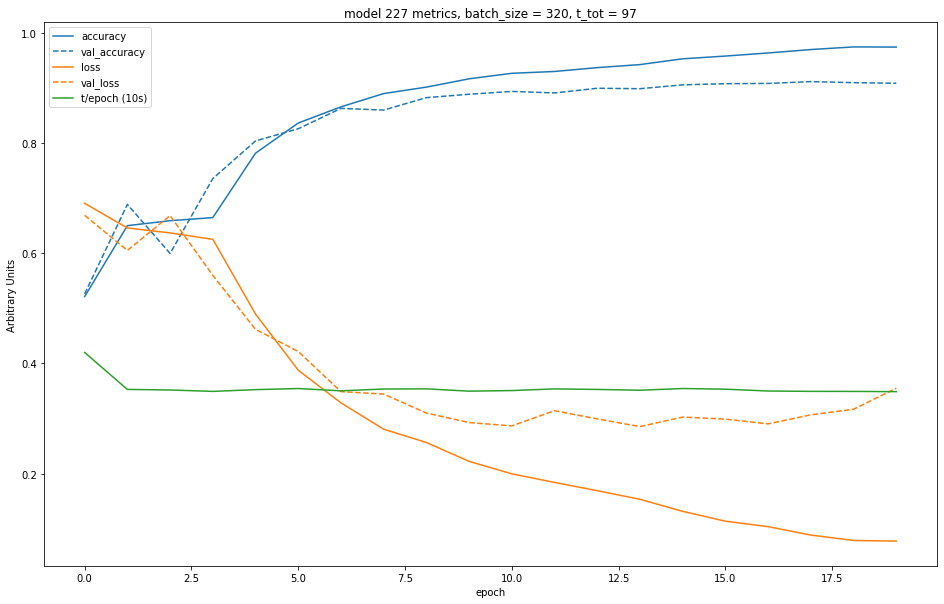

Creating model 228...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


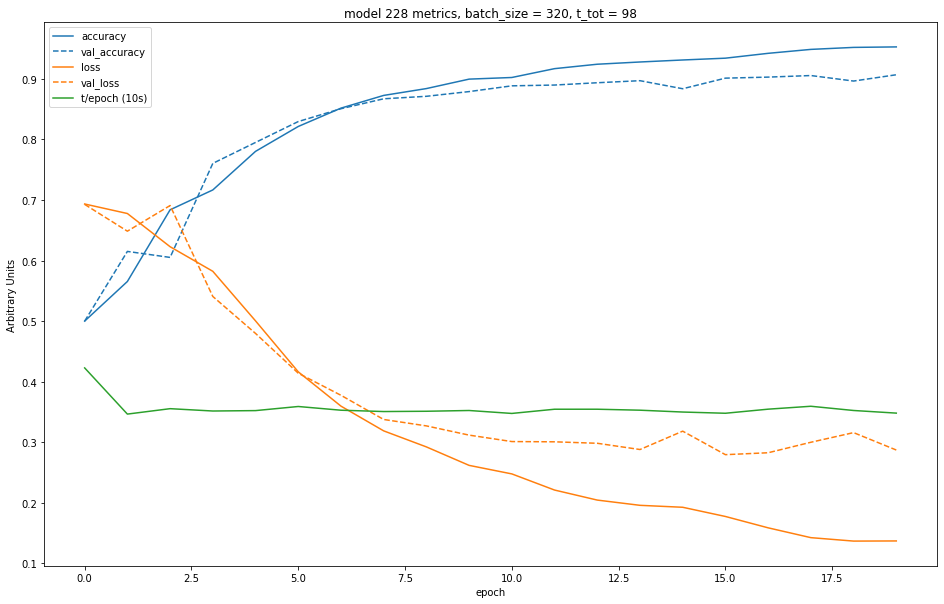

Creating model 229...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


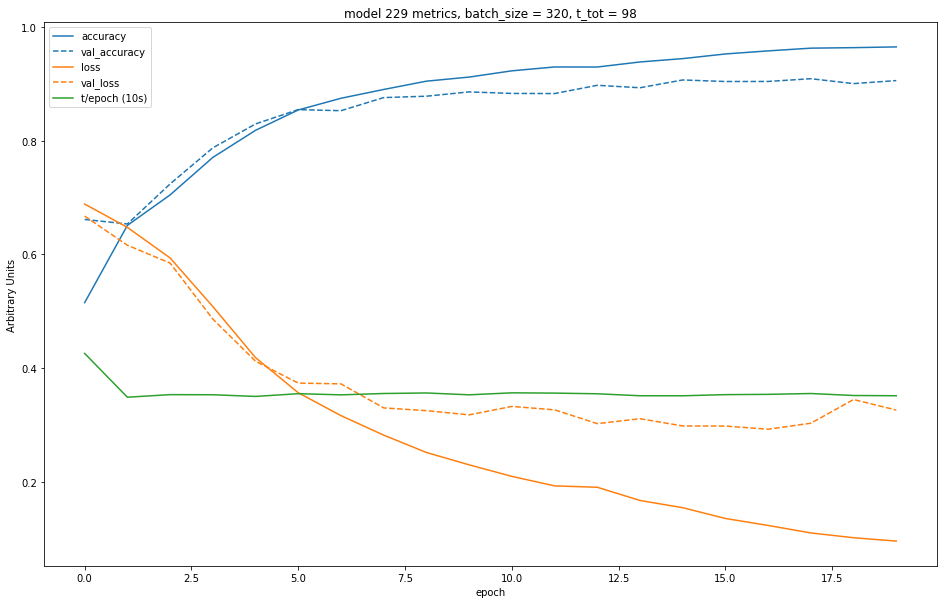

Creating model 230...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


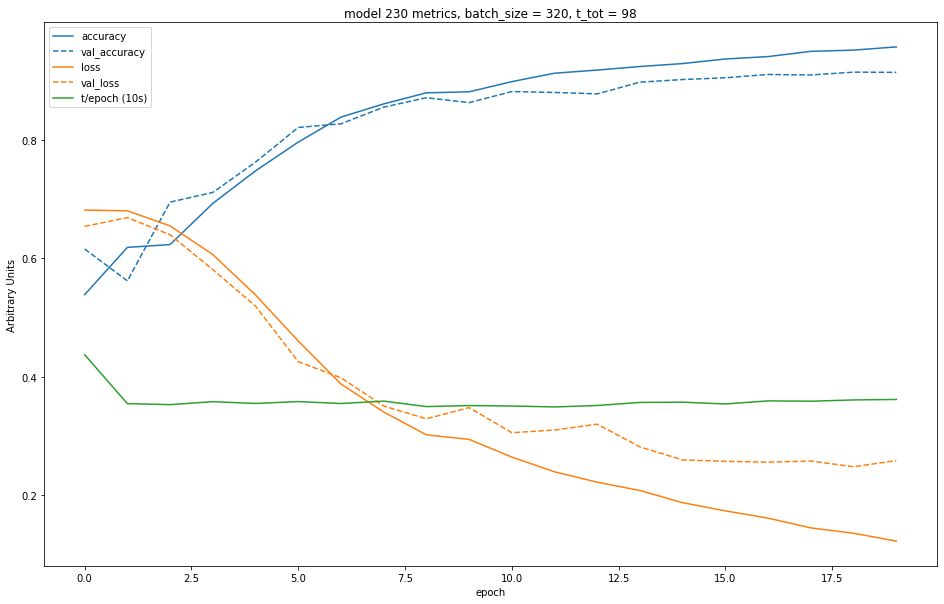

Creating model 231...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


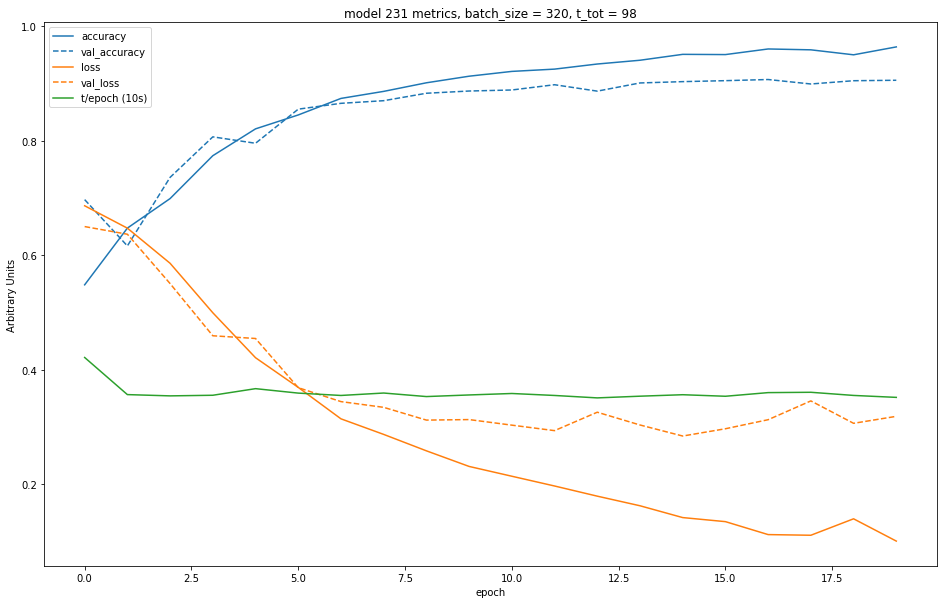

Creating model 232...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


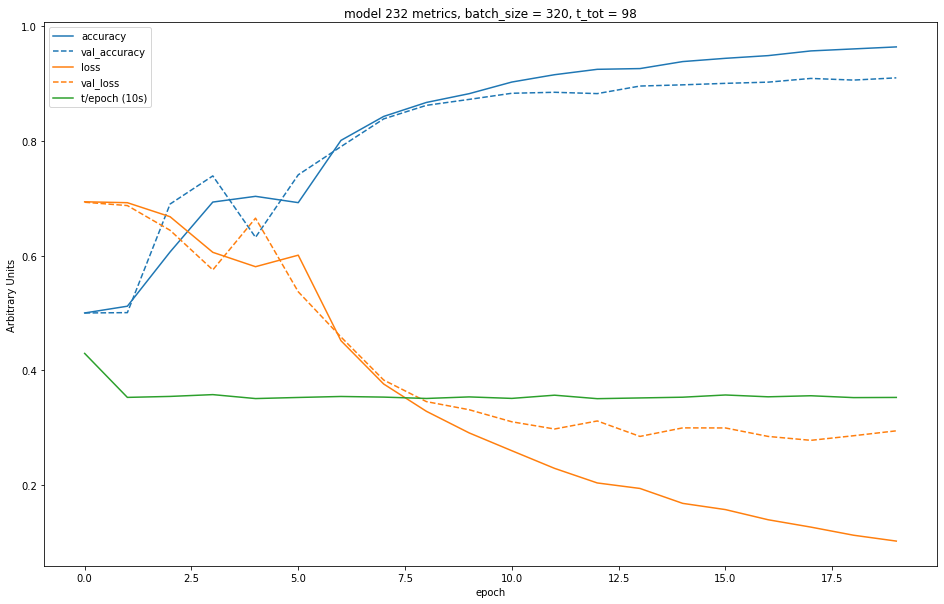

Creating model 233...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


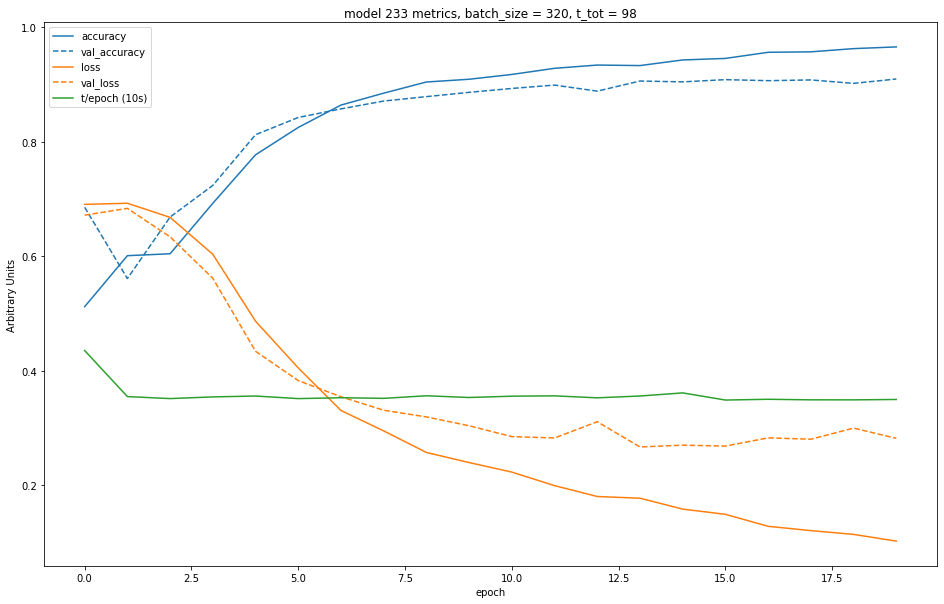

Creating model 234...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


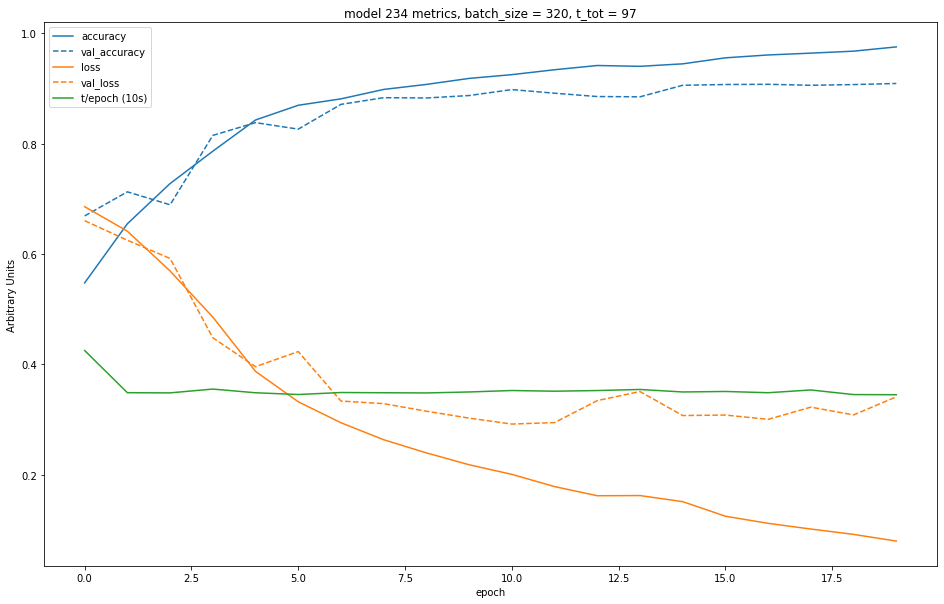

Creating model 235...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


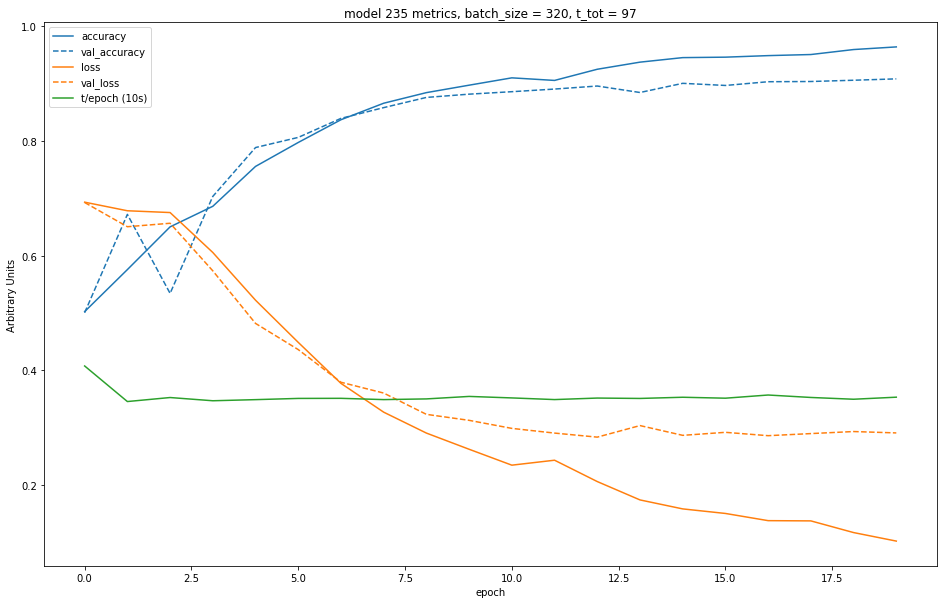

Creating model 236...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


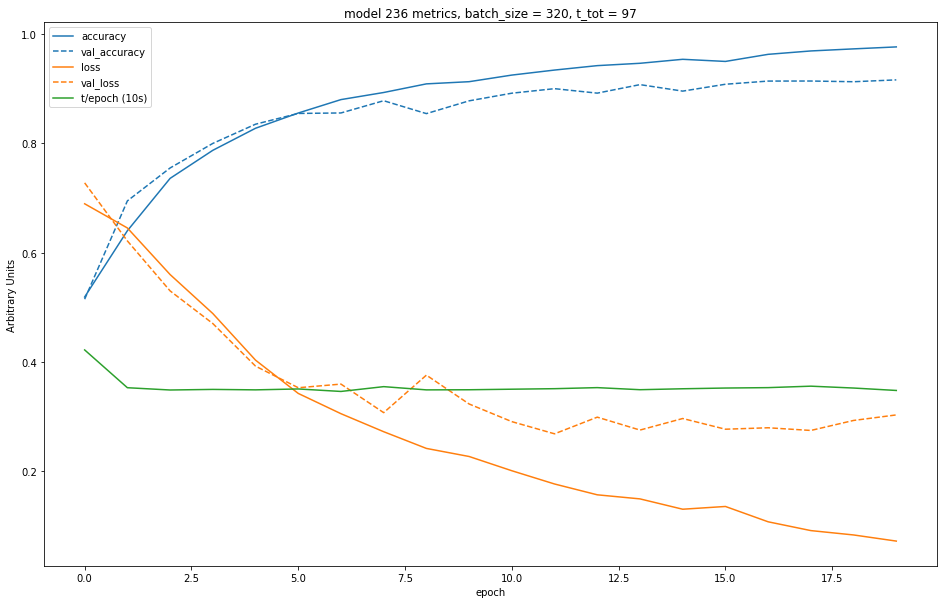

Creating model 237...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


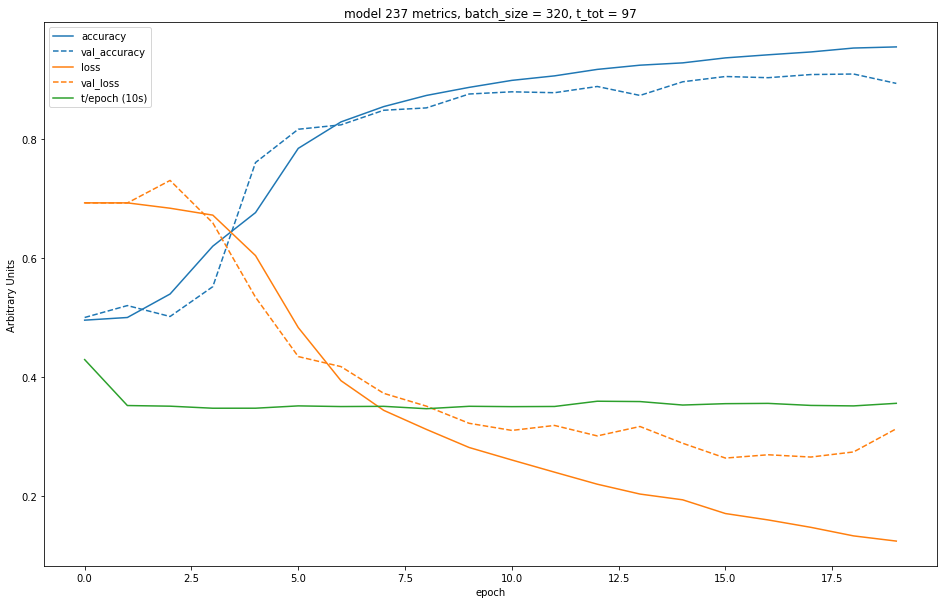

Creating model 238...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


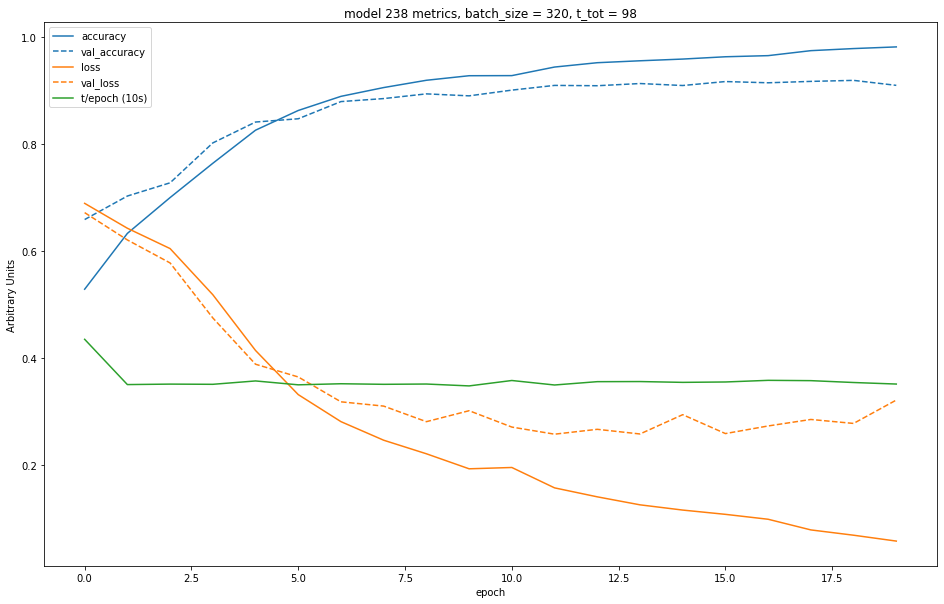

Creating model 239...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


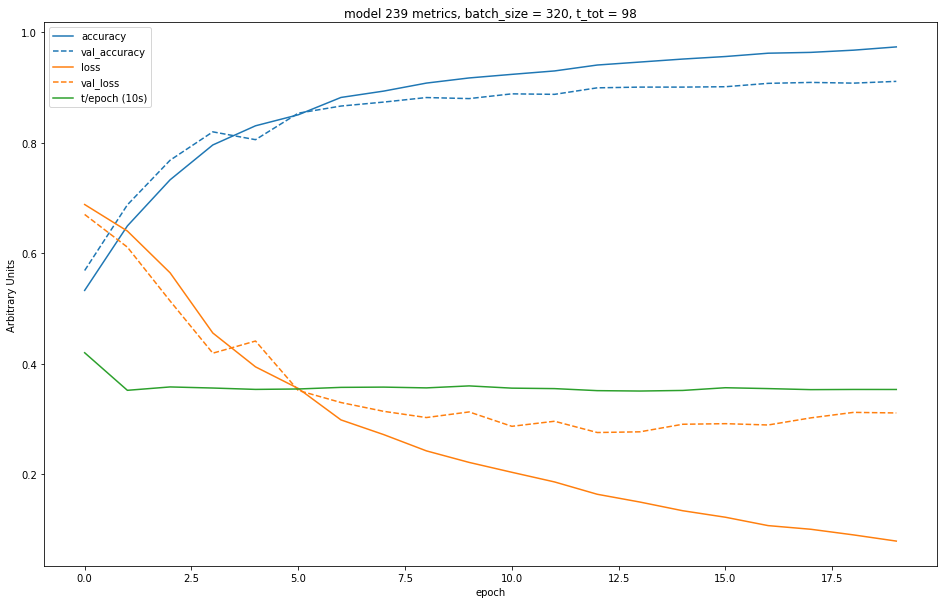

Creating model 240...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


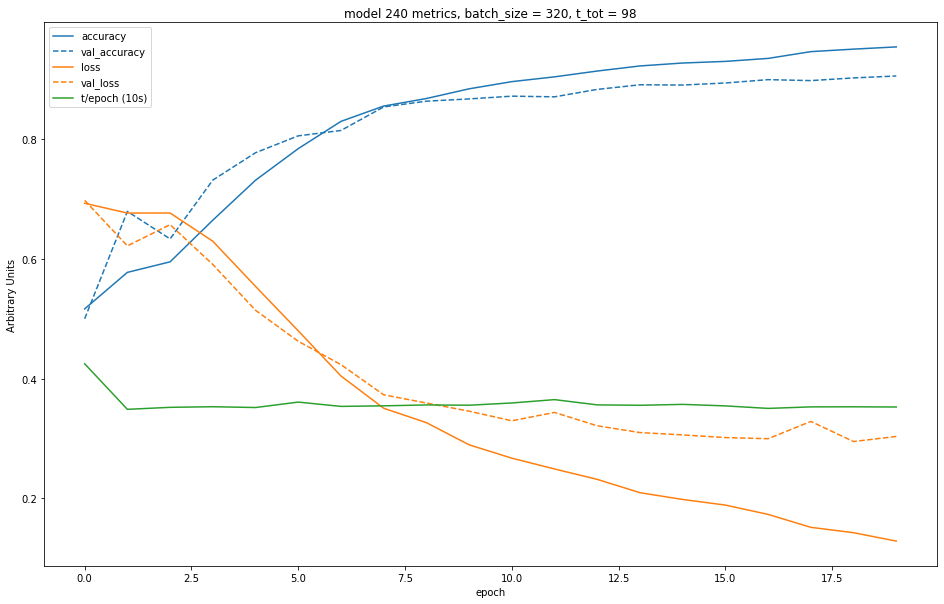

Creating model 241...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


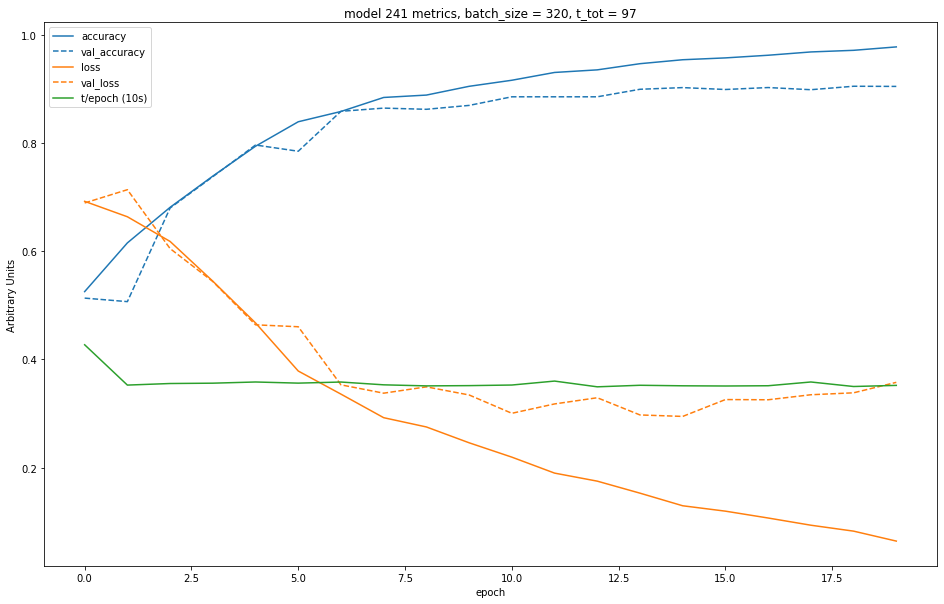

Creating model 242...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


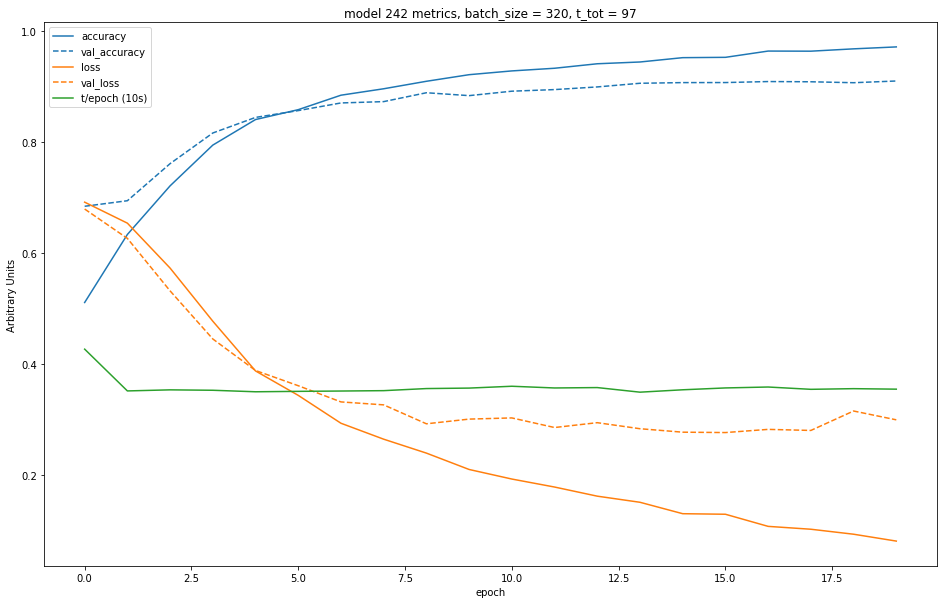

Creating model 243...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


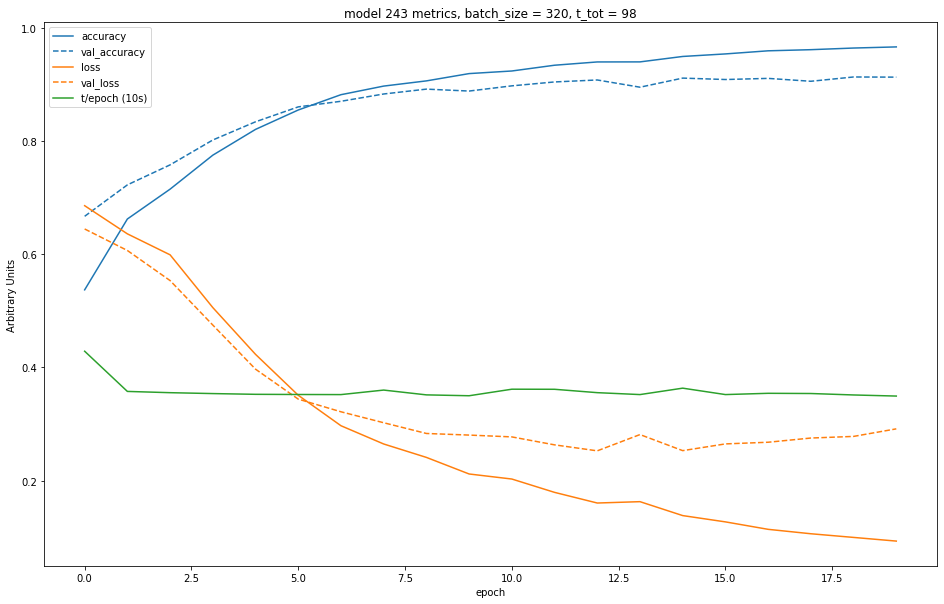

Creating model 244...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


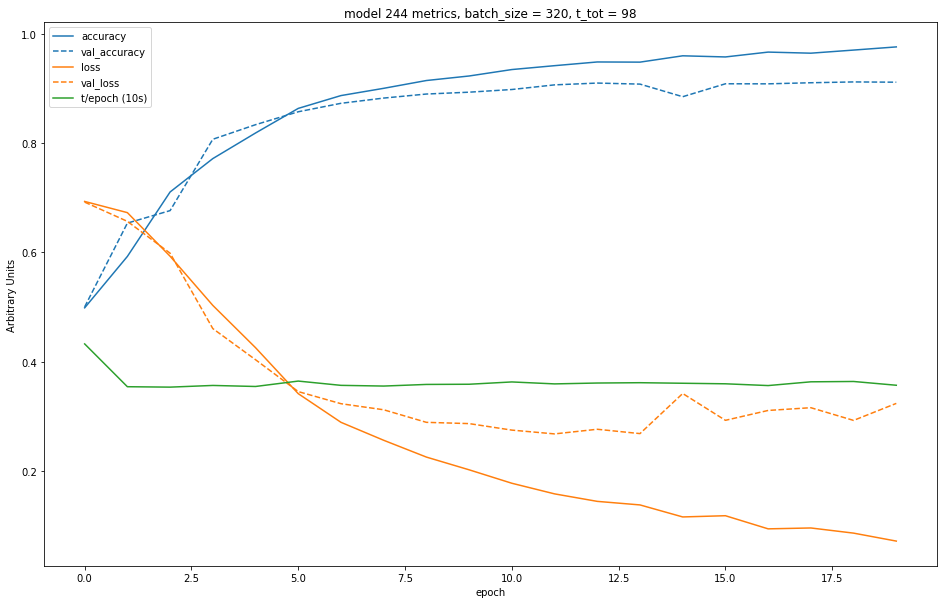

Creating model 245...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


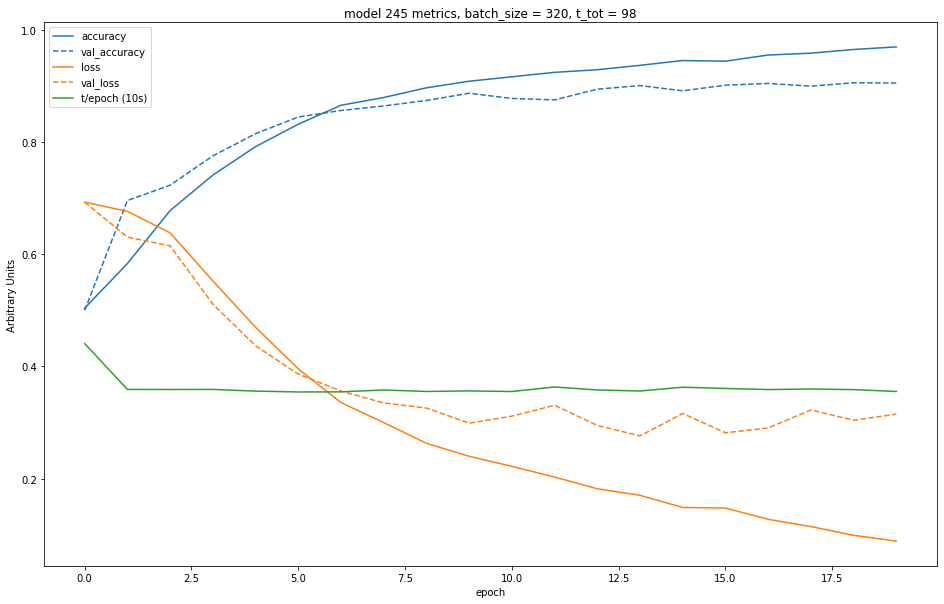

Creating model 246...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


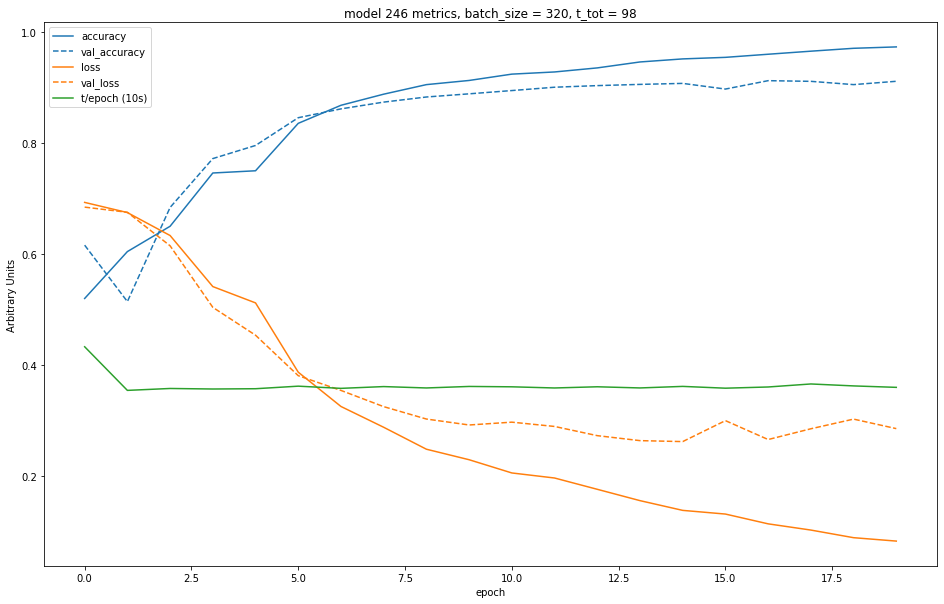

Creating model 247...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


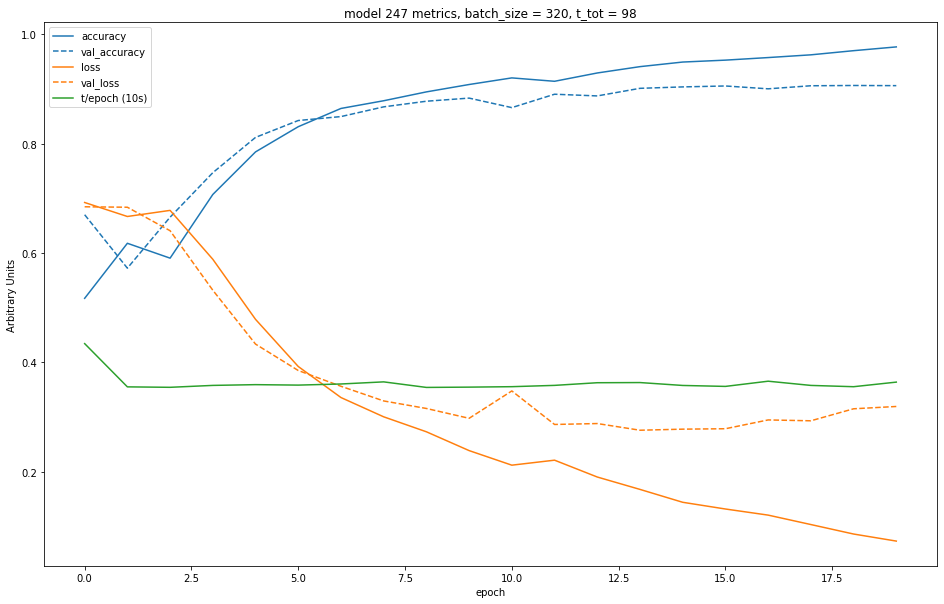

Creating model 248...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


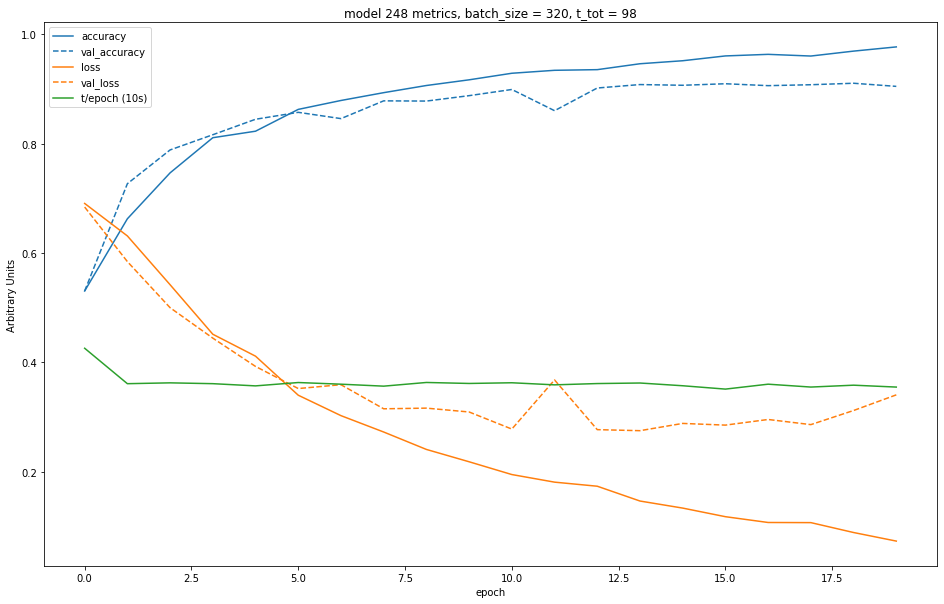

Creating model 249...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


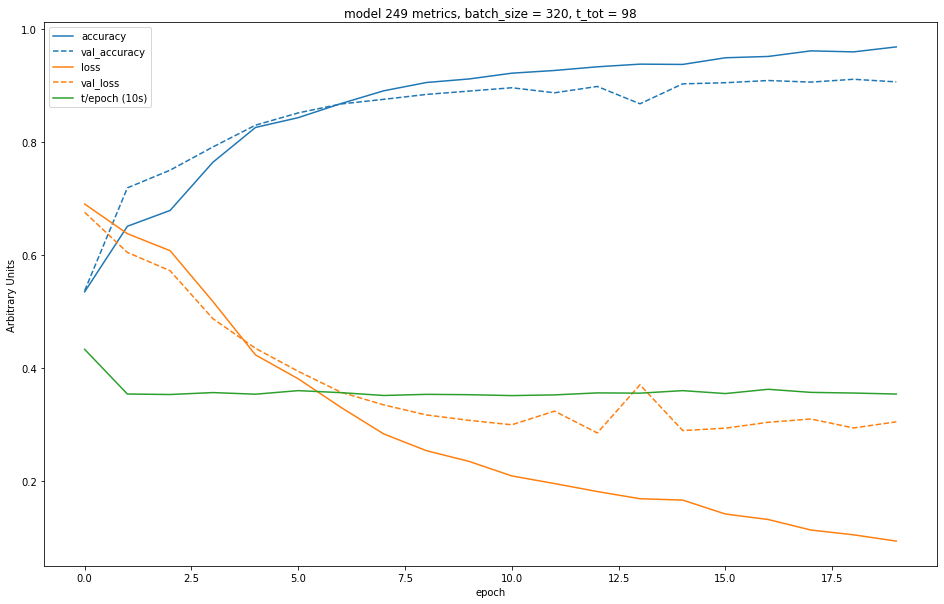

Creating model 250...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


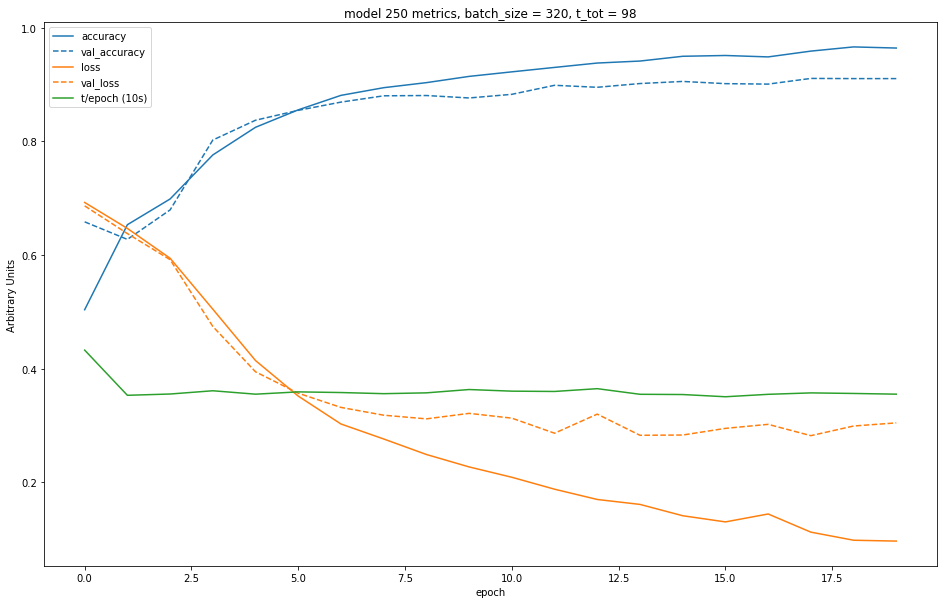

Creating model 251...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


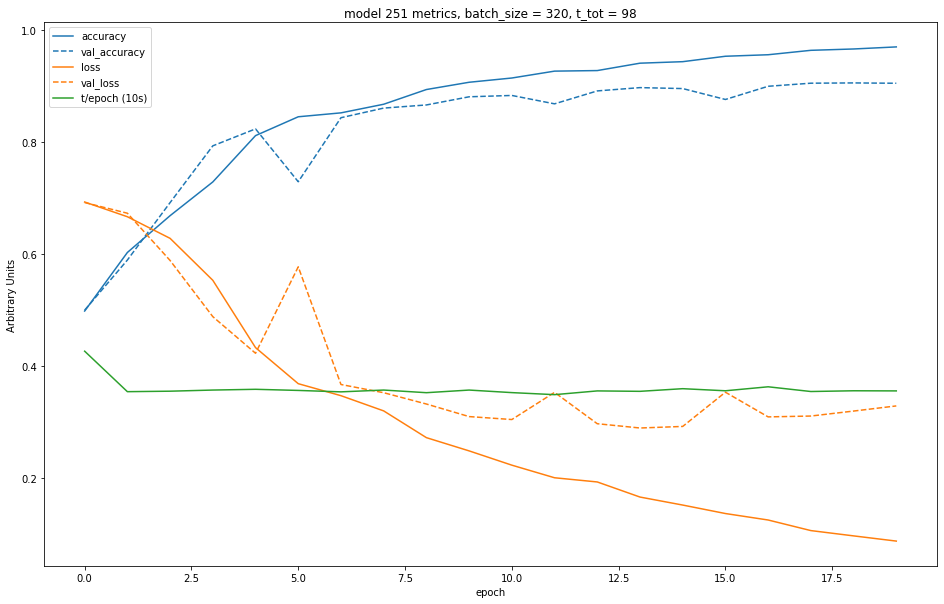

Creating model 252...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


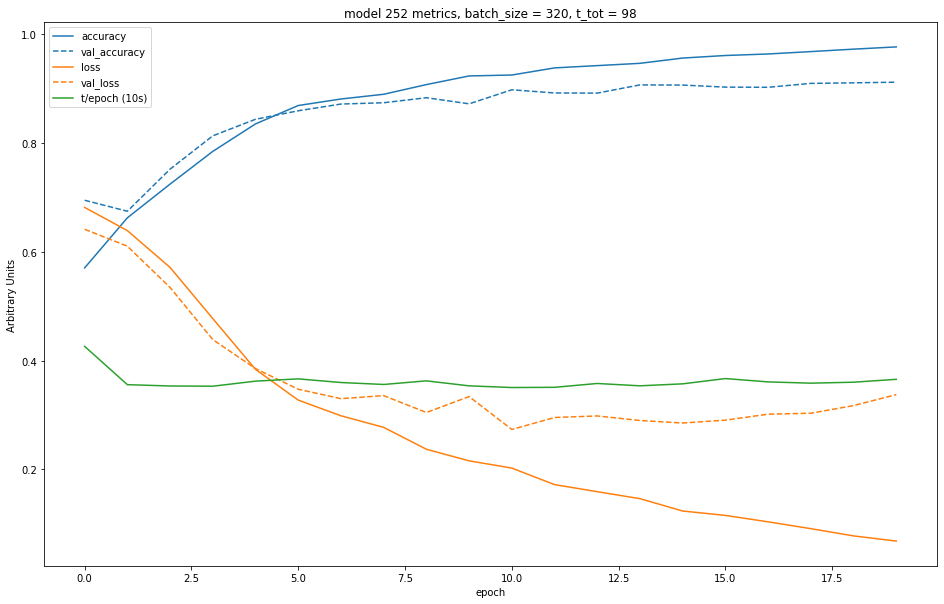

Creating model 253...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


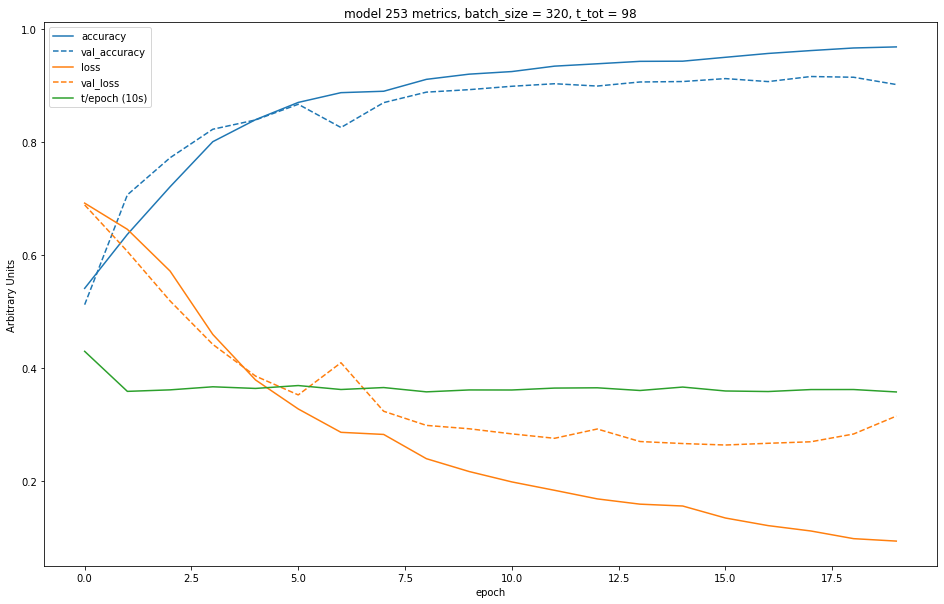

Creating model 254...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


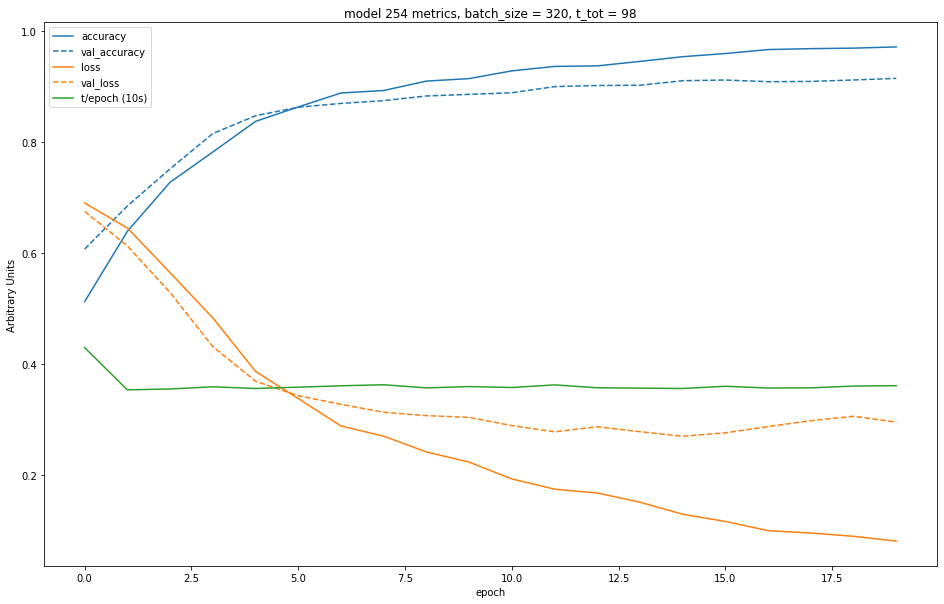

Creating model 255...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


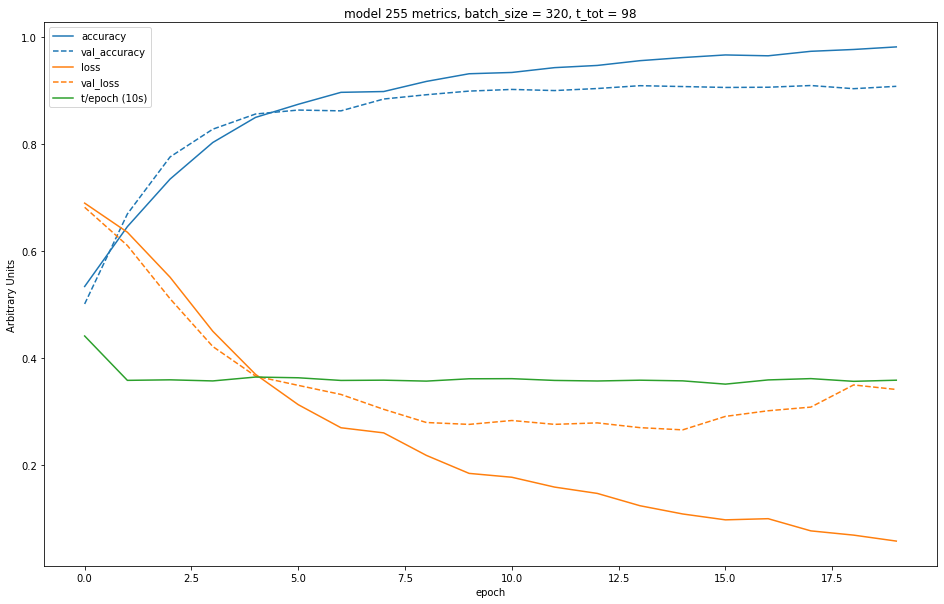

Creating model 256...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


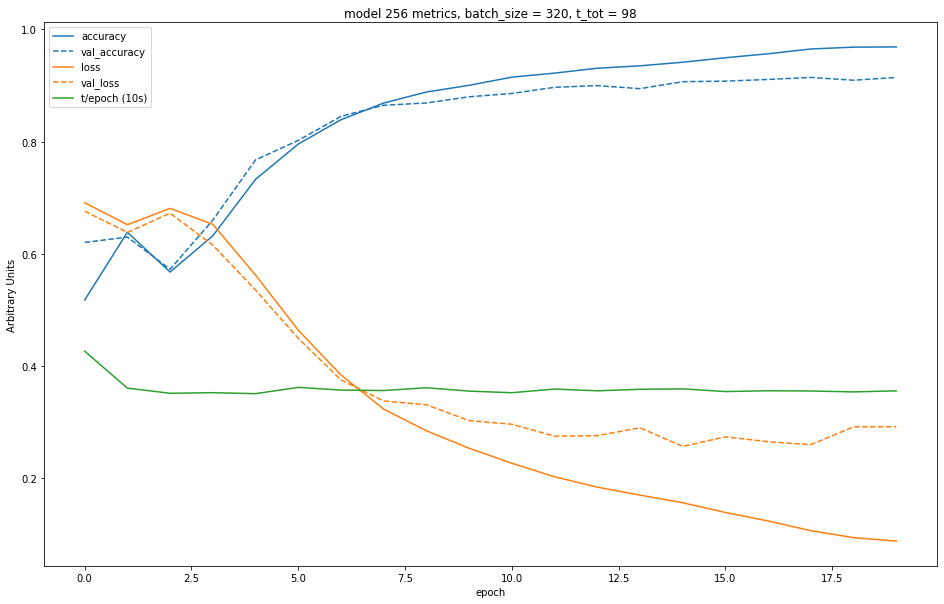

Creating model 257...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


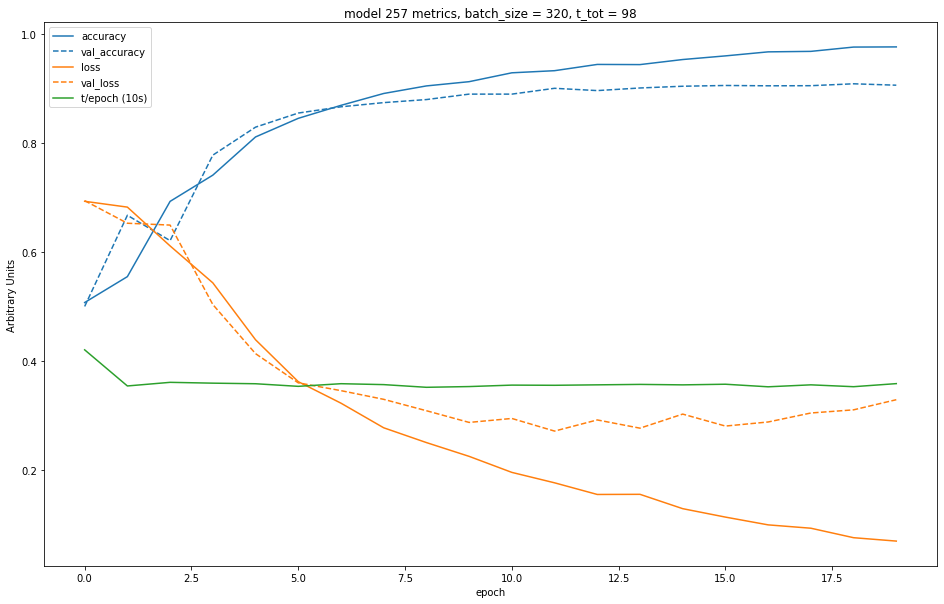

Creating model 258...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


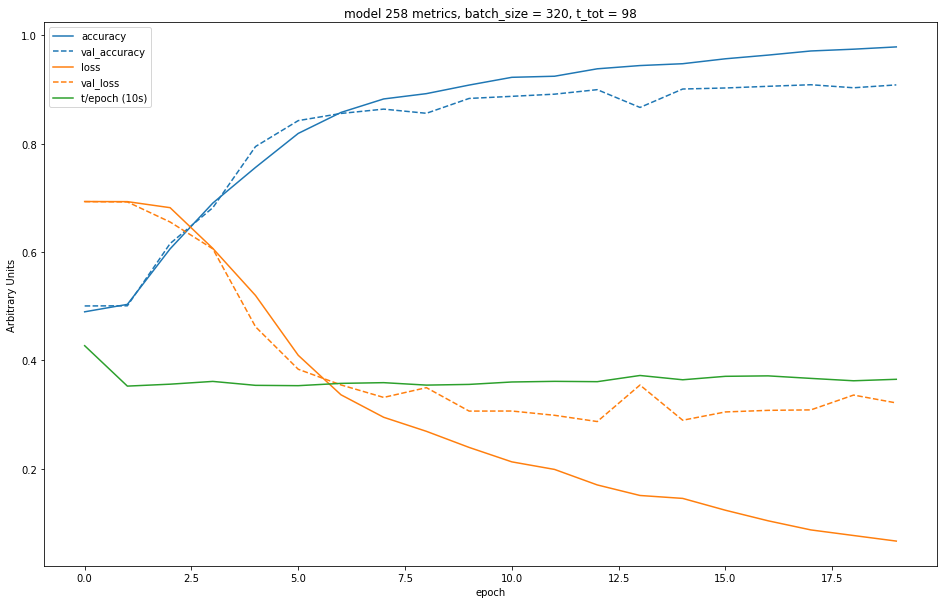

Creating model 259...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


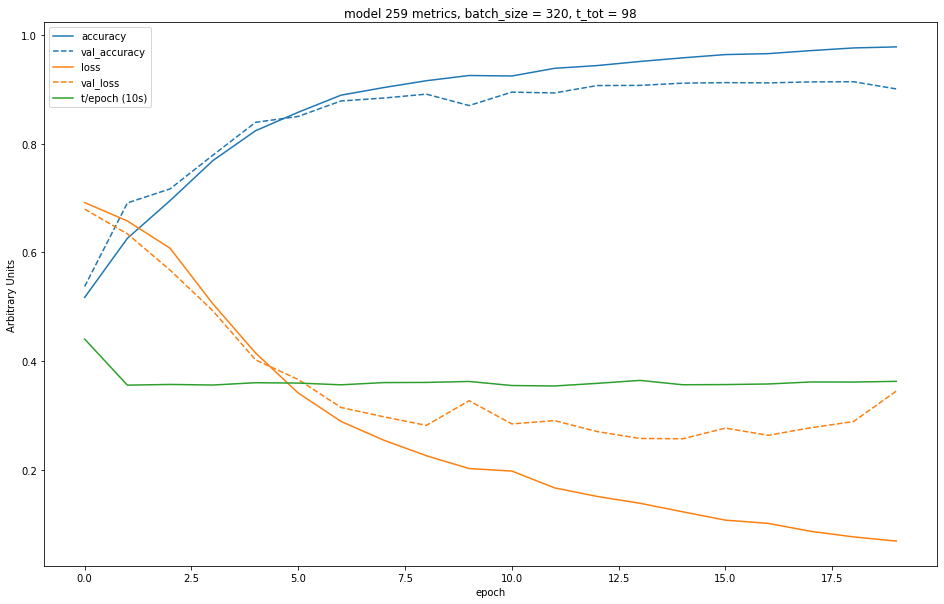

Creating model 260...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


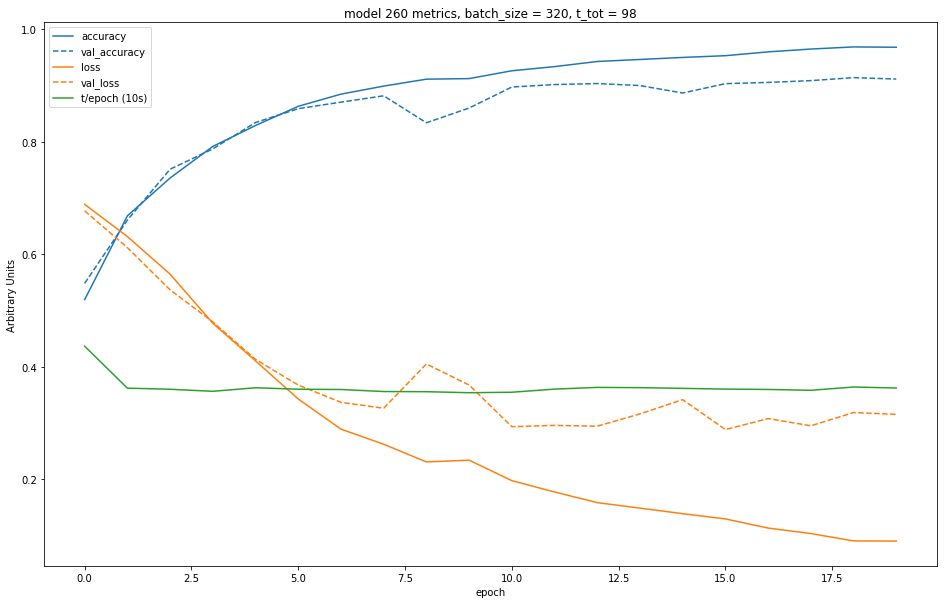

Creating model 261...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


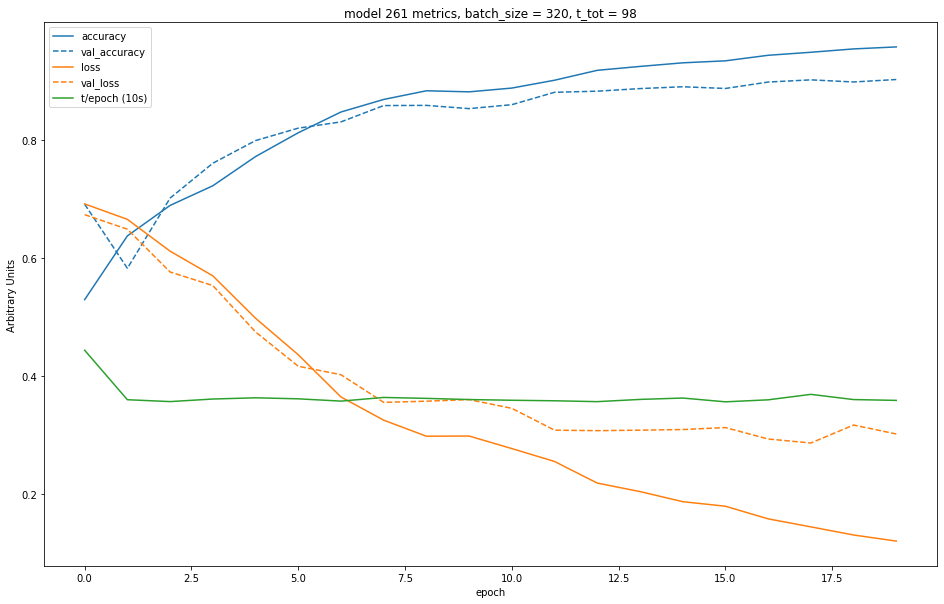

Creating model 262...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


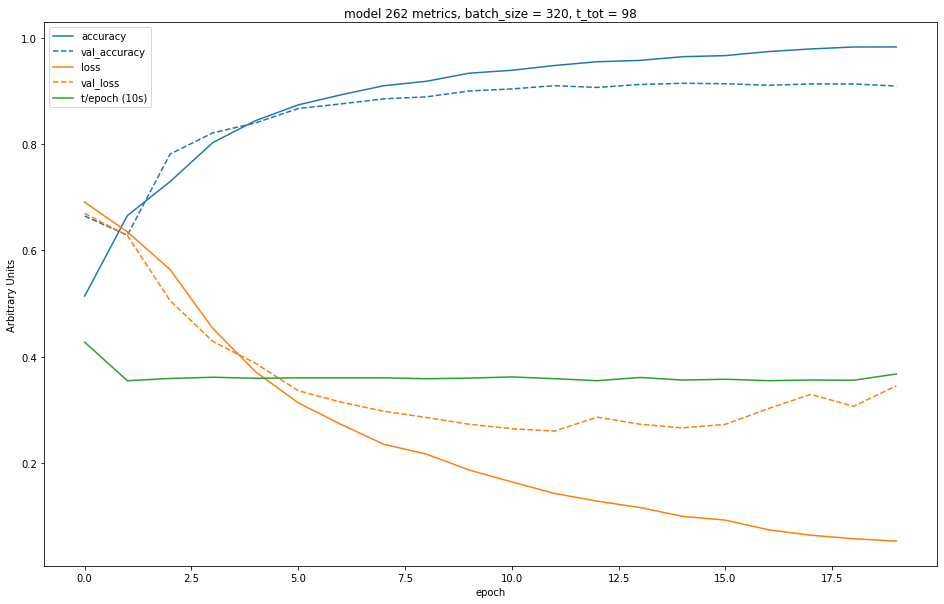

Creating model 263...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


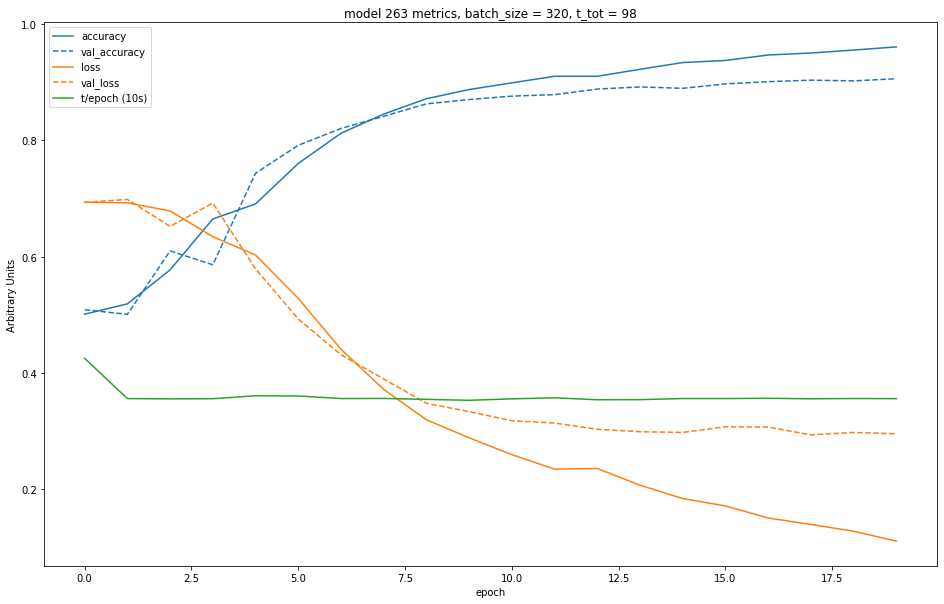

Creating model 264...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


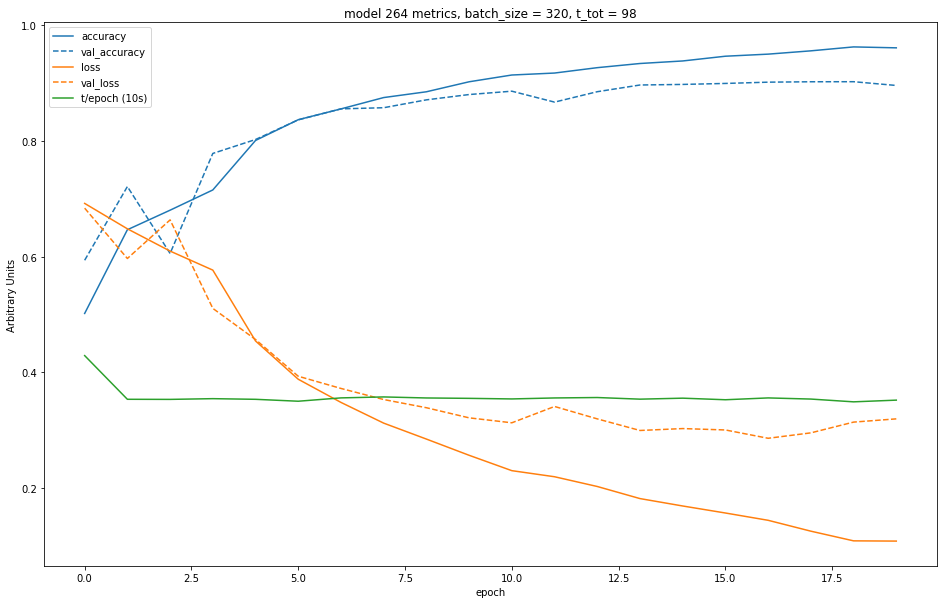

Creating model 265...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


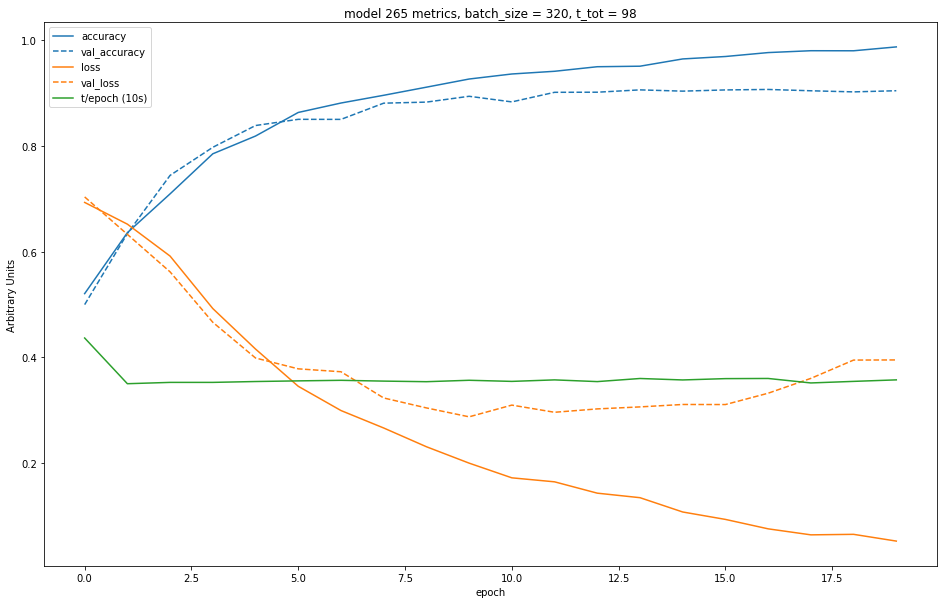

Creating model 266...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


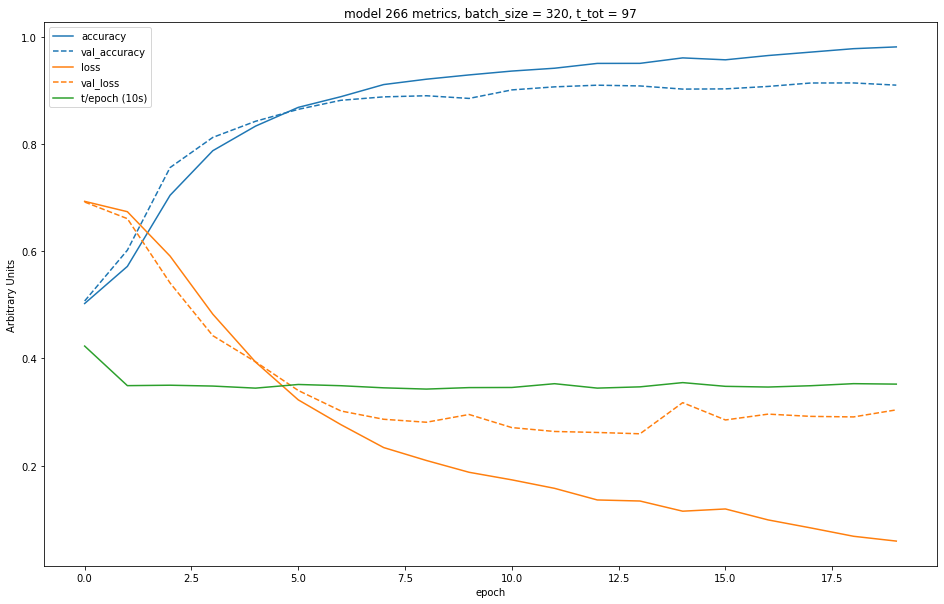

Creating model 267...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


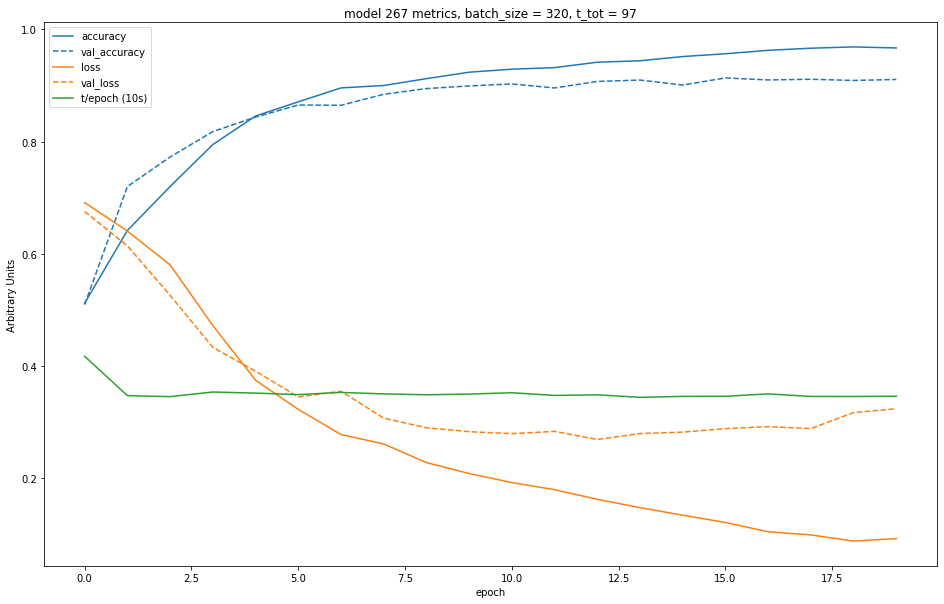

Creating model 268...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


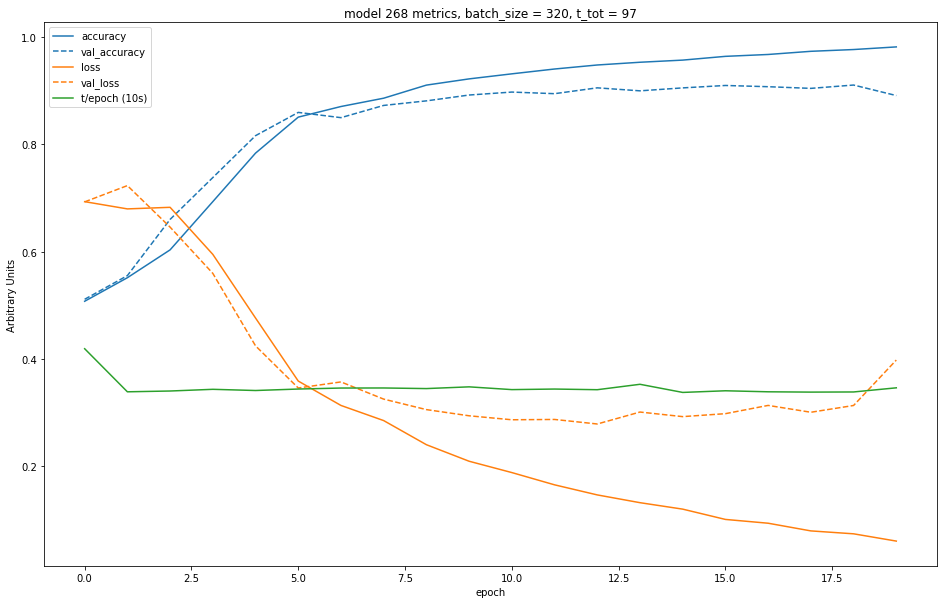

Creating model 269...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


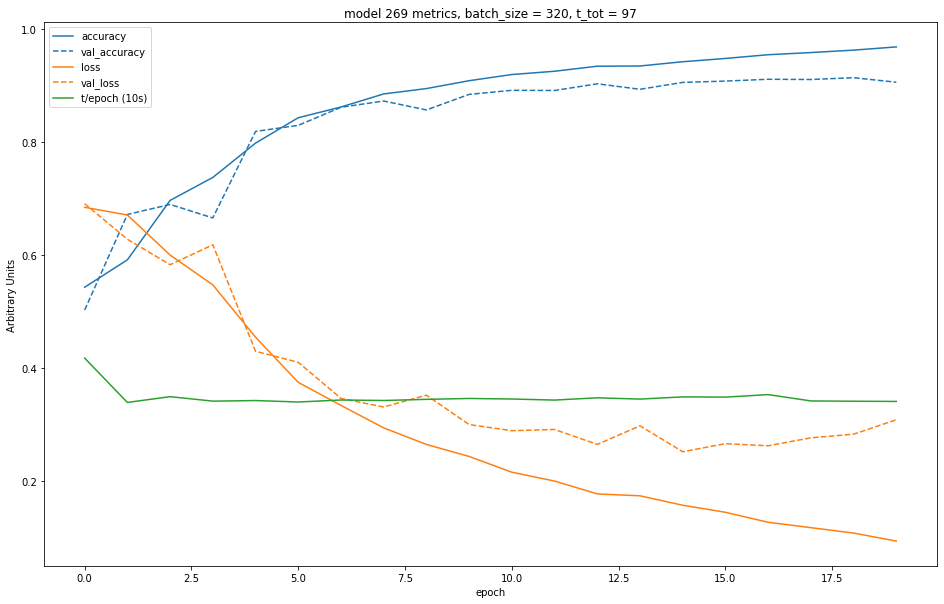

Creating model 270...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


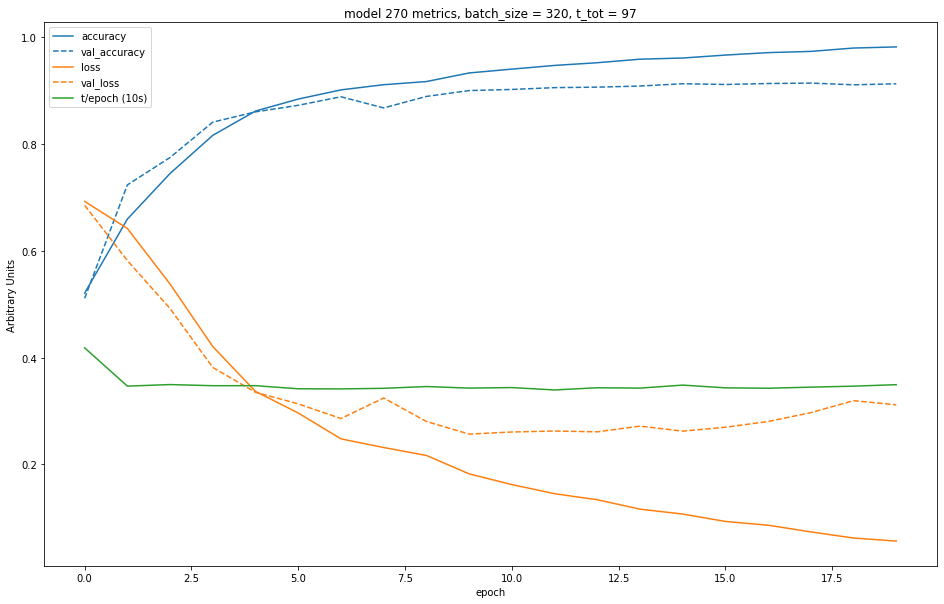

Creating model 271...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


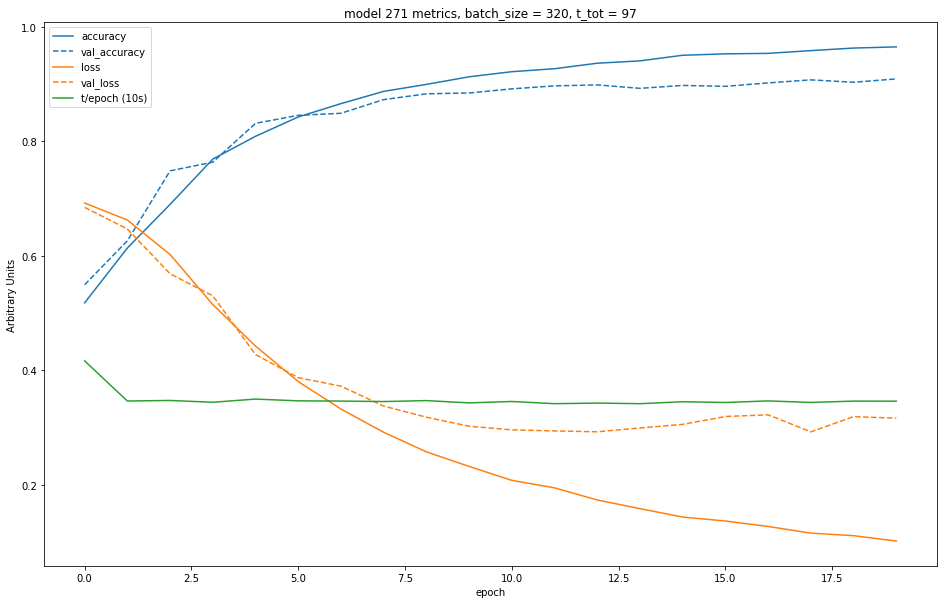

Creating model 272...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


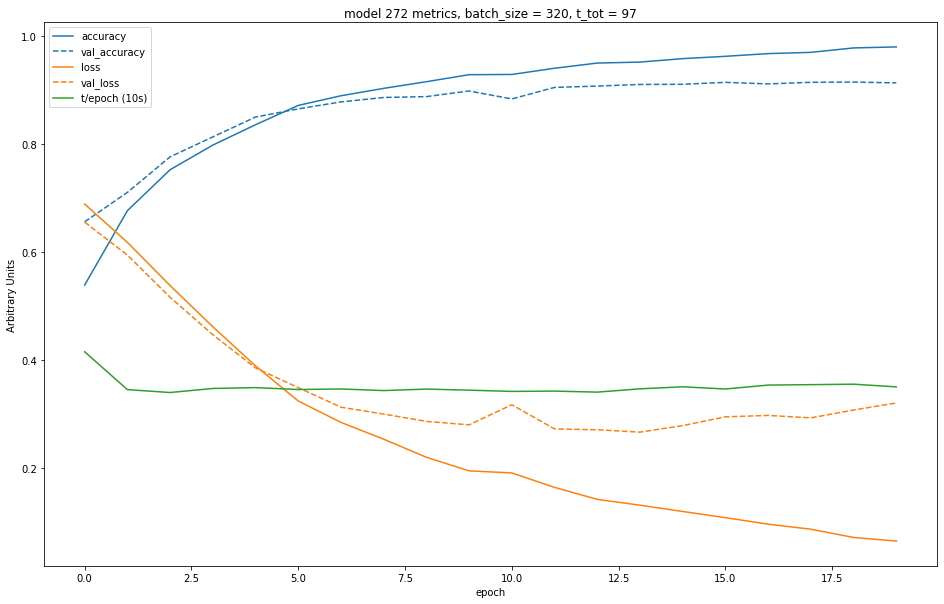

Creating model 273...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


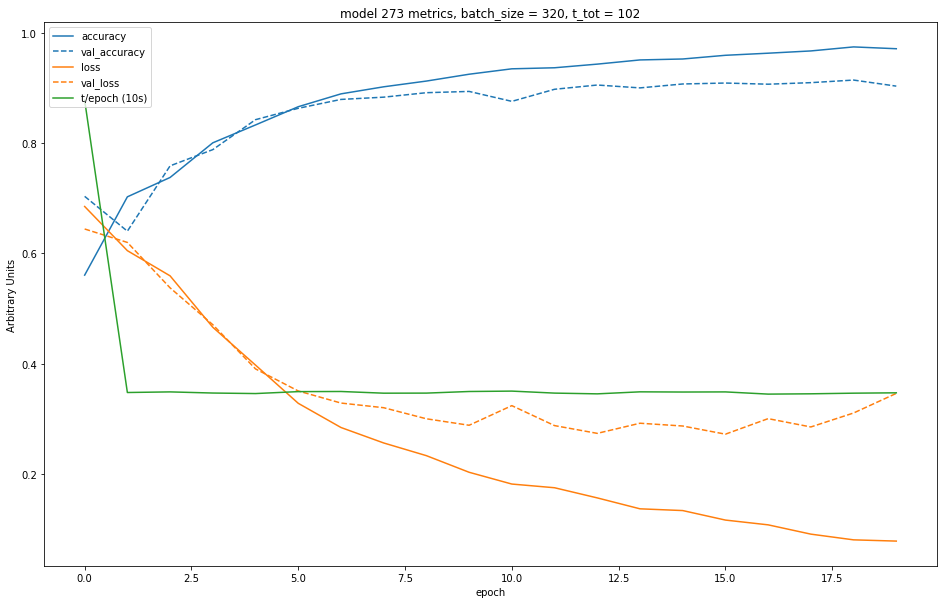

Creating model 274...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


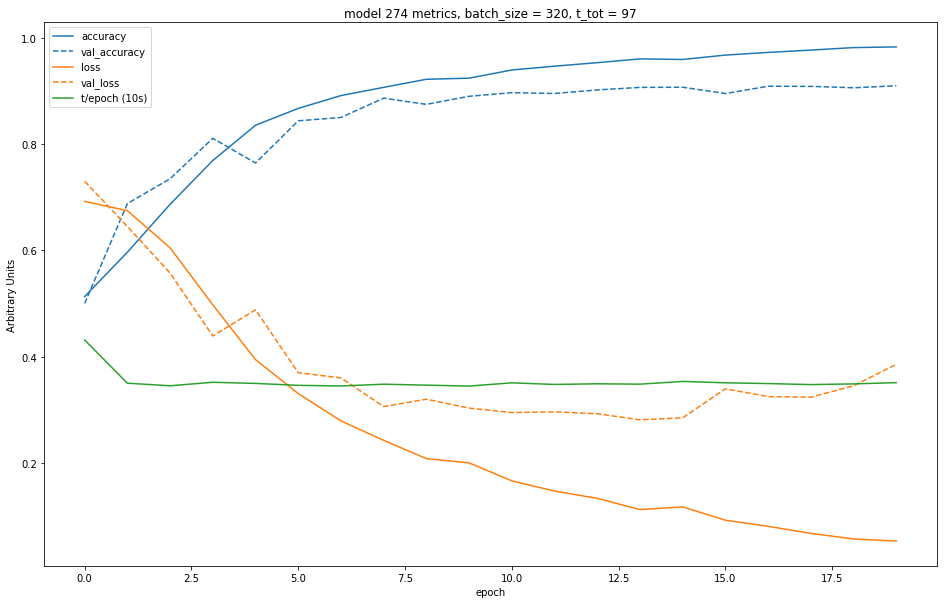

Creating model 275...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


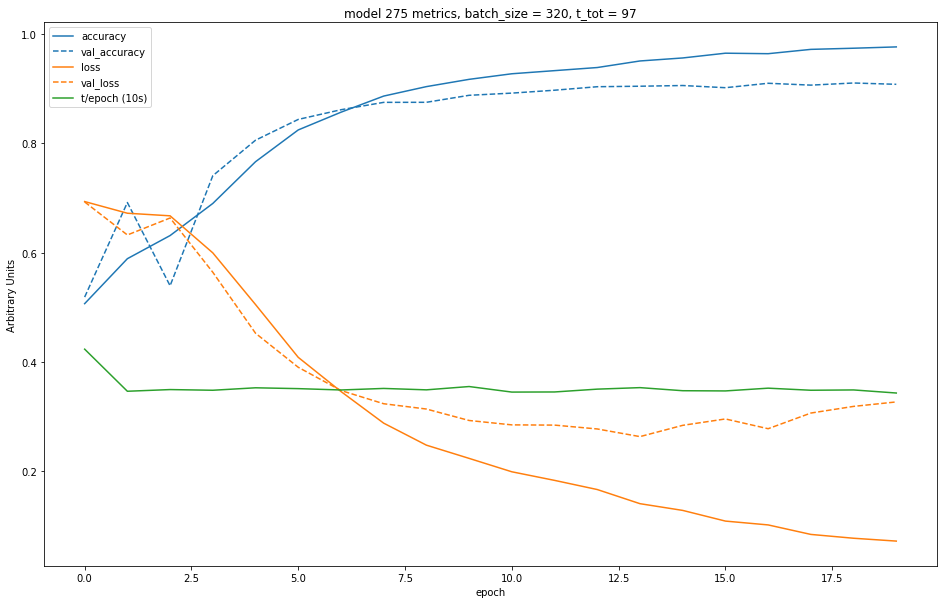

Creating model 276...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


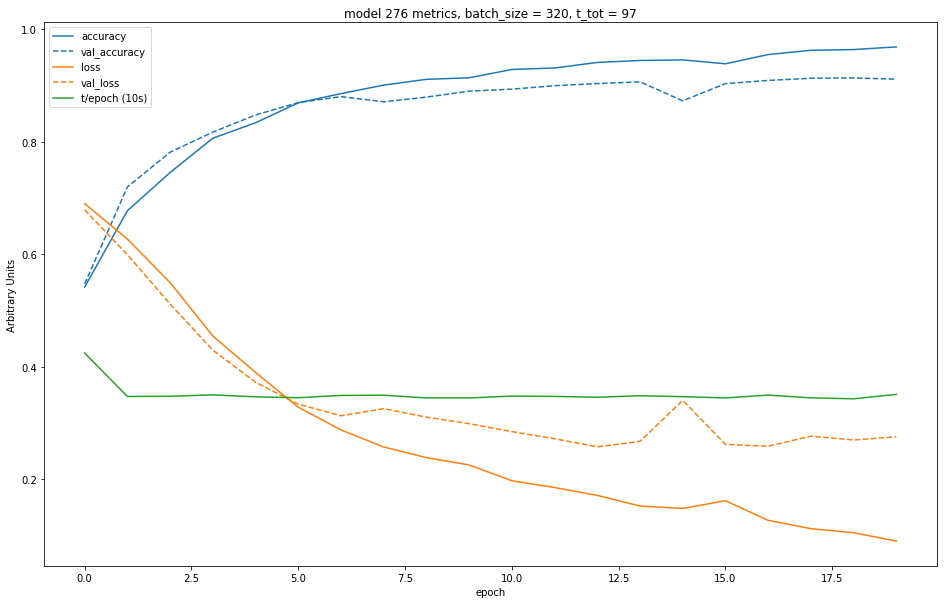

Creating model 277...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


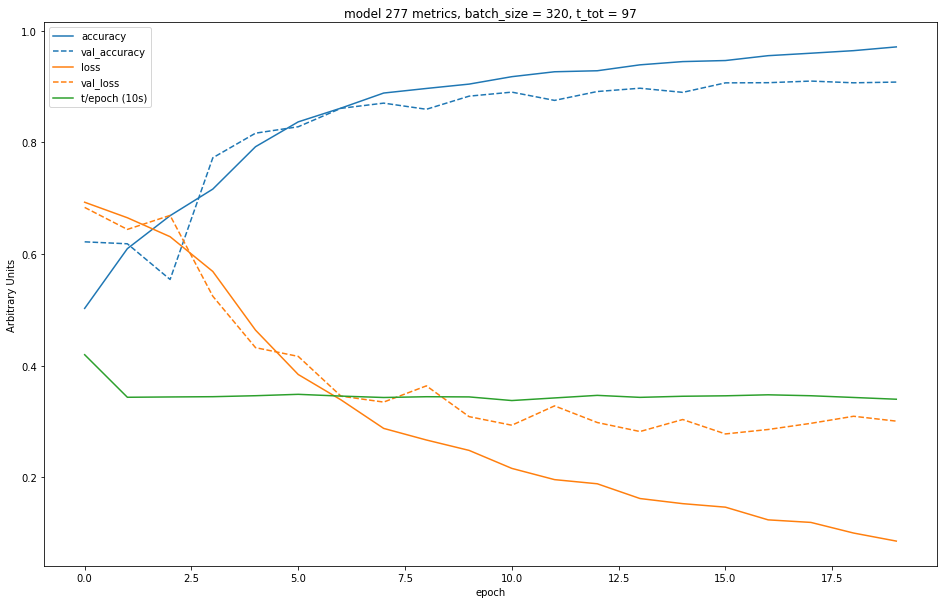

Creating model 278...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


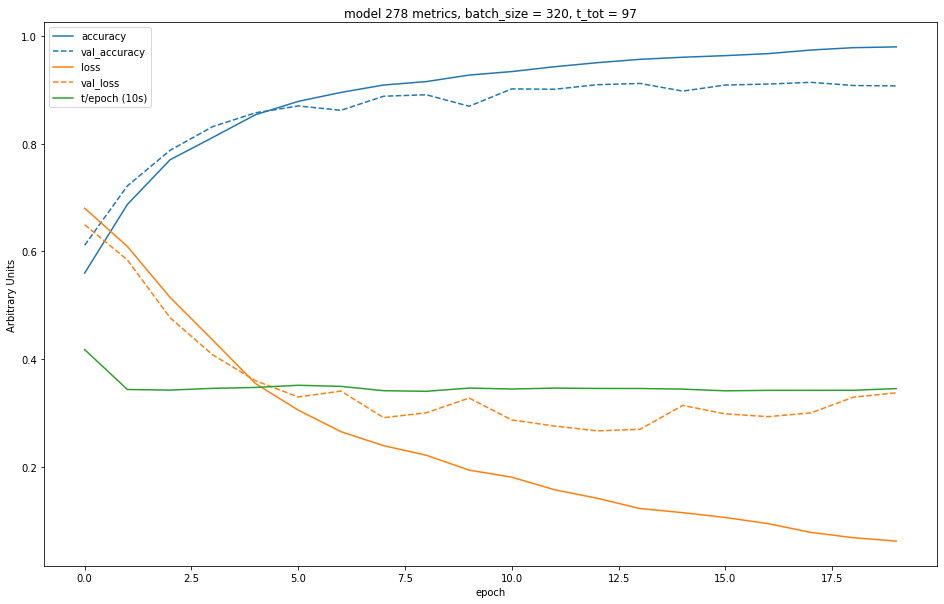

Creating model 279...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


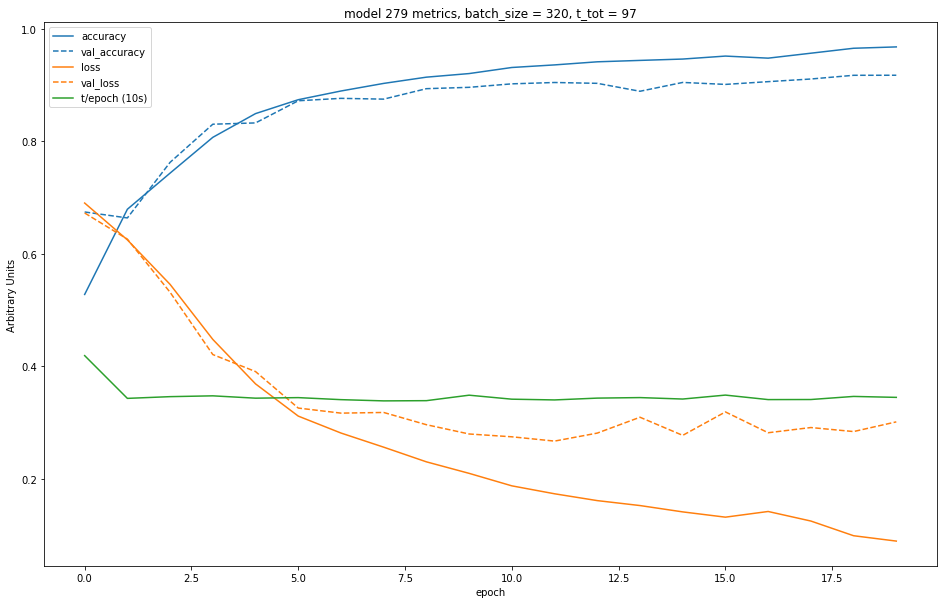

Creating model 280...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


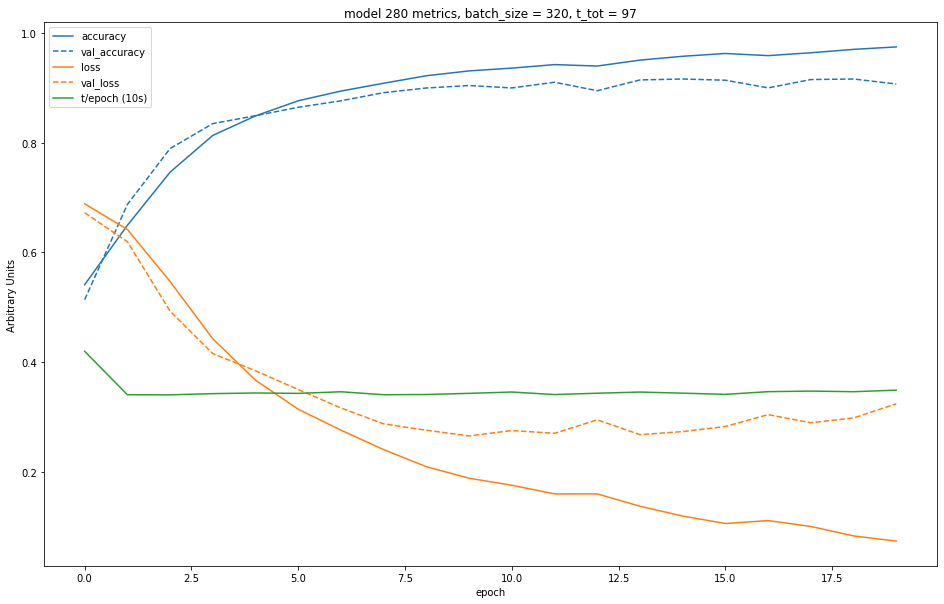

Creating model 281...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


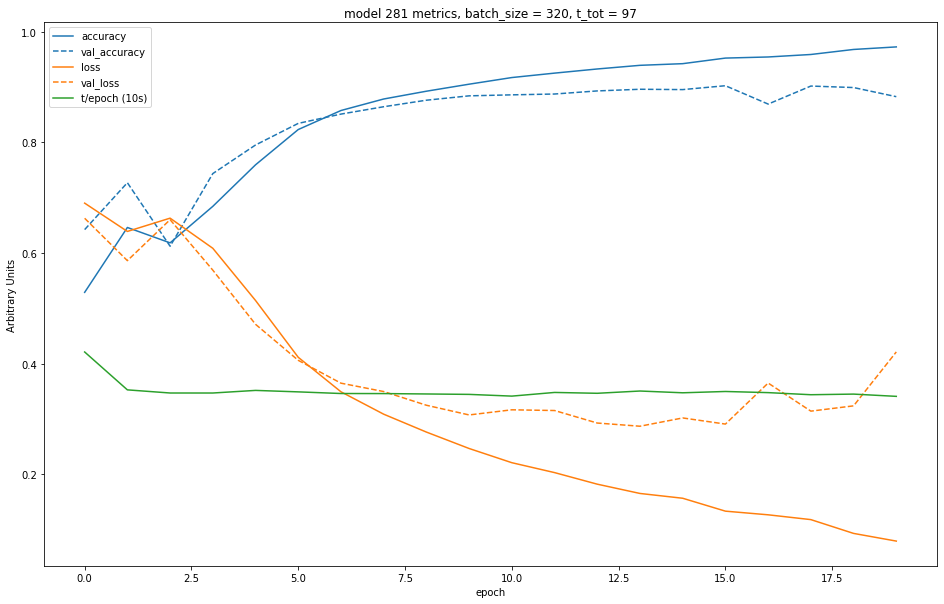

Creating model 282...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


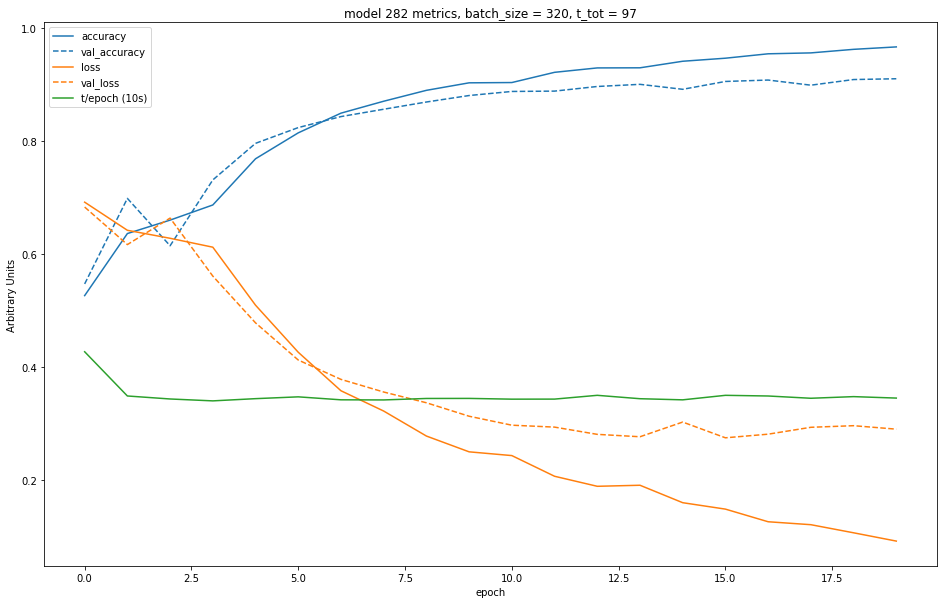

Creating model 283...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


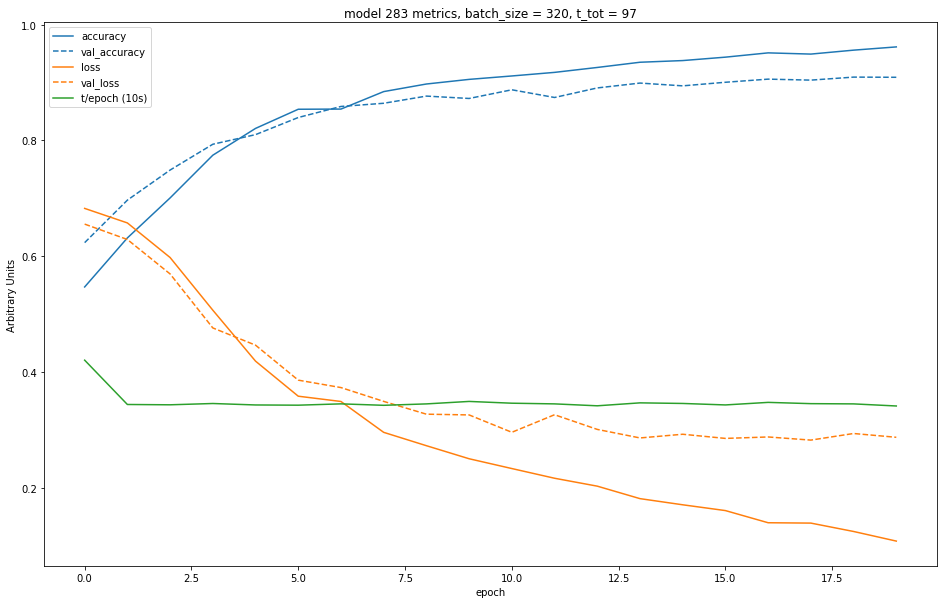

Creating model 284...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


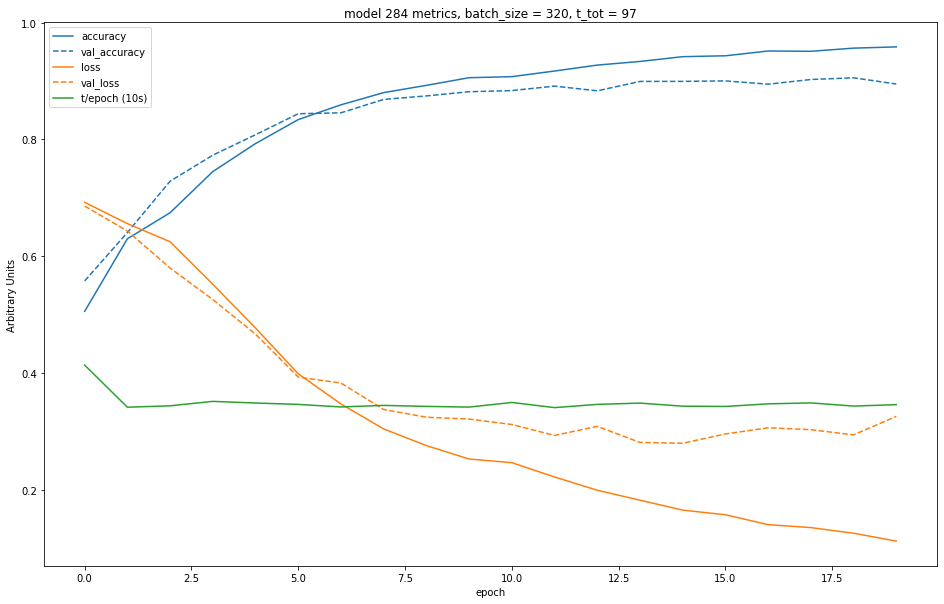

Creating model 285...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


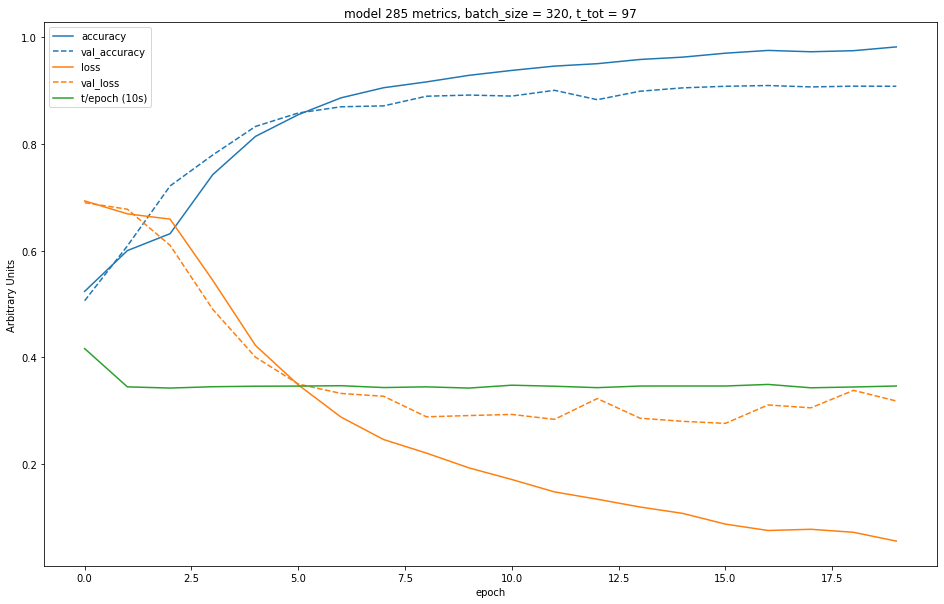

Creating model 286...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


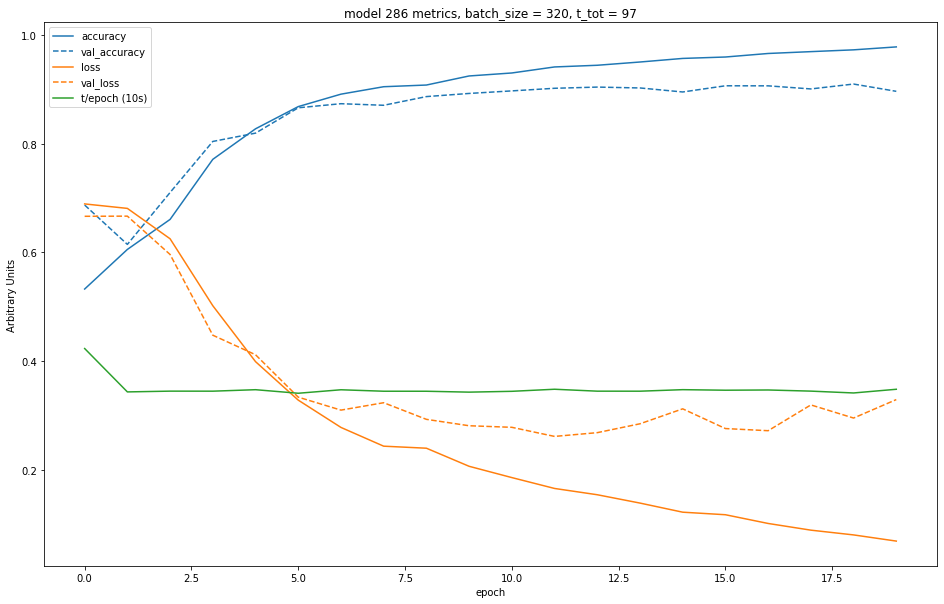

Creating model 287...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


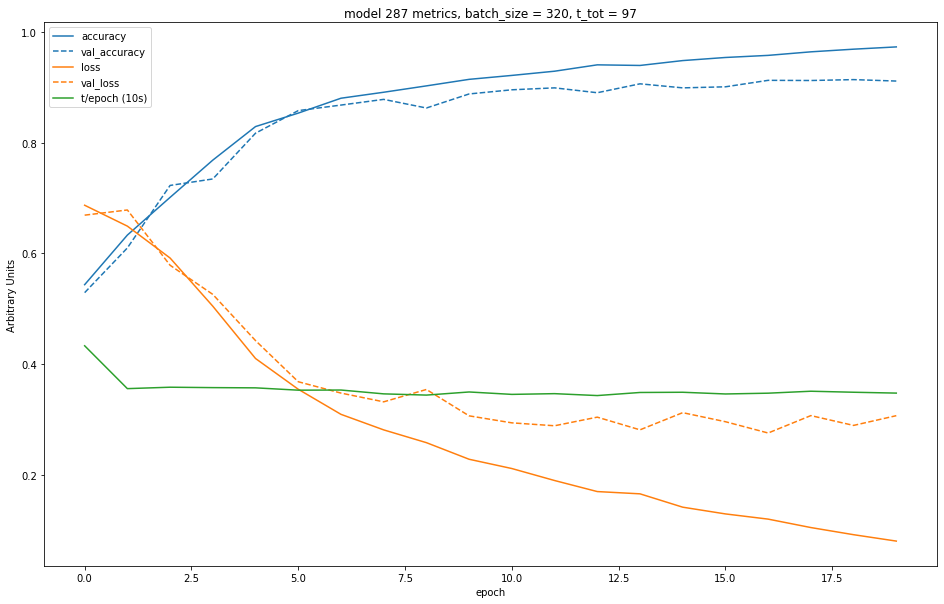

Creating model 288...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


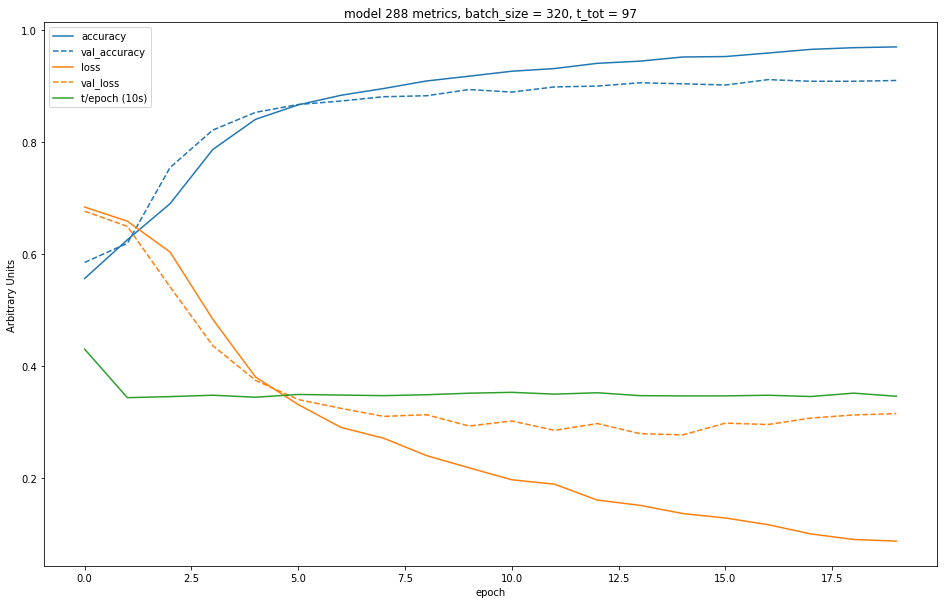

Creating model 289...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


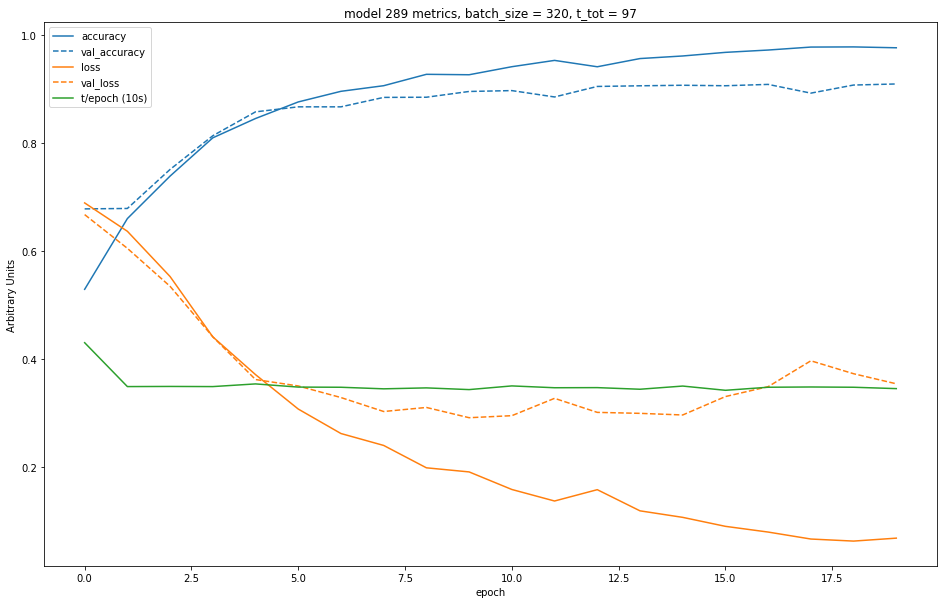

Creating model 290...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


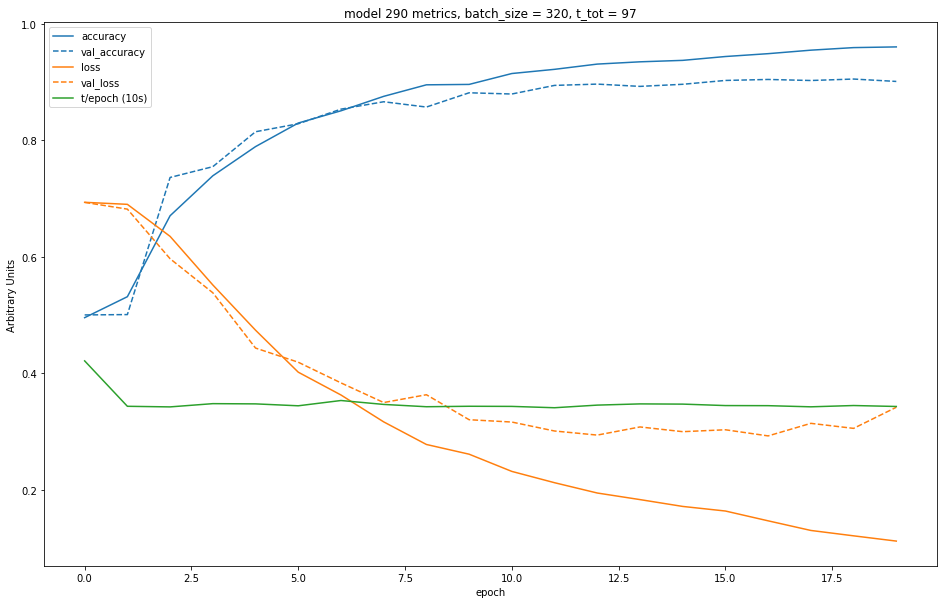

Creating model 291...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


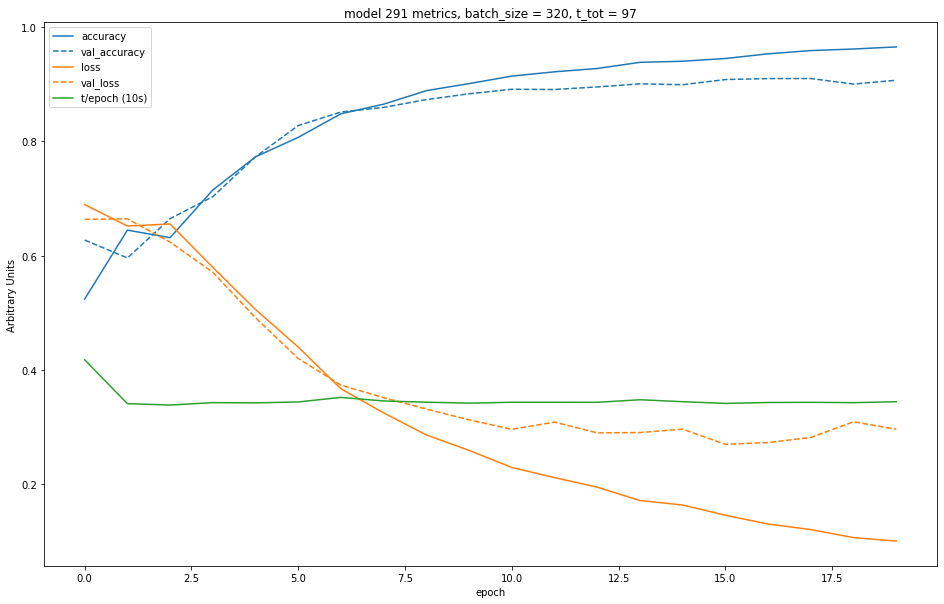

Creating model 292...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


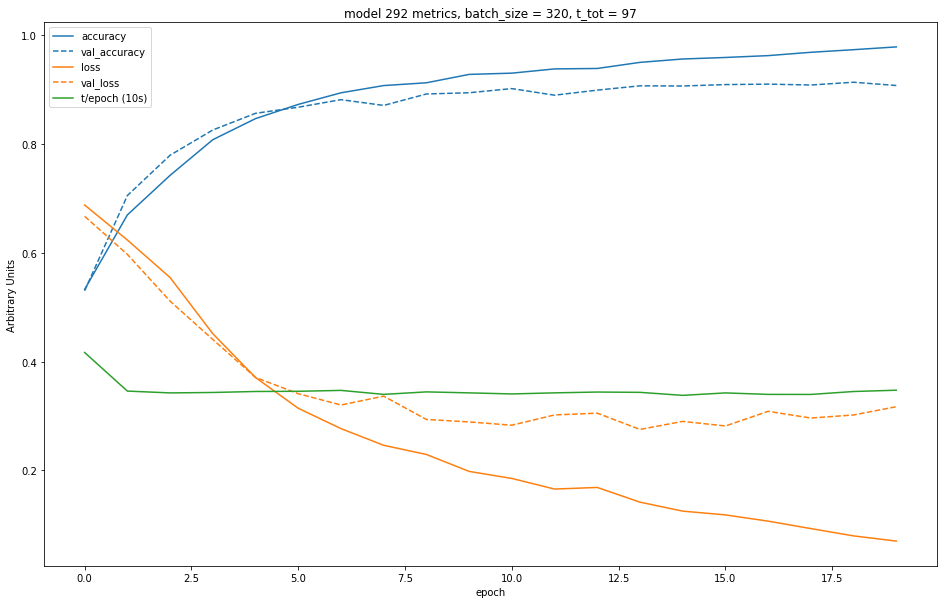

Creating model 293...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


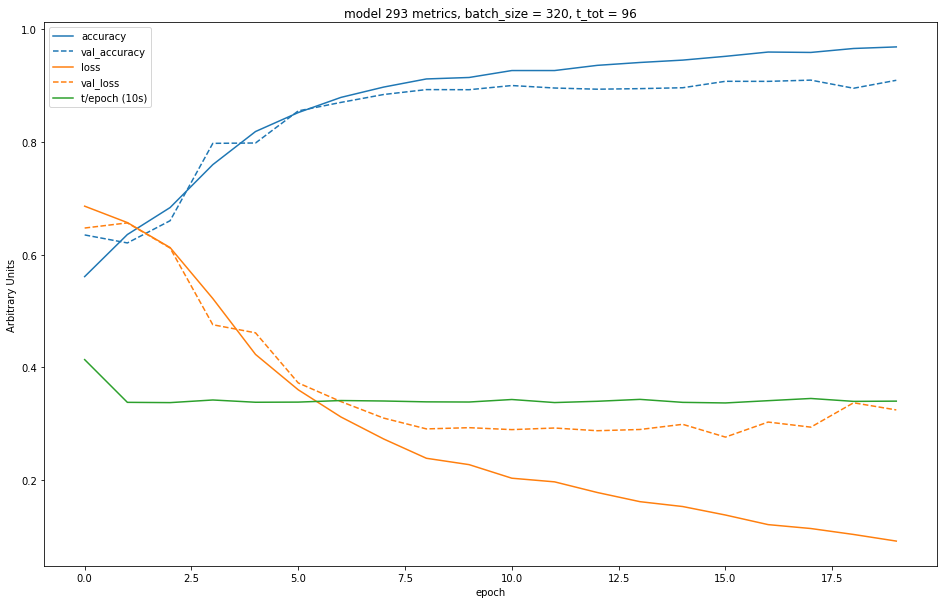

Creating model 294...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


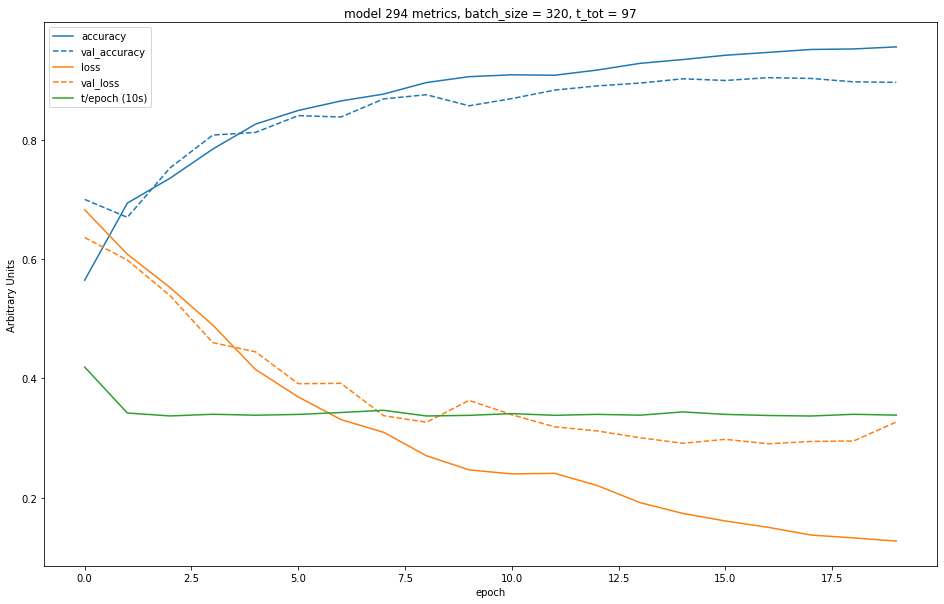

Creating model 295...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


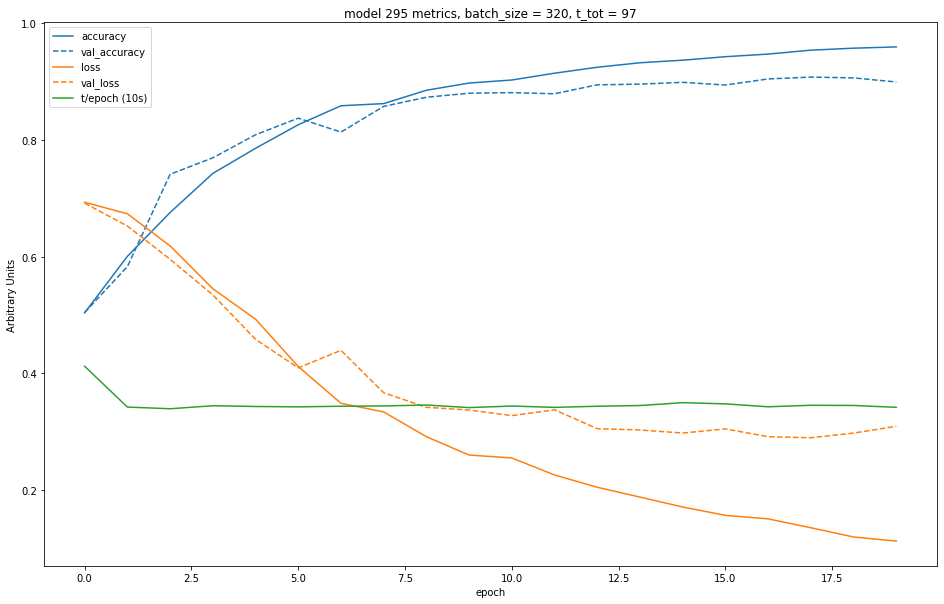

Creating model 296...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


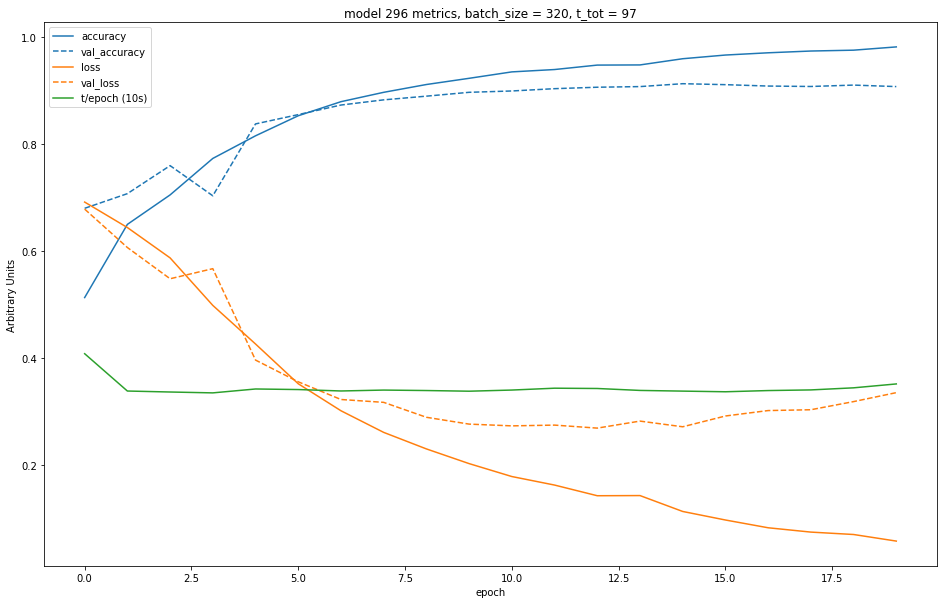

Creating model 297...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


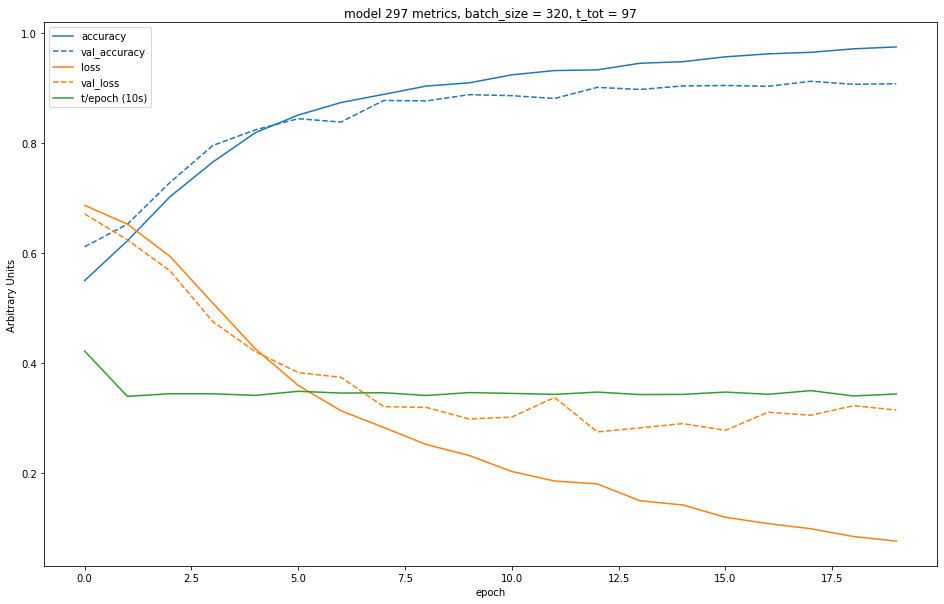

Creating model 298...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


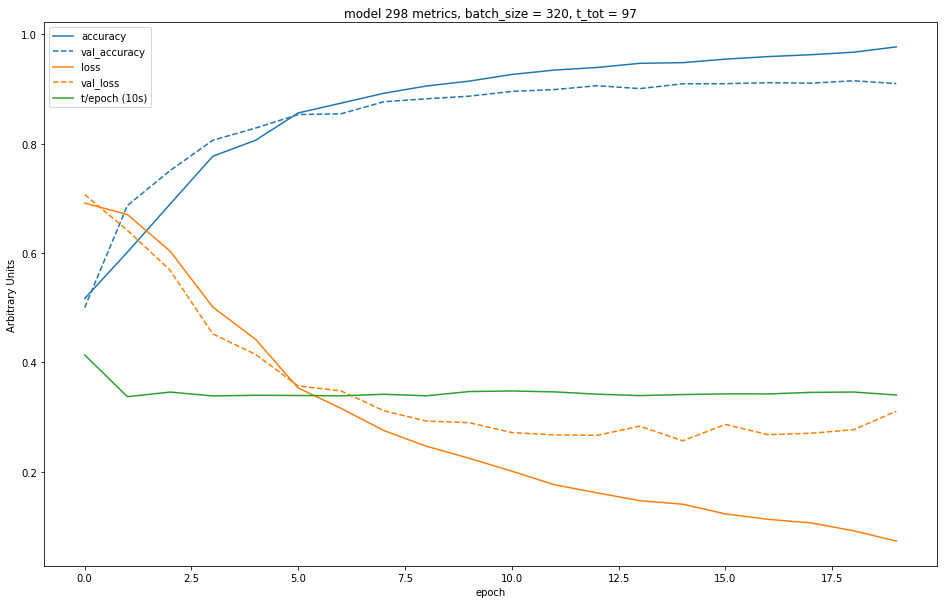

Creating model 299...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


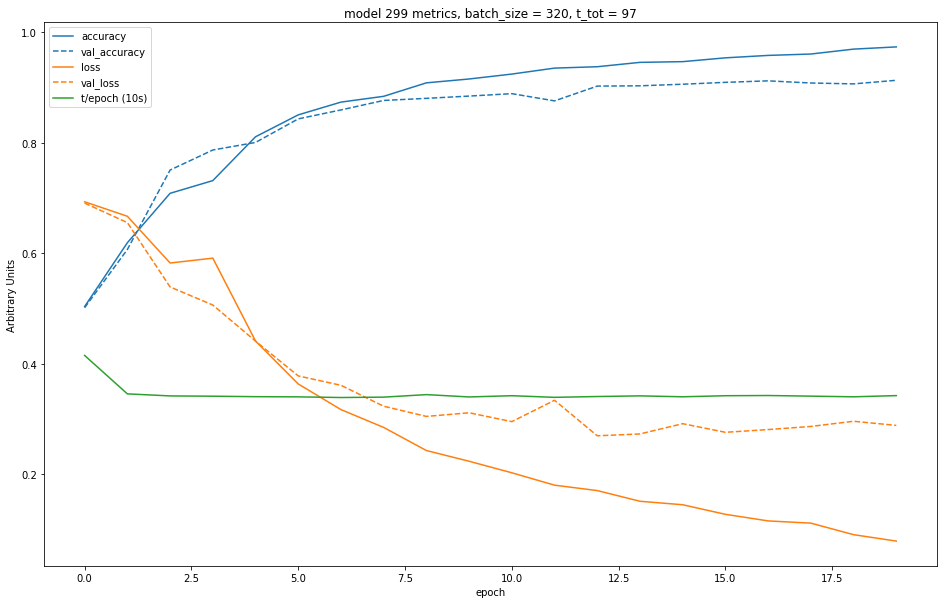

Creating model 300...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


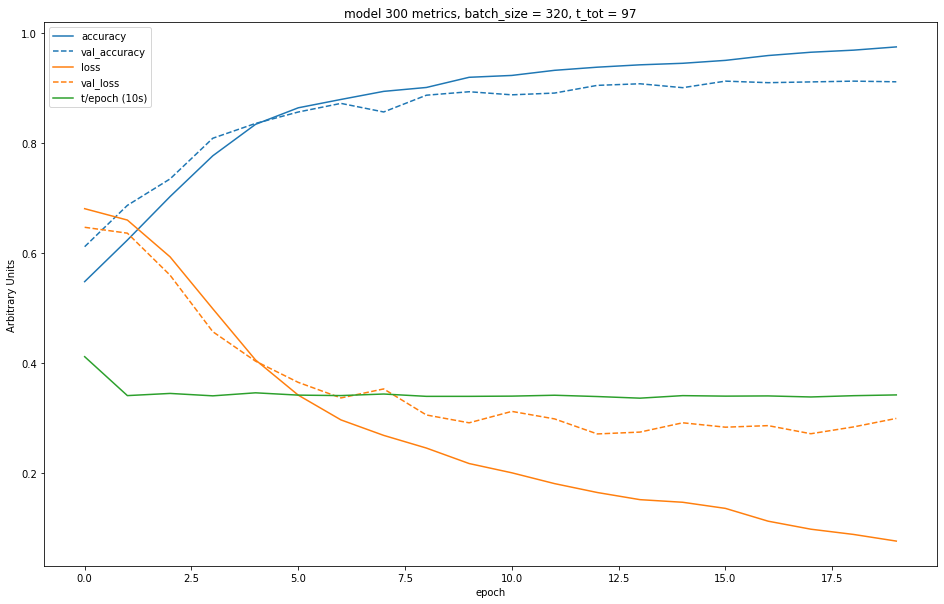

Creating model 301...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


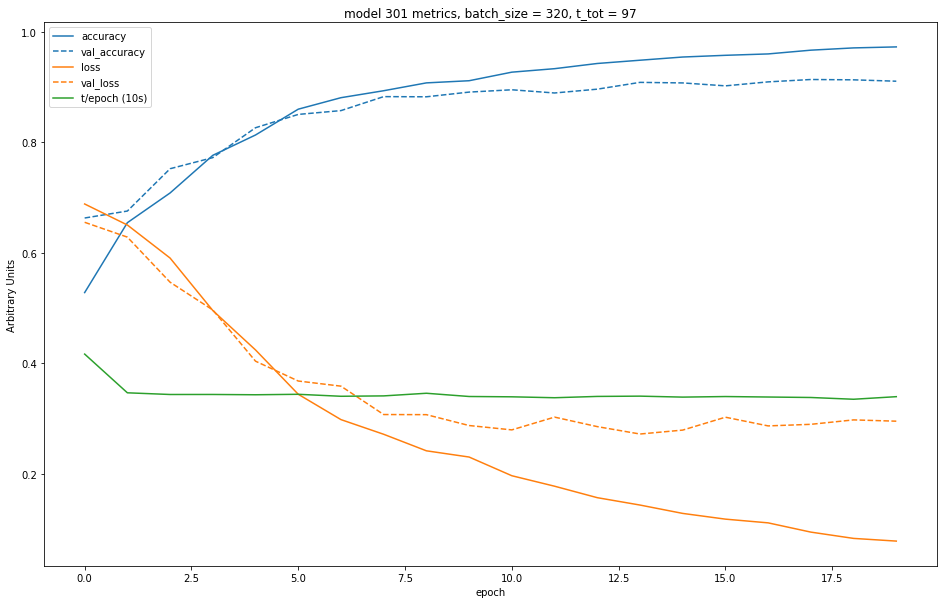

Creating model 302...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


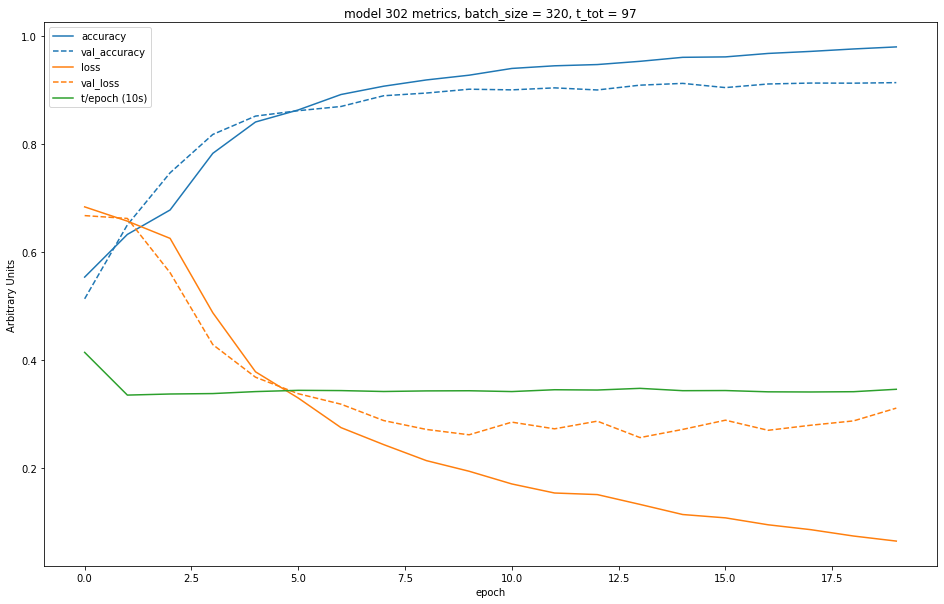

Creating model 303...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


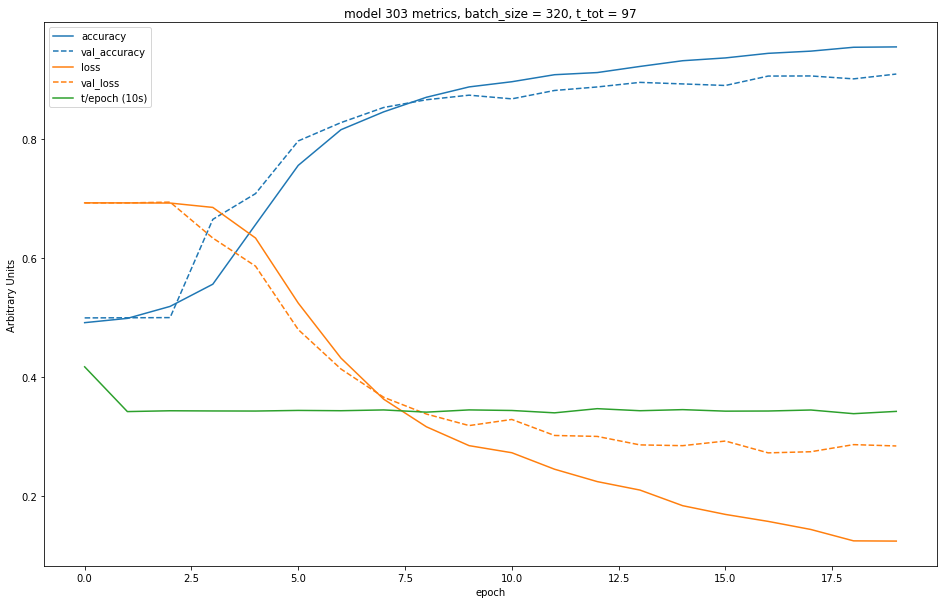

Creating model 304...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


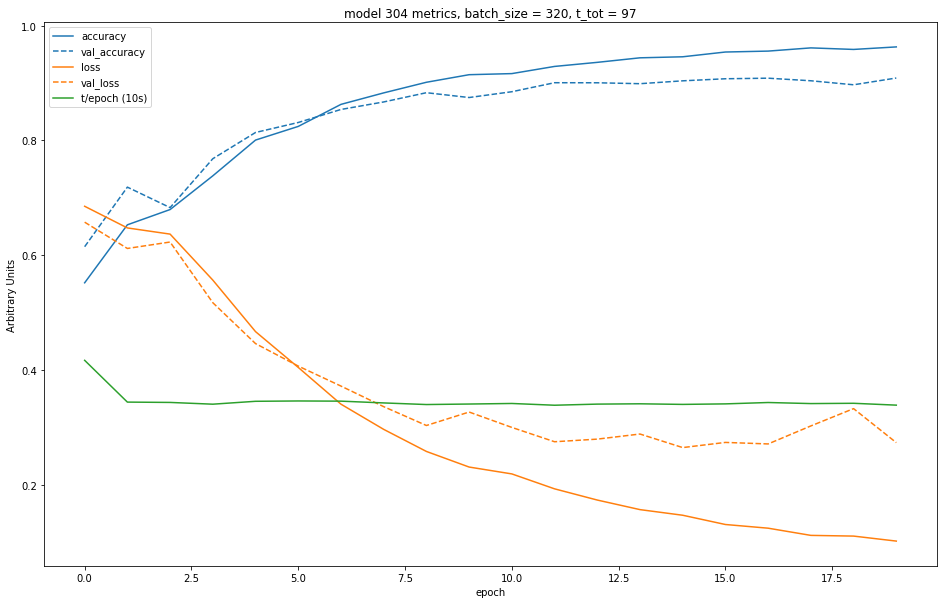

Creating model 305...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


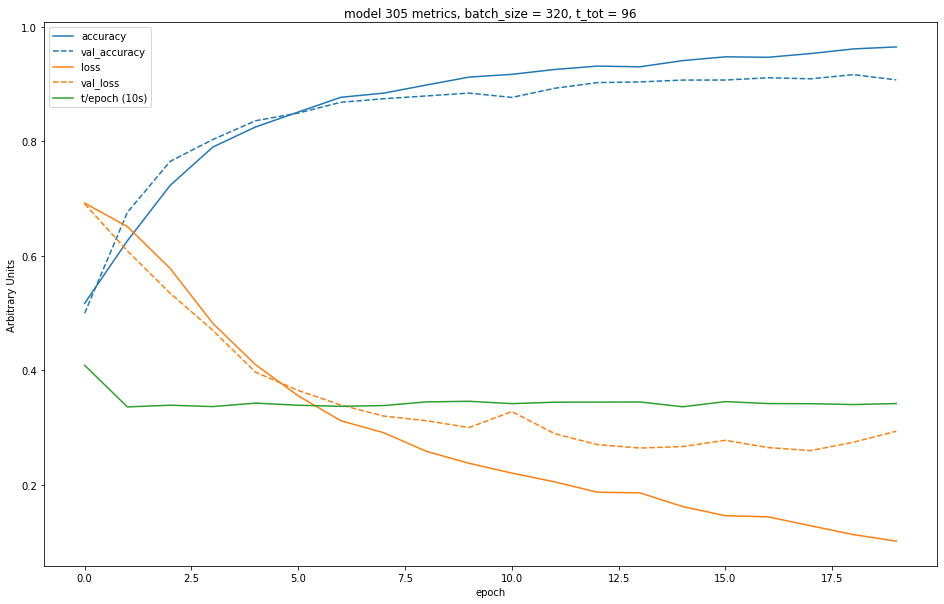

Creating model 306...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


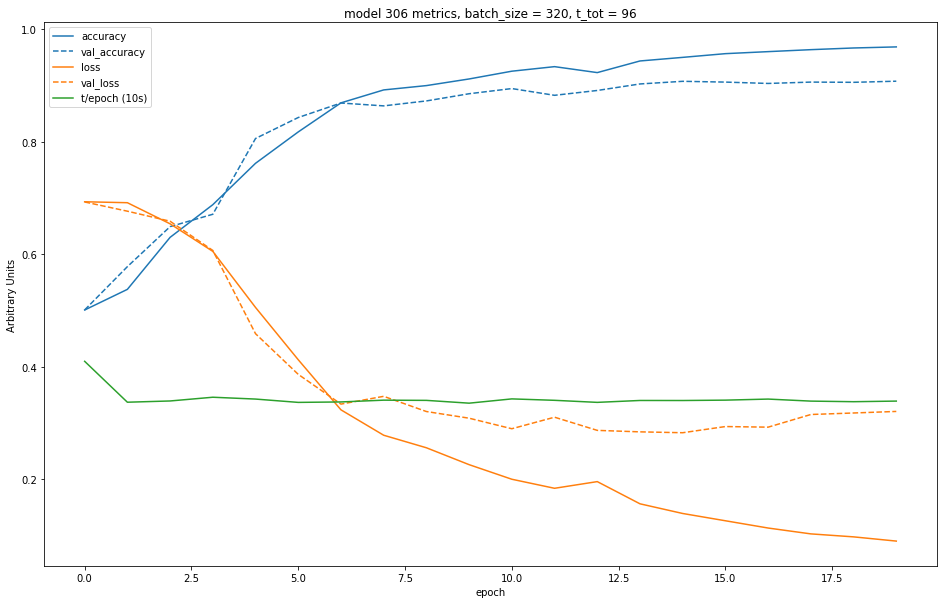

Creating model 307...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


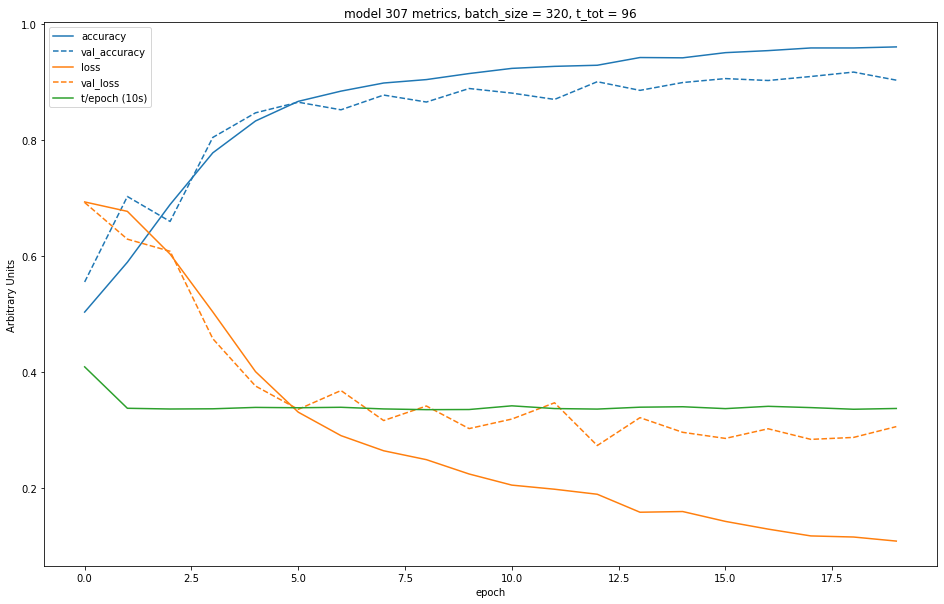

Creating model 308...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


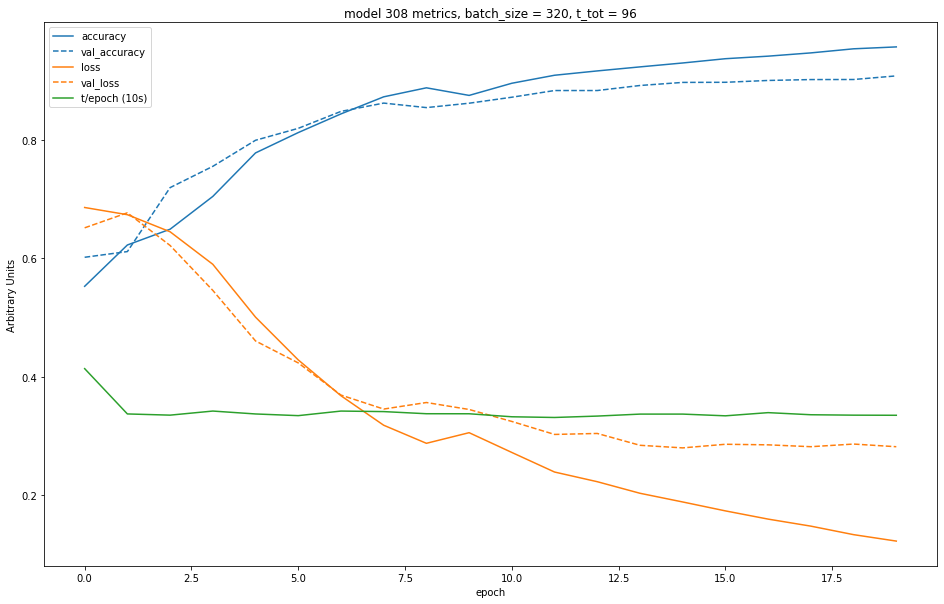

Creating model 309...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


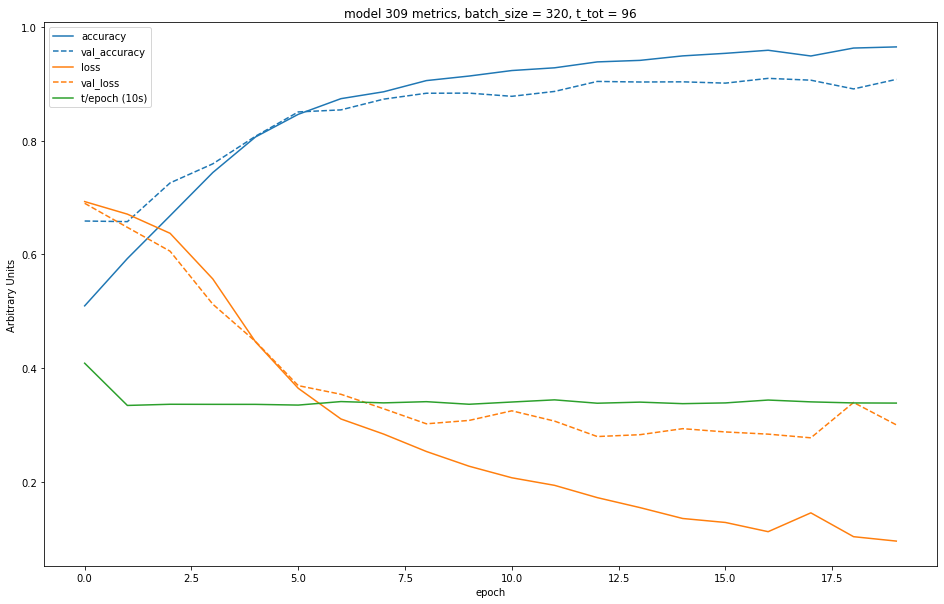

Creating model 310...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


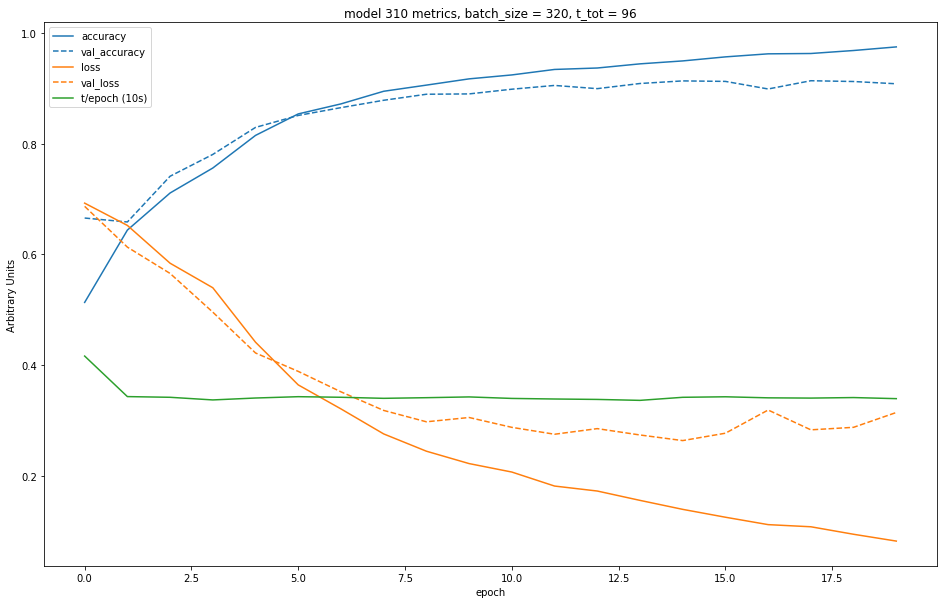

Creating model 311...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


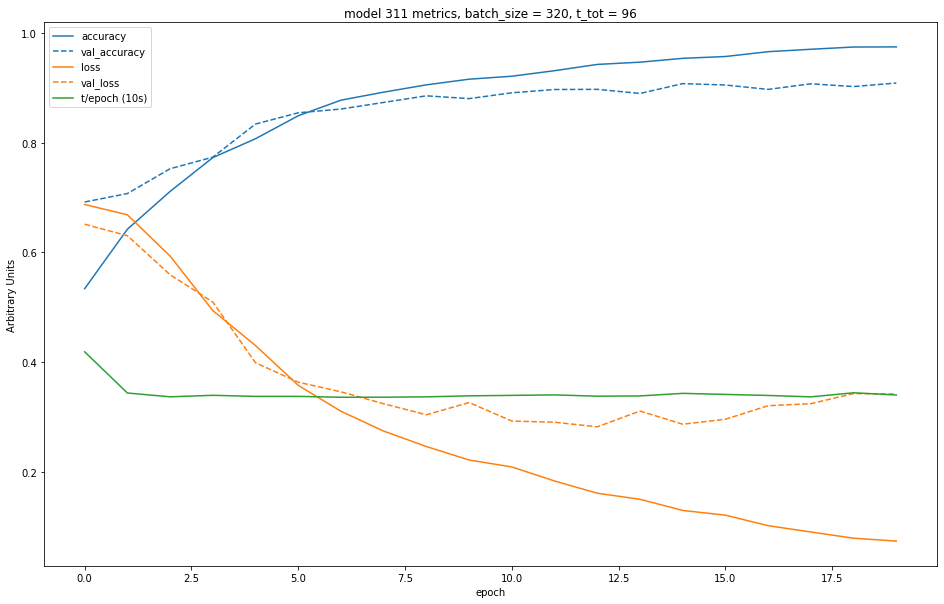

Creating model 312...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


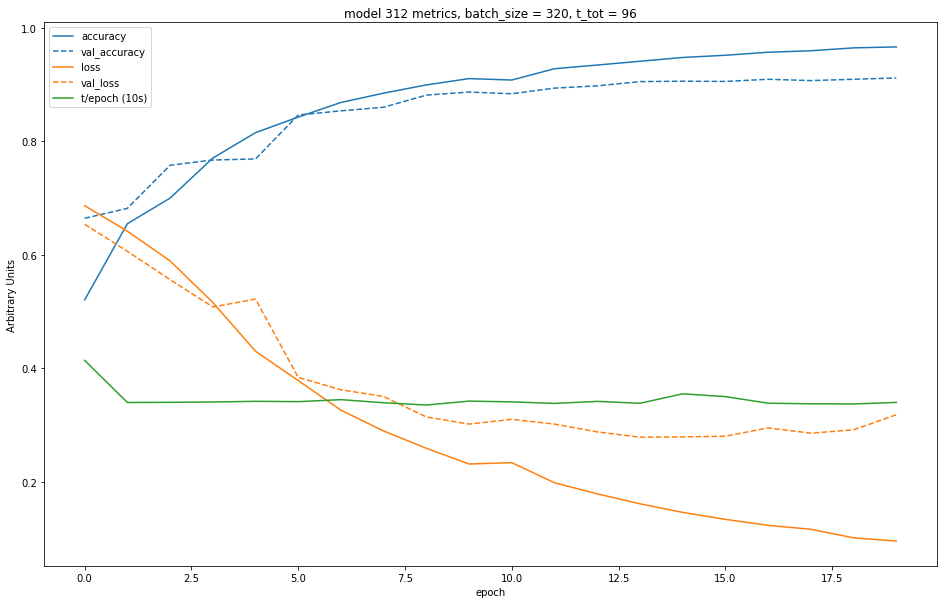

Creating model 313...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


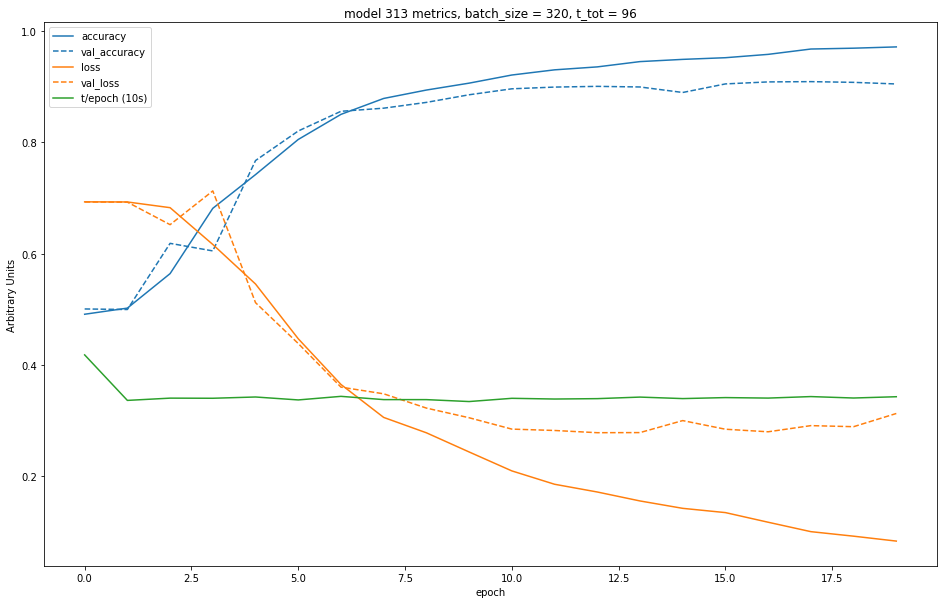

Creating model 314...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


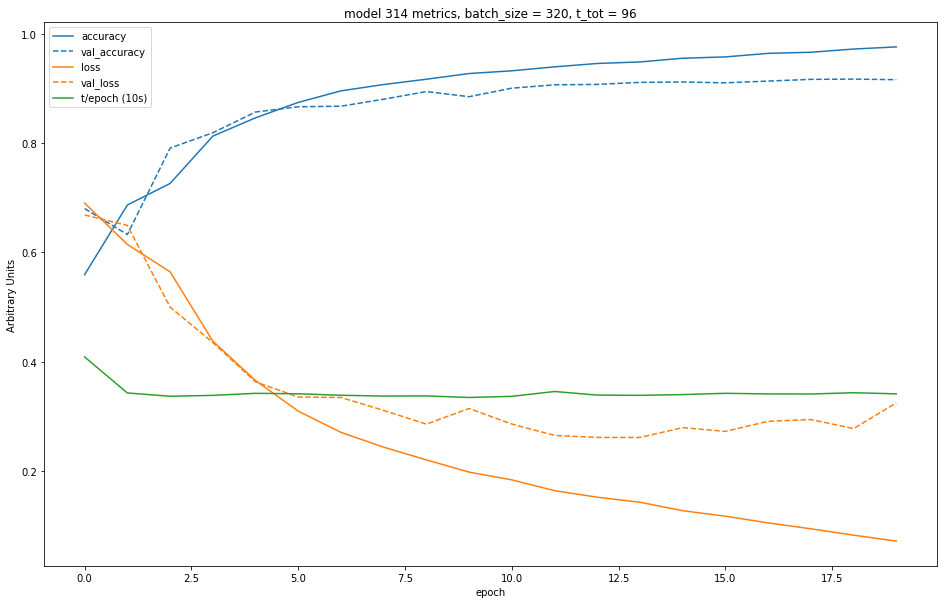

Creating model 315...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


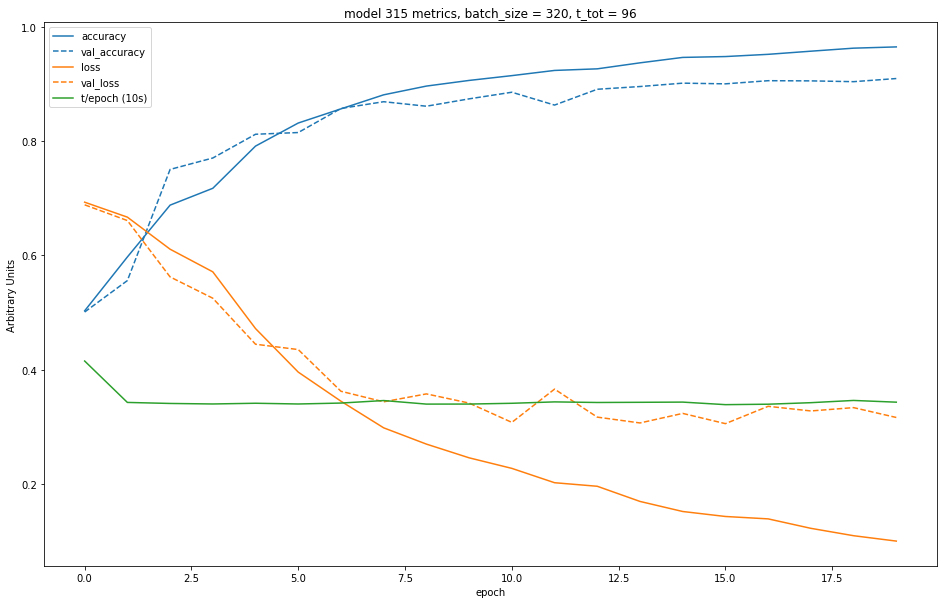

Creating model 316...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


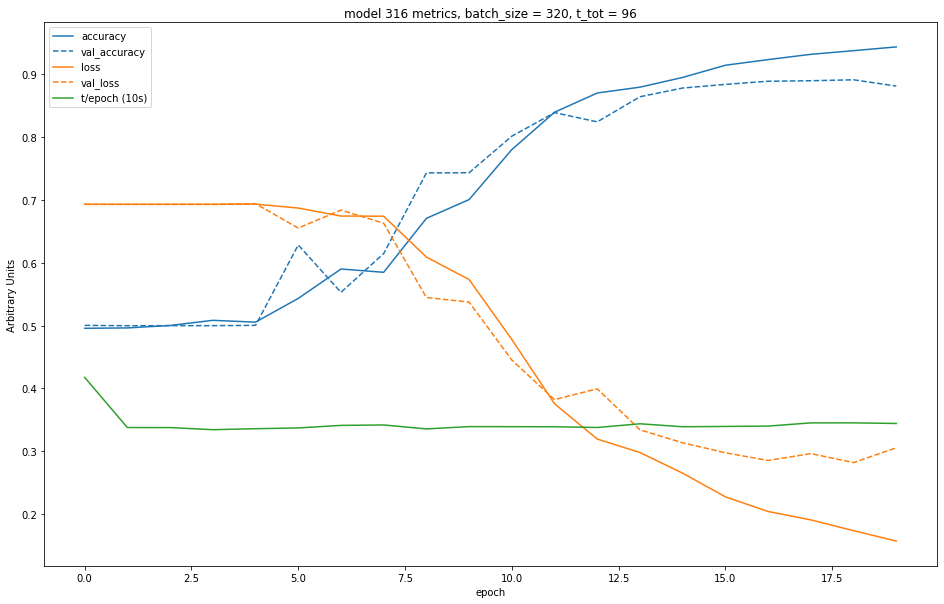

Creating model 317...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


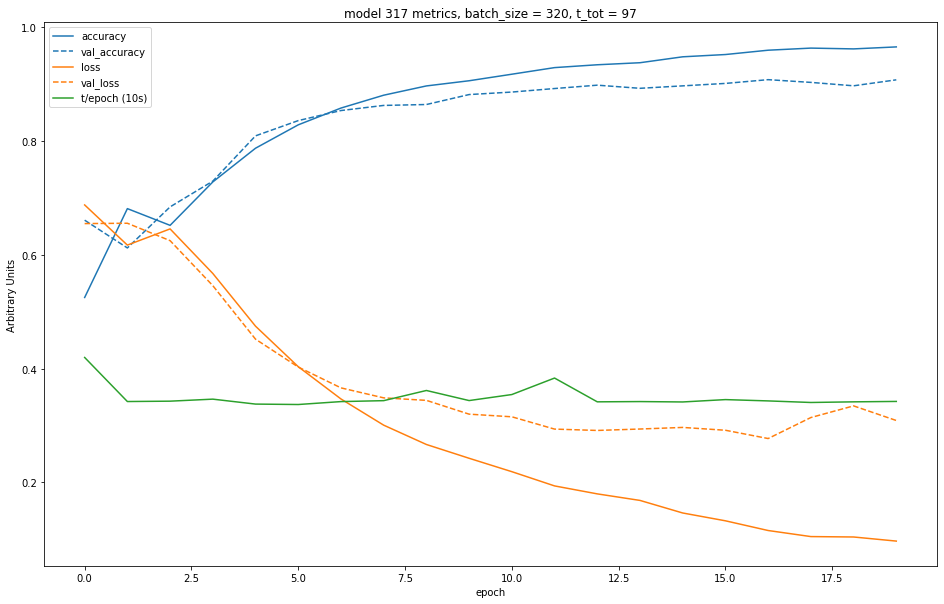

Creating model 318...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


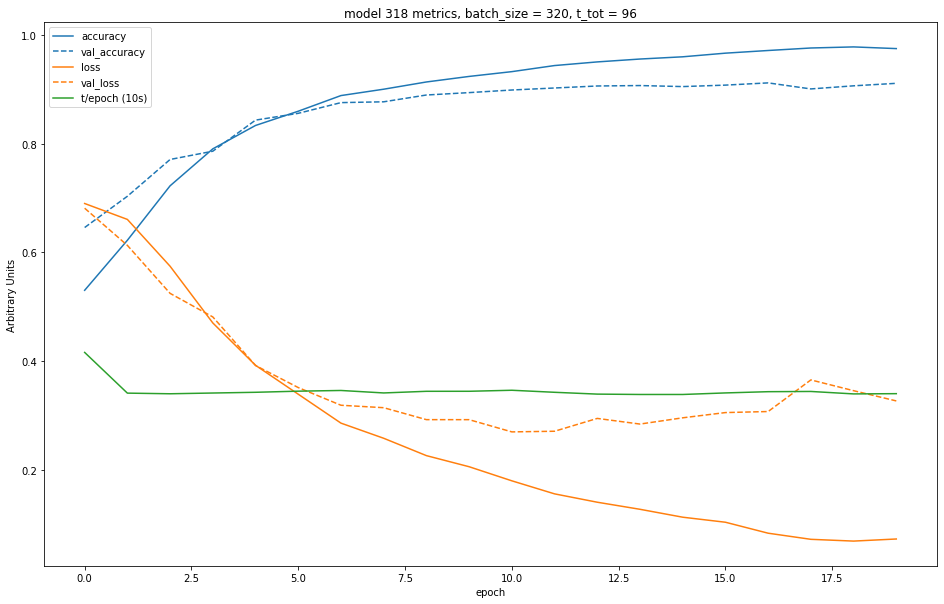

Creating model 319...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


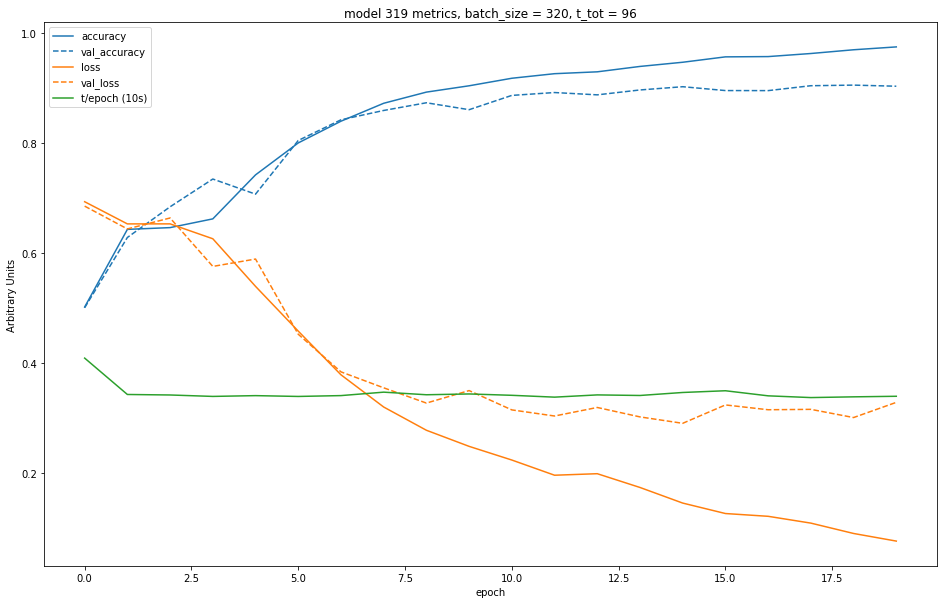

Creating model 320...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


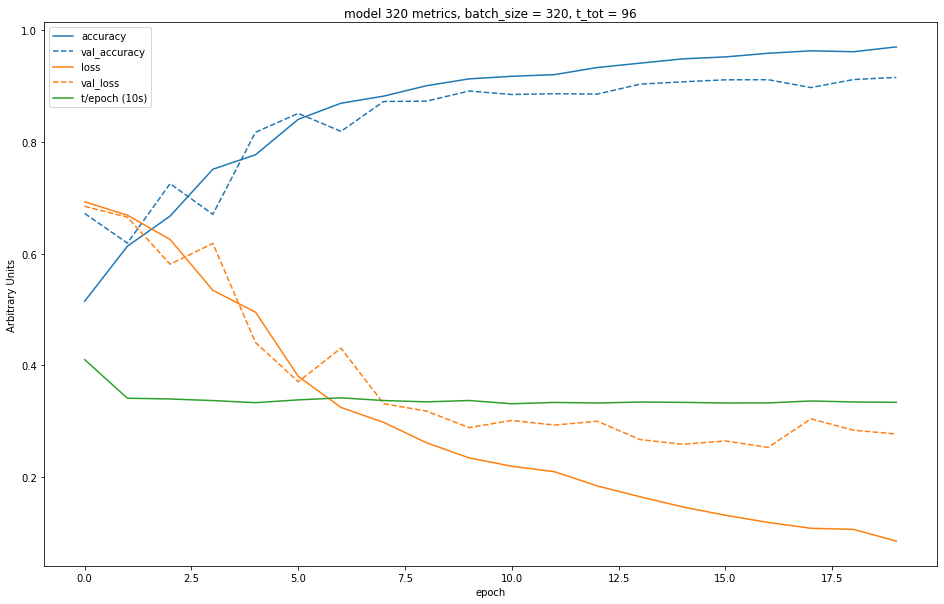

Creating model 321...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


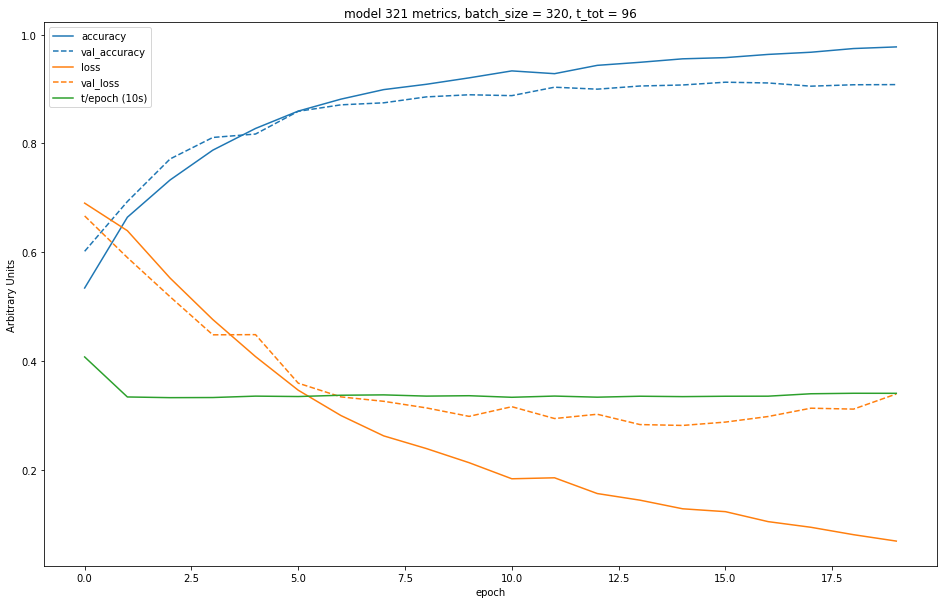

Creating model 322...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


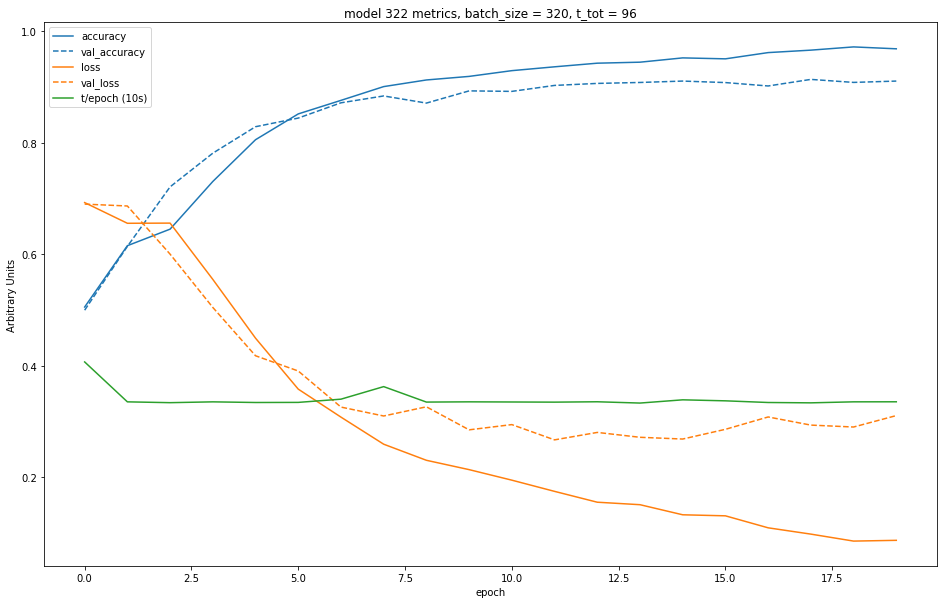

Creating model 323...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


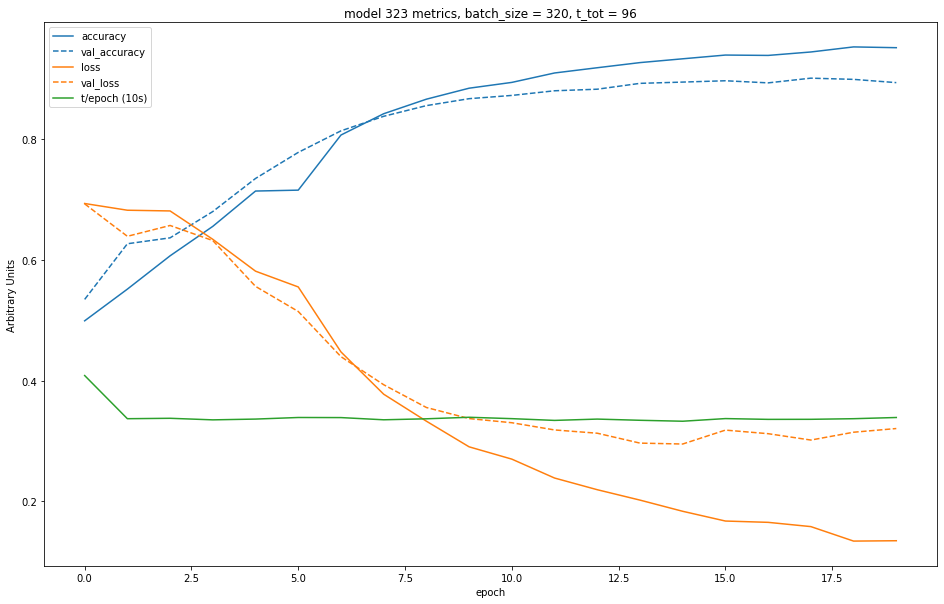

Creating model 324...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


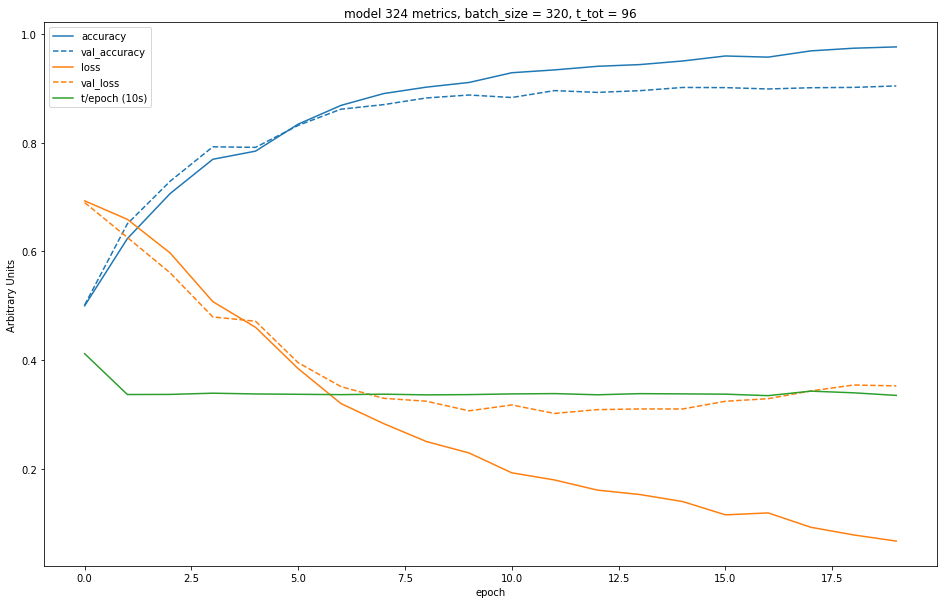

Creating model 325...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


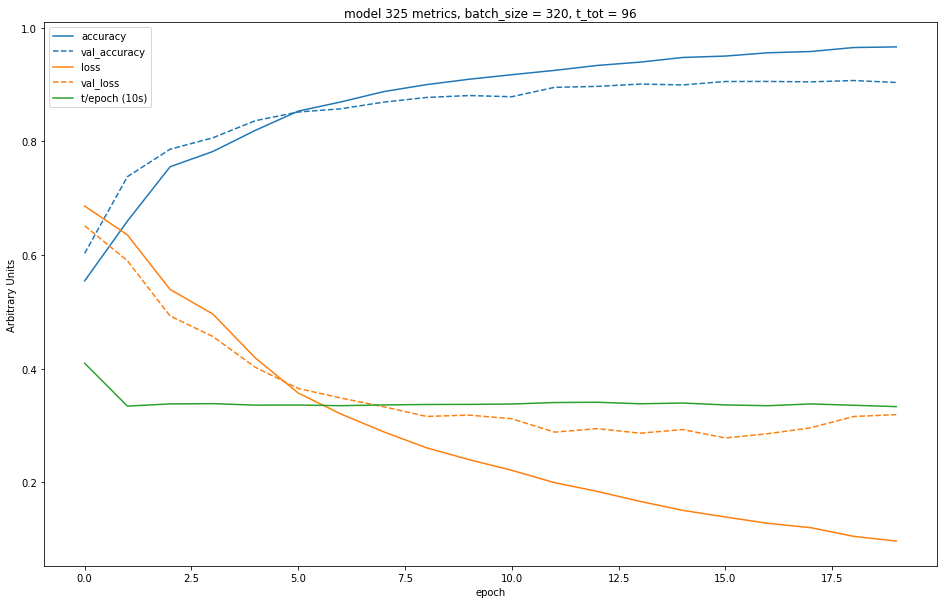

Creating model 326...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


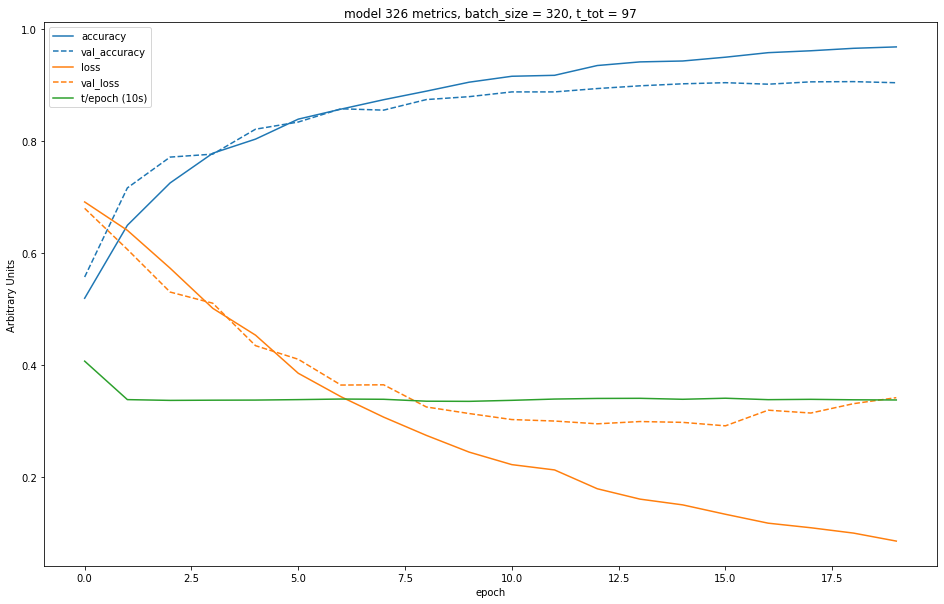

Creating model 327...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


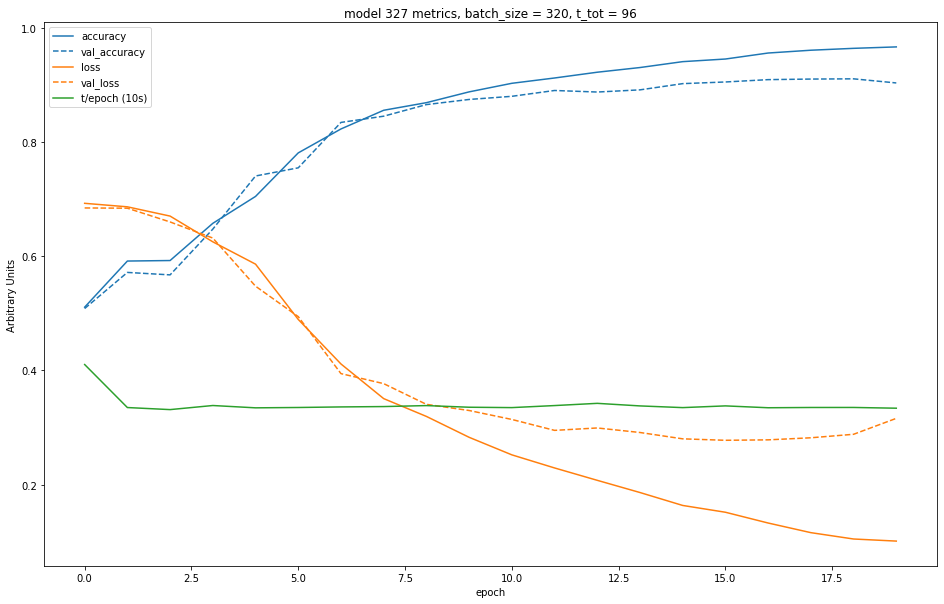

Creating model 328...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


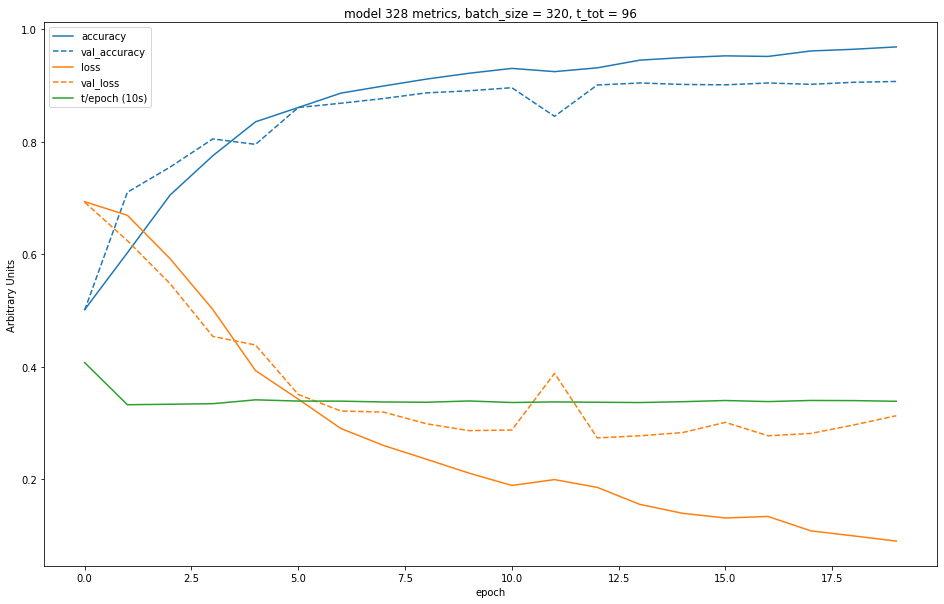

Creating model 329...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


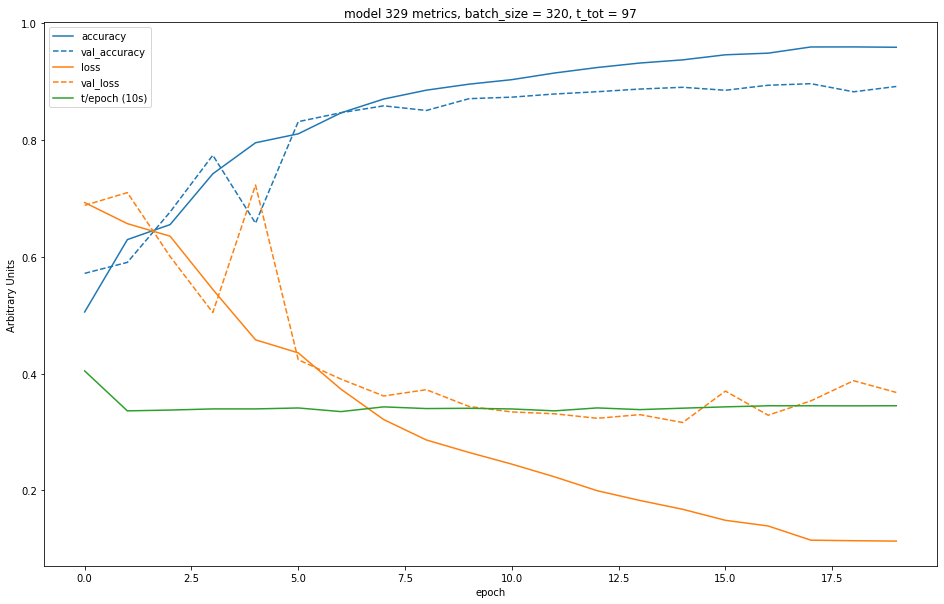

Creating model 330...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


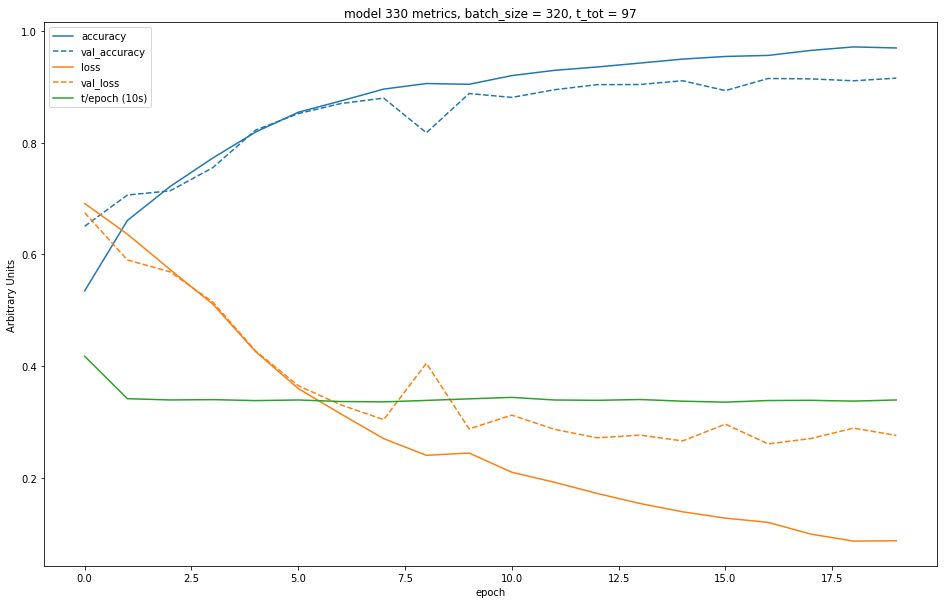

Creating model 331...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


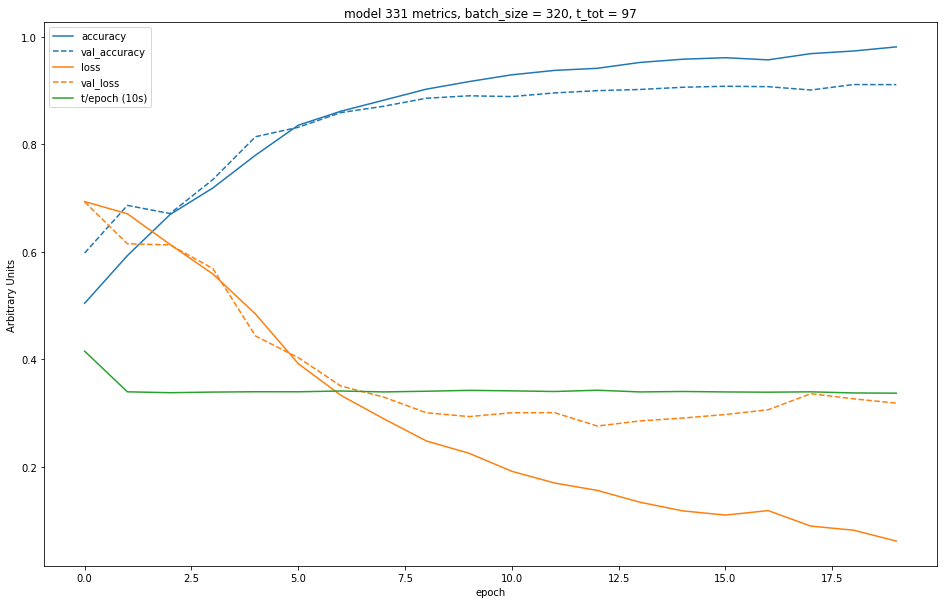

Creating model 332...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


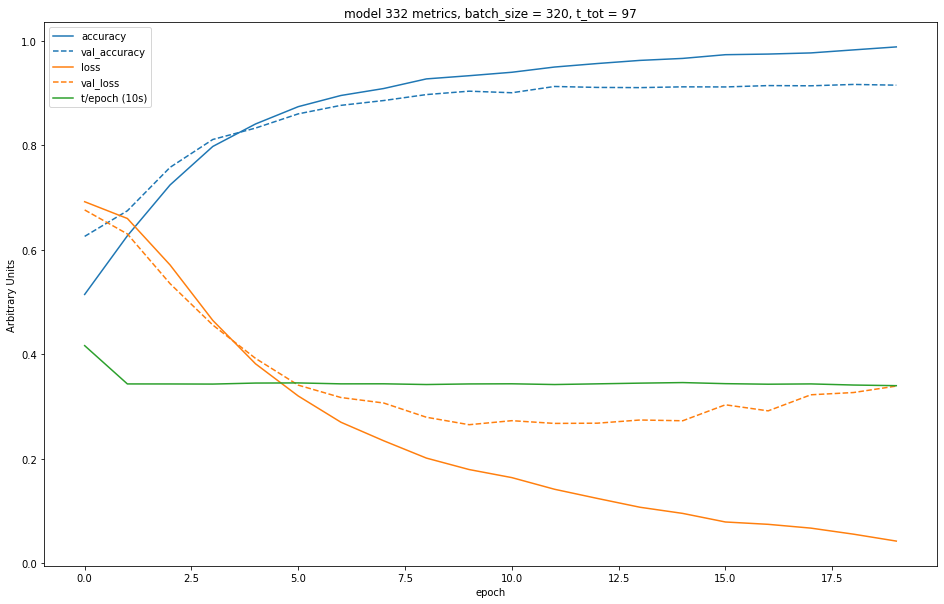

Creating model 333...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


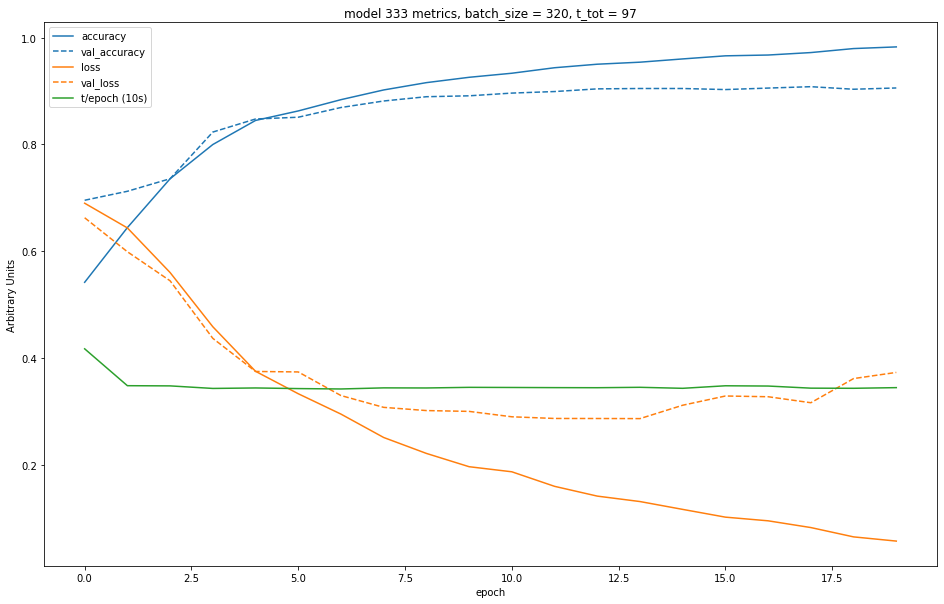

Creating model 334...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


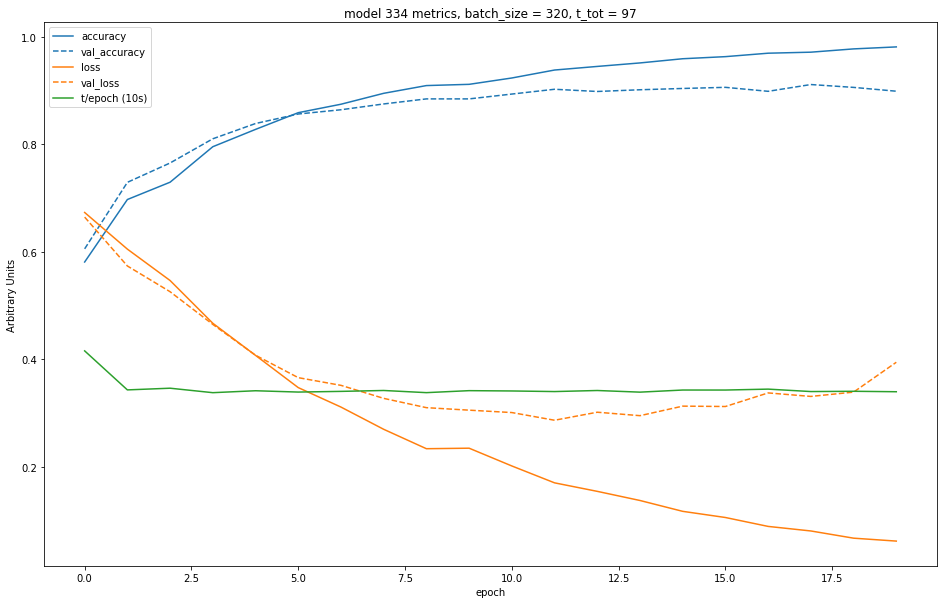

Creating model 335...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


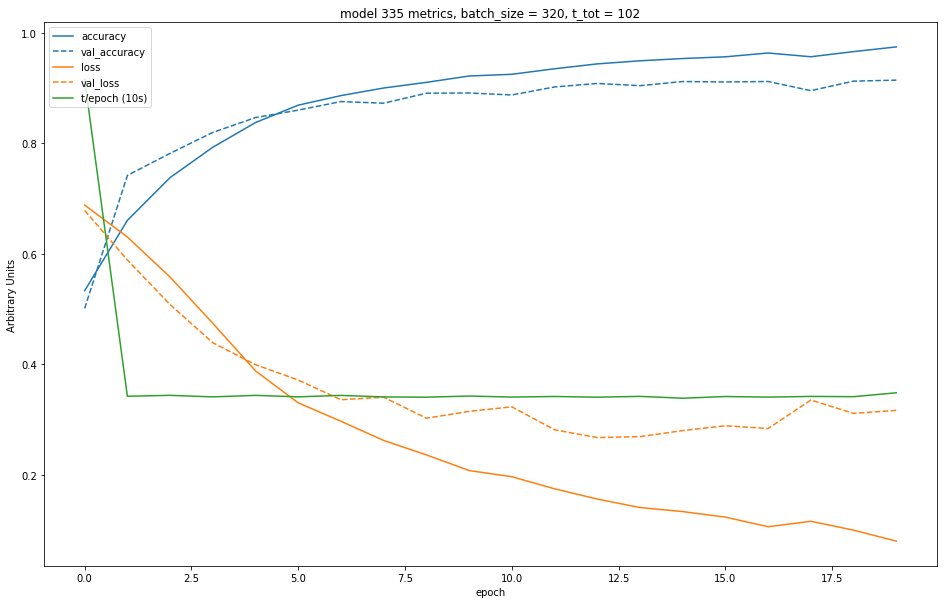

Creating model 336...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


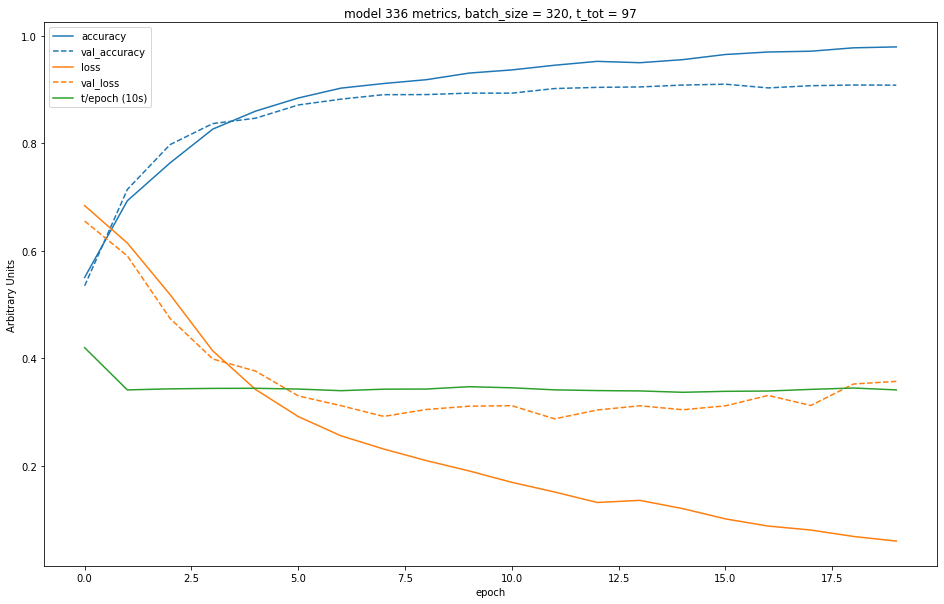

Creating model 337...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


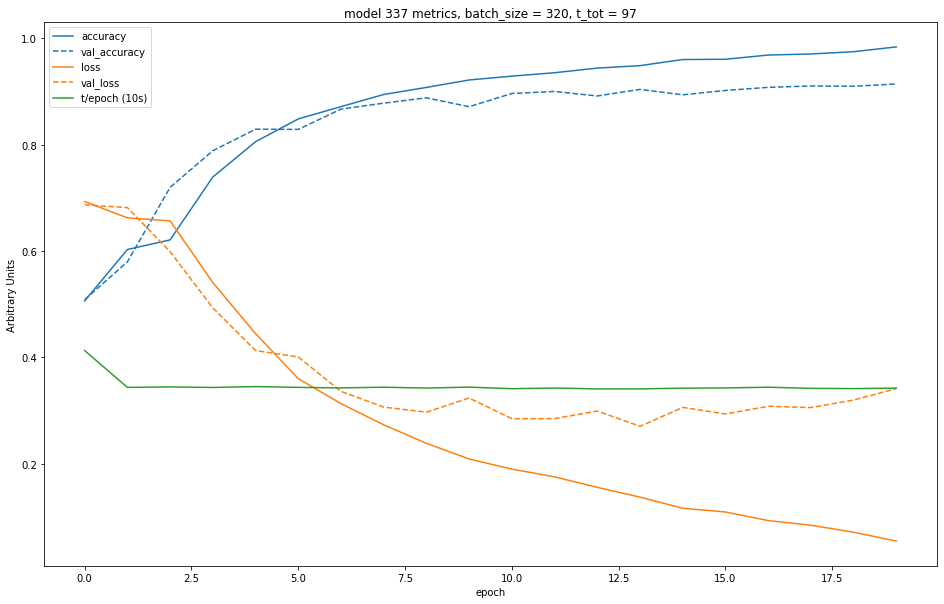

Creating model 338...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


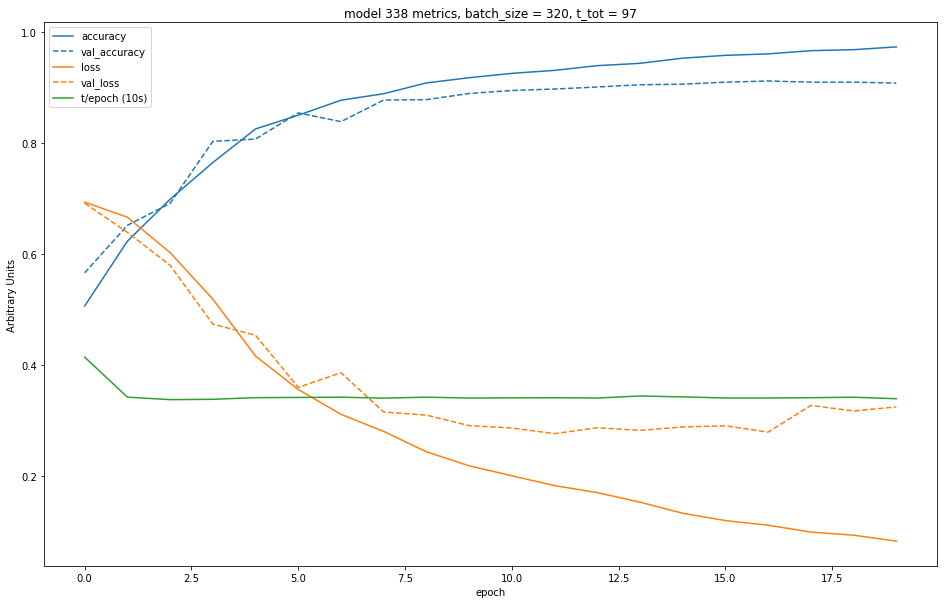

Creating model 339...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


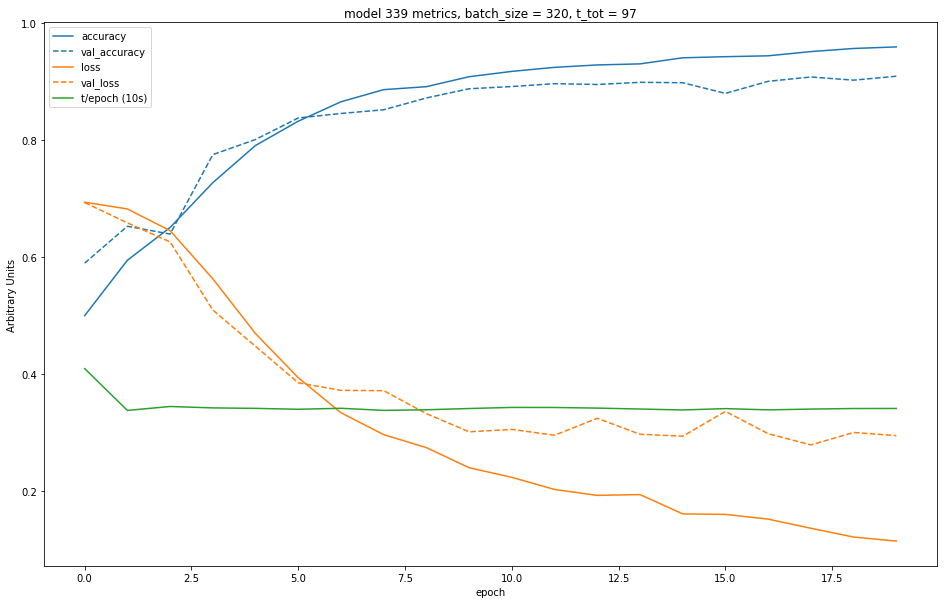

Creating model 340...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


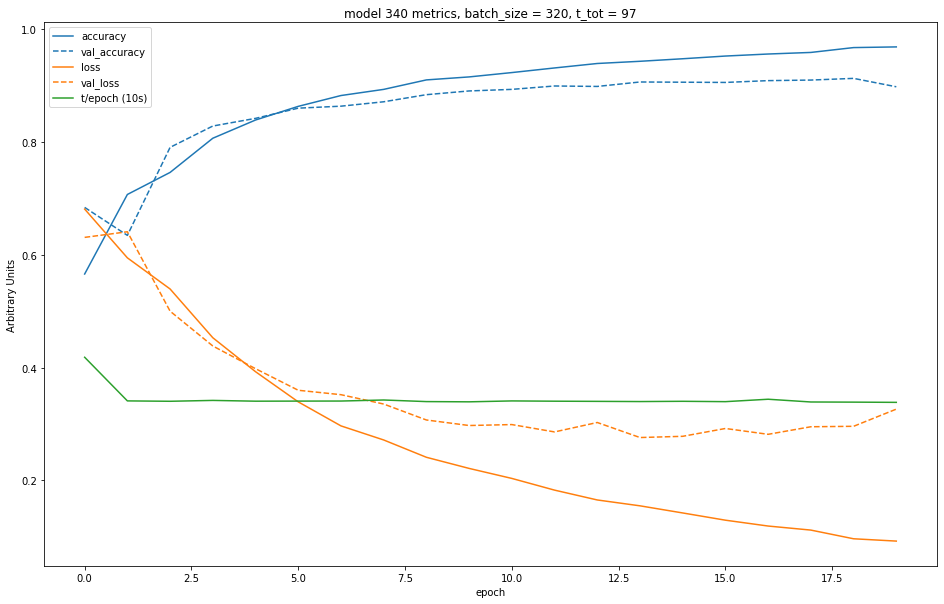

Creating model 341...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


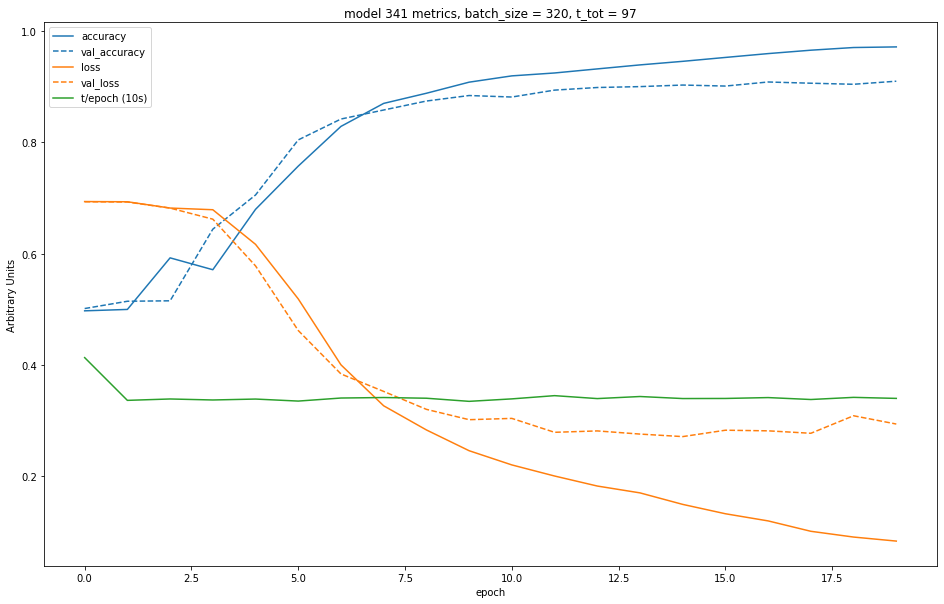

Creating model 342...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


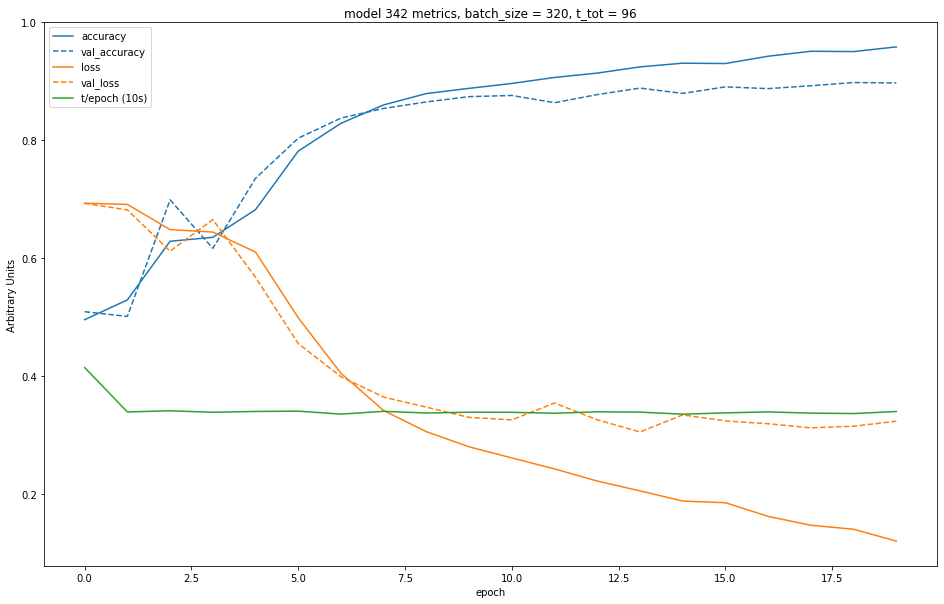

Creating model 343...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


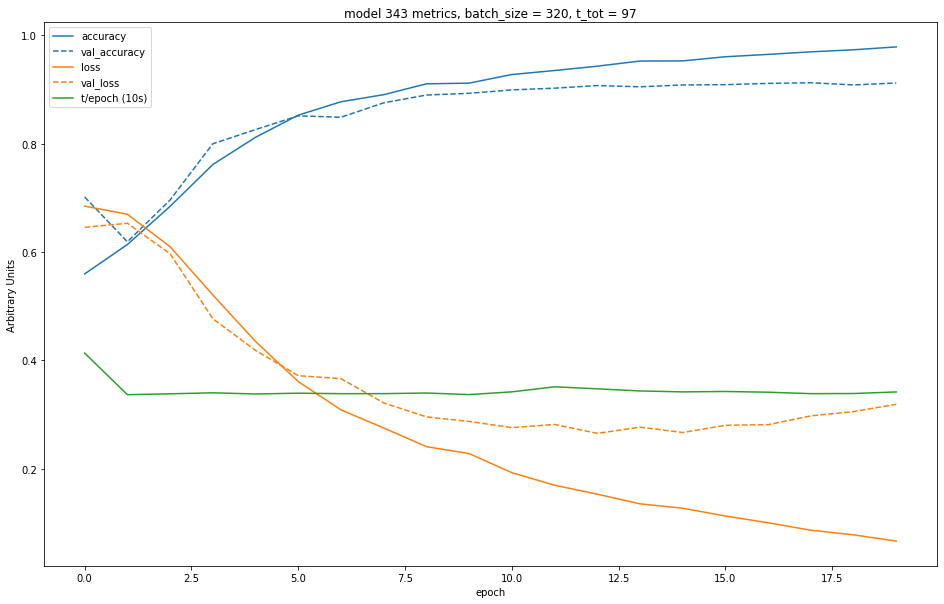

Creating model 344...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


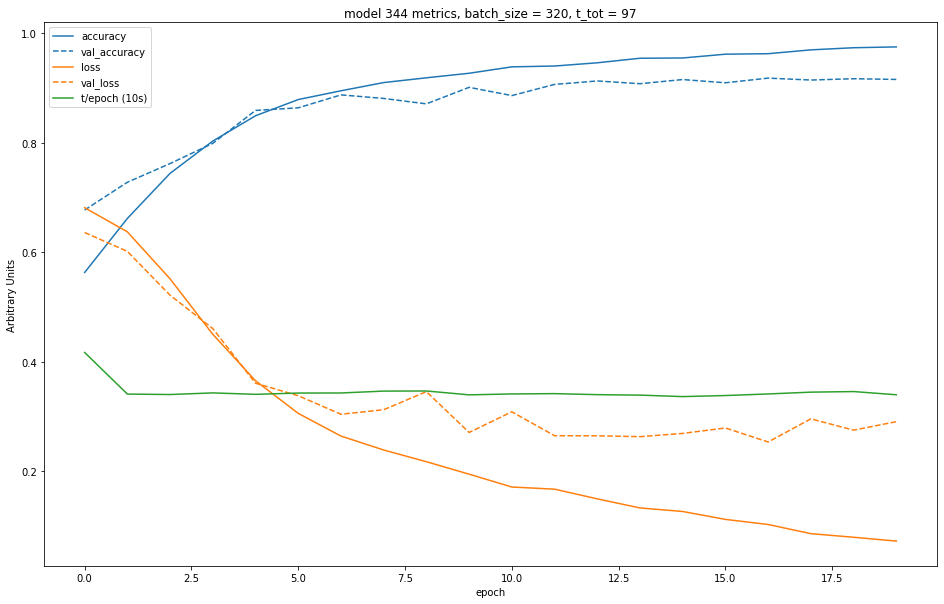

Creating model 345...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


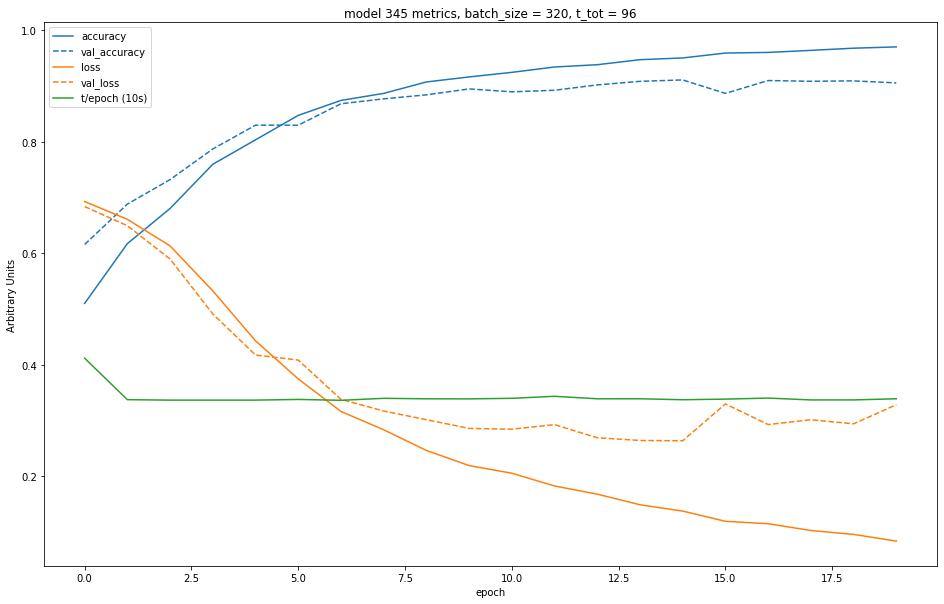

Creating model 346...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


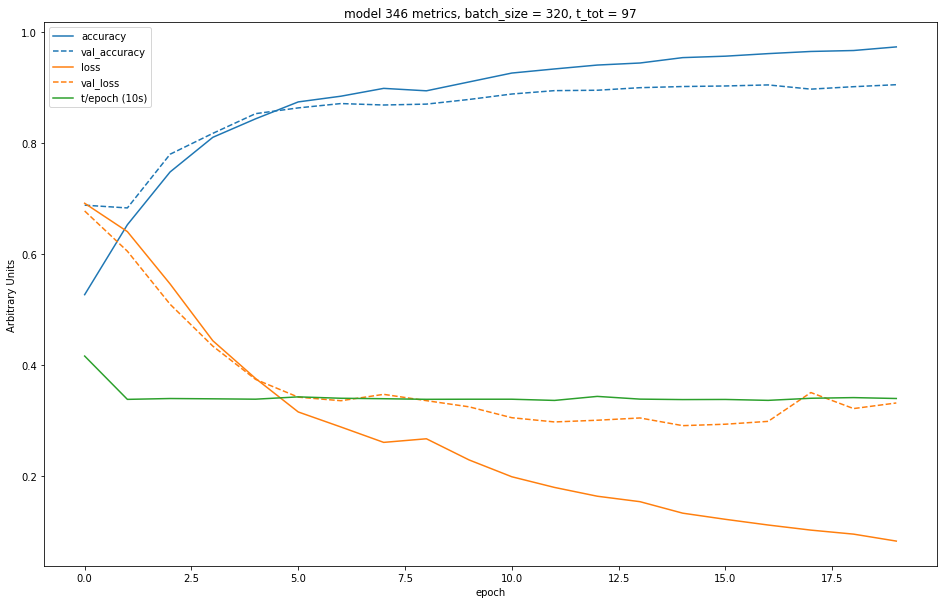

Creating model 347...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


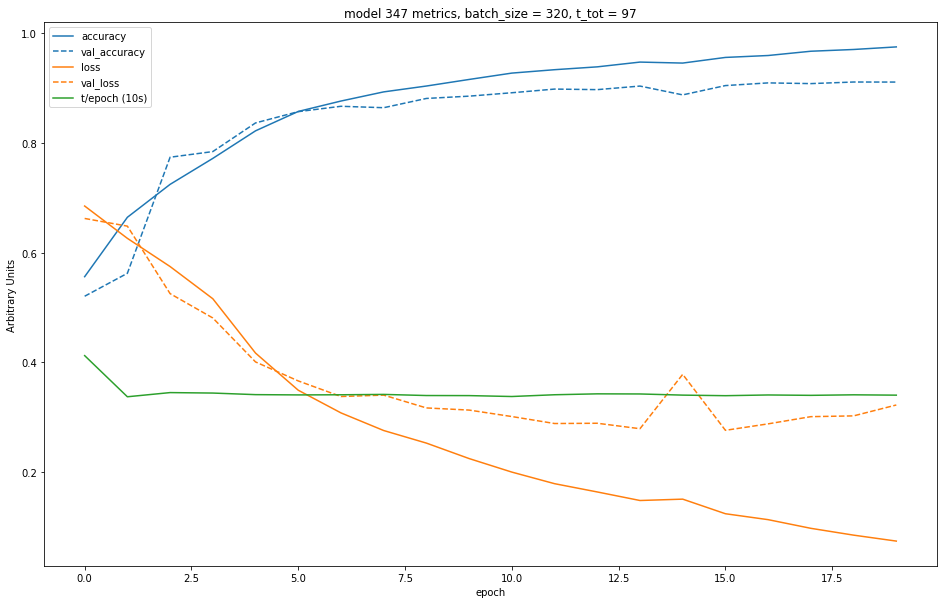

Creating model 348...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


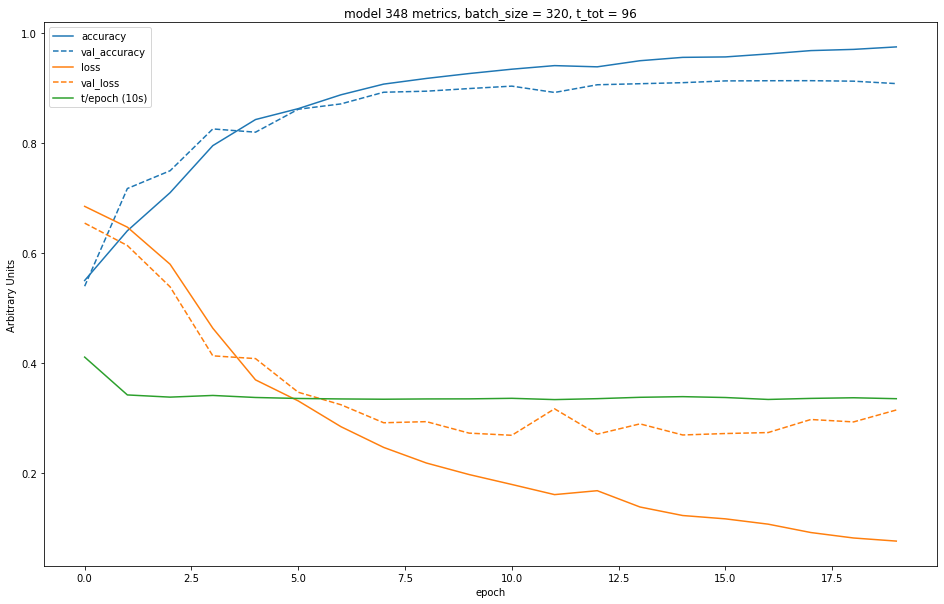

Creating model 349...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


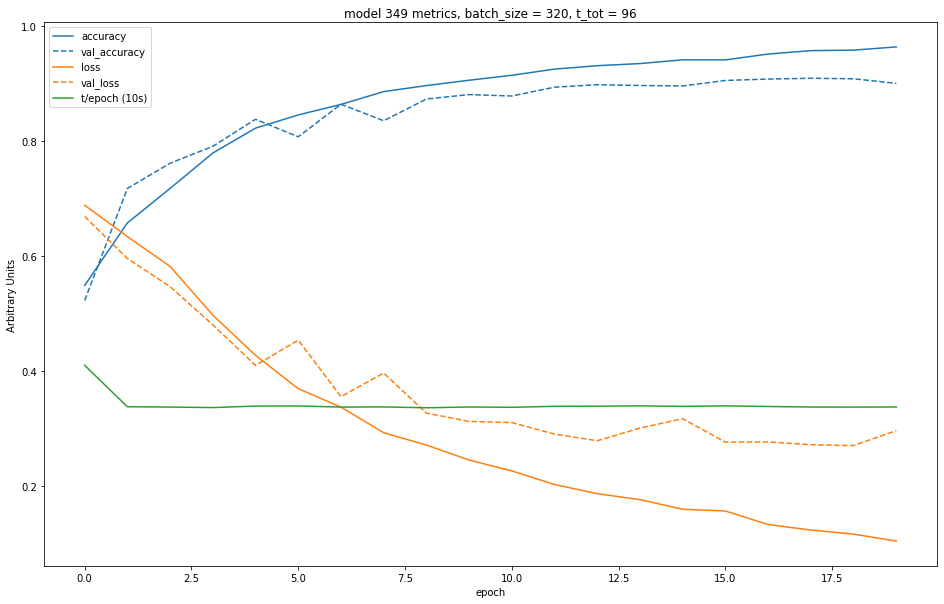

Creating model 350...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


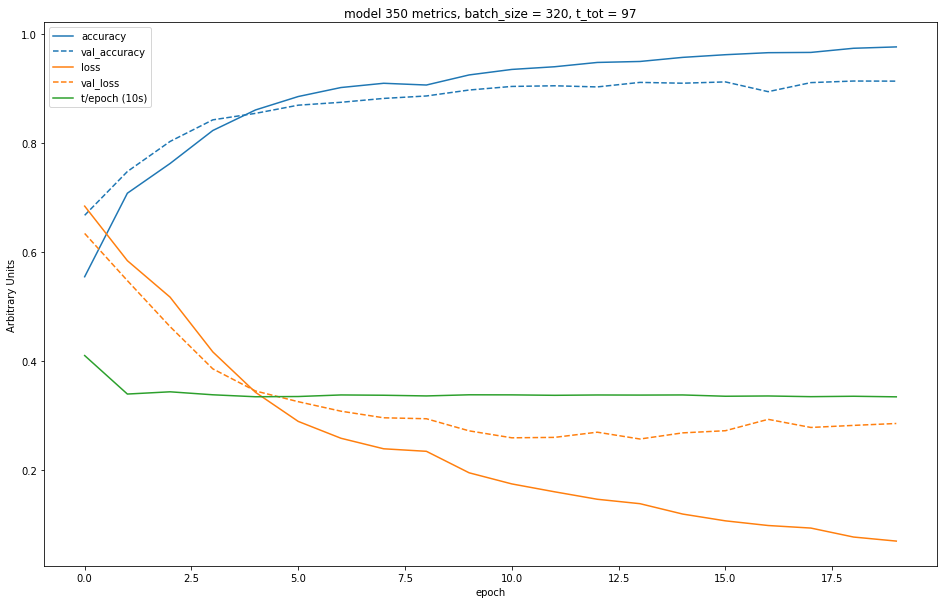

Creating model 351...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


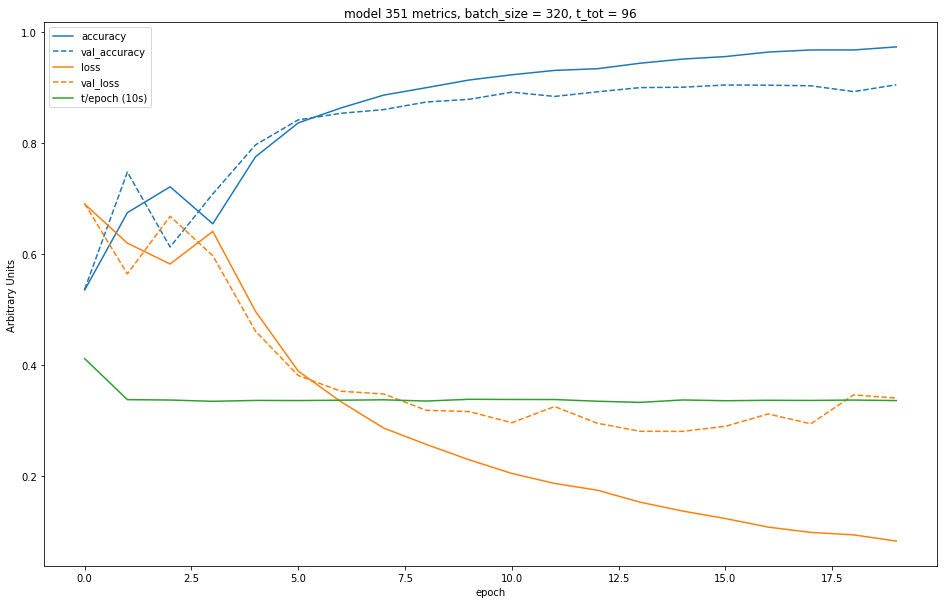

Creating model 352...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


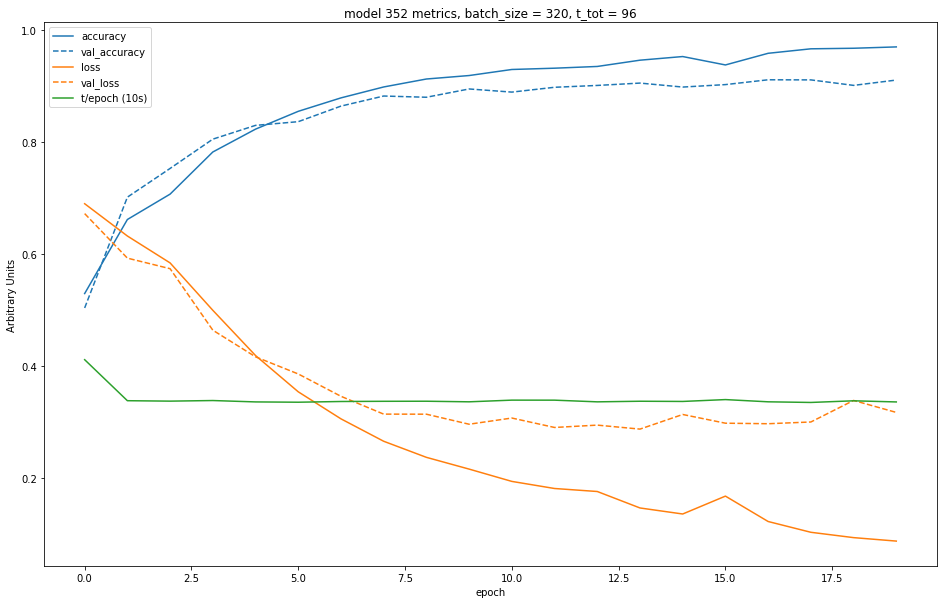

Creating model 353...
Compiling...
Fitting...
dict_keys(['loss', 'accuracy', 'mse', 'val_loss', 'val_accuracy', 'val_mse'])


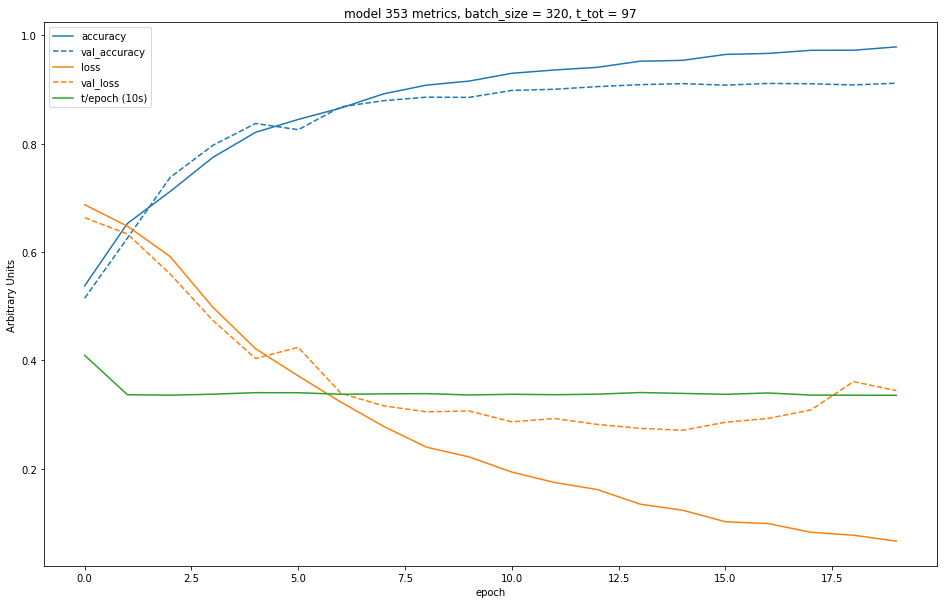

In [0]:
import math, time

#################################### Histories ########################################
#metrics = [ [], [], [],  [ [], [], [] ],  [ [], [], [] ]  ]
histories = []
minimum = 1
maximum = 501
step = 1
numEpochs = 20
size = 320 #batch_size: number of samples before each gradient step, default batch_size=32
ep = []
times = []
for i in range(1,numEpochs+1,1):
  ep.append(i)
  
for n in range(minimum,maximum,step):
  print("Creating model "+str((n - minimum + 1))+"...")
  
  # CNN takes 3 dimensional tensor input (image height, image width, color channel) 
  model = models.Sequential()
  # Padding='same' significantly improves results
  model.add(layers.Conv2D(32, (3, 3), strides=(1,1), padding='same', activation='relu', input_shape=(48, 144, 1)))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Conv2D(64, (3, 3), strides=(1,1), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Conv2D(64, (3, 3), strides=(1,1), activation='relu'))
  model.add(layers.Flatten())
  model.add(layers.Dense(64, activation='relu'))
  # Final layer must have two outputs since we are distinguishing between only two particles
  model.add(layers.Dense(2, activation='softmax'))

  # Print CNN Architecture
  #model.summary()

  # Train CNN
  print("Compiling...")
  model.compile(optimizer='adam',
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy','mse'], verbose=0) #,tf.keras.metrics.TrueNegatives(),tf.keras.metrics.FalsePositives()
  
  print("Fitting...")
  # This callback will stop the training when there is no improvement in
  # the validation loss for three consecutive epochs.
  #callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=10)
  callback = training_times(n)
  
  val_split = 0.1
  t = time.time()
  history = model.fit(data_train_images, target_train_images, batch_size=size, epochs=numEpochs, callbacks=[callback], verbose=0, validation_data=(data_test_images, target_test_images)) # 
  t = time.time() - t
  times.append(t)
  
  # Add the fit to histories so it is available to look at more closely afterward
  histories.append(history)
  

  #print("Time elapsed: "+str(t))
  
  # Evaluate CNN
  results = model.evaluate(data_test_images,
                           target_test_images,
                           verbose=0)
  
  #histories.append(("history"+str((n - minimum + 1)),history))
  
  print(history.history.keys())
  #print(history.history['accuracy'].shape())
  #chi2 = np.add(history.history['false_positives'],history.history['true_negatives'])
  
  # Plot metrics and save in a .png file
  f = plt.figure(figsize=(16,10))
  val = plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'],'--', color=val[0].get_color())
  val = plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'],'--', color=val[0].get_color())
  #val = plt.plot(history.history['mse']) 
  #plt.plot(history.history['val_mse'],'--', color=val[0].get_color())
  plt.plot(*zip(*callback.get_times()))
  plt.title('model '+str(n)+' metrics, batch_size = '+str(size)+', t_tot = '+str(round(t)))
  plt.ylabel('Arbitrary Units')
  plt.xlabel('epoch')
  plt.legend(['accuracy', 'val_accuracy','loss', 'val_loss','t/epoch (10s)'], loc='upper left')
  #plt.legend(['accuracy', 'val_accuracy','loss', 'val_loss', 'mse', 'val_mse','t/epoch (10s)'], loc='upper left')
  plt.show()
  f.savefig("epochs_metrics"+str(n)+".png")
  
  """
  #ORIGINAL FROM ABOVE
  # Plot metrics and save in a .png file
  f = plt.figure(figsize=(16,10))
  val = plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'],'--', color=val[0].get_color())
  val = plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'],'--', color=val[0].get_color())
  val = plt.plot(history.history['mse']) 
  plt.plot(history.history['val_mse'],'--', color=val[0].get_color())
  plt.plot(*zip(*callback.get_times()))
  plt.title('model '+str(n)+' metrics, batch_size = '+str(size)+', time = '+str(t))
  plt.ylabel('Arbitrary Units')
  plt.xlabel('epoch')
  plt.legend(['accuracy', 'val_accuracy','loss', 'val_loss', 'mse', 'val_mse','t/epoch (100ms)'], loc='upper left')
  plt.show()
  f.savefig("epochs_metrics"+str(n)+".png")
  
  
  # summarize history for loss
  f = plt.figure()
  plt.plot(history.history['loss'])
  #plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  #plt.legend(['train', 'test'], loc='upper left')
  #plt.show()
  f.savefig("epochs_loss"+str(n)+".png")
  
  # summarize history for loss
  f = plt.figure()
  plt.plot(history.history['mse'])
  #plt.plot(history.history['val_mse'])
  plt.title('model mse')
  plt.ylabel('mse')
  plt.xlabel('epoch')
  #plt.legend(['train', 'test'], loc='upper left')
  #plt.show()
  f.savefig("epochs_mse"+str(n)+".png")
  """
  
  # Convert accuracy and loss plots into ROOT histograms
  #print("Converting plots to ROOT...")

  #file = uproot.recreate("epochs_acc"+str(n)+".root", compression=uproot.ZLIB(4))
  #file["acc"] = np.histogram2d(history.history['accuracy'],ep)

  #file = uproot.recreate("epochs_loss"+str(n)+".root", compression=uproot.ZLIB(4))
  #file["loss"] = np.histogram2d(history.history['loss'],ep)

  #file = uproot.recreate("epochs_mse"+str(n)+".root", compression=uproot.ZLIB(4))
  #file["mse"] = np.histogram2d(history.history['mse'],ep)

  # Download png and root files
  print("Downloading files...")
  
  from google.colab import files
  files.download("epochs_metrics"+str(n)+".png")
  #files.download("epochs_loss"+str(n)+".png")
  #files.download("epochs_mse"+str(n)+".png")

  #files.download("epochs_acc"+str(n)+".root")
  #files.download("epochs_loss"+str(n)+".root")
  #files.download("epochs_mse"+str(n)+".root")

################################################################################################




In [0]:
################  Plot Purity and Chi2  ################
print("Plotting purity and \u03C7\u00b2")

# Plot accuracy
f = plt.figure()
plt.plot(metrics[0],metrics[1],'b.', scaley = False)
plt.title("Accuracy")
plt.xlabel("Input filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputFilter_acc.png")

# Plot loss
f = plt.figure()
plt.plot(metrics[0],metrics[2],'b.', scaley = False)
plt.title("Loss")
plt.xlabel("Input filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputFilter_loss.png")

# Plot kaon chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][0],'b.')
plt.title("Kaon \u03C7\u00b2")
plt.xlabel("Input filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputFilter_chi2_kaon.png")

# Plot pion chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][1],'b.')
plt.title("Pion \u03C7\u00b2")
plt.xlabel("Input filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputFilter_chi2_pion.png")

# Plot total chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][2],'b.')
plt.title("Total \u03C7\u00b2")
plt.xlabel("Input filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputFilter_chi2_tot.png")
  
# Convert accuracy and loss plots into ROOT histograms
print("Converting plots to ROOT...")

file = uproot.recreate("inputFilter_acc.root", compression=uproot.ZLIB(4))
file["acc"] = np.histogram2d(metrics[0],metrics[1])

file = uproot.recreate("inputFilter_loss.root", compression=uproot.ZLIB(4))
file["loss"] = np.histogram2d(metrics[0],metrics[2])

file = uproot.recreate("inputFilter_chi2_kaon.root", compression=uproot.ZLIB(4))
file["chi2k"] = np.histogram2d(metrics[0],metrics[3][0])

file = uproot.recreate("inputFilter_chi2_pion.root", compression=uproot.ZLIB(4))
file["chi2p"] = np.histogram2d(metrics[0],metrics[3][1])

file = uproot.recreate("inputFilter_chi2_tot.root", compression=uproot.ZLIB(4))
file["chi2t"] = np.histogram2d(metrics[0],metrics[3][2])

# Download png and root files
print("Downloading files...")

from google.colab import files
files.download("inputFilter_acc.png")
files.download("inputFilter_loss.png")
files.download("inputFilter_chi2_kaon.png")
files.download("inputFilter_chi2_pion.png")
files.download("inputFilter_chi2_tot.png")

files.download("inputFilter_acc.root")
files.download("inputFilter_loss.root")
files.download("inputFilter_chi2_kaon.root")
files.download("inputFilter_chi2_pion.root")
files.download("inputFilter_chi2_tot.root")


"""################  Plot Purity and Chi2  ################
print("Plotting purity and \u03C7\u00b2")

# Plot accuracy
f = plt.figure()
plt.plot(metrics[0],metrics[1],'b.', scaley = False)
plt.title("Accuracy")
plt.xlabel("Filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allFilters_acc.png")

# Plot loss
f = plt.figure()
plt.plot(metrics[0],metrics[2],'b.', scaley = False)
plt.title("Loss")
plt.xlabel("Filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allFilters_loss.png")

# Plot kaon chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][0],'b.')
plt.title("Kaon \u03C7\u00b2")
plt.xlabel("Filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allFilters_chi2_kaon.png")

# Plot pion chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][1],'b.')
plt.title("Pion \u03C7\u00b2")
plt.xlabel("Filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allFilters_chi2_pion.png")

# Plot total chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][2],'b.')
plt.title("Total \u03C7\u00b2")
plt.xlabel("Filter size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allFilters_chi2_tot.png")
  
# Convert accuracy and loss plots into ROOT histograms
print("Converting plots to ROOT...")

file = uproot.recreate("allFilters_acc.root", compression=uproot.ZLIB(4))
file["acc"] = np.histogram2d(metrics[0],metrics[1])

file = uproot.recreate("allFilters_loss.root", compression=uproot.ZLIB(4))
file["loss"] = np.histogram2d(metrics[0],metrics[2])

file = uproot.recreate("allFilters_chi2_kaon.root", compression=uproot.ZLIB(4))
file["chi2k"] = np.histogram2d(metrics[0],metrics[3][0])

file = uproot.recreate("allFilters_chi2_pion.root", compression=uproot.ZLIB(4))
file["chi2p"] = np.histogram2d(metrics[0],metrics[3][1])

file = uproot.recreate("allFilters_chi2_tot.root", compression=uproot.ZLIB(4))
file["chi2t"] = np.histogram2d(metrics[0],metrics[3][2])

# Download png and root files
print("Downloading files...")

from google.colab import files
files.download("allFilters_acc.png")
files.download("allFilters_loss.png")
files.download("allFilters_chi2_kaon.png")
files.download("allFilters_chi2_pion.png")
files.download("allFilters_chi2_tot.png")

files.download("allFilters_acc.root")
files.download("allFilters_loss.root")
files.download("allFilters_chi2_kaon.root")
files.download("allFilters_chi2_pion.root")
files.download("allFilters_chi2_tot.root")


################  Plot Purity and Chi2  ################
print("Plotting purity and \u03C7\u00b2")

# Plot accuracy
f = plt.figure()
plt.plot(metrics[0],metrics[1],'b.', scaley = False)
plt.title("Accuracy")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputLayer_acc.png")

# Plot loss
f = plt.figure()
plt.plot(metrics[0],metrics[2],'b.', scaley = False)
plt.title("Loss")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputLayer_loss.png")

# Plot kaon chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][0],'b.')
plt.title("Kaon \u03C7\u00b2")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputLayer_chi2_kaon.png")

# Plot pion chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][1],'b.')
plt.title("Pion \u03C7\u00b2")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputLayer_chi2_pion.png")

# Plot total chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][2],'b.')
plt.title("Total \u03C7\u00b2")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("inputLayer_chi2_tot.png")
  
# Convert accuracy and loss plots into ROOT histograms
print("Converting plots to ROOT...")

file = uproot.recreate("inputLayer_acc.root", compression=uproot.ZLIB(4))
file["acc"] = np.histogram2d(metrics[0],metrics[1])

file = uproot.recreate("inputLayer_loss.root", compression=uproot.ZLIB(4))
file["loss"] = np.histogram2d(metrics[0],metrics[2])

file = uproot.recreate("inputLayer_chi2_kaon.root", compression=uproot.ZLIB(4))
file["chi2k"] = np.histogram2d(metrics[0],metrics[3][0])

file = uproot.recreate("inputLayer_chi2_pion.root", compression=uproot.ZLIB(4))
file["chi2p"] = np.histogram2d(metrics[0],metrics[3][1])

file = uproot.recreate("inputLayer_chi2_tot.root", compression=uproot.ZLIB(4))
file["chi2t"] = np.histogram2d(metrics[0],metrics[3][2])

# Download png and root files
print("Downloading files...")

from google.colab import files
files.download("inputLayer_acc.png")
files.download("inputLayer_loss.png")
files.download("inputLayer_chi2_kaon.png")
files.download("inputLayer_chi2_pion.png")
files.download("inputLayer_chi2_tot.png")

files.download("inputLayer_acc.root")
files.download("inputLayer_loss.root")
files.download("inputLayer_chi2_kaon.root")
files.download("inputLayer_chi2_pion.root")
files.download("inputLayer_chi2_tot.root")


################################################################################################




################  Plot Purity and Chi2  ################
print("Plotting purity and \u03C7\u00b2")

# Plot accuracy
f = plt.figure()
plt.plot(metrics[0],metrics[1],'b.', scaley = False)
plt.title("Accuracy")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allLayers_acc.png")

# Plot loss
f = plt.figure()
plt.plot(metrics[0],metrics[2],'b.', scaley = False)
plt.title("Loss")
plt.xlabel("Input layer size")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allLayers_loss.png")

# Plot kaon chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][0],'b.')
plt.title("Kaon \u03C7\u00b2")
plt.xlabel("Layer sizes")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allLayers_chi2_kaon.png")

# Plot pion chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][1],'b.')
plt.title("Pion \u03C7\u00b2")
plt.xlabel("Layer sizes")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allLayers_chi2_pion.png")

# Plot total chi2
f = plt.figure()
plt.plot(metrics[0],metrics[3][2],'b.')
plt.title("Total \u03C7\u00b2")
plt.xlabel("Layer sizes")
plt.ylabel("Arbitrary units")
plt.show()
f.savefig("allLayers_chi2_tot.png")
  
# Convert accuracy and loss plots into ROOT histograms
print("Converting plots to ROOT...")

file = uproot.recreate("allLayers_acc.root", compression=uproot.ZLIB(4))
file["acc"] = np.histogram2d(metrics[0],metrics[1])

file = uproot.recreate("allLayers_loss.root", compression=uproot.ZLIB(4))
file["loss"] = np.histogram2d(metrics[0],metrics[2])

file = uproot.recreate("allLayers_chi2_kaon.root", compression=uproot.ZLIB(4))
file["chi2k"] = np.histogram2d(metrics[0],metrics[3][0])

file = uproot.recreate("allLayers_chi2_pion.root", compression=uproot.ZLIB(4))
file["chi2p"] = np.histogram2d(metrics[0],metrics[3][1])

file = uproot.recreate("allLayers_chi2_tot.root", compression=uproot.ZLIB(4))
file["chi2t"] = np.histogram2d(metrics[0],metrics[3][2])

# Download png and root files
print("Downloading files...")

from google.colab import files
files.download("allLayers_acc.png")
files.download("allLayers_loss.png")
files.download("allLayers_chi2_kaon.png")
files.download("allLayers_chi2_pion.png")
files.download("allLayers_chi2_tot.png")

files.download("allLayers_acc.root")
files.download("allLayers_loss.root")
files.download("allLayers_chi2_kaon.root")
files.download("allLayers_chi2_pion.root")
files.download("allLayers_chi2_tot.root")
"""

Plotting purity and χ²


TypeError: ignored

<Figure size 432x288 with 0 Axes>

In [0]:
import os
print( os.getcwd() )
#print( os.listdir() )

/content
['.config', 'inputLayer_acc.png', 'gdrive', 'inputLayer_loss.png', 'sample_data']


In [0]:
from google.colab import files
files.download("inputLayer_acc.png")


Filling histograms...


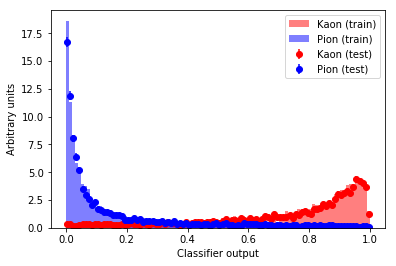

In [0]:
###################  Evaluation  #################

# Evaluate performance by comparing test and training classifier (model) response
decisions = []
for (X,y) in ((data_train_images, target_train_images), (data_test_images, target_test_images)):
    d1 = model.predict_proba(X[y>0.5])[:,1].ravel()
    d2 = model.predict_proba(X[y<0.5])[:,1].ravel()
    decisions += [d1, d2]
    
print("Filling histograms...")

bins = 100
low = min(np.min(d) for d in decisions)
high = max(np.max(d) for d in decisions)
low_high = (low,high)

plt.clf()
# Plot training decisions
plt.hist(decisions[0], color='r', alpha=0.5, range=low_high, bins=bins, histtype='stepfilled', density=True, label='Kaon (train)')
plt.hist(decisions[1], color='b', alpha=0.5, range=low_high, bins=bins, histtype='stepfilled', density=True, label='Pion (train)')

# make histogram and get error bars
hist, bins = np.histogram(decisions[2], bins=bins, range=low_high, density=True)
width = (bins[1] - bins[0])
center = (bins[:-1] + bins[1:]) / 2

# plot histogram for signal test sample (Kaon Test)
scale = len(decisions[2]) / sum(hist)
err = np.sqrt(hist * scale) / scale
plt.errorbar(center, hist, yerr=err, fmt='o', c='r', label='Kaon (test)')

# make and plot histogram for background test sample (Pion Test)
hist, bins = np.histogram(decisions[3], bins=bins, range=low_high, density=True)
scale = len(decisions[2]) / sum(hist)
err = np.sqrt(hist * scale) / scale
plt.errorbar(center, hist, yerr=err, fmt='o', c='b', label='Pion (test)')

plt.xlabel("Classifier output")
plt.ylabel("Arbitrary units")
plt.legend(loc='best')
plt.show()